### setup and data loading phase of the MLP-from-scratch implementation.
##### Imports visualization and numerical tools,
##### Sets visual styles,
##### Loads the Iris dataset using scikit-learn.

In [4]:
import random
import seaborn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm

seaborn.set(style='whitegrid'); seaborn.set_context('talk')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from sklearn.datasets import load_iris
iris_data = load_iris()

### Analysis about the Iris Dataset
##### description of the Iris dataset

In [5]:
print(iris_data['DESCR'])

.. _iris_dataset:

Iris plants dataset
--------------------

**Data Set Characteristics:**

:Number of Instances: 150 (50 in each of three classes)
:Number of Attributes: 4 numeric, predictive attributes and the class
:Attribute Information:
    - sepal length in cm
    - sepal width in cm
    - petal length in cm
    - petal width in cm
    - class:
            - Iris-Setosa
            - Iris-Versicolour
            - Iris-Virginica

:Summary Statistics:

============== ==== ==== ======= ===== ====================
                Min  Max   Mean    SD   Class Correlation
============== ==== ==== ======= ===== ====================
sepal length:   4.3  7.9   5.84   0.83    0.7826
sepal width:    2.0  4.4   3.05   0.43   -0.4194
petal length:   1.0  6.9   3.76   1.76    0.9490  (high!)
petal width:    0.1  2.5   1.20   0.76    0.9565  (high!)
============== ==== ==== ======= ===== ====================

:Missing Attribute Values: None
:Class Distribution: 33.3% for each of 3 classes.
:Cr

### Exploratory data visualization of the Iris dataset
##### Plots a scatterplot of Sepal Length vs. Sepal Width
##### Plots a scatterplot of Petal Length vs. Petal Width

Number of samples: 150
Number of features: 4 



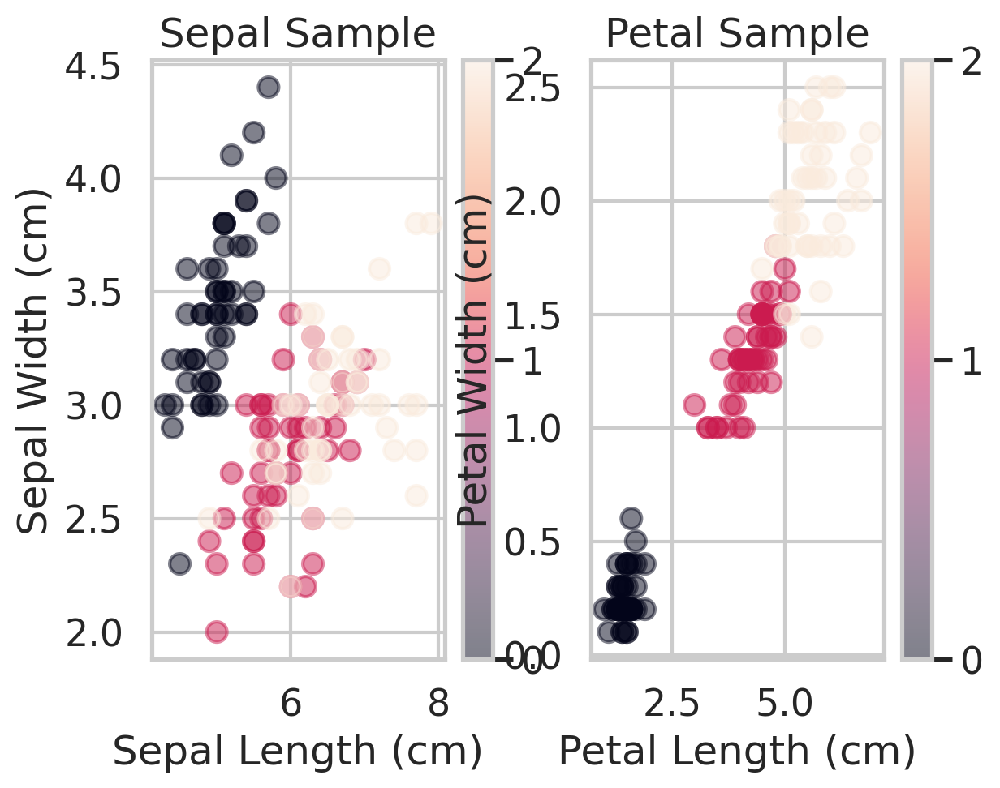

In [6]:
n_samples, n_features = iris_data.data.shape

print(f"Number of samples: {n_samples}")
print(f"Number of features: {n_features} \n")

plt.subplot(1, 2, 1)
scatter_plot = plt.scatter(iris_data.data[:,0], iris_data.data[:,1], alpha=0.5,
                           c=iris_data.target)
plt.xlabel("Sepal Length (cm)")
plt.ylabel("Sepal Width (cm)")

plt.colorbar(ticks=([0, 1, 2]))
plt.title('Sepal Sample');

plt.subplot(1, 2, 2)
scatter_plot_2 = plt.scatter(iris_data.data[:,2], iris_data.data[:,3], alpha=0.5,
                           c=iris_data.target)
plt.xlabel("Petal Length (cm)")
plt.ylabel("Petal Width (cm)")

plt.colorbar(ticks=([0, 1, 2]))
plt.title('Petal Sample');

##### A scatter matrix visualization of the entire Iris dataset, giving a more complete view of how the features relate to each other.

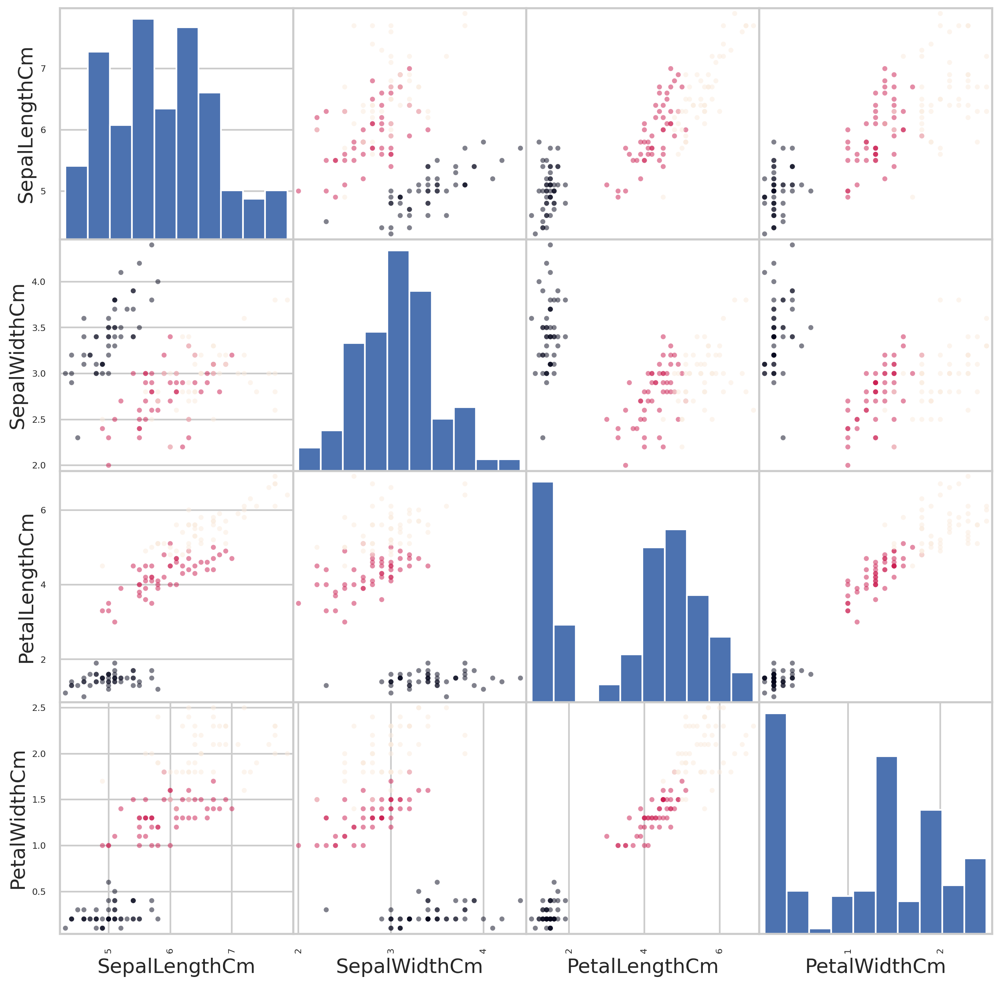

In [7]:
import pandas as pd
from pandas.plotting import scatter_matrix


dataset = pd.read_csv('Dataset/Iris.csv')
dataset = dataset.drop("Id", axis=1)
#scatter_matrix(dataset, alpha=0.5, figsize=(20, 20))
scatter_matrix(dataset.iloc[:, :-1], alpha=0.5, figsize=(15, 15), diagonal='hist', c=dataset['Species'].astype('category').cat.codes)
plt.show()

##### continue with the exploratory data analysis (EDA) phase by giving further insight into the Iris dataset's structure and feature distributions.
##### Creates a histogram for each numerical feature (sepal length, sepal width, petal length, petal width).

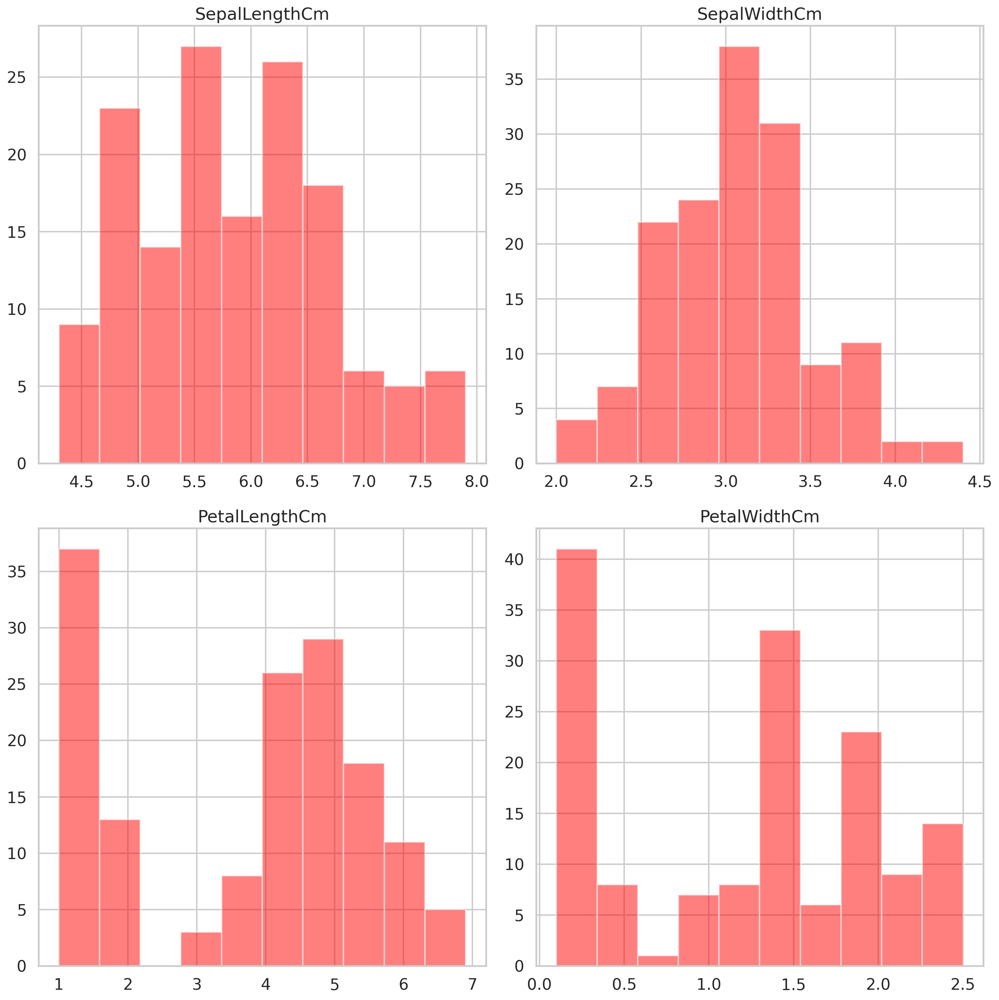

In [8]:
dataset.hist(alpha=0.5, figsize=(15, 15), color='red')
plt.tight_layout()
plt.show()

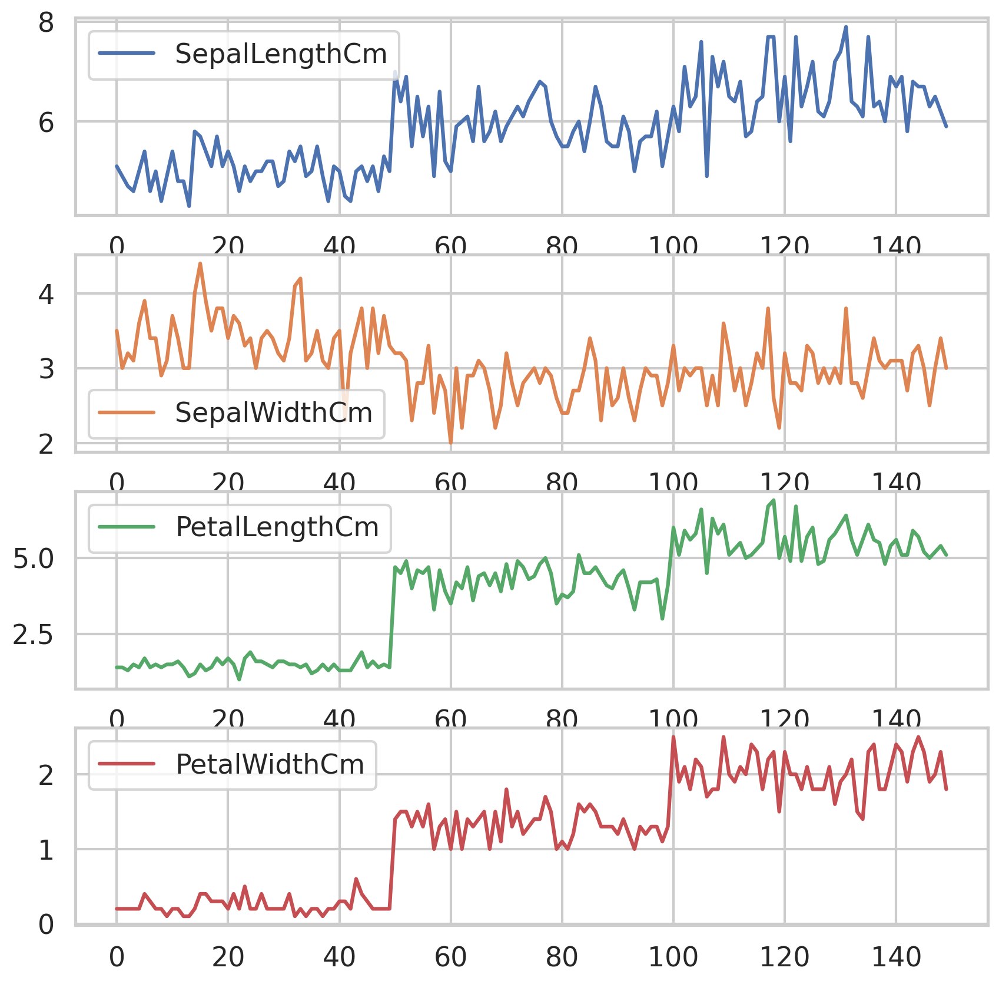

In [9]:
dataset.plot(subplots=True, figsize=(10, 10), sharex=False, sharey=False)
plt.show()

### This section of your project handles data preprocessing and splitting, an essential step before training your MLP.

In [10]:
import numpy as np
import random
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_iris

# Load the Iris dataset
iris_data = load_iris()

# Join features and labels into a single array
iris_dataset = np.column_stack((iris_data.data, iris_data.target.T))  # shape (150, 5)

# Shuffle the dataset (optional: for reproducibility)
random.seed(123)
random.shuffle(iris_dataset)

# Split features (X) and labels (y)
X = iris_dataset[:, :4]
y = iris_dataset[:, 4]


# Use train_test_split to divide into 80% train, 20% test
train_X, test_X, train_y, test_y = train_test_split(
    X, y,
    test_size=0.2,
    random_state=11,  # set for reproducibility
    stratify=y        # keep label proportions balanced
)

# Now you have train_X, train_y, test_X, test_y ready

print(test_y)

[0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 2. 0. 0. 1. 0.
 0. 1. 0. 0. 0. 0.]


##### these next two parts visualize the training and test data splits, which is helpful to understand feature distributions and class separability. 

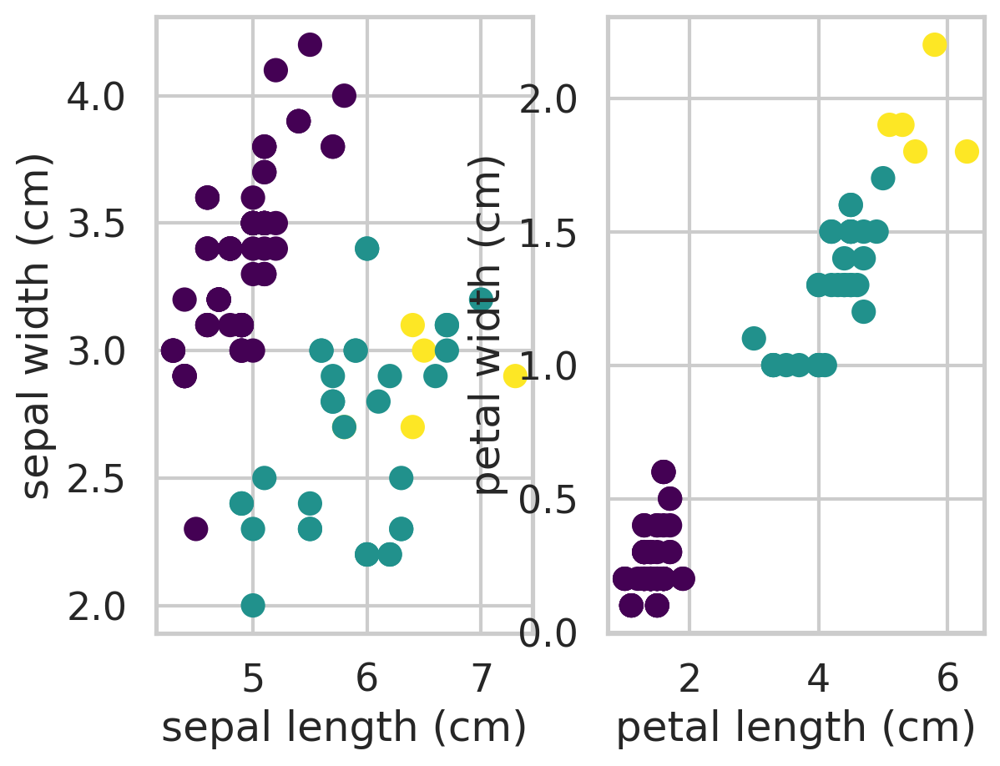

In [11]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

# Plot training Samples

plt.subplot(1, 2, 1)
plt.scatter(train_X[:,0],train_X[:,1],c=train_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[0])
plt.ylabel(iris_data.feature_names[1])

plt.subplot(1, 2, 2)
plt.scatter(train_X[:,2],train_X[:,3],c=train_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[2])
plt.ylabel(iris_data.feature_names[3]);

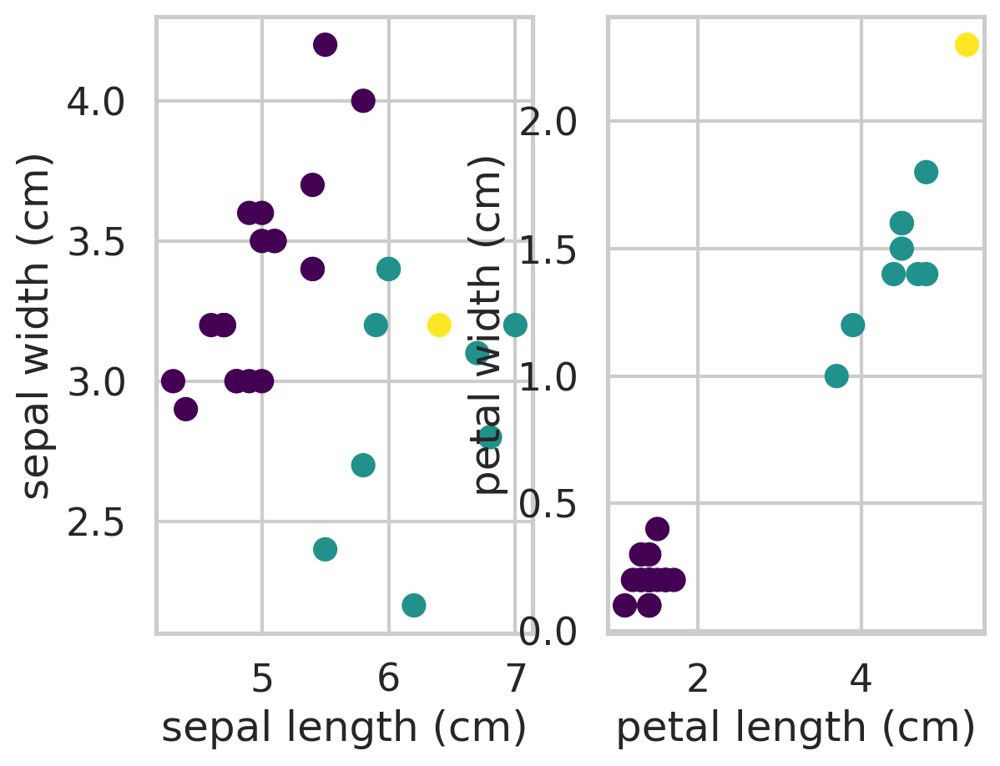

In [12]:
# Plot test samples
plt.subplot(1, 2, 1)
plt.scatter(test_X[:,0],test_X[:,1],c=test_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[0])
plt.ylabel(iris_data.feature_names[1])

plt.subplot(1, 2, 2)
plt.scatter(test_X[:,2],test_X[:,3],c=test_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[2])
plt.ylabel(iris_data.feature_names[3]);

In [13]:
# Implementation the Multilayer Perceptron in Python
from sklearn.base import BaseEstimator, ClassifierMixin, RegressorMixin
import random
import numpy as np
import matplotlib.pyplot as plt

class MultiLayerPerceptron(BaseEstimator, ClassifierMixin):

    def __init__(self, params=None):
        # Store the params argument to satisfy BaseEstimator requirements
        self.params = params

        if (params == None):
            self.inputLayer = 4                        # Input Layer
            self.hiddenLayer = 5                       # Hidden Layer
            self.outputLayer = 3                       # Outpuy Layer
            self.learningRate = 0.005                  # Learning rate
            self.max_epochs = 600                      # Epochs
            self.BiasHiddenValue = -1                   # Bias HiddenLayer
            self.BiasOutputValue = -1                  # Bias OutputLayer
            self.activation = self.ativacao['sigmoid'] # Activation function
            self.deriv = self.derivada['sigmoid']
        else:
            self.inputLayer = params['InputLayer']
            self.hiddenLayer = params['HiddenLayer']
            self.outputLayer = params['OutputLayer']
            self.learningRate = params['LearningRate']
            self.max_epochs = params['Epocas']
            self.BiasHiddenValue = params['BiasHiddenValue']
            self.BiasOutputValue = params['BiasOutputValue']
            self.activation = self.ativacao[params['ActivationFunction']]
            self.deriv = self.derivada[params['ActivationFunction']]

        # Starting Bias and Weights
        # assign ramdom values [-1 .. +1] in order to start with some weights
        # not so symmetric
        # Weight initialization: passing correct arguments to starting_weights
        self.WEIGHT_hidden = self.starting_weights(self.inputLayer, self.hiddenLayer)
        self.WEIGHT_output = self.starting_weights(self.hiddenLayer, self.outputLayer)

        self.BIAS_hidden = np.array([self.BiasHiddenValue for i in range(self.hiddenLayer)])
        self.BIAS_output = np.array([self.BiasOutputValue for i in range(self.outputLayer)]) # Corrected attribute name
        self.classes_number = 3

    pass

    # This function creates a 2D matrix of random values between -1 and +1
    # Shape: rows x columns
    def starting_weights(self, rows, columns):
        #return [[2  * random.random() - 1 for _ in range(columns)] for _ in range(rows)]
        return np.array([[2 * random.random() - 1 for _ in range(columns)] for _ in range(rows)])


    ativacao = {
         'sigmoid': (lambda x: 1/(1 + np.exp(-x))),
            'tanh': (lambda x: np.tanh(x)),
            'Relu': (lambda x: x*(x > 0)),
               }
    derivada = {
         'sigmoid': (lambda x: x*(1-x)),
            'tanh': (lambda x: 1-x**2),
            'Relu': (lambda x: 1 * (x>0))
               }

    # This calculates the error at the output layer and then propagates it
    # backward through the network to update the weights in each layer
    def Backpropagation_Algorithm(self, x):
        DELTA_output = []
        # Stage 1 - Error: OutputLayer (target - predicted)
        ERROR_output = self.output - self.OUTPUT_L2
        DELTA_output = ((-1)*(ERROR_output) * self.deriv(self.OUTPUT_L2))

        arrayStore = []
        # Stage 2 - Update weights OutputLayer and HiddenLayer
        for i in range(self.hiddenLayer):
            for j in range(self.outputLayer): # Corrected attribute name
                self.WEIGHT_output[i][j] -= (self.learningRate * (DELTA_output[j] * self.OUTPUT_L1[i]))
                self.BIAS_output[j] -= (self.learningRate * DELTA_output[j])

        # Stage 3 - Error: HiddenLayer
        delta_hidden = np.matmul(self.WEIGHT_output, DELTA_output)* self.deriv(self.OUTPUT_L1)

        # Stage 4 - Update weights HiddenLayer and InputLayer(x)
        for i in range(self.inputLayer):
            for j in range(self.hiddenLayer):
                self.WEIGHT_hidden[i][j] -= (self.learningRate * (delta_hidden[j] * x[i]))
                self.BIAS_hidden[j] -= (self.learningRate * delta_hidden[j])



    def show_err_graphic(self,v_erro,v_epoca):
        plt.figure(figsize=(9,4))
        plt.plot(v_epoca, v_erro, color="b", marker=11)
        plt.xlabel("Number of Epochs")
        plt.ylabel("Squared error (MSE) ");
        plt.title("Error Minimization")
        plt.show()


    def predict(self, X, y):
        'Returns the predictions for every element of X'
        my_predictions = []
        'Forward Propagation'
        forward = np.matmul(X,self.WEIGHT_hidden) + self.BIAS_hidden
        forward = np.matmul(forward, self.WEIGHT_output) + self.BIAS_output
        for i in forward:
            my_predictions.append(max(enumerate(i), key=lambda x:x[1])[0])

        array_score = []
        for i in range(len(my_predictions)):
            if my_predictions[i] == 0:
                array_score.append([i, 'Iris-setosa', my_predictions[i], y[i]])
            elif my_predictions[i] == 1:
                 array_score.append([i, 'Iris-versicolour', my_predictions[i], y[i]])
            elif my_predictions[i] == 2:
                 array_score.append([i, 'Iris-virginica', my_predictions[i], y[i]])

        dataframe = pd.DataFrame(array_score, columns=['_id', 'class', 'output', 'hoped_output'])
        return my_predictions, dataframe

    def fit(self, X, y):
        count_epoch = 1
        total_error = 0
        n = len(X);
        epoch_array = []
        error_array = []
        # Initialize lists to store specific weight values for plotting
        weight_over_epochs_W0_plot = []
        weight_over_epochs_W1_plot = []


        while(count_epoch <= self.max_epochs):
            for idx,inputs in enumerate(X):
                self.output = np.zeros(self.classes_number)
                'Stage 1 - (Forward Propagation)'
                self.OUTPUT_L1 = self.activation((np.dot(inputs, self.WEIGHT_hidden) + self.BIAS_hidden))
                self.OUTPUT_L2 = self.activation((np.dot(self.OUTPUT_L1, self.WEIGHT_output) + self.BIAS_output))
                'Stage 2 - One-Hot-Encoding'
                if(y[idx] == 0):
                    self.output = np.array([1,0,0]) #Class1 {1,0,0}
                elif(y[idx] == 1):
                    self.output = np.array([0,1,0]) #Class2 {0,1,0}
                elif(y[idx] == 2):
                    self.output = np.array([0,0,1]) #Class3 {0,0,1}

                square_error = np.mean((self.output - self.OUTPUT_L2)**2)
                total_error += square_error
                '''
                square_error = 0
                for i in range(self.outputLayer):
                    erro = (self.output[i] - self.OUTPUT_L2[i])**2
                    square_error = (square_error + (0.05 * erro))
                    total_error = total_error + square_error
                        '''
                'Backpropagation : Update Weights'
                self.Backpropagation_Algorithm(inputs)

            # The original code calculates total_error per batch, then divides by n (number of samples).
            # It's more standard to calculate the mean squared error per epoch by summing errors over
            # all samples in the epoch and then dividing by the number of output neurons.
            # Keeping the original logic for total_error calculation, but this is not
            # a standard MSE calculation.
            total_error = (total_error / n)
            if((count_epoch % 50 == 0)or(count_epoch == 1)):
                print("Epoch ", count_epoch, "- Total Error: ",total_error)
                error_array.append(total_error)
                epoch_array.append(count_epoch)
                # Append the specific weight values only when we are recording the epoch
                weight_over_epochs_W0_plot.append(self.WEIGHT_hidden[0][0])
                weight_over_epochs_W1_plot.append(self.WEIGHT_output[0][0])


            # Reset total_error for the next epoch
            total_error = 0

            count_epoch += 1
        self.show_err_graphic(error_array,epoch_array)

        # Plot the change of a *single* weight over the epochs that were recorded
        plt.figure(figsize=(8, 4))
        # Use the new lists which have the same length as epoch_array
        plt.plot(epoch_array, weight_over_epochs_W0_plot, label='Weight[0][0]')
        plt.title('Change of a Sample Weight (Input 0 to Hidden 0) over Epochs')
        plt.xlabel('Number of Epochs')
        plt.ylabel('Weight Value')
        plt.legend()
        plt.show()

        plt.figure(figsize=(8, 4))
        # Use the new lists which have the same length as epoch_array
        plt.plot(epoch_array, weight_over_epochs_W1_plot, label='Weight[0][0]')
        plt.title('Change of a Sample Weight (Hidden 0 to Output 0) over Epochs')
        plt.xlabel('Number of Epochs')
        plt.ylabel('Weight Value')
        plt.legend()
        plt.show()


        return self

In [14]:
def run_experiment(train_X, train_y, test_X, test_y,
                   n_input=4, n_hidden=5, n_output=3,
                   learning_rate=0.005, epochs=3000,
                   activation='sigmoid', show_plot=True):

    # Step 1: Setup MLP config
    config = {
        'InputLayer': n_input,
        'HiddenLayer': n_hidden,
        'OutputLayer': n_output,
        'Epocas': epochs,
        'LearningRate': learning_rate,
        'BiasHiddenValue': -1,
        'BiasOutputValue': -1,
        'ActivationFunction': activation
    }

    mlp = MultiLayerPerceptron(config)
    mlp.fit(train_X, train_y)

    # Step 2: Predict on test and train sets
    pred_test, _ = mlp.predict(test_X, test_y)
    pred_train, _ = mlp.predict(train_X, train_y)

    # === Test evaluation ===
    def evaluate(y_true, y_pred, dataset_name="Test"):
        total = len(y_true)
        hits = 0
        per_class_hits = [0, 0, 0]
        per_class_total = [0, 0, 0]

        for i, label in enumerate(y_true):
            label = int(label)
            pred = int(y_pred[i])
            if label == pred:
                hits += 1
                per_class_hits[label] += 1
            per_class_total[label] += 1

        acc_total = (hits / total) * 100 if total else 0
        acc_per_class = [(per_class_hits[i] / per_class_total[i]) * 100 if per_class_total[i] else 0 for i in range(3)]

        # Print result summary
        print(f"\n=== {dataset_name} Results ===")
        print("Porcents :", f"{acc_total:.2f}% hits and {100 - acc_total:.2f}% faults")
        print("Total samples of", dataset_name.lower(), total)
        class_names = ["Iris-Setosa", "Iris-Versicolour", "Iris-Virginica"]
        for i, name in enumerate(class_names):
            print(f"* {name}: {per_class_total[i]} samples, {per_class_hits[i]} hits")
        
        return acc_total, acc_per_class

    acc_test_total, acc_test_class = evaluate(test_y, pred_test, "Test")
    acc_train_total, acc_train_class = evaluate(train_y, pred_train, "Train")

    # Optional plot
    if show_plot:
        import matplotlib.pyplot as plt
        names = ["Setosa", "Versicolour", "Virginica"]
        x1 = [2.0, 4.0, 6.0]
        plt.figure()
        plt.bar(x1[0] - 0.4, acc_test_class[0], color='orange', label='Test - Setosa', width=0.4)
        plt.bar(x1[0], acc_train_class[0], color='orange', alpha=0.4, label='Train - Setosa', width=0.4)

        plt.bar(x1[1] - 0.4, acc_test_class[1], color='green', label='Test - Versicolour', width=0.4)
        plt.bar(x1[1], acc_train_class[1], color='green', alpha=0.4, label='Train - Versicolour', width=0.4)

        plt.bar(x1[2] - 0.4, acc_test_class[2], color='purple', label='Test - Virginica', width=0.4)
        plt.bar(x1[2], acc_train_class[2], color='purple', alpha=0.4, label='Train - Virginica', width=0.4)

        plt.ylabel('Accuracy (%)')
        plt.xticks(x1, names)
        plt.title(f'Accuracy by Class\nNeurons: {n_hidden}, LR: {learning_rate}, Epochs: {epochs}')
        plt.ylim(0, 110)
        plt.legend()
        plt.show()

    # Return results for logging if needed
    return {
        'neurons': n_hidden,
        'epochs': epochs,
        'learning_rate': learning_rate,
        'activation': activation,
        'accuracy_test_total': acc_test_total,
        'accuracy_test_per_class': acc_test_class,
        'accuracy_train_total': acc_train_total,
        'accuracy_train_per_class': acc_train_class,
    }



 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.001
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.25075382925247947
Epoch  50 - Total Error:  0.1987936865028497
Epoch  100 - Total Error:  0.16366591823058543
Epoch  150 - Total Error:  0.14983347166568214
Epoch  200 - Total Error:  0.14069519492060872
Epoch  250 - Total Error:  0.1334579989830353
Epoch  300 - Total Error:  0.12677470658450632
Epoch  350 - Total Error:  0.1201836216627054
Epoch  400 - Total Error:  0.11360674148358925
Epoch  450 - Total Error:  0.10710353674256769
Epoch  500 - Total Error:  0.10076809632447443


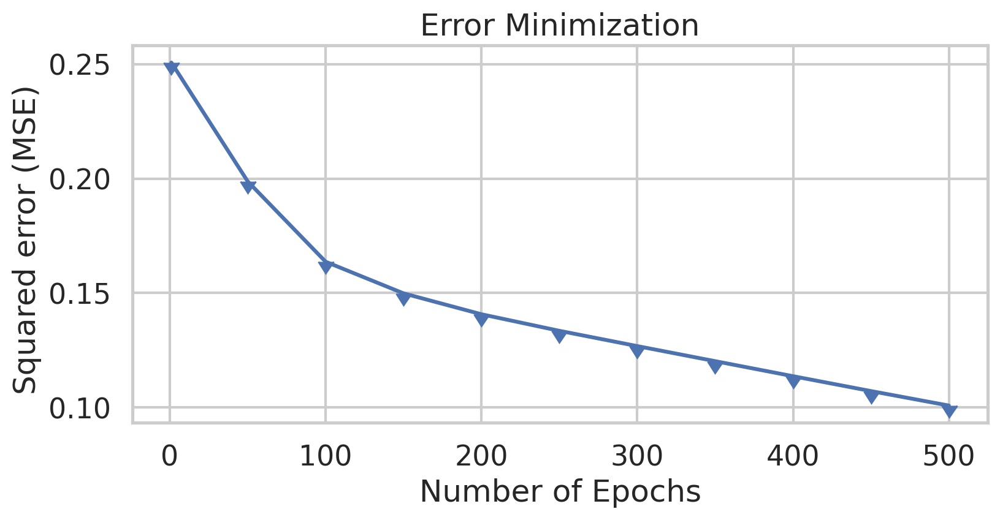

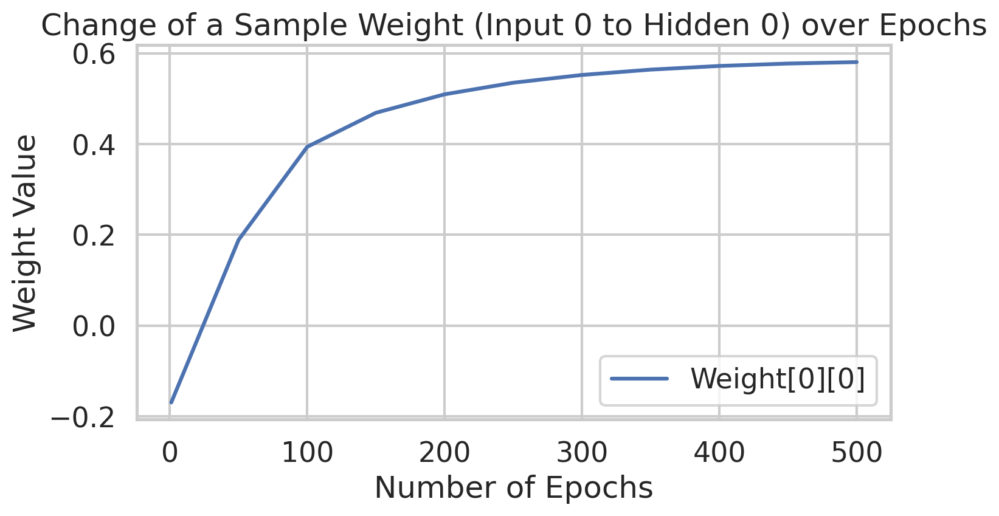

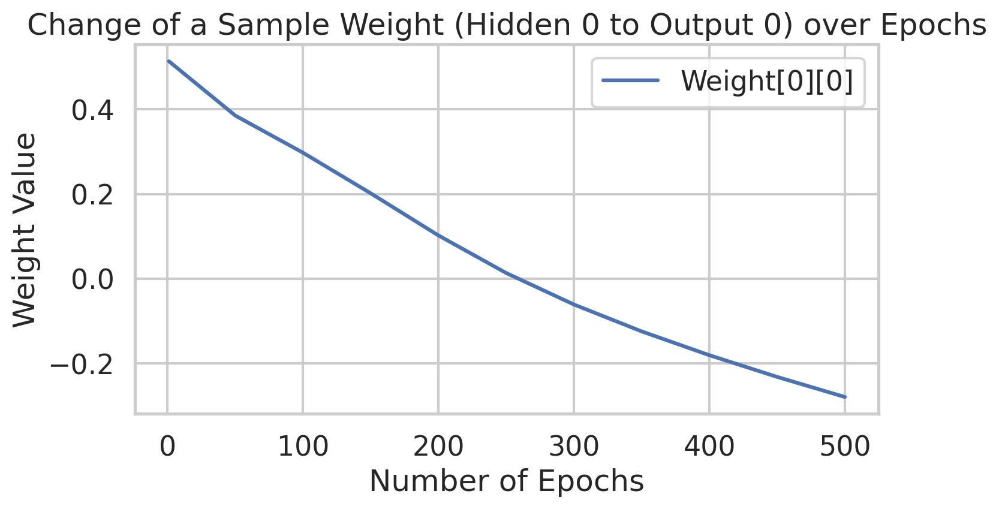


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.001
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.24115748063513048
Epoch  50 - Total Error:  0.1835710003161025
Epoch  100 - Total Error:  0.16930351801520363
Epoch  150 - Total Error:  0.1629488025766964
Epoch  200 - Total Error:  0.15947240487784084
Epoch  250 - Total Error:  0.15735432635112764
Epoch  300 - Total Error:  0.15593108487727844
Epoch  350 - Total Error:  0.15484016454931668
Epoch  400 - Total Error:  0.15373325545861088
Epoch  450 - Total Error:  0.1511605278356359
Epoch  500 - Total Error:  0.1376

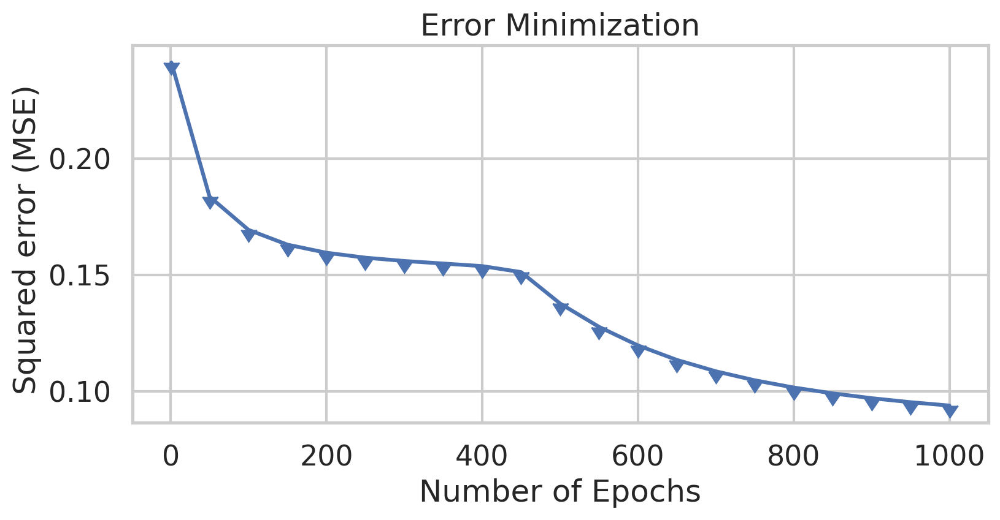

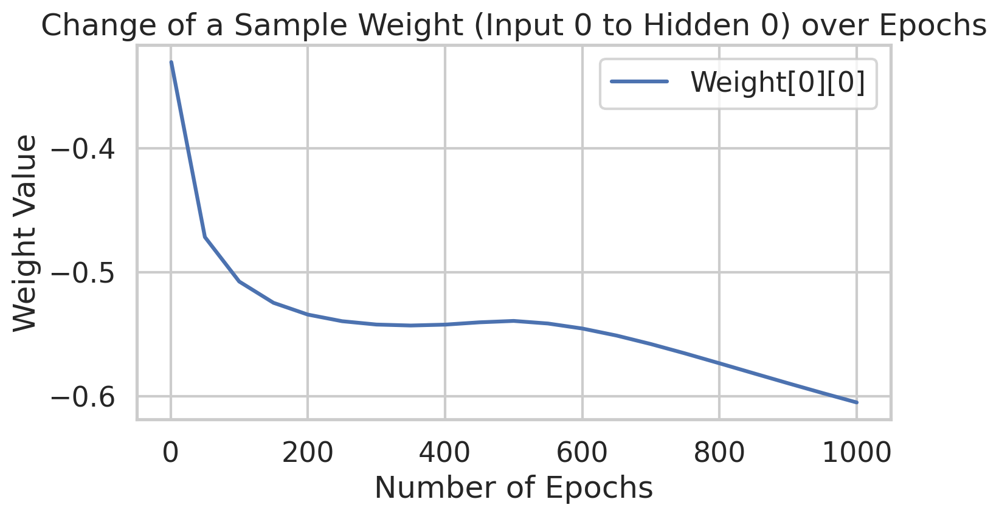

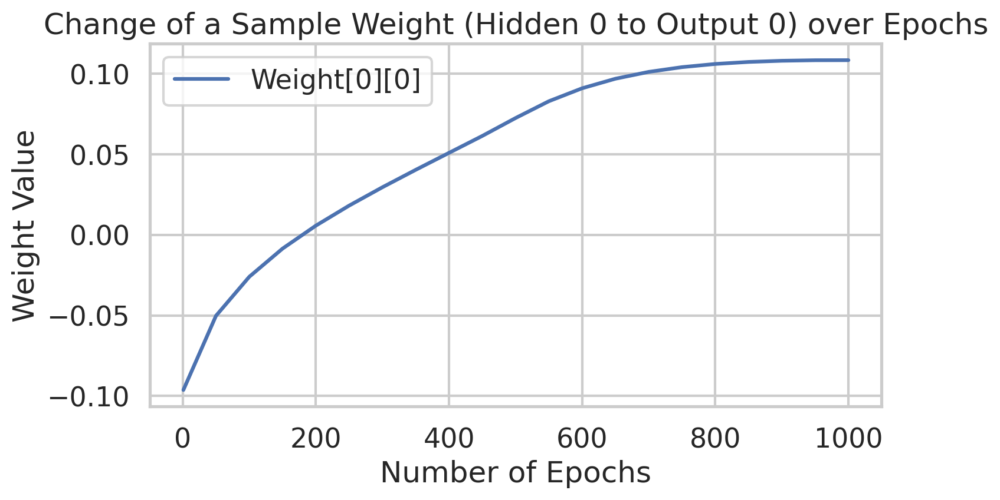


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.001
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.22230991797325977
Epoch  50 - Total Error:  0.18329344900777578
Epoch  100 - Total Error:  0.16000526227284462
Epoch  150 - Total Error:  0.14815945540620185
Epoch  200 - Total Error:  0.13849833982453663
Epoch  250 - Total Error:  0.13014340111447398
Epoch  300 - Total Error:  0.12265140824268478
Epoch  350 - Total Error:  0.11573088076189726
Epoch  400 - Total Error:  0.10921862867700914
Epoch  450 - Total Error:  0.1030421181784007
Epoch  500 - Total Error:  0.09

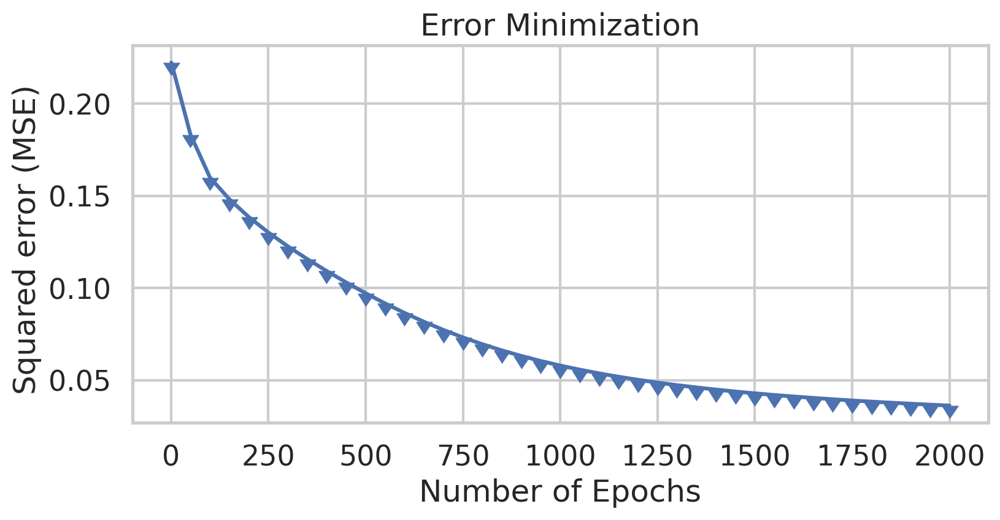

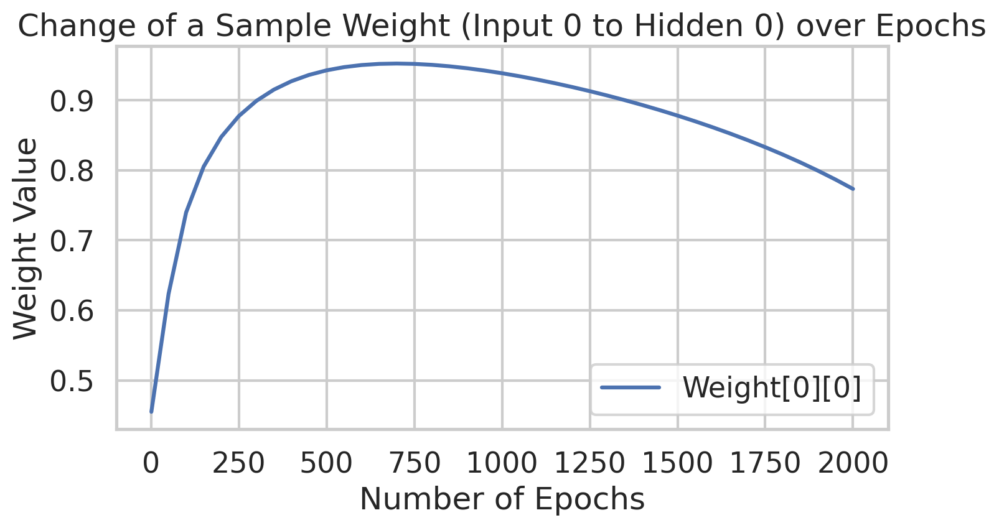

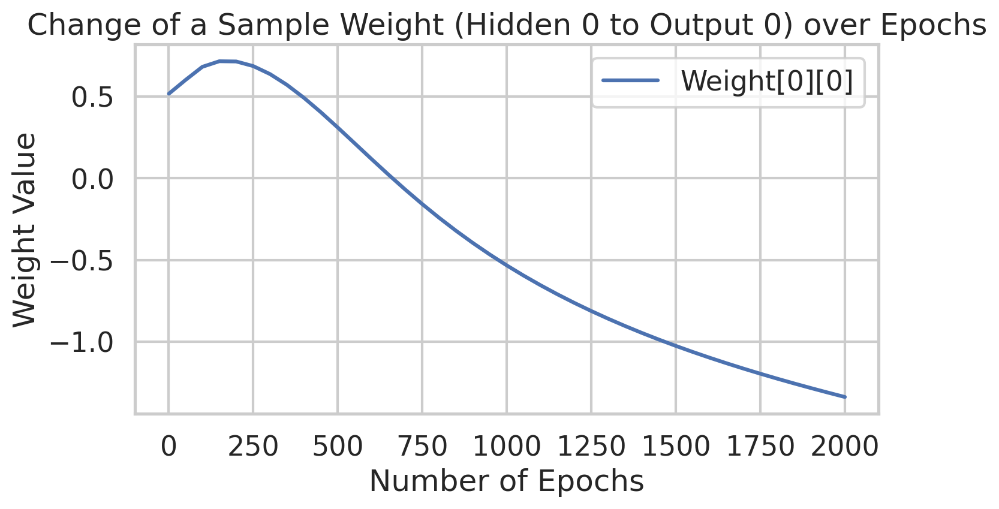


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.001
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.36370135115041285
Epoch  50 - Total Error:  0.221694324906534
Epoch  100 - Total Error:  0.17183633474493384
Epoch  150 - Total Error:  0.14599526513039743
Epoch  200 - Total Error:  0.12358498510890234
Epoch  250 - Total Error:  0.11209316133438545
Epoch  300 - Total Error:  0.10372222479673988
Epoch  350 - Total Error:  0.09694137804047344
Epoch  400 - Total Error:  0.09110529868225782
Epoch  450 - Total Error:  0.08591837323436854
Epoch  500 - Total Error:  0.081

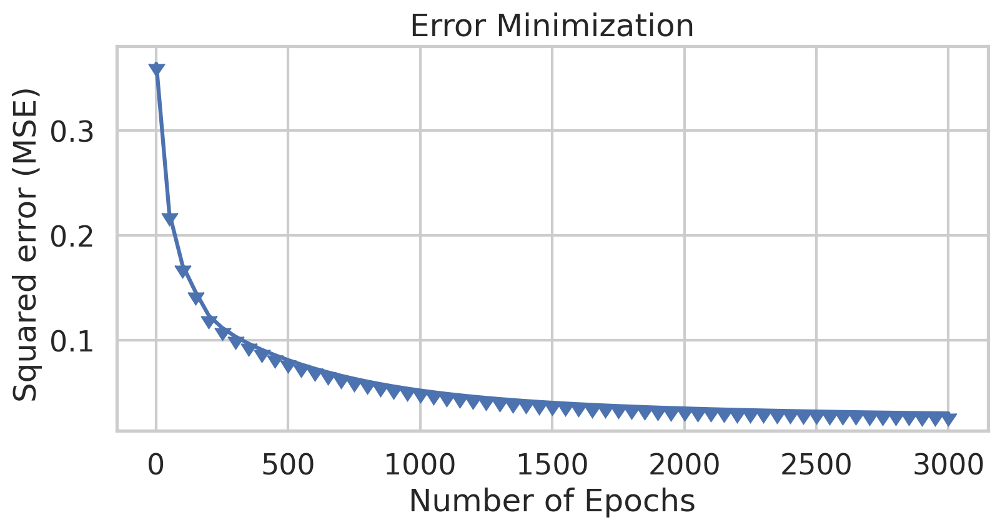

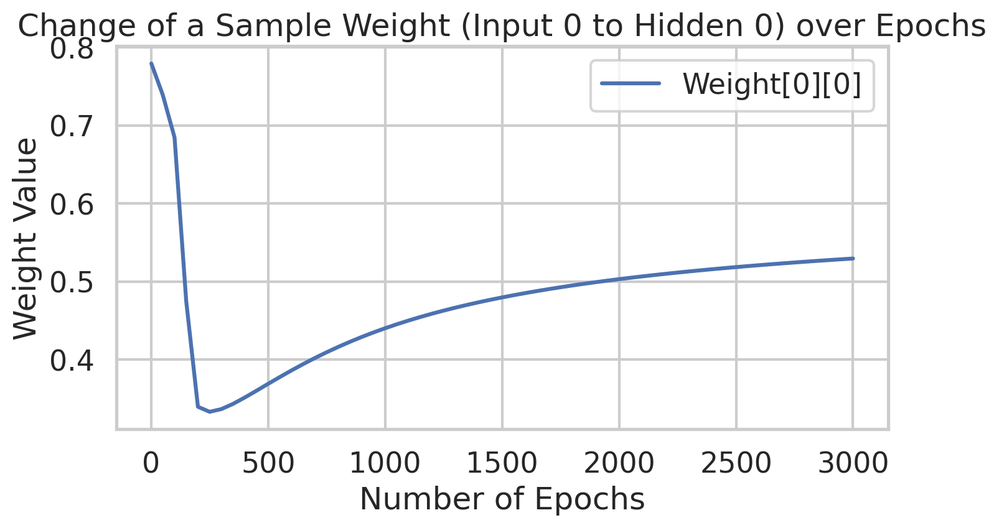

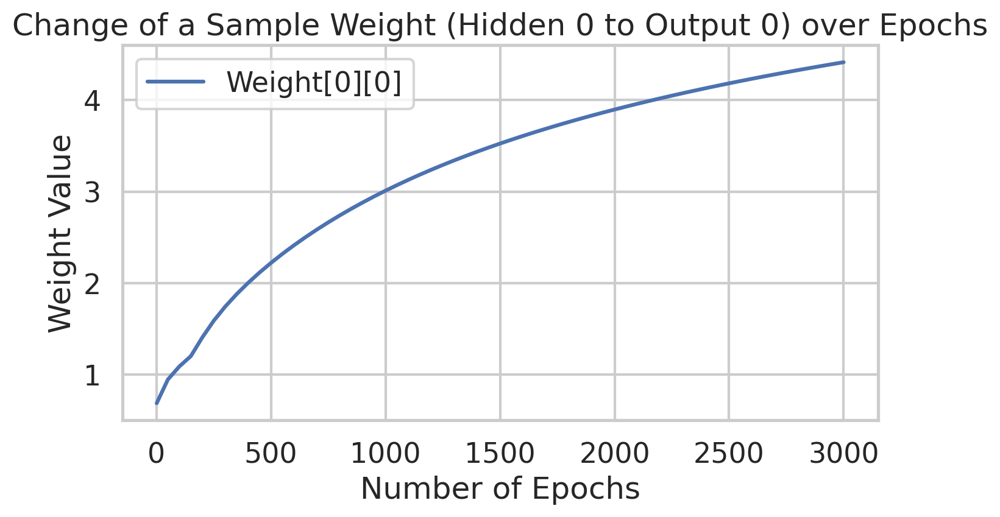


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.001
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.29538782678824815
Epoch  50 - Total Error:  0.16632980083017695
Epoch  100 - Total Error:  0.14594016148330555
Epoch  150 - Total Error:  0.13381089237737945
Epoch  200 - Total Error:  0.1252218387475311
Epoch  250 - Total Error:  0.1181697527816271
Epoch  300 - Total Error:  0.11188219348650318
Epoch  350 - Total Error:  0.10599789068779596
Epoch  400 - Total Error:  0.10023809962944892
Epoch  450 - Total Error:  0.09387221753498727
Epoch  500 - Total Error:  0.083

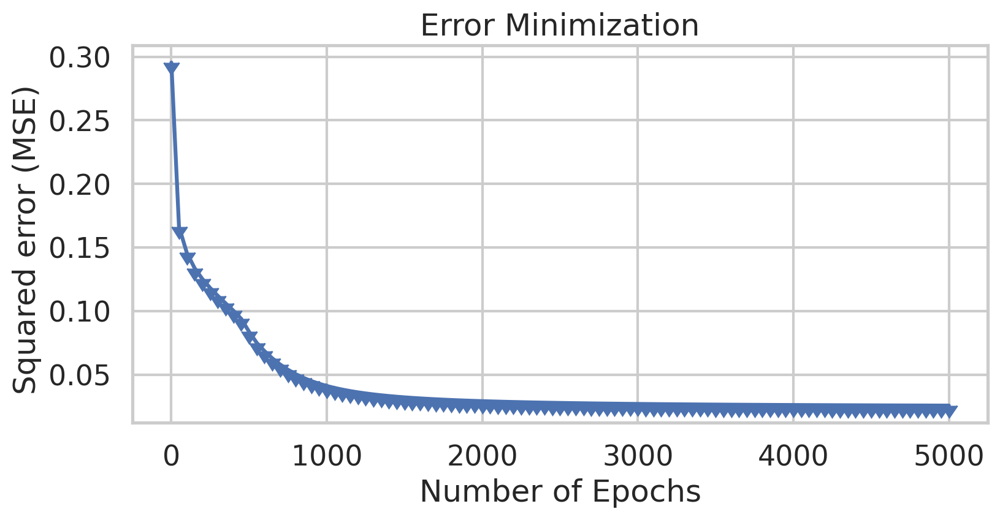

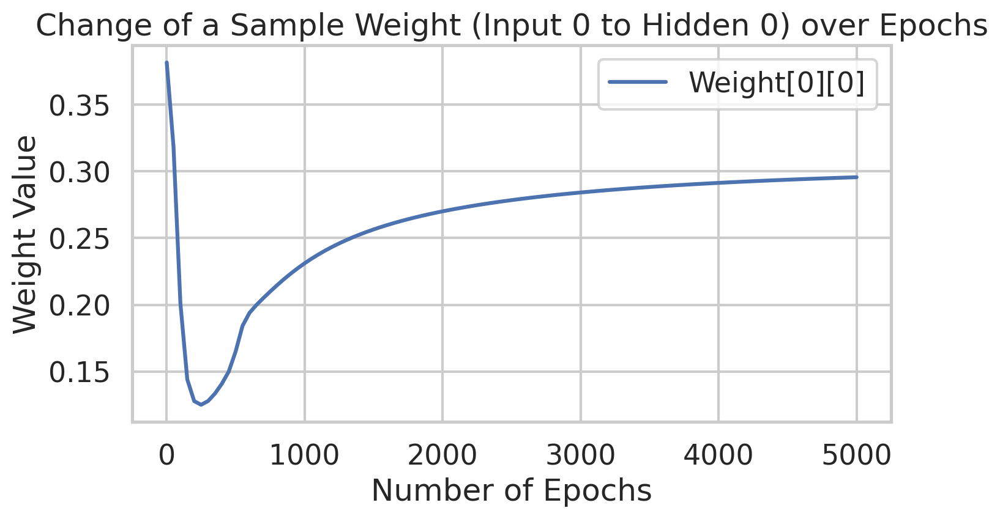

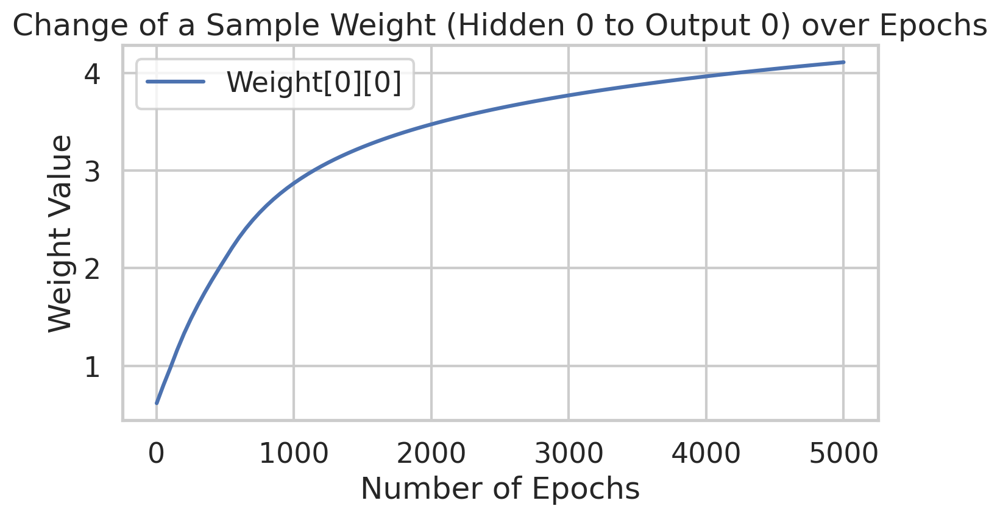


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.005
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.18254314772292587
Epoch  50 - Total Error:  0.13674715154182515
Epoch  100 - Total Error:  0.10089080247548679
Epoch  150 - Total Error:  0.07213222303897236
Epoch  200 - Total Error:  0.0542500062867726
Epoch  250 - Total Error:  0.04420355237920603
Epoch  300 - Total Error:  0.03844808789035147
Epoch  350 - Total Error:  0.03494070336002217
Epoch  400 - Total Error:  0.03266206645862969
Epoch  450 - Total Error:  0.03109777687610506
Epoch  500 - Total Error:  0.029

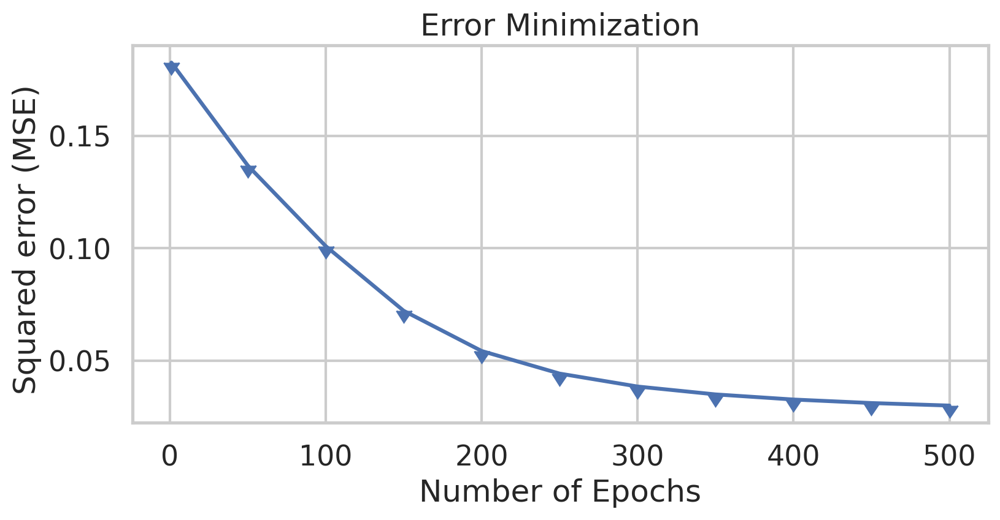

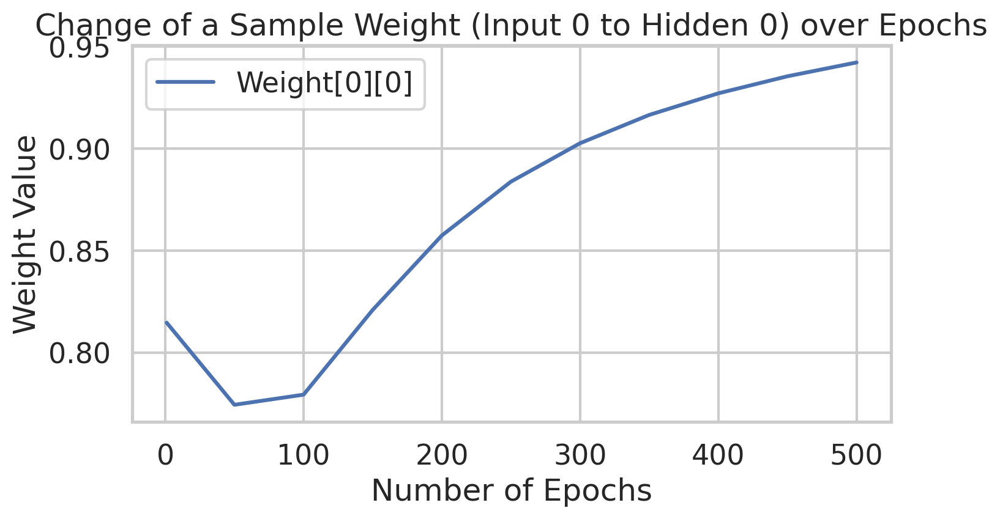

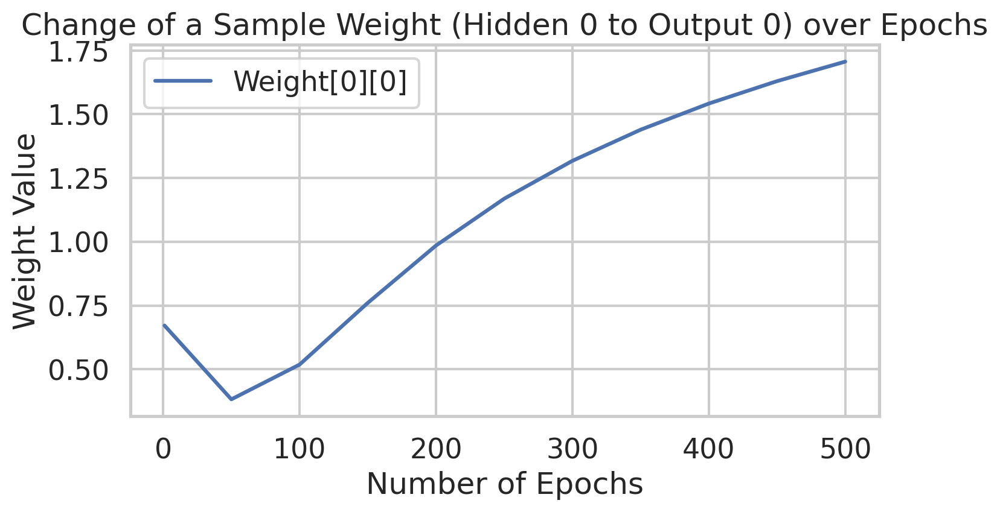


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.005
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2619536885452506
Epoch  50 - Total Error:  0.2496493521095302
Epoch  100 - Total Error:  0.1796012901403653
Epoch  150 - Total Error:  0.08279914081454028
Epoch  200 - Total Error:  0.061531311895767174
Epoch  250 - Total Error:  0.05063904169029088
Epoch  300 - Total Error:  0.043984715209367094
Epoch  350 - Total Error:  0.03962834954692397
Epoch  400 - Total Error:  0.0366058126400466
Epoch  450 - Total Error:  0.034393998368293634
Epoch  500 - Total Error:  0.03

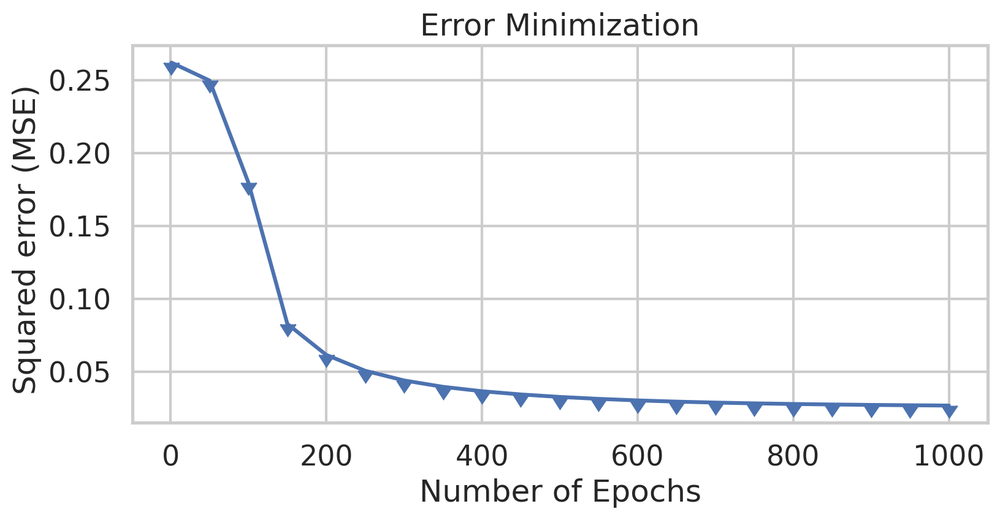

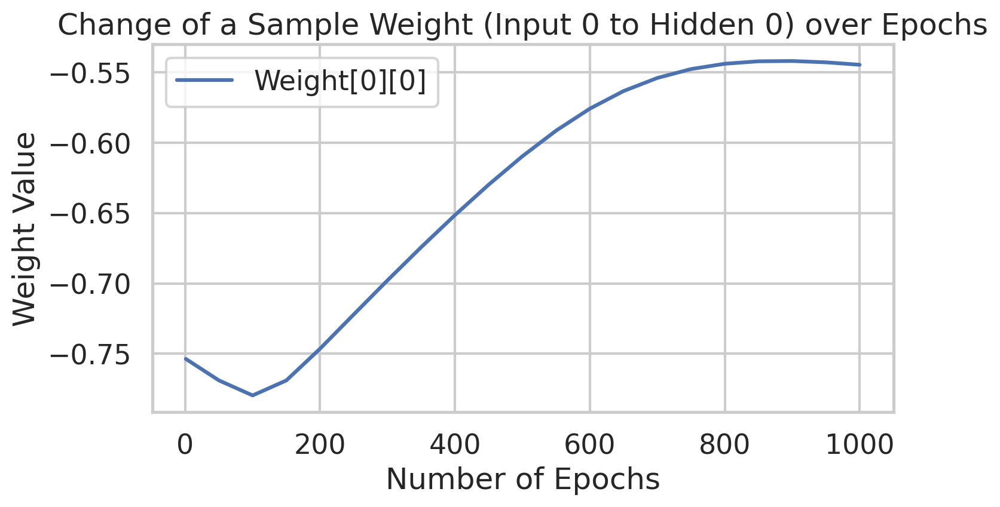

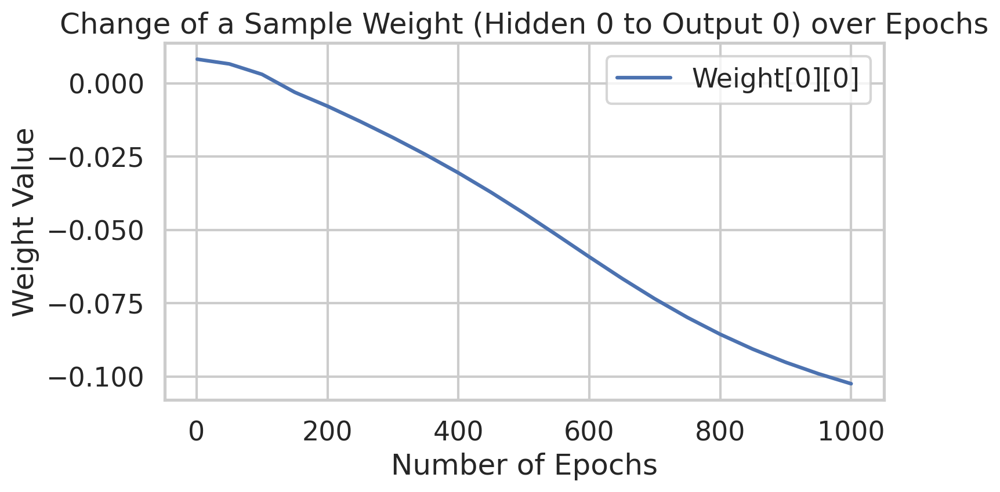


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.005
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.21529680591344919
Epoch  50 - Total Error:  0.12269734627121534
Epoch  100 - Total Error:  0.09106317710504046
Epoch  150 - Total Error:  0.06933975353528081
Epoch  200 - Total Error:  0.055855500199787404
Epoch  250 - Total Error:  0.047537702122689394
Epoch  300 - Total Error:  0.04219116140007318
Epoch  350 - Total Error:  0.03858198939104563
Epoch  400 - Total Error:  0.03603424546188871
Epoch  450 - Total Error:  0.03416589698952533
Epoch  500 - Total Error:  0

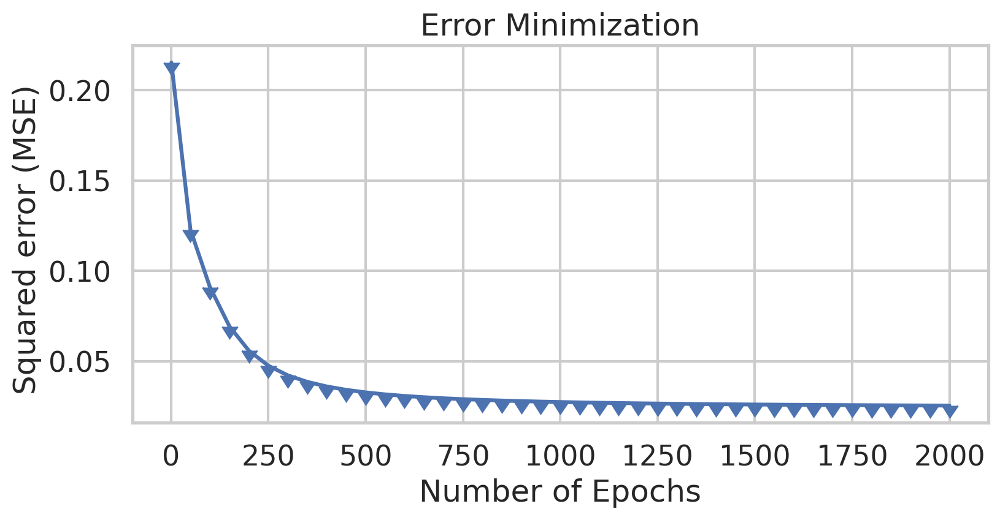

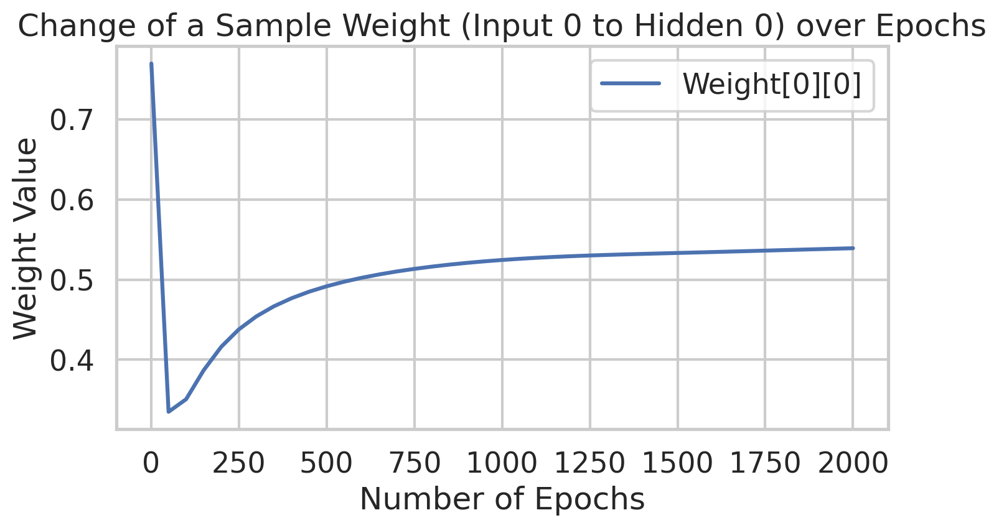

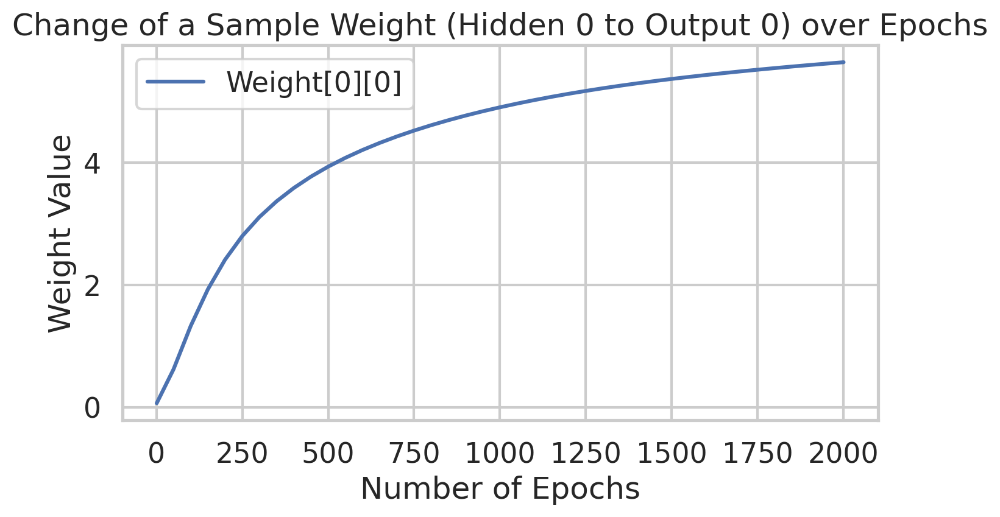


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.005
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.30816762992035024
Epoch  50 - Total Error:  0.0935786452835275
Epoch  100 - Total Error:  0.06673033987375693
Epoch  150 - Total Error:  0.049912785060700036
Epoch  200 - Total Error:  0.039463684535558506
Epoch  250 - Total Error:  0.03426706044390209
Epoch  300 - Total Error:  0.03153596597975828
Epoch  350 - Total Error:  0.029922279956186158
Epoch  400 - Total Error:  0.028874009935506005
Epoch  450 - Total Error:  0.028143521994697038
Epoch  500 - Total Error: 

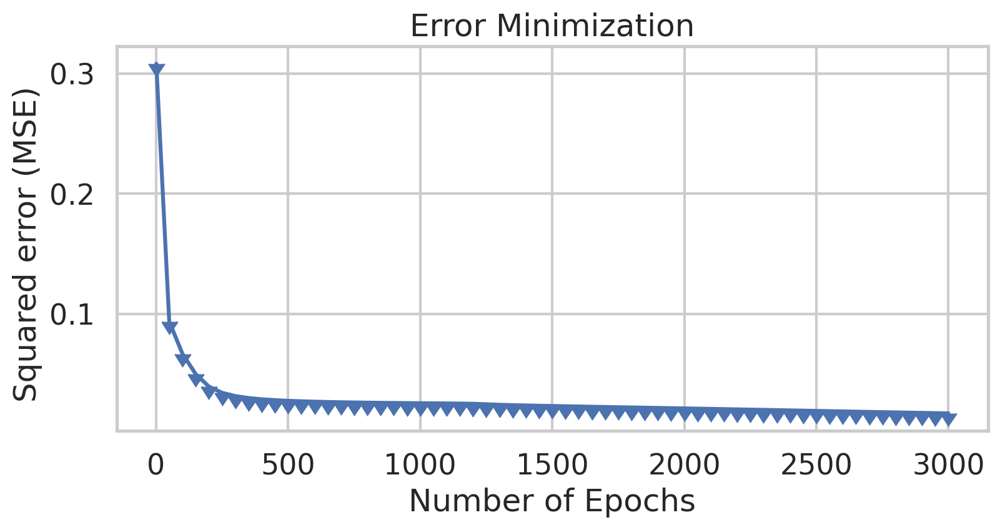

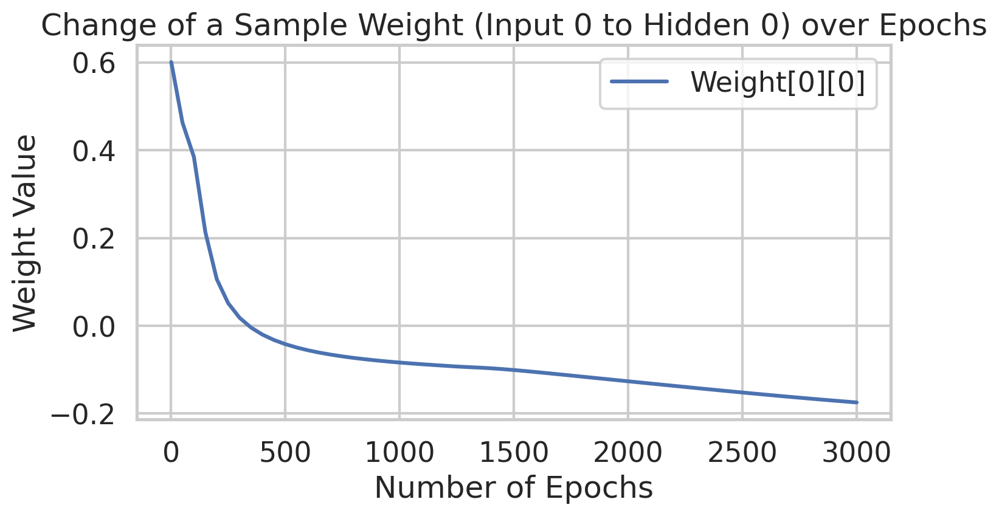

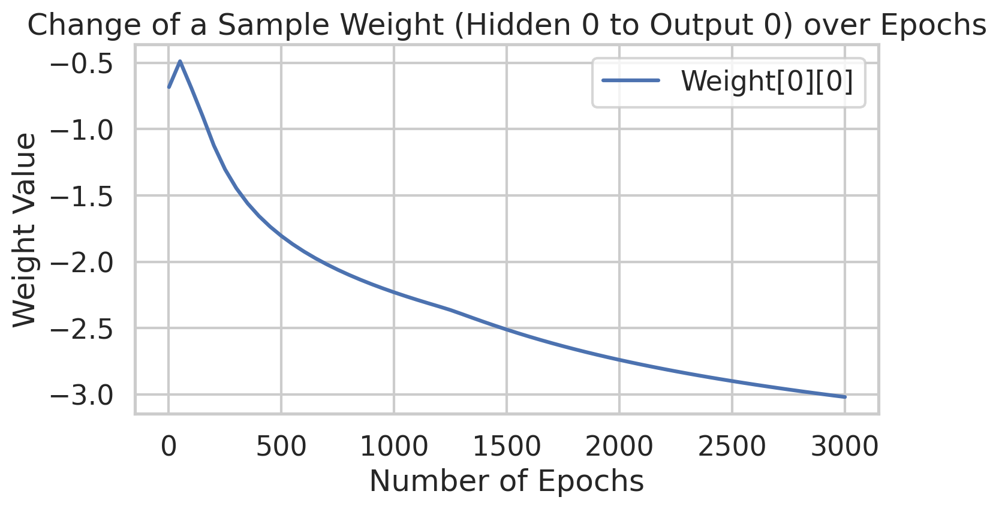


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.005
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1895583300791384
Epoch  50 - Total Error:  0.15249398324971114
Epoch  100 - Total Error:  0.08930295591461247
Epoch  150 - Total Error:  0.0539214734973645
Epoch  200 - Total Error:  0.04064128268314374
Epoch  250 - Total Error:  0.034965807834901885
Epoch  300 - Total Error:  0.03205713601084104
Epoch  350 - Total Error:  0.0303485789782514
Epoch  400 - Total Error:  0.02924248195722277
Epoch  450 - Total Error:  0.02847389519453005
Epoch  500 - Total Error:  0.027

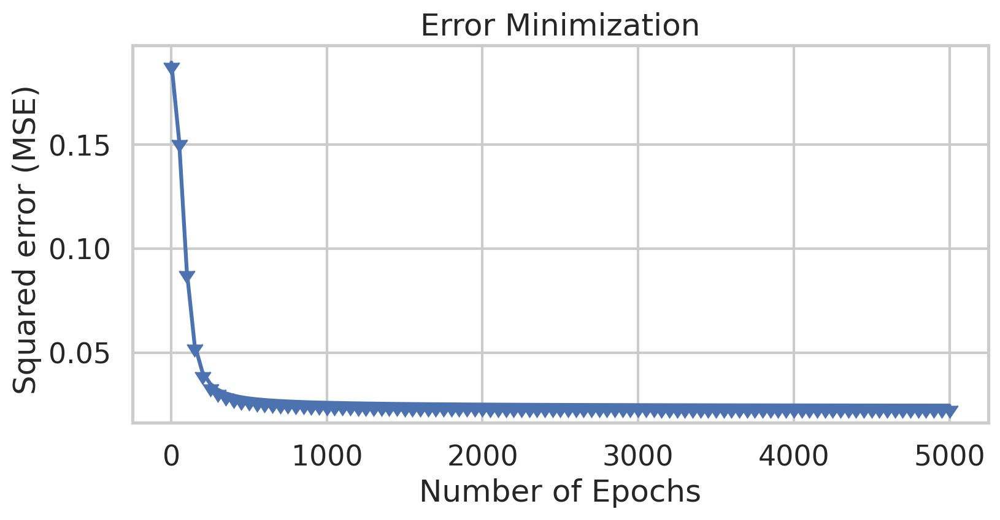

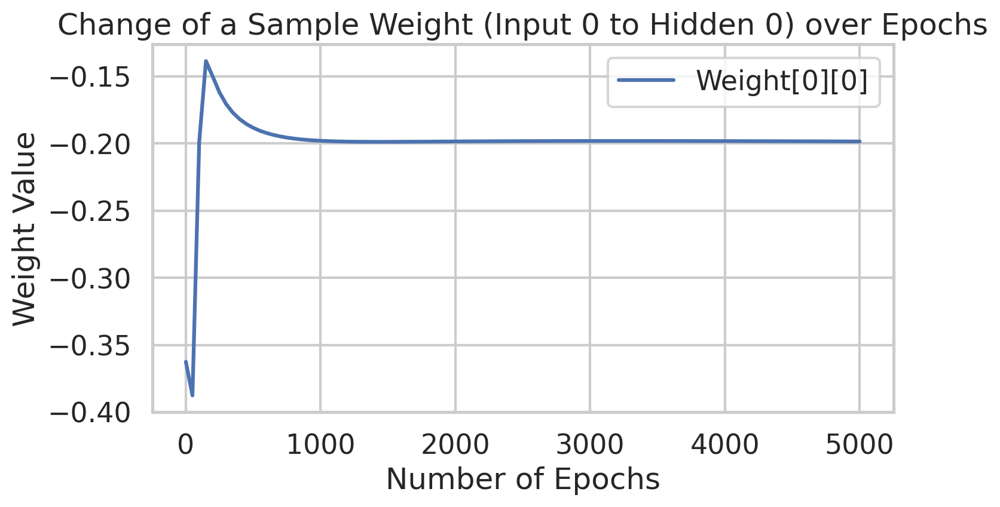

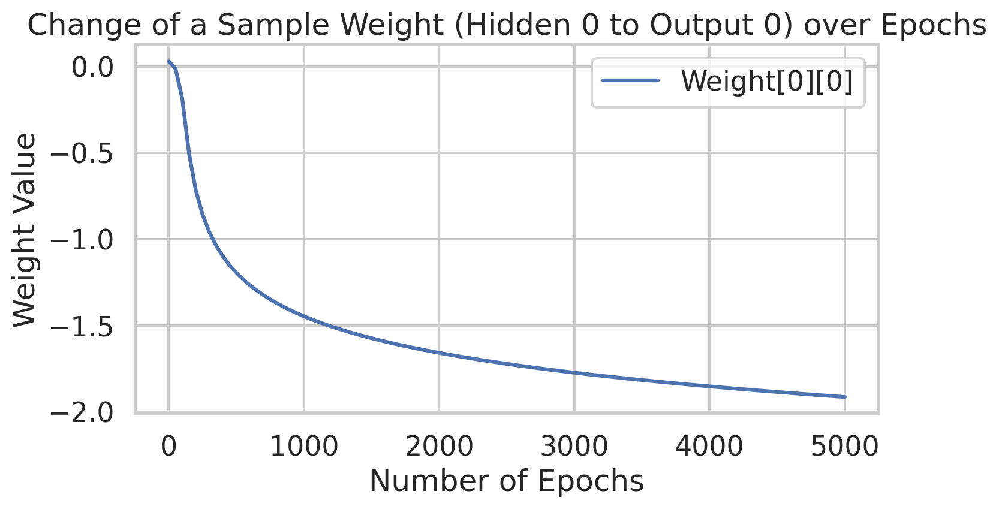


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.01
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.41268951456941055
Epoch  50 - Total Error:  0.1550152061516479
Epoch  100 - Total Error:  0.15290048717541474
Epoch  150 - Total Error:  0.1523711919281053
Epoch  200 - Total Error:  0.15204489771146365
Epoch  250 - Total Error:  0.15039808746796993
Epoch  300 - Total Error:  0.1101074423811448
Epoch  350 - Total Error:  0.06465263165141666
Epoch  400 - Total Error:  0.04623133075645588
Epoch  450 - Total Error:  0.038438908252265806
Epoch  500 - Total Error:  0.03447

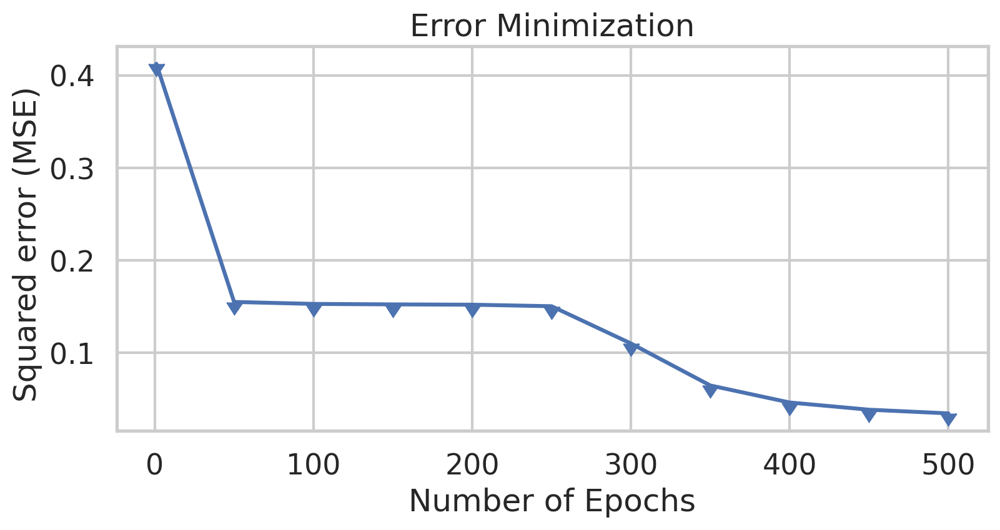

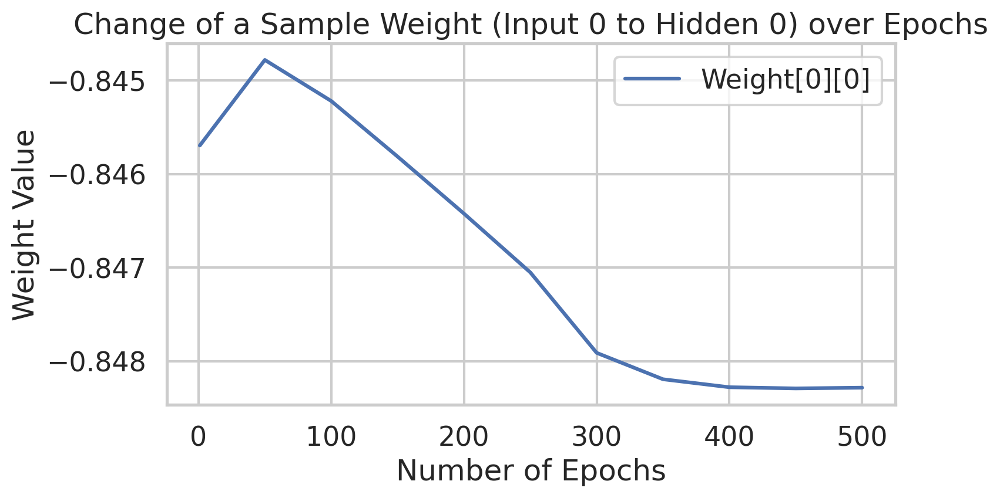

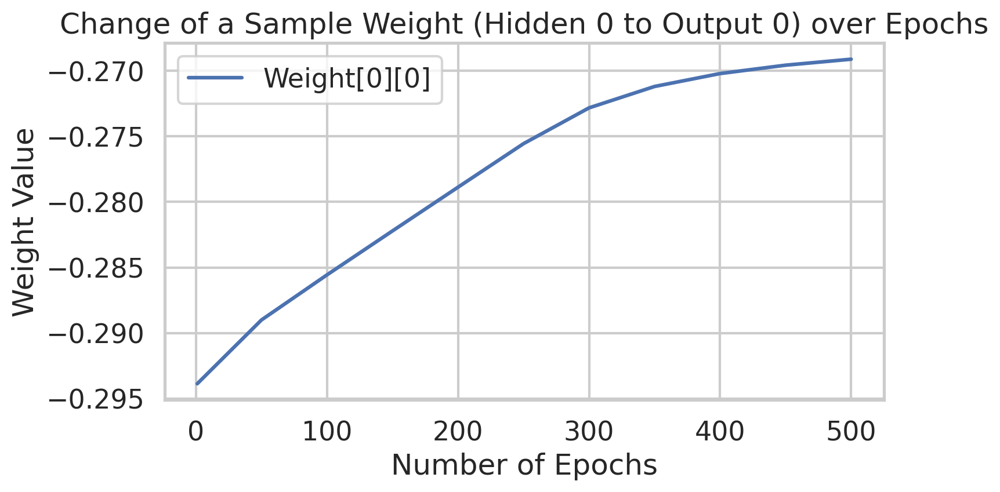


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 94.17% hits and 5.83% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 80 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.01
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.22503159869970218
Epoch  50 - Total Error:  0.13441289091773473
Epoch  100 - Total Error:  0.07416444825363872
Epoch  150 - Total Error:  0.048688210400190085
Epoch  200 - Total Error:  0.03925268005741488
Epoch  250 - Total Error:  0.0345443522856087
Epoch  300 - Total Error:  0.031700167323999356
Epoch  350 - Total Error:  0.029889302567173814
Epoch  400 - Total Error:  0.028730736642991826
Epoch  450 - Total Error:  0.02794379082669506
Epoch  500 - Total Error:  0

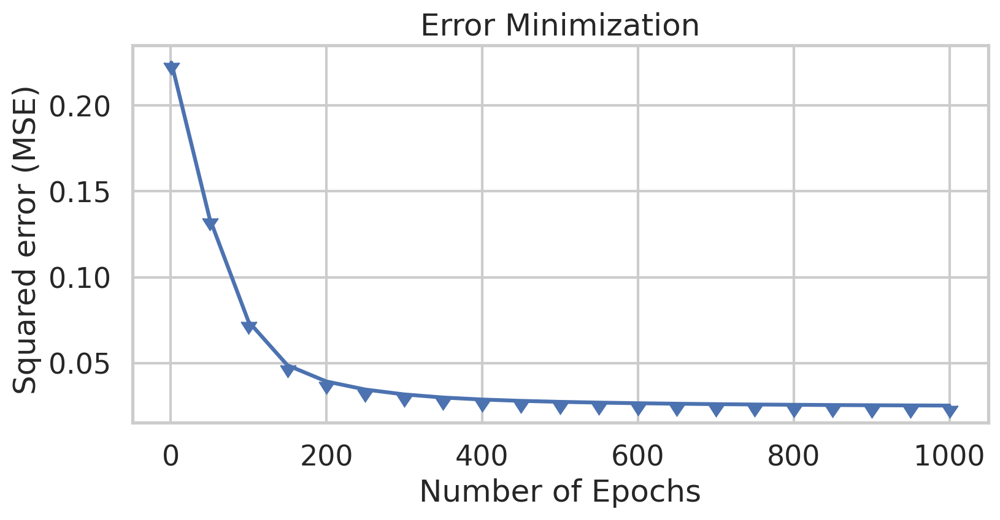

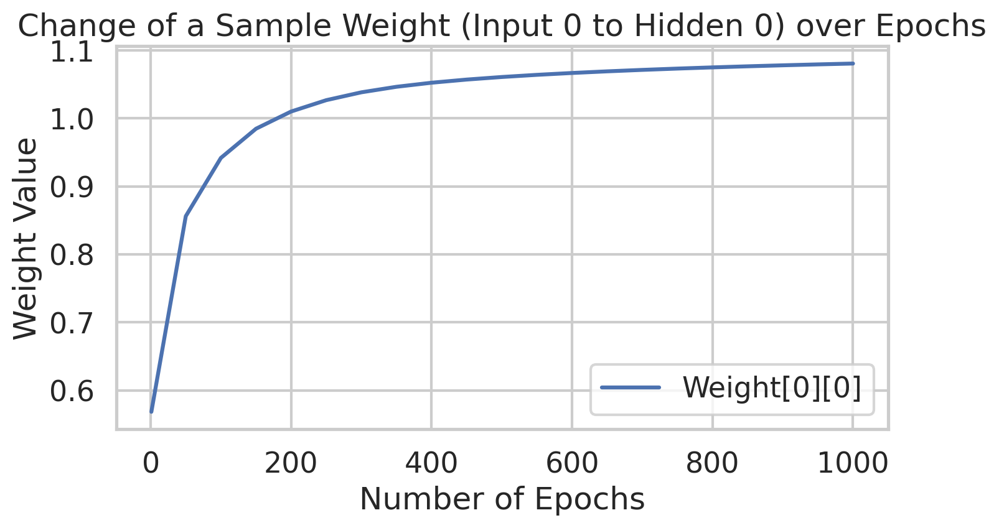

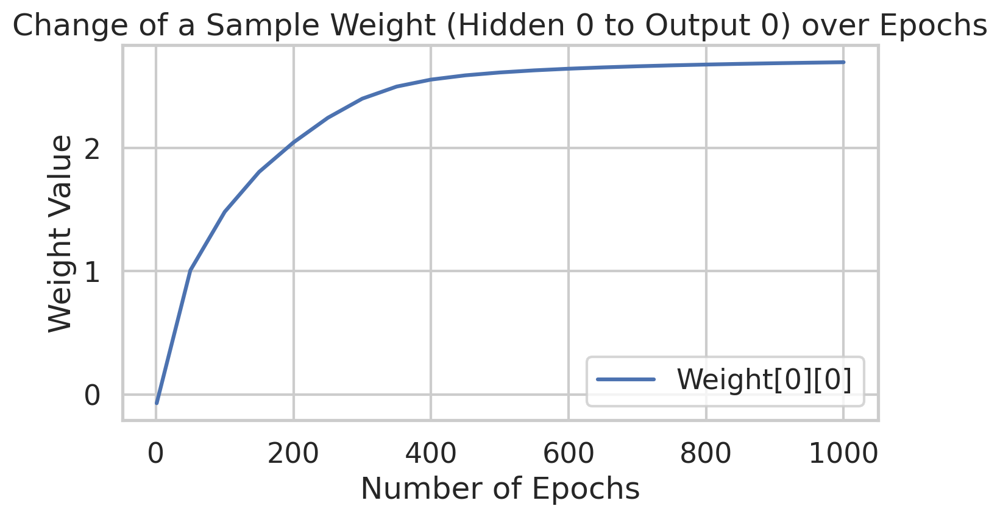


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 32 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.01
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.19273951050516994
Epoch  50 - Total Error:  0.15440950684022578
Epoch  100 - Total Error:  0.15288487033705722
Epoch  150 - Total Error:  0.15245973800660742
Epoch  200 - Total Error:  0.15227282539956846
Epoch  250 - Total Error:  0.15217185184027987
Epoch  300 - Total Error:  0.15211008411070054
Epoch  350 - Total Error:  0.15206877728080043
Epoch  400 - Total Error:  0.15203901990194615
Epoch  450 - Total Error:  0.15201597932302624
Epoch  500 - Total Error:  0.15

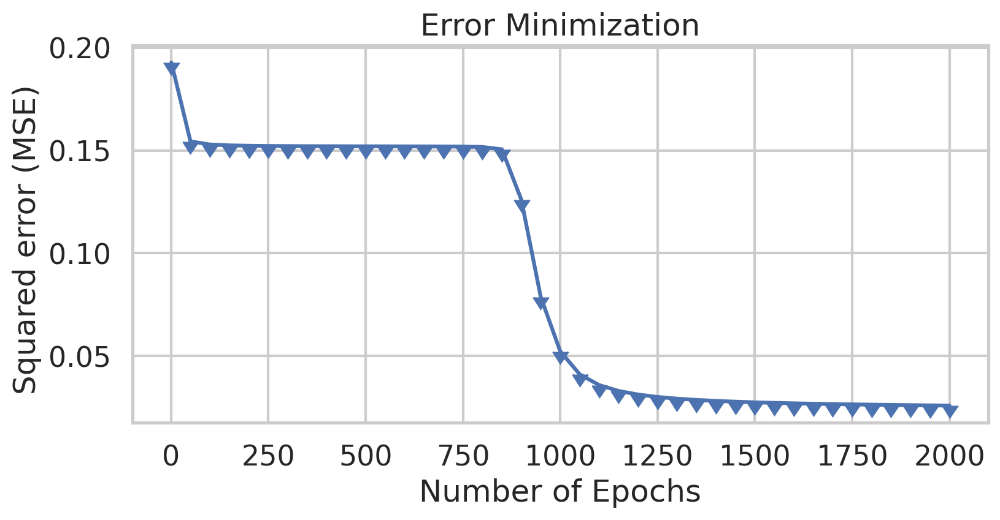

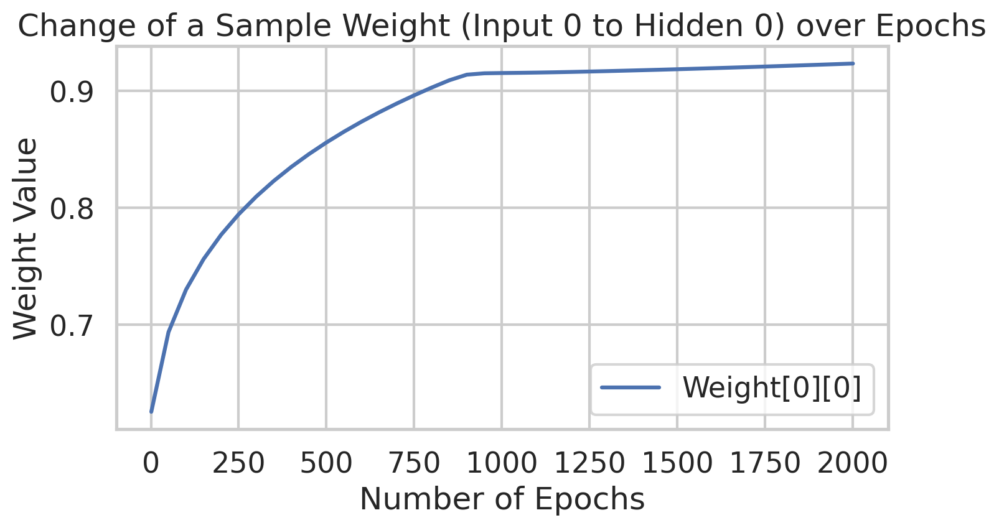

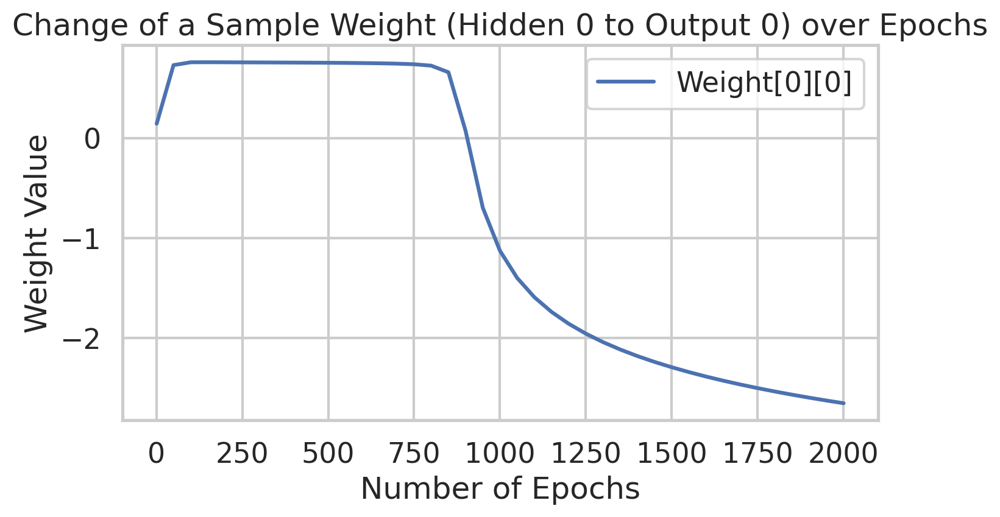


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.01
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2124759134133801
Epoch  50 - Total Error:  0.07497759531172513
Epoch  100 - Total Error:  0.045720332305512645
Epoch  150 - Total Error:  0.03410647877561275
Epoch  200 - Total Error:  0.03004230927878703
Epoch  250 - Total Error:  0.02824651102190222
Epoch  300 - Total Error:  0.027272371545570995
Epoch  350 - Total Error:  0.026668716323311636
Epoch  400 - Total Error:  0.02625968591139202
Epoch  450 - Total Error:  0.025964385763961633
Epoch  500 - Total Error:  0

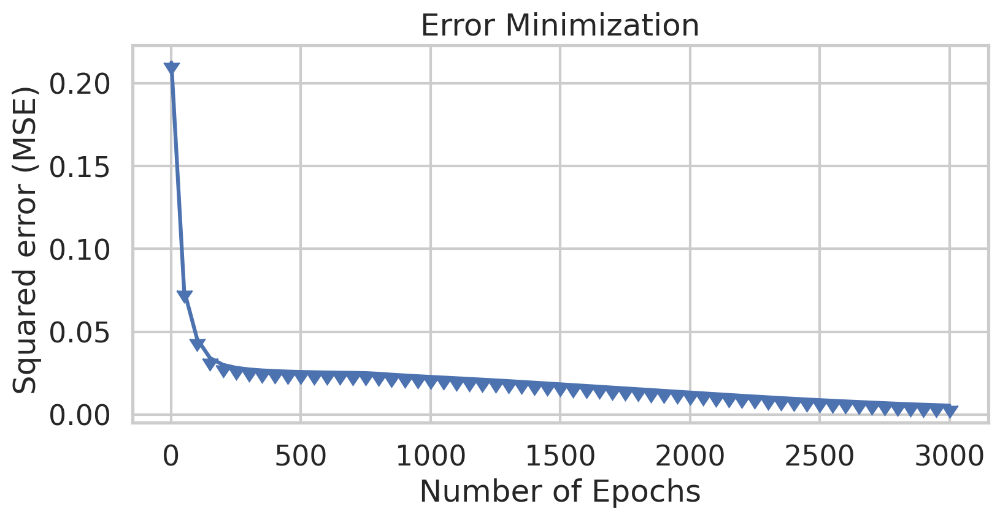

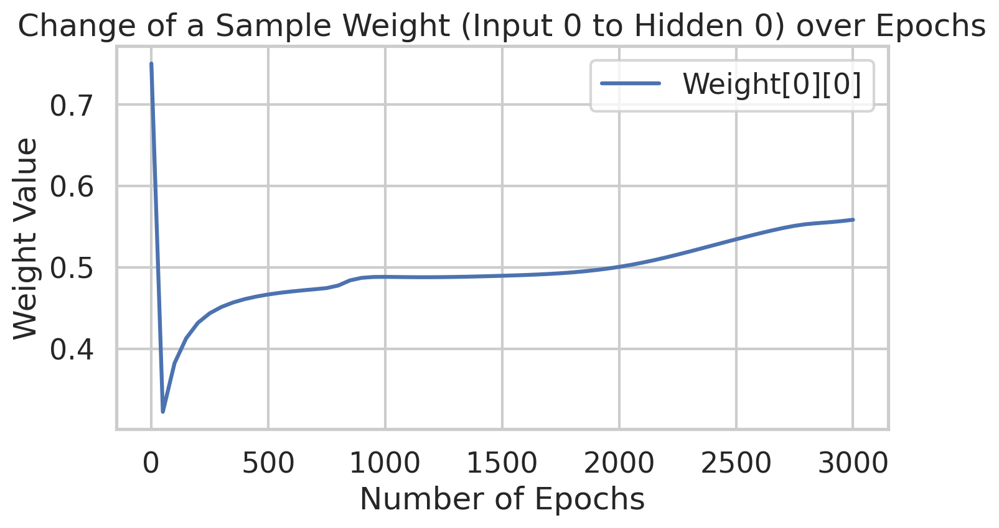

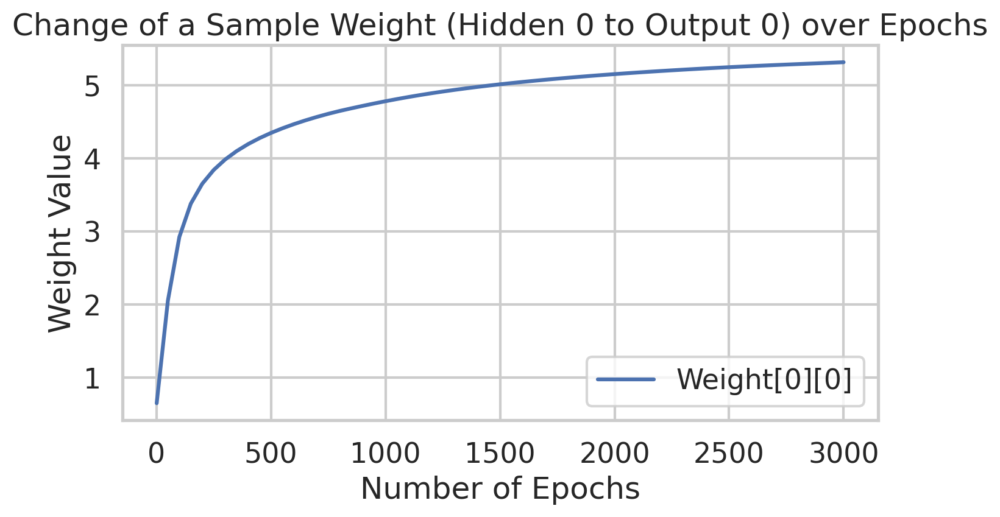


=== Test Results ===
Porcents : 93.33% hits and 6.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 19 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 92.50% hits and 7.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 78 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.01
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.32800767566994854
Epoch  50 - Total Error:  0.15306200182565163
Epoch  100 - Total Error:  0.15217337799452893
Epoch  150 - Total Error:  0.150693726236566
Epoch  200 - Total Error:  0.11450688758575764
Epoch  250 - Total Error:  0.06201782878402807
Epoch  300 - Total Error:  0.04383377430026005
Epoch  350 - Total Error:  0.03679310672039449
Epoch  400 - Total Error:  0.03332214350593228
Epoch  450 - Total Error:  0.031315497791929
Epoch  500 - Total Error:  0.030025

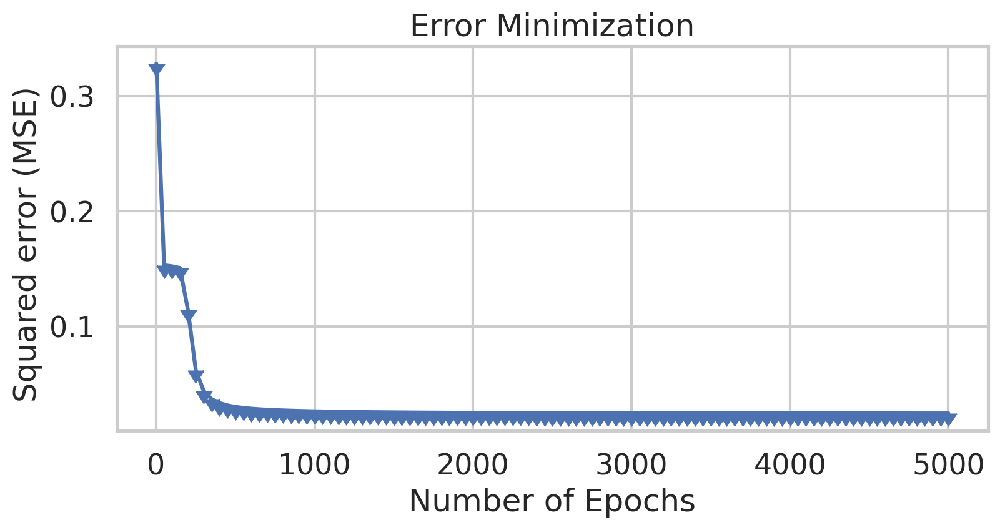

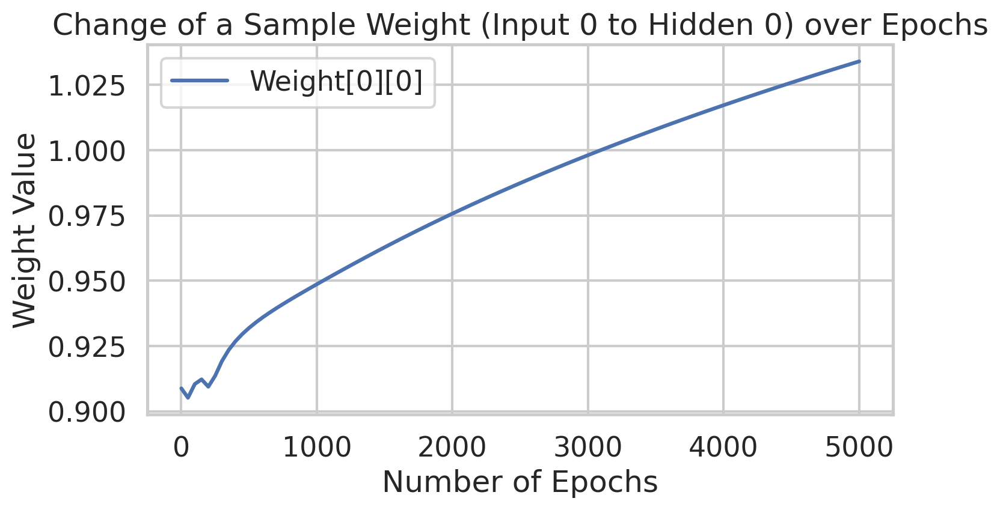

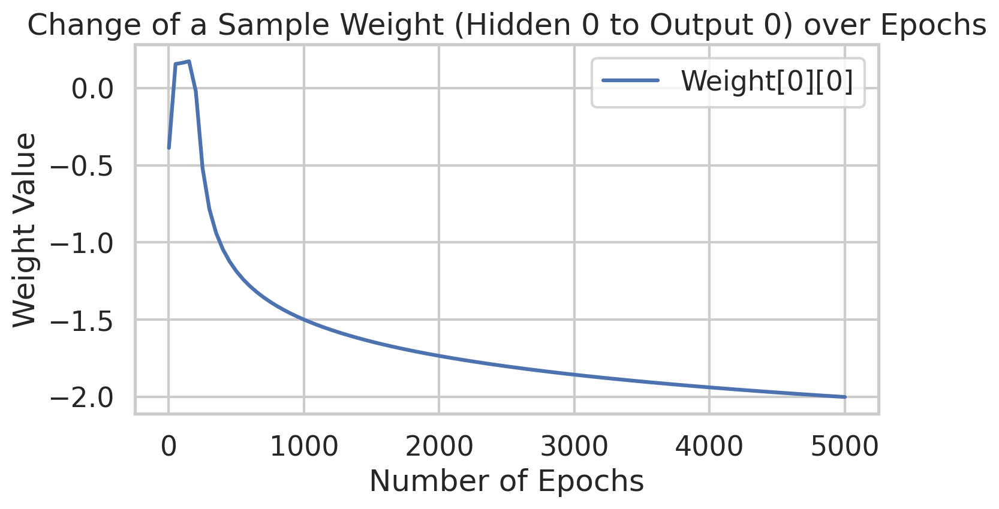


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.05
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.23612742342905518
Epoch  50 - Total Error:  0.0522306577095067
Epoch  100 - Total Error:  0.030180212549460832
Epoch  150 - Total Error:  0.027542484489572017
Epoch  200 - Total Error:  0.026543768388104173
Epoch  250 - Total Error:  0.025969501526064875
Epoch  300 - Total Error:  0.02556941375970583
Epoch  350 - Total Error:  0.02527479771742378
Epoch  400 - Total Error:  0.025060147396760067
Epoch  450 - Total Error:  0.024905640140340614
Epoch  500 - Total Error:  

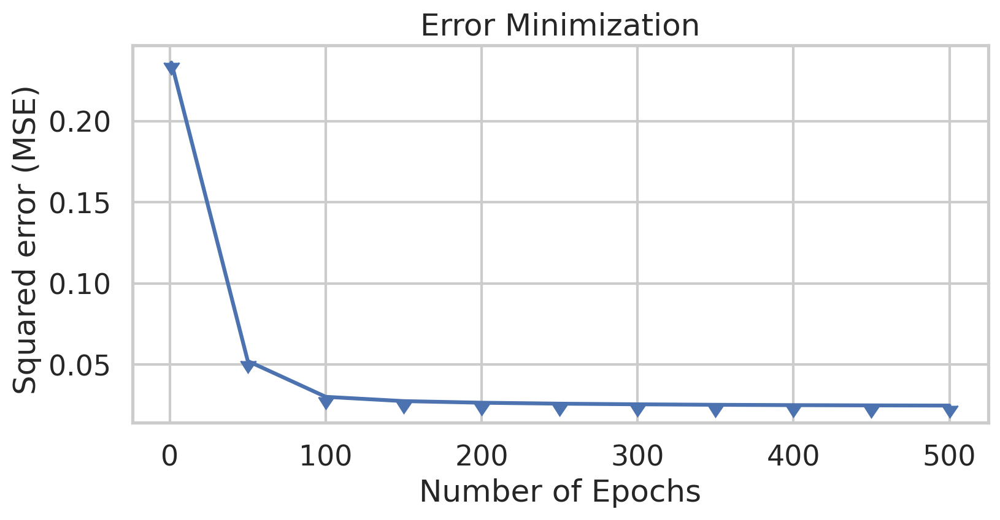

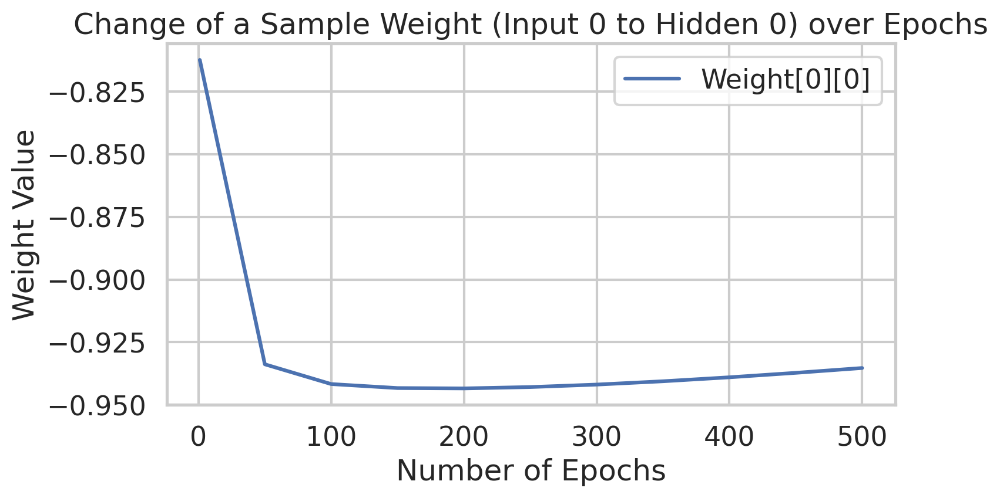

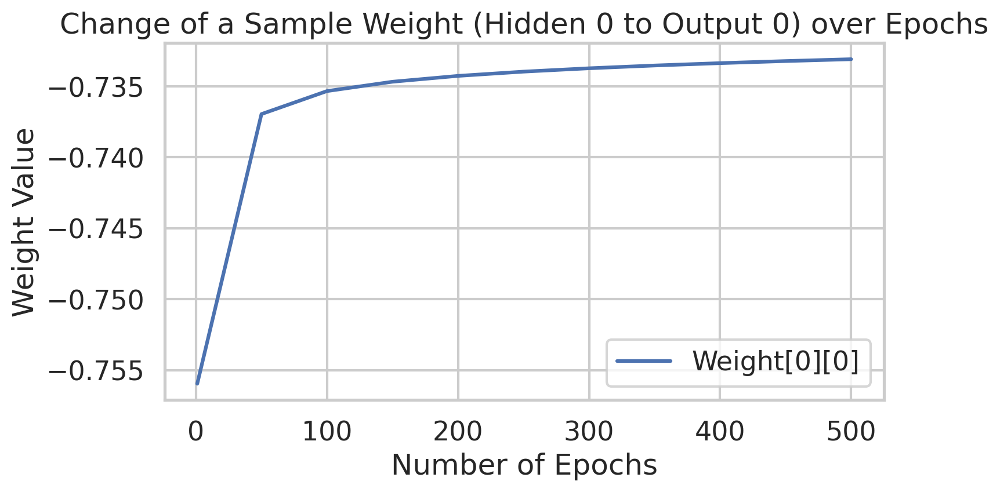


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.05
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1863239456055439
Epoch  50 - Total Error:  0.1528730710034169
Epoch  100 - Total Error:  0.15280623735952523
Epoch  150 - Total Error:  0.15278434672989497
Epoch  200 - Total Error:  0.1527727347013764
Epoch  250 - Total Error:  0.15276501244943705
Epoch  300 - Total Error:  0.15275878240140076
Epoch  350 - Total Error:  0.15275231454979524
Epoch  400 - Total Error:  0.15274206306051136
Epoch  450 - Total Error:  0.15269767825981453
Epoch  500 - Total Error:  0.04303

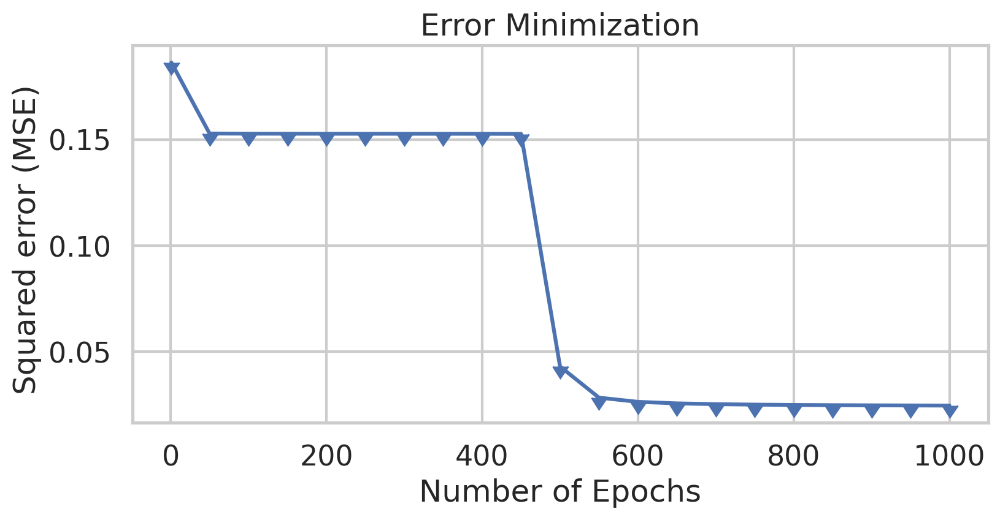

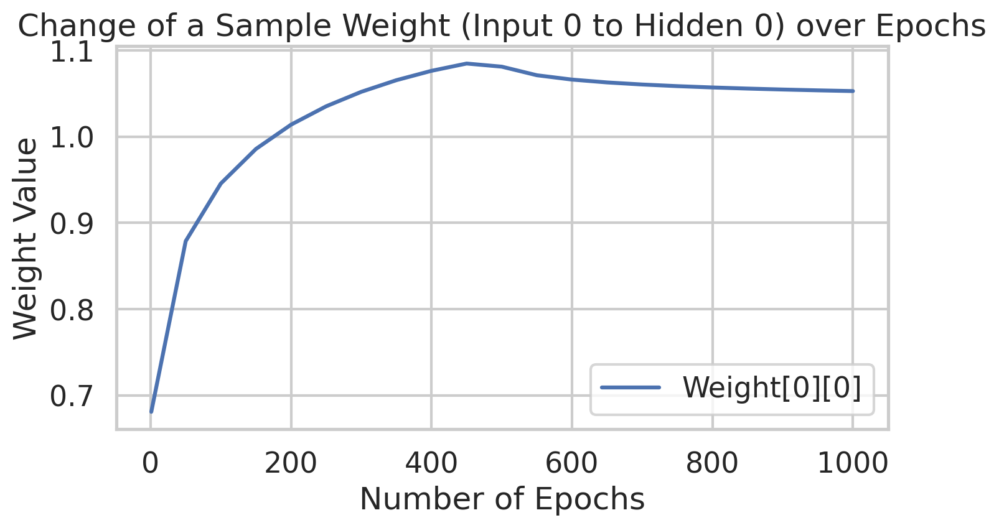

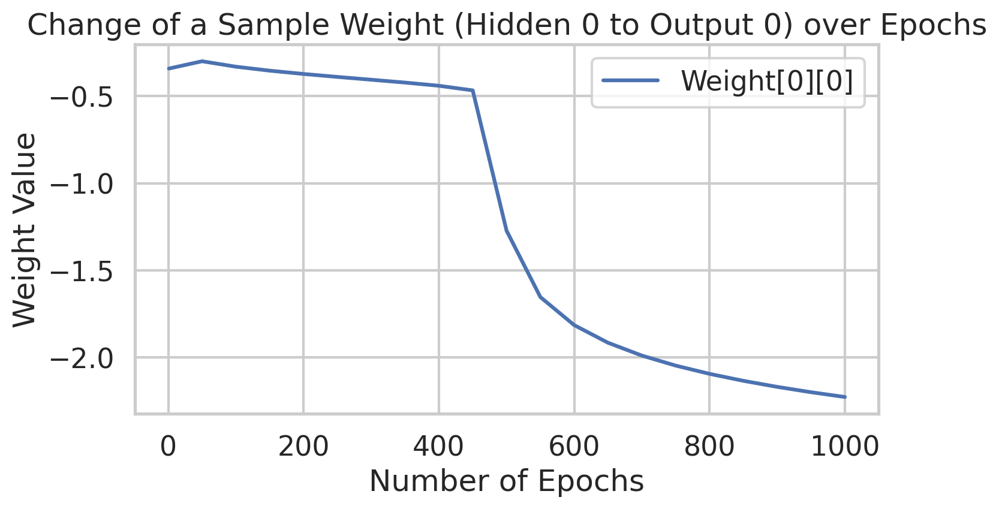


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 93.33% hits and 6.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 79 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.05
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.17822837797502436
Epoch  50 - Total Error:  0.027652716444652736
Epoch  100 - Total Error:  0.025605588335024552
Epoch  150 - Total Error:  0.025082037026861435
Epoch  200 - Total Error:  0.02484039360337378
Epoch  250 - Total Error:  0.024700323982008866
Epoch  300 - Total Error:  0.024608570591650065
Epoch  350 - Total Error:  0.02454367121138412
Epoch  400 - Total Error:  0.02449527397558129
Epoch  450 - Total Error:  0.02445775837029017
Epoch  500 - Total Error: 

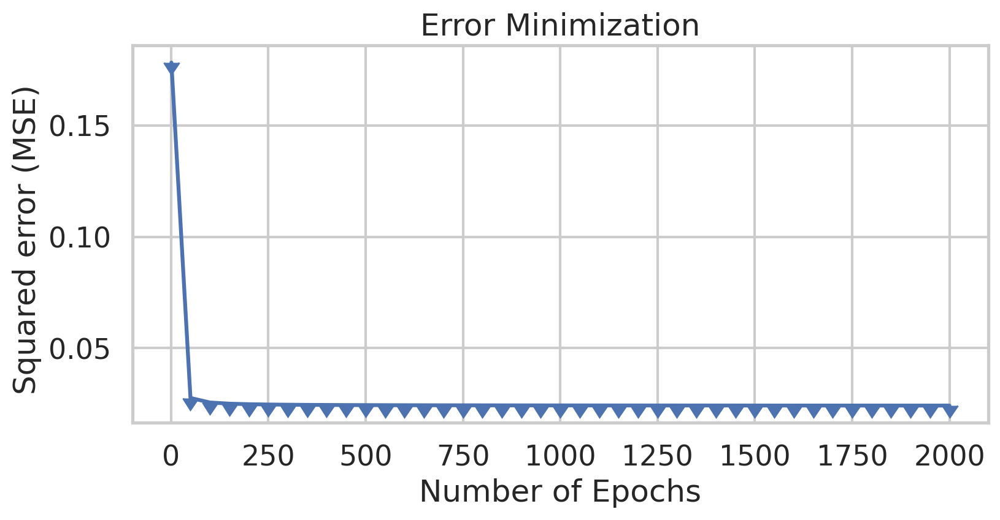

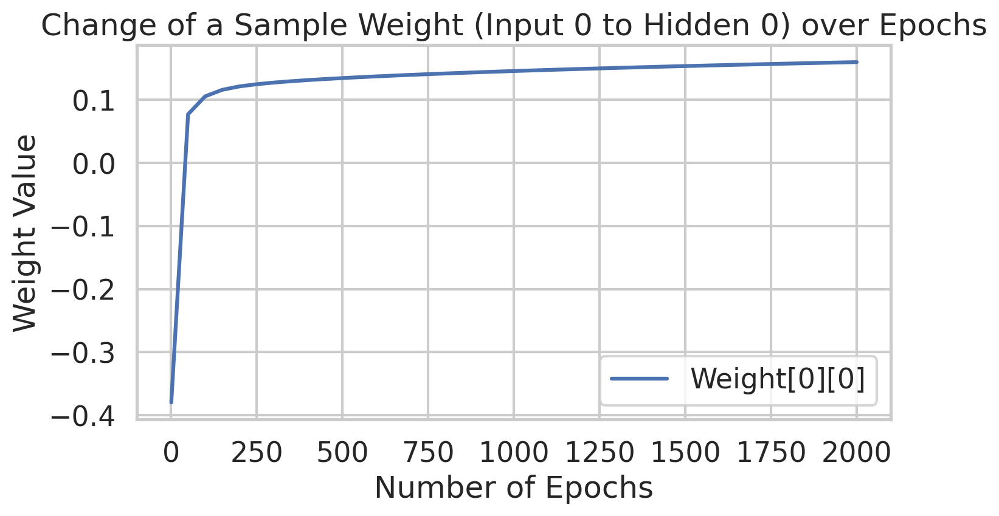

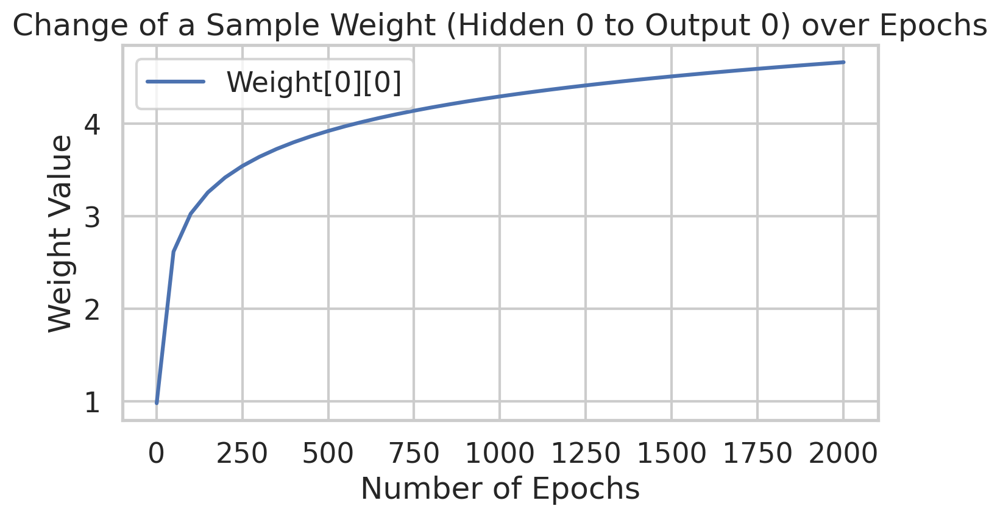


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.05
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2550852391252069
Epoch  50 - Total Error:  0.15165203994877655
Epoch  100 - Total Error:  0.03472639582870028
Epoch  150 - Total Error:  0.027943831763579653
Epoch  200 - Total Error:  0.026359986131399192
Epoch  250 - Total Error:  0.025683165644043
Epoch  300 - Total Error:  0.02531370029563247
Epoch  350 - Total Error:  0.02508306529136026
Epoch  400 - Total Error:  0.024926268892826724
Epoch  450 - Total Error:  0.024813158226473
Epoch  500 - Total Error:  0.0247

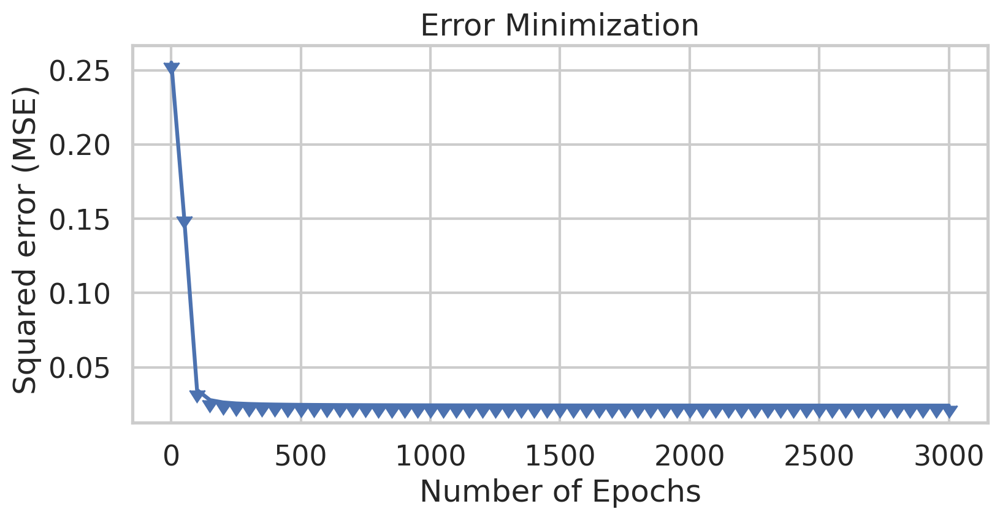

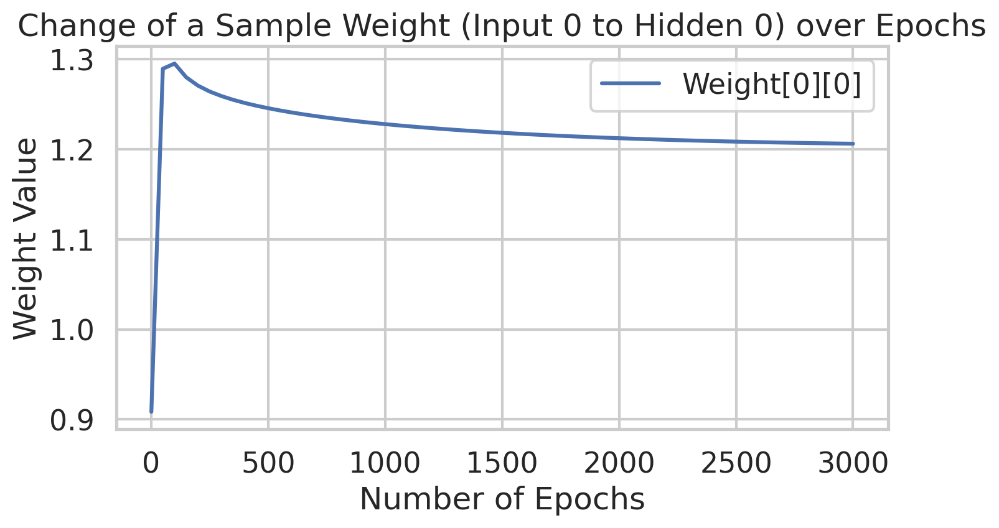

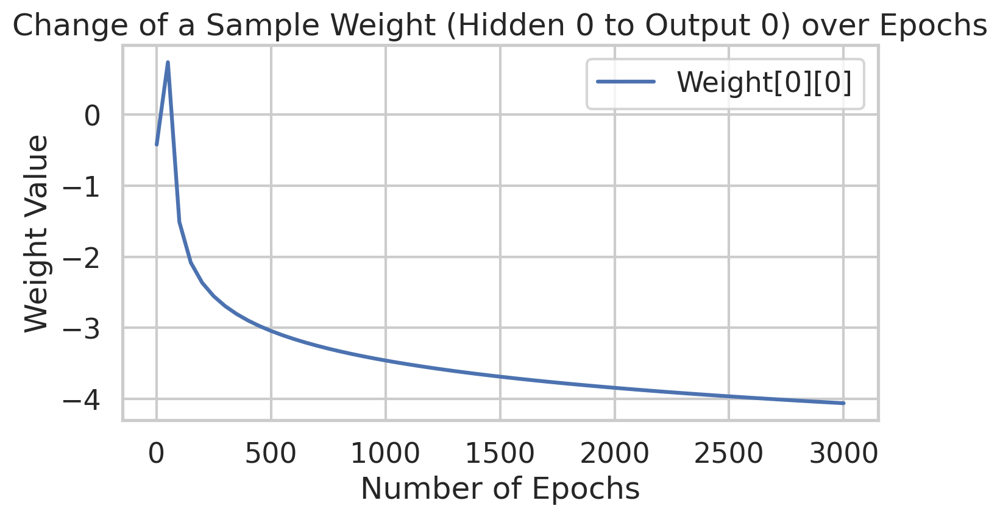


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.05
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1828363429255363
Epoch  50 - Total Error:  0.03654817393842453
Epoch  100 - Total Error:  0.02845725530864025
Epoch  150 - Total Error:  0.026757929323199106
Epoch  200 - Total Error:  0.025964412771277368
Epoch  250 - Total Error:  0.025494481493649183
Epoch  300 - Total Error:  0.025196899970850936
Epoch  350 - Total Error:  0.024999822108557945
Epoch  400 - Total Error:  0.02486281104798303
Epoch  450 - Total Error:  0.02476310908324687
Epoch  500 - Total Error:  

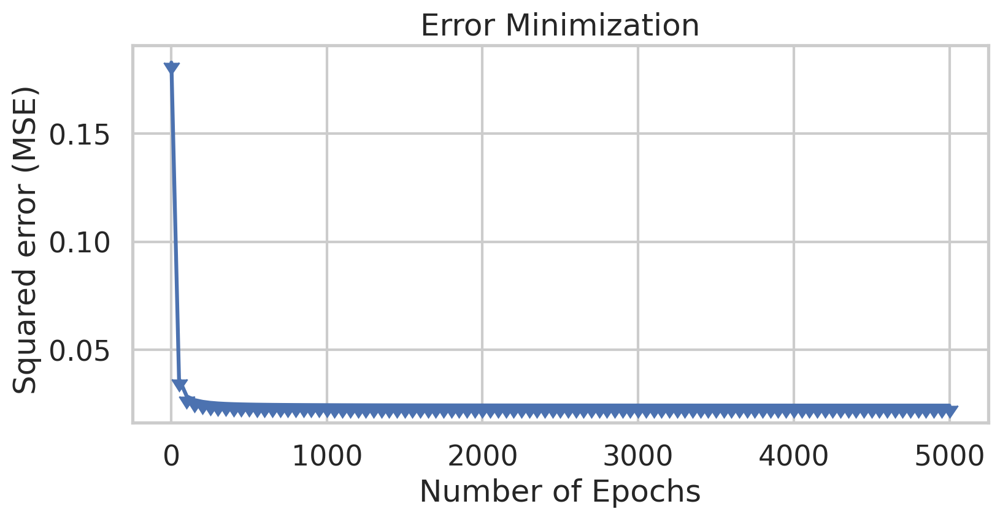

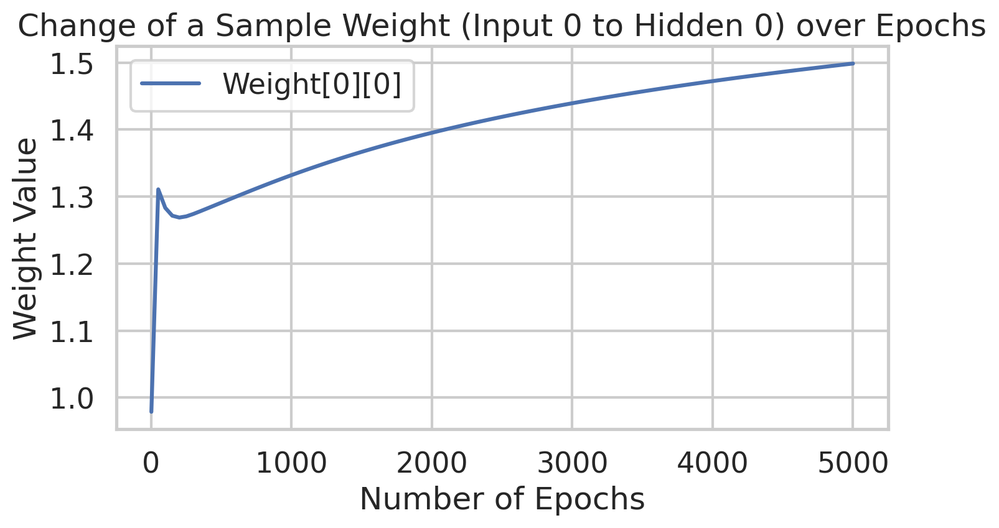

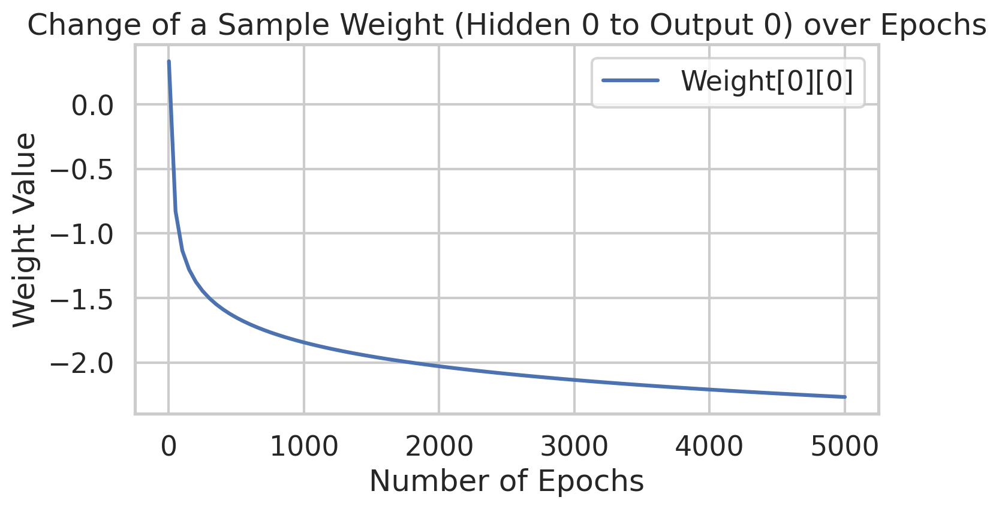


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.1
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16004889584000664
Epoch  50 - Total Error:  0.02663956966142933
Epoch  100 - Total Error:  0.025109247382619226
Epoch  150 - Total Error:  0.024742021787539807
Epoch  200 - Total Error:  0.024582391526166283
Epoch  250 - Total Error:  0.024493674407125025
Epoch  300 - Total Error:  0.024437271110688944
Epoch  350 - Total Error:  0.024398240326114505
Epoch  400 - Total Error:  0.024369611629455692
Epoch  450 - Total Error:  0.02434770202840697
Epoch  500 - Total Error: 

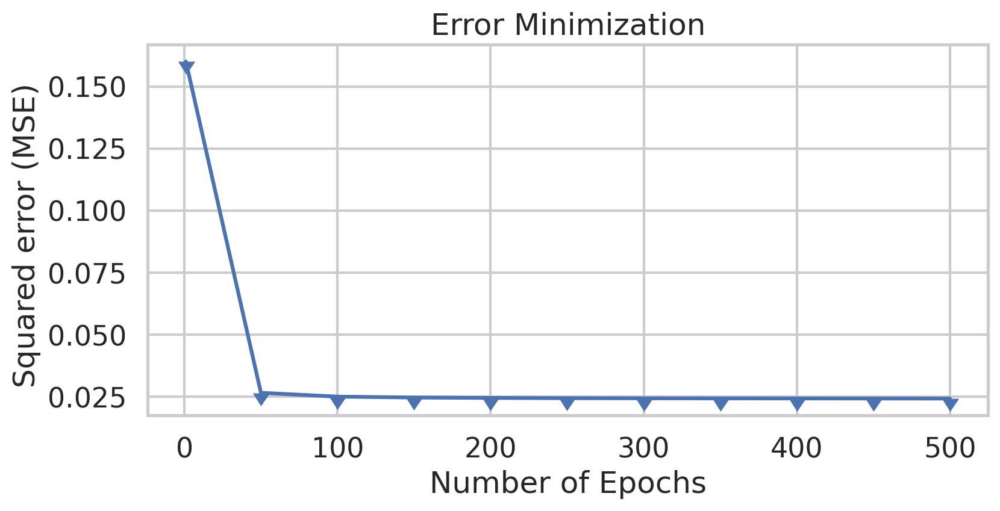

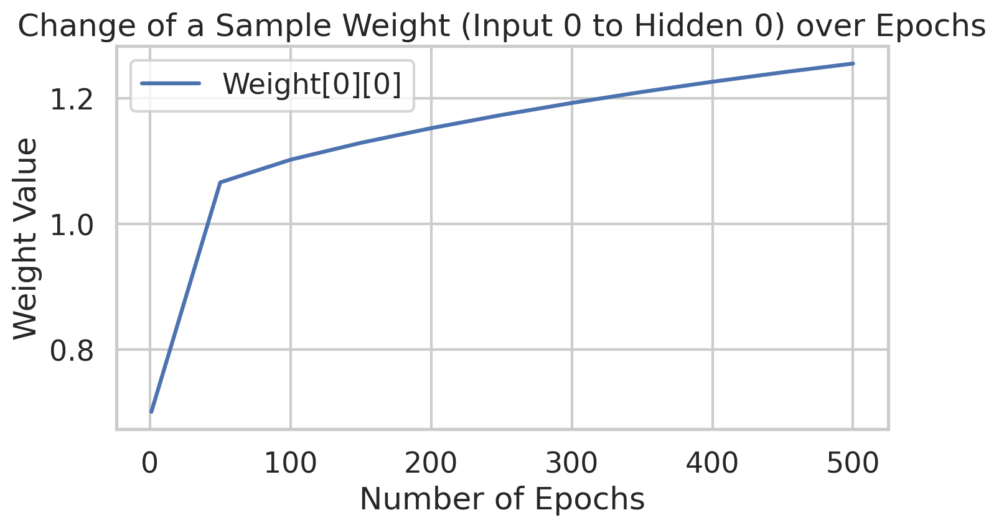

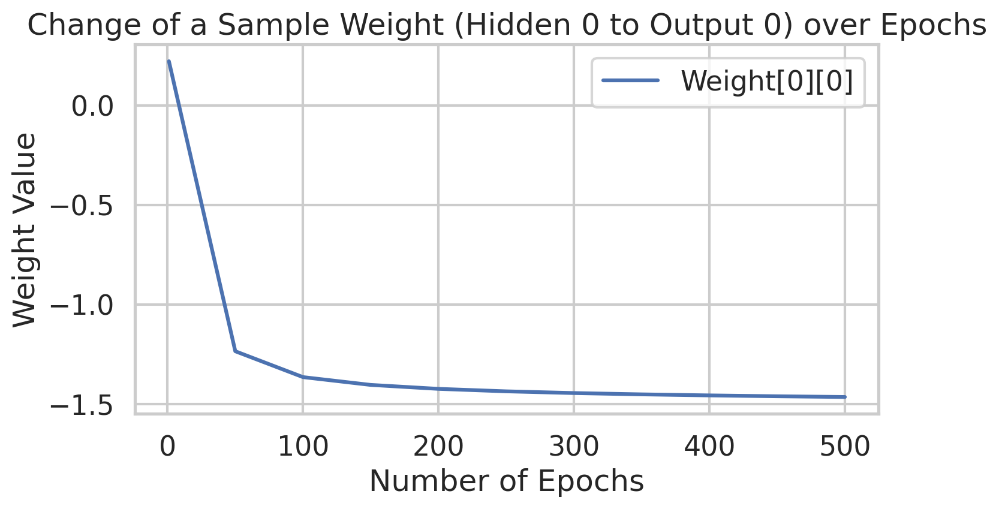


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.1
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.18871780585541115
Epoch  50 - Total Error:  0.027378963459823144
Epoch  100 - Total Error:  0.025164615879815683
Epoch  150 - Total Error:  0.024258225080906533
Epoch  200 - Total Error:  0.022735507210485388
Epoch  250 - Total Error:  0.01862911223621982
Epoch  300 - Total Error:  0.011621452377195403
Epoch  350 - Total Error:  0.0067193305153794075
Epoch  400 - Total Error:  0.004444398442623534
Epoch  450 - Total Error:  0.0031351174018067075
Epoch  500 - Total Err

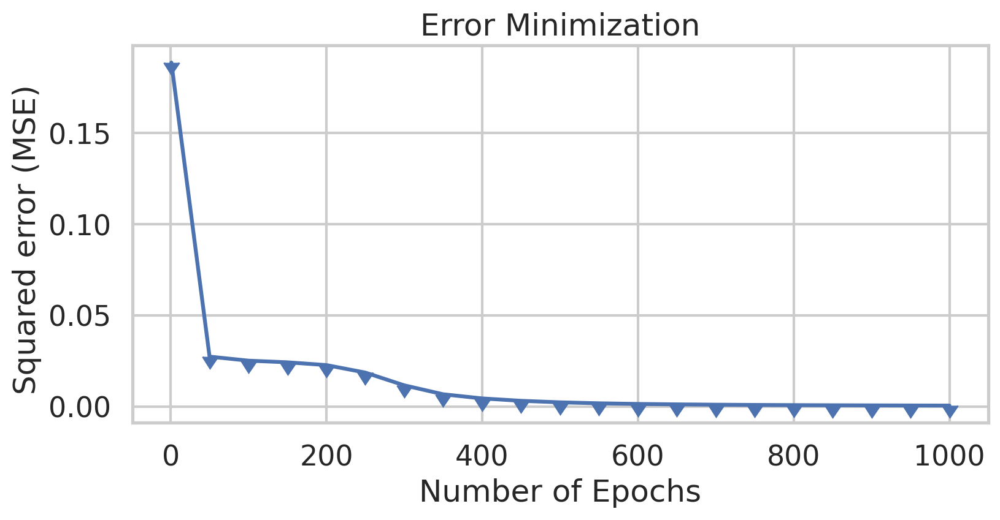

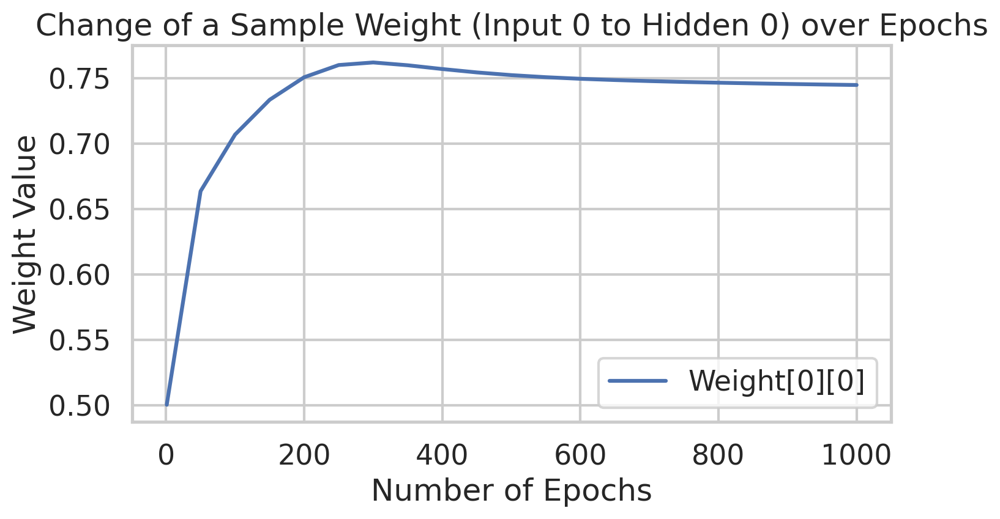

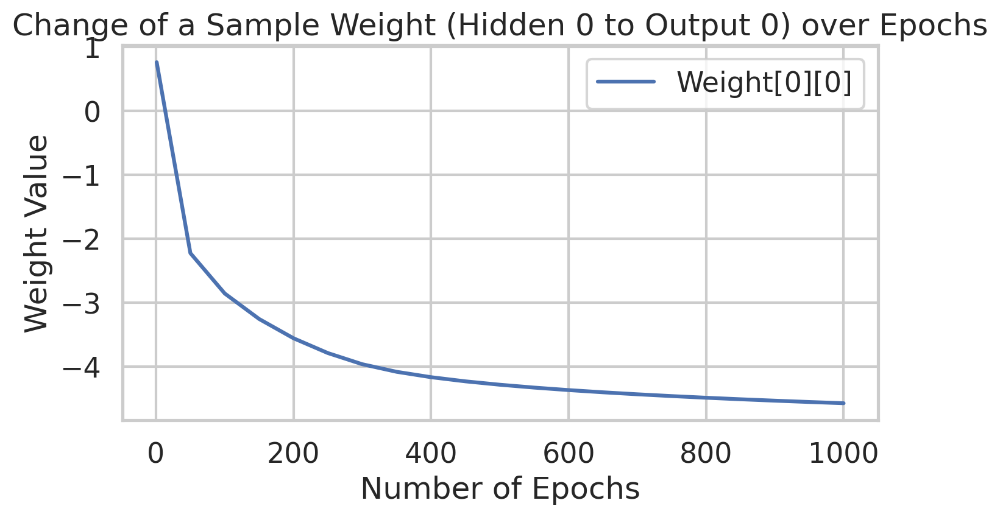


=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.1
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1665100488550381
Epoch  50 - Total Error:  0.027312955490100467
Epoch  100 - Total Error:  0.025508781857340353
Epoch  150 - Total Error:  0.02501486482505212
Epoch  200 - Total Error:  0.024787462297591153
Epoch  250 - Total Error:  0.024657251458113774
Epoch  300 - Total Error:  0.024573053674927094
Epoch  350 - Total Error:  0.024514201197583983
Epoch  400 - Total Error:  0.024470772961894184
Epoch  450 - Total Error:  0.02443742039810576
Epoch  500 - Total Error: 

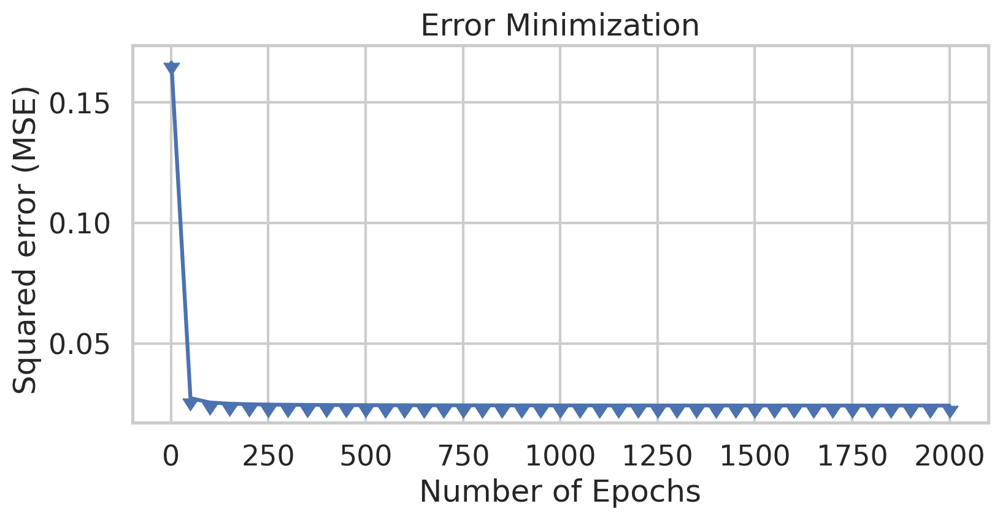

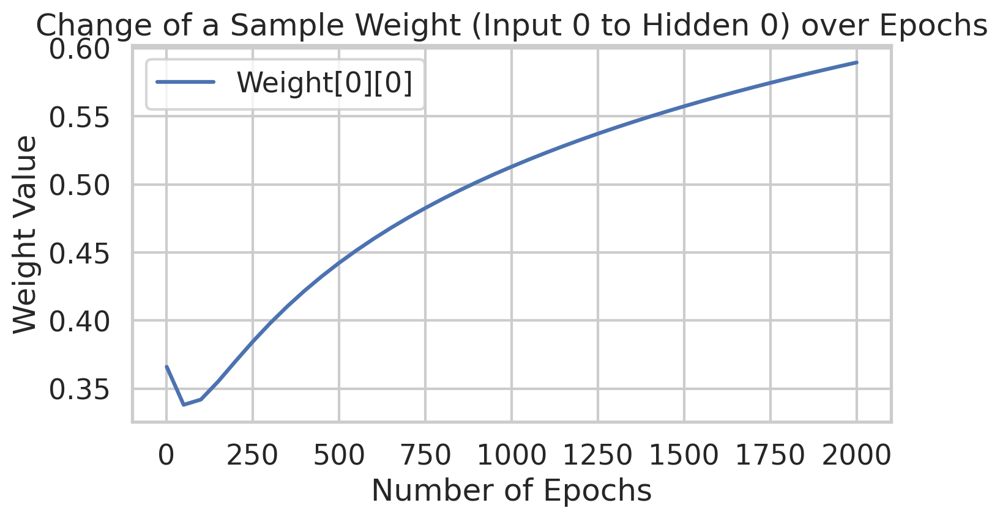

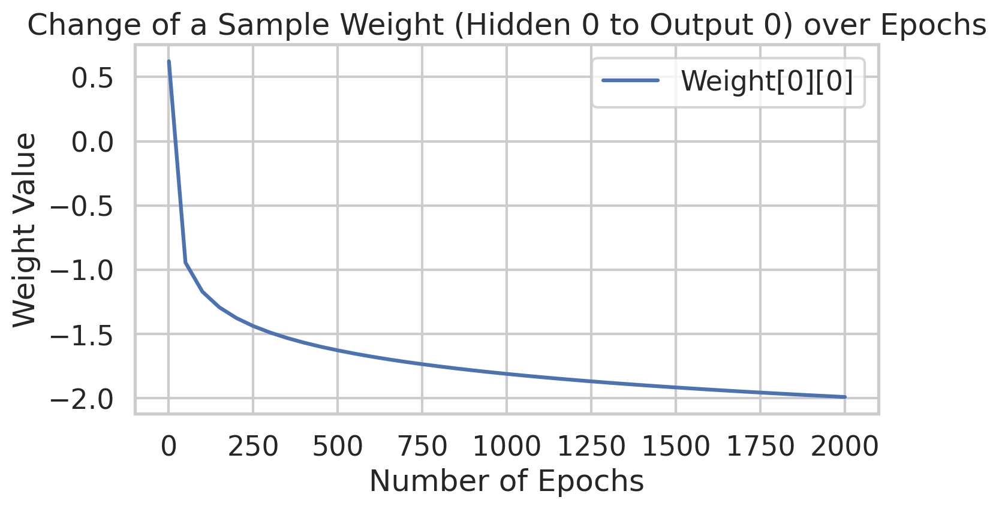


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 81 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.1
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20305764026226727
Epoch  50 - Total Error:  0.03534568947656476
Epoch  100 - Total Error:  0.027157107506073284
Epoch  150 - Total Error:  0.025931343319769172
Epoch  200 - Total Error:  0.02524182868245167
Epoch  250 - Total Error:  0.024885317326377346
Epoch  300 - Total Error:  0.024704246362260873
Epoch  350 - Total Error:  0.024598538591279452
Epoch  400 - Total Error:  0.024529316962796536
Epoch  450 - Total Error:  0.024480327142329325
Epoch  500 - Total Error:

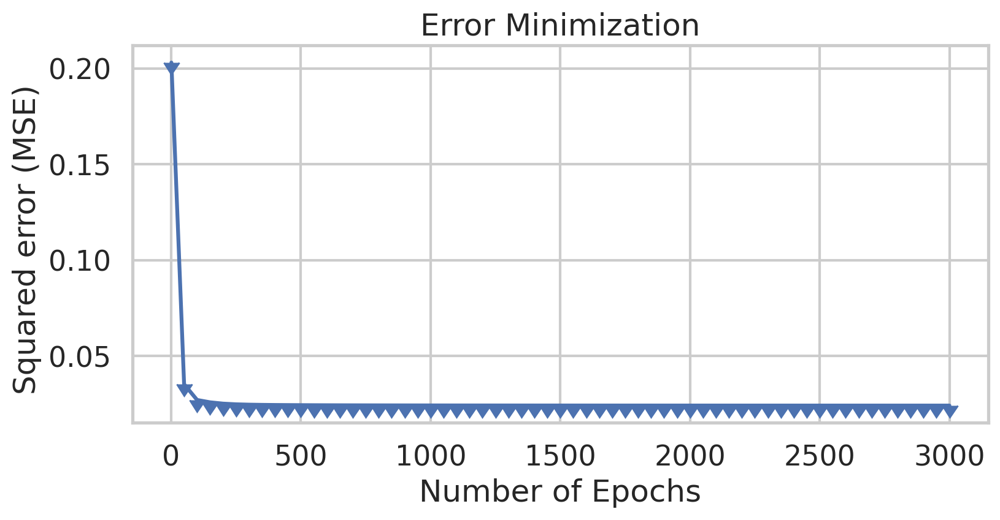

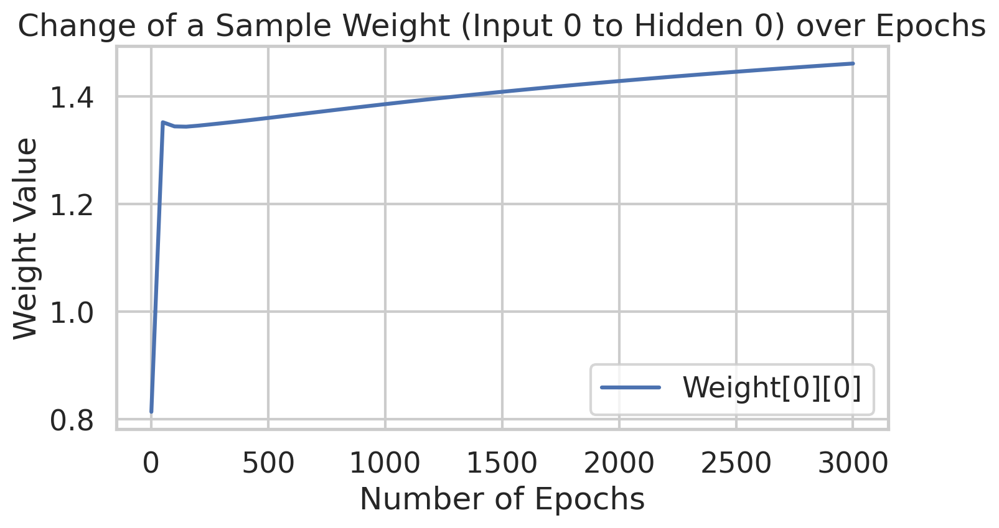

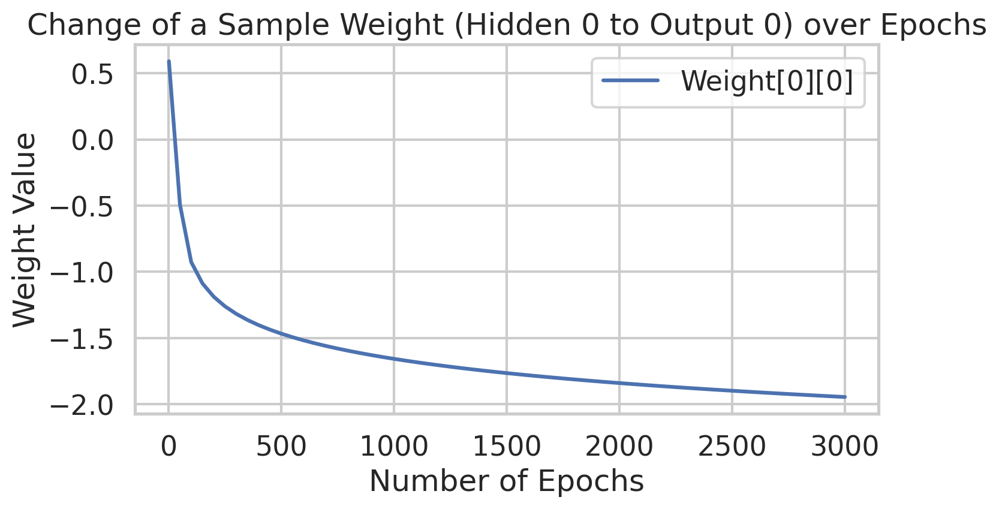


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 81 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.1
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.21481972072928113
Epoch  50 - Total Error:  0.02616482387966483
Epoch  100 - Total Error:  0.02501708399329564
Epoch  150 - Total Error:  0.024704773335669773
Epoch  200 - Total Error:  0.02455961424262542
Epoch  250 - Total Error:  0.02447557874843566
Epoch  300 - Total Error:  0.024420690633806474
Epoch  350 - Total Error:  0.024381985914718407
Epoch  400 - Total Error:  0.024353205154279613
Epoch  450 - Total Error:  0.024330952738985816
Epoch  500 - Total Error:  

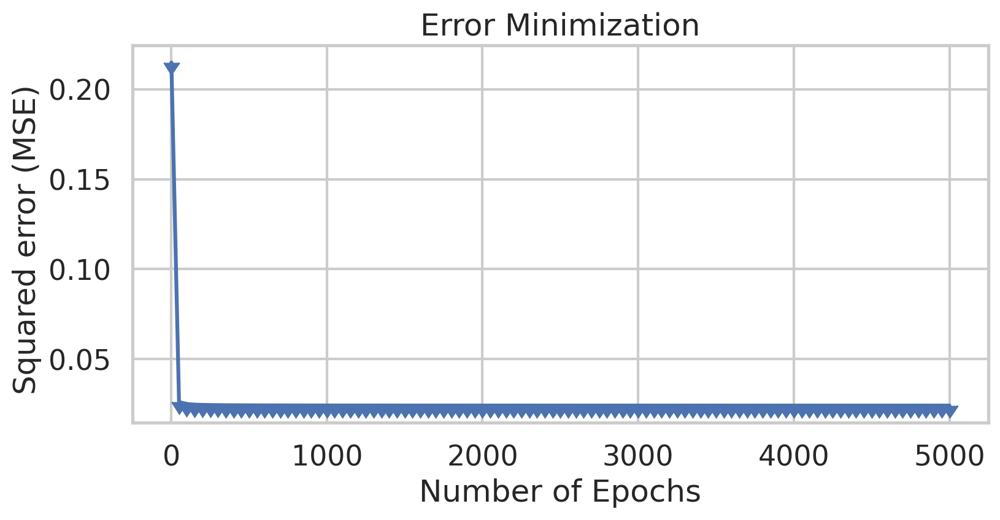

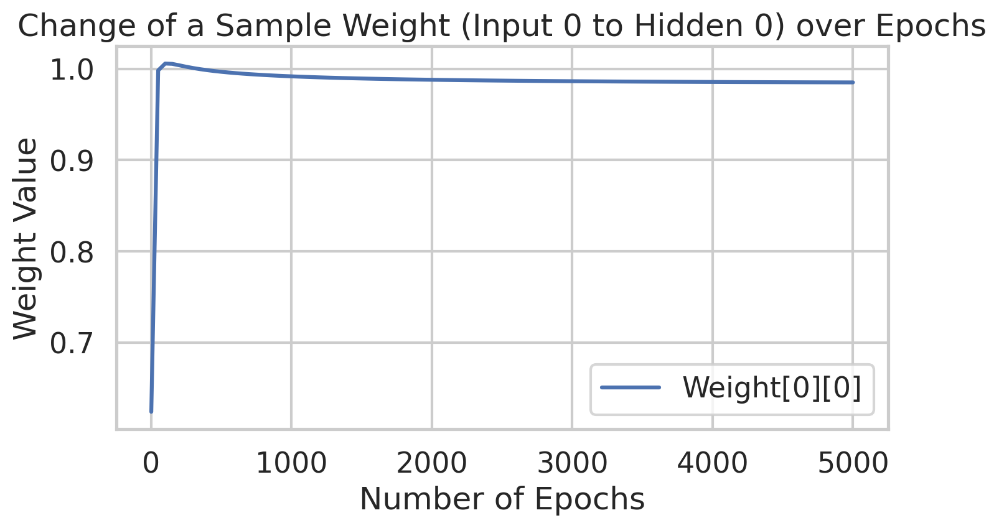

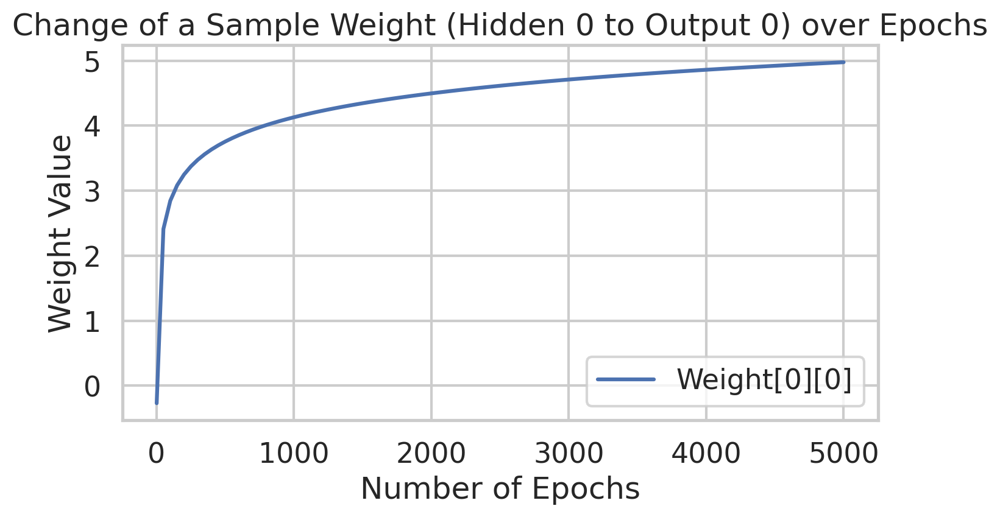


=== Test Results ===
Porcents : 86.67% hits and 13.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 17 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 85.83% hits and 14.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 70 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.001
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.22080773986520727
Epoch  50 - Total Error:  0.1638615735409761
Epoch  100 - Total Error:  0.15427134192755645
Epoch  150 - Total Error:  0.14940634356246554
Epoch  200 - Total Error:  0.1443800588609994
Epoch  250 - Total Error:  0.1368509822563549
Epoch  300 - Total Error:  0.12341036314615718
Epoch  350 - Total Error:  0.11122261614466451
Epoch  400 - Total Error:  0.09924049812596167
Epoch  450 - Total Error:  0.08800886790042695
Epoch  500 - Total Error:  0.078

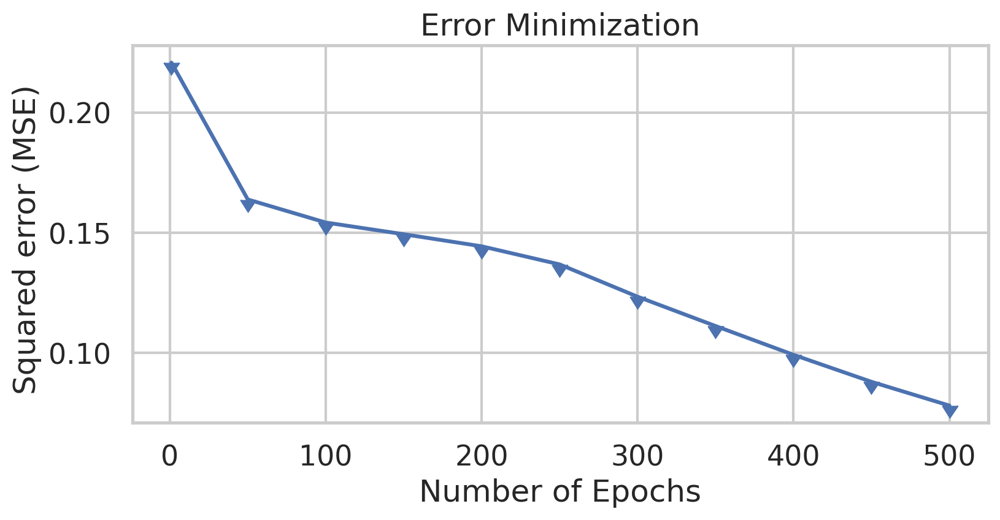

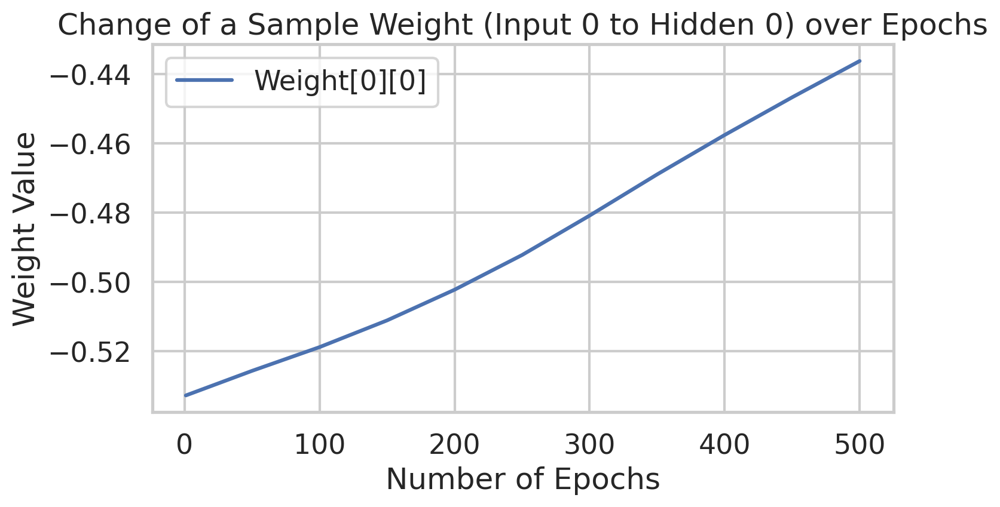

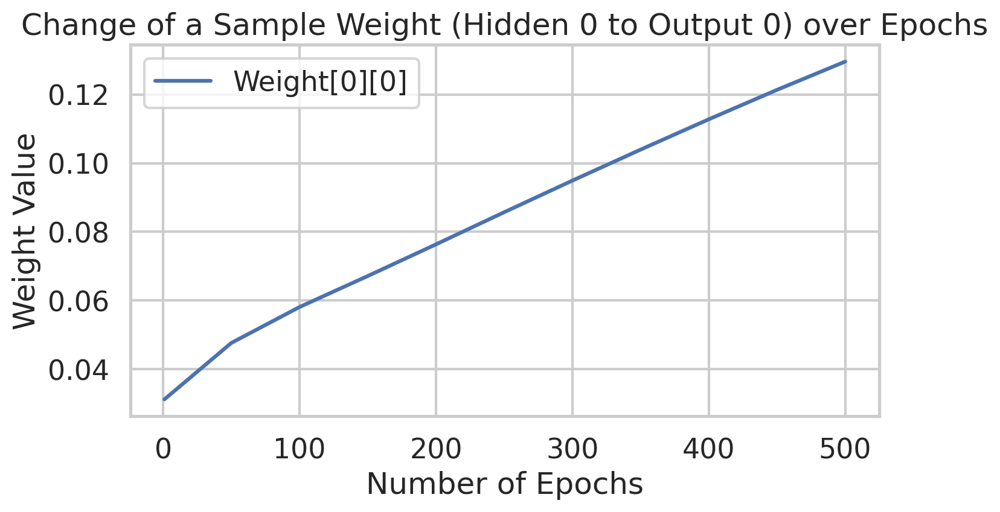


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.001
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.24286925281387478
Epoch  50 - Total Error:  0.16941782634512872
Epoch  100 - Total Error:  0.12552180917921046
Epoch  150 - Total Error:  0.10220564011583262
Epoch  200 - Total Error:  0.09009982022617327
Epoch  250 - Total Error:  0.0801271472933062
Epoch  300 - Total Error:  0.07170287277825117
Epoch  350 - Total Error:  0.06460436554698892
Epoch  400 - Total Error:  0.05867840452944497
Epoch  450 - Total Error:  0.05377416629646873
Epoch  500 - Total Error:  0.04

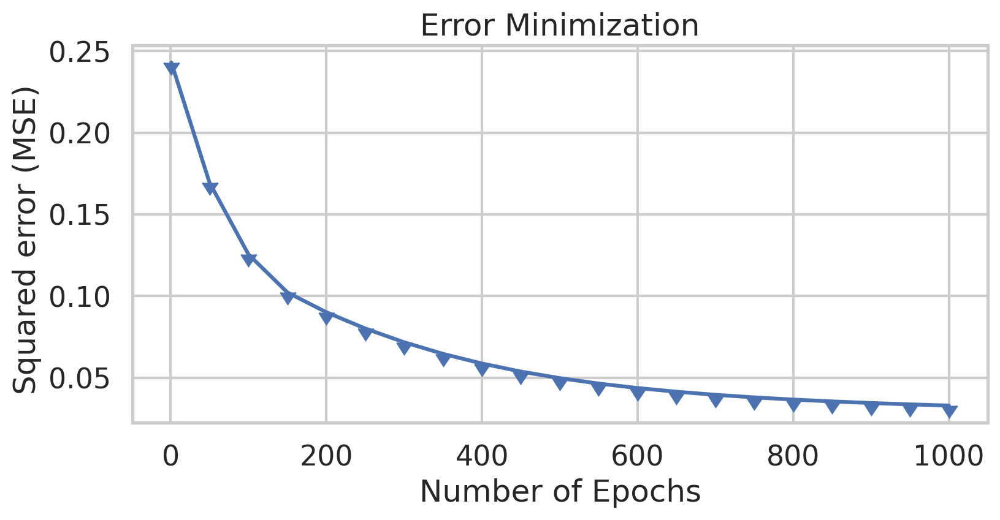

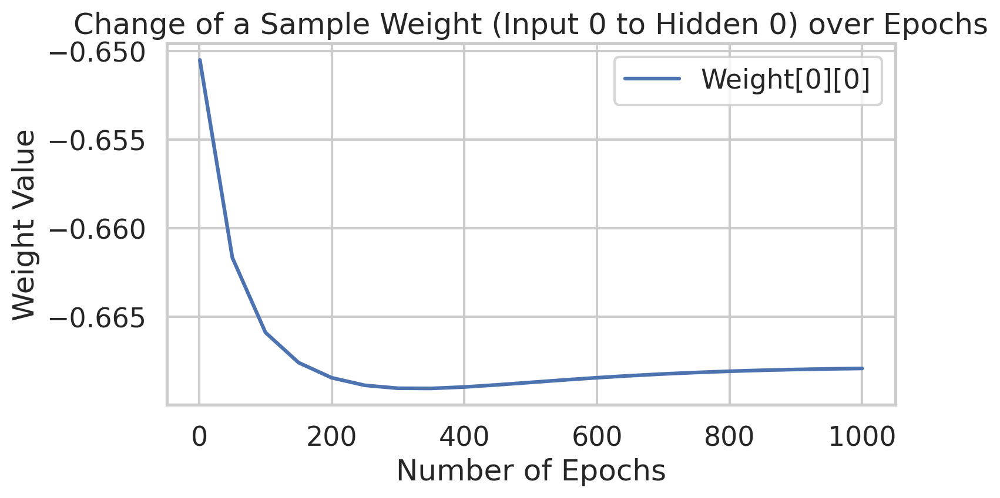

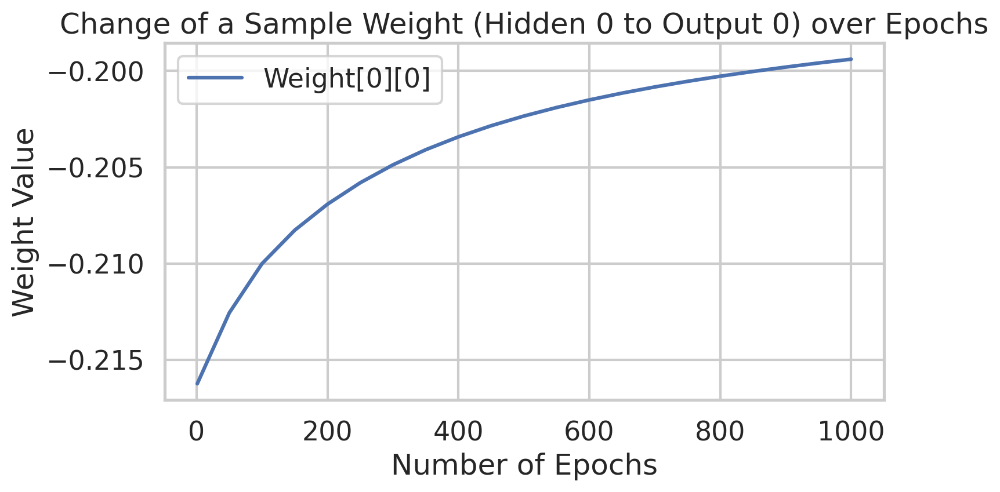


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.001
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.25463229406100724
Epoch  50 - Total Error:  0.162046625786792
Epoch  100 - Total Error:  0.14743484791910477
Epoch  150 - Total Error:  0.1390060194929367
Epoch  200 - Total Error:  0.13099087138674112
Epoch  250 - Total Error:  0.12226053786283991
Epoch  300 - Total Error:  0.11209236144061532
Epoch  350 - Total Error:  0.10082257056401264
Epoch  400 - Total Error:  0.09014578037414701
Epoch  450 - Total Error:  0.0805128195002705
Epoch  500 - Total Error:  0.07212

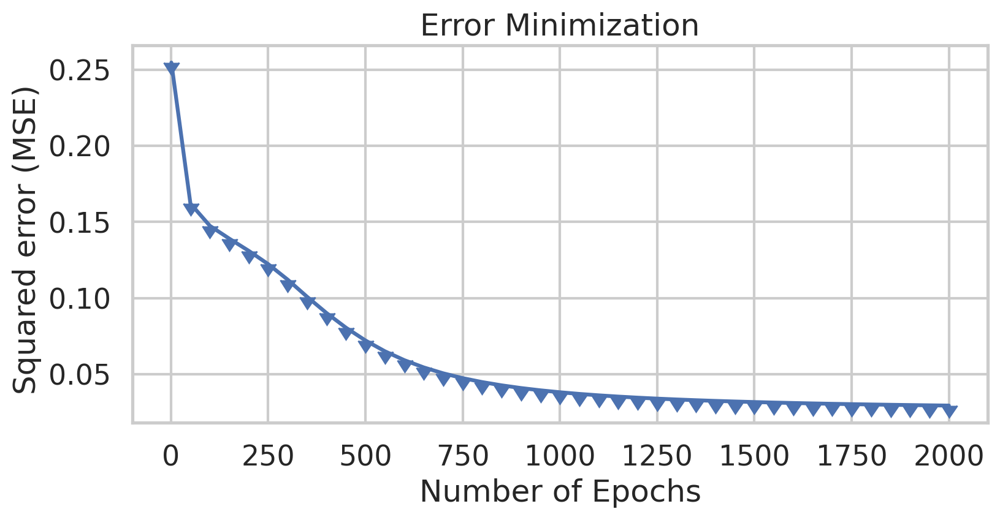

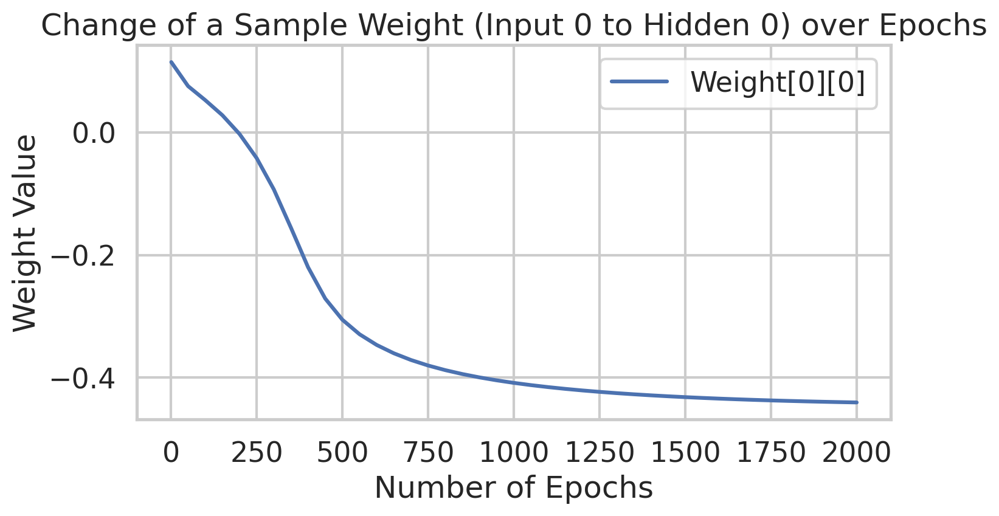

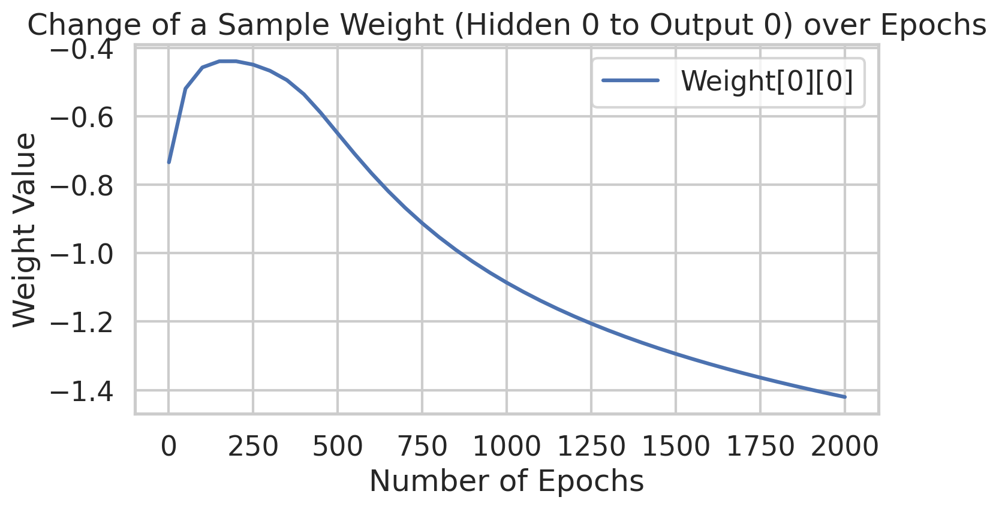


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 32 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.001
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2785281926311989
Epoch  50 - Total Error:  0.1754755942211126
Epoch  100 - Total Error:  0.15340117502286693
Epoch  150 - Total Error:  0.14530416814821676
Epoch  200 - Total Error:  0.13854308095029652
Epoch  250 - Total Error:  0.13096004454565274
Epoch  300 - Total Error:  0.1219639316790063
Epoch  350 - Total Error:  0.11169198350444225
Epoch  400 - Total Error:  0.10077231159220476
Epoch  450 - Total Error:  0.09007521283424759
Epoch  500 - Total Error:  0.0803

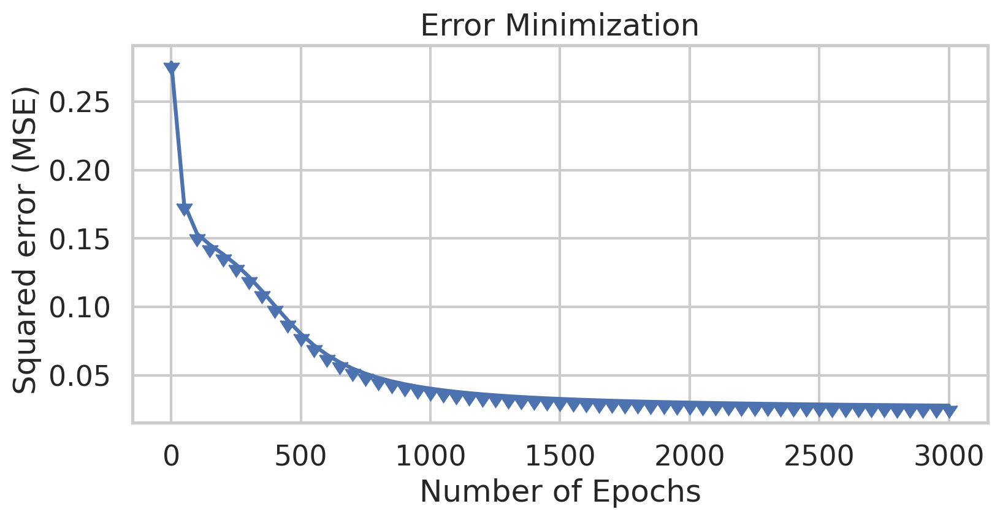

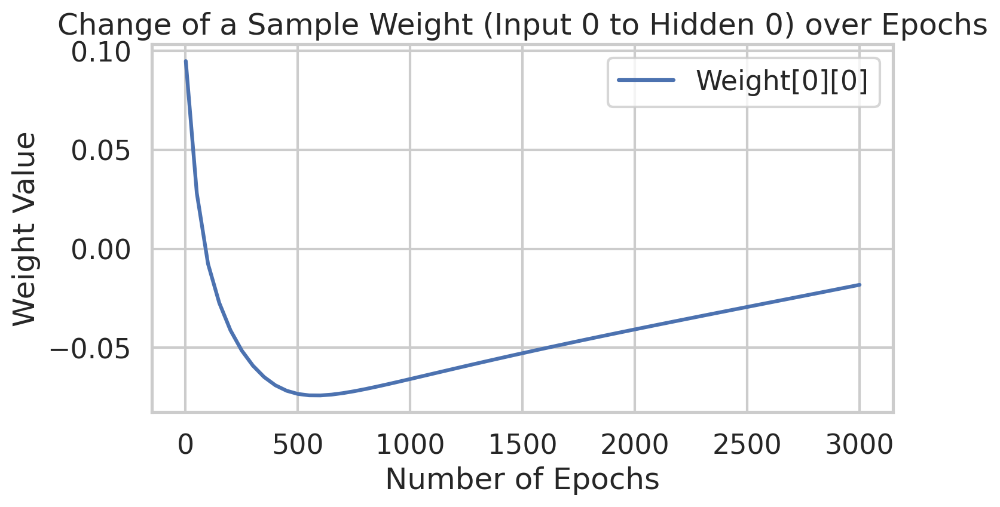

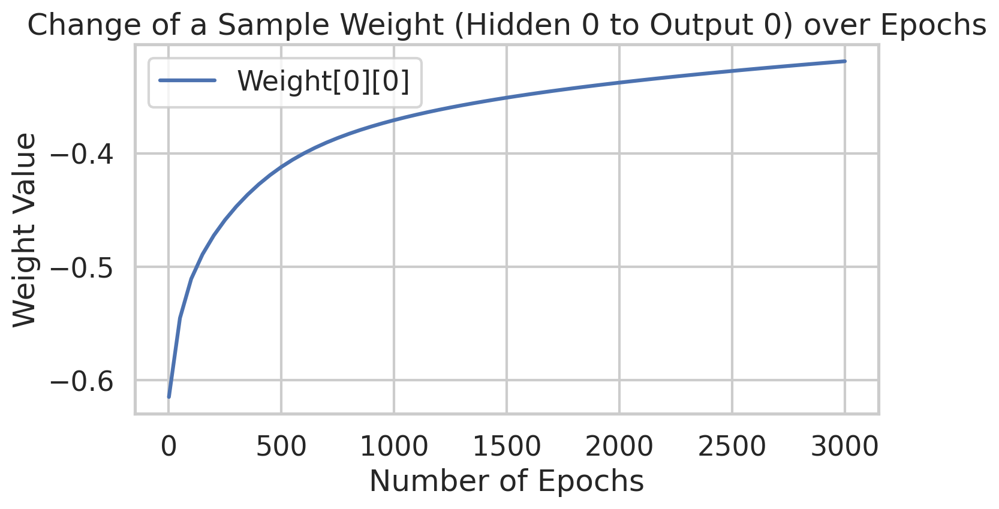


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.001
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2613059027564751
Epoch  50 - Total Error:  0.17547175484685962
Epoch  100 - Total Error:  0.15005134797073444
Epoch  150 - Total Error:  0.13590717516590928
Epoch  200 - Total Error:  0.12471903234955442
Epoch  250 - Total Error:  0.1154711991670289
Epoch  300 - Total Error:  0.10748484617101571
Epoch  350 - Total Error:  0.10039517792715555
Epoch  400 - Total Error:  0.09401398079885319
Epoch  450 - Total Error:  0.08824107817508815
Epoch  500 - Total Error:  0.083

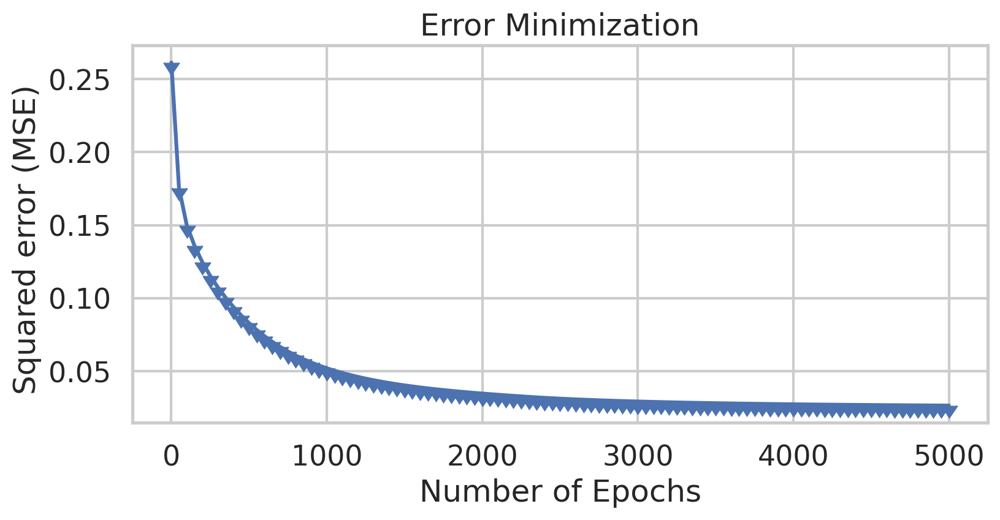

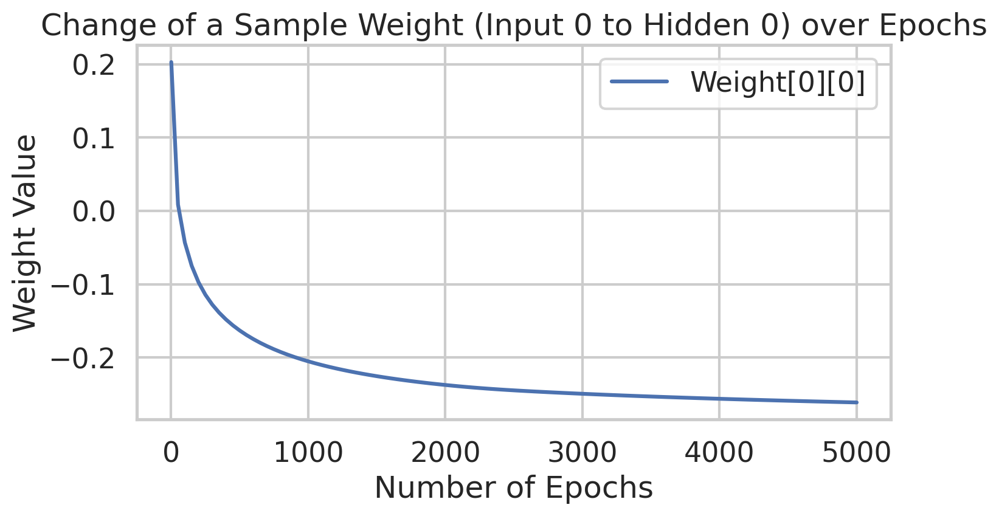

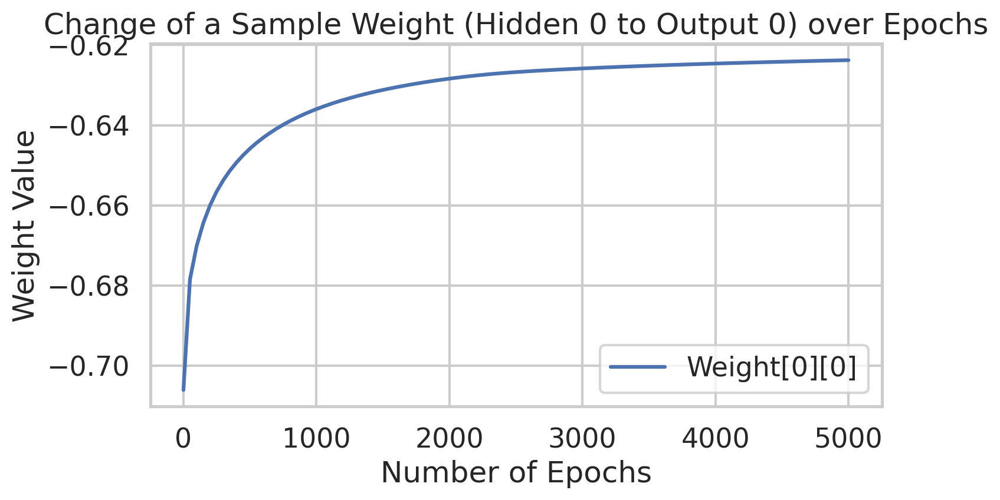


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.005
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20561709921975477
Epoch  50 - Total Error:  0.09802804556562834
Epoch  100 - Total Error:  0.05270748005014666
Epoch  150 - Total Error:  0.03842812316745071
Epoch  200 - Total Error:  0.033042794370173635
Epoch  250 - Total Error:  0.030452834485532314
Epoch  300 - Total Error:  0.028983155740399374
Epoch  350 - Total Error:  0.028052506755940735
Epoch  400 - Total Error:  0.027416439070688622
Epoch  450 - Total Error:  0.02695681727156806
Epoch  500 - Total Error: 

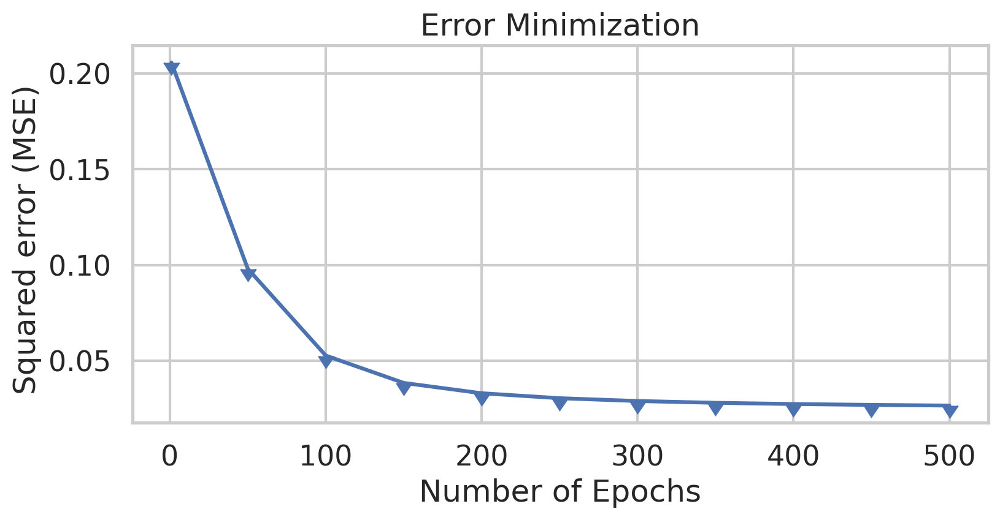

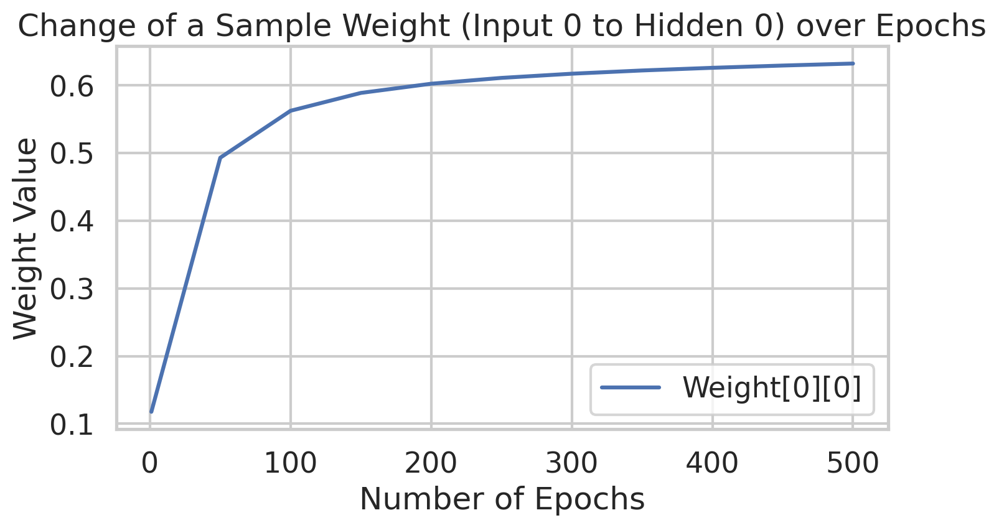

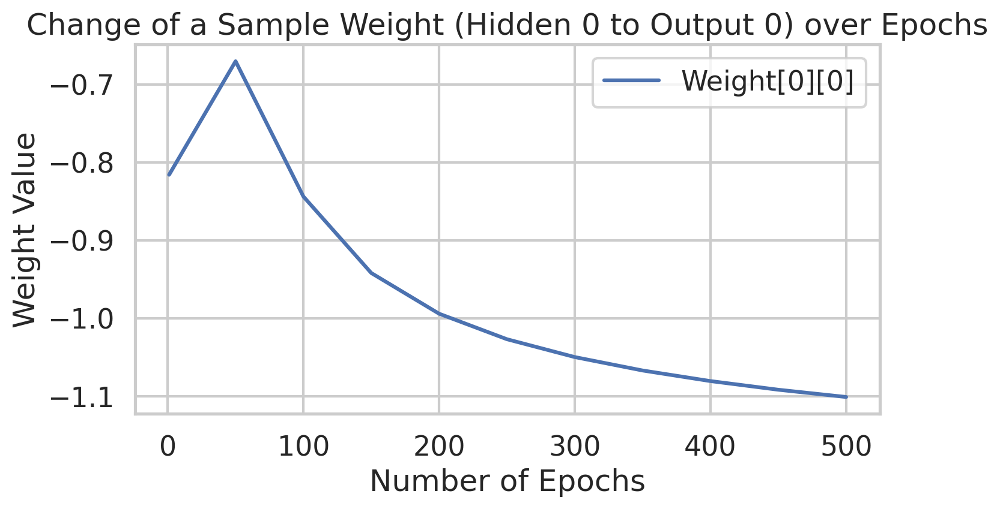


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.005
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.39144161235131025
Epoch  50 - Total Error:  0.09911743204891921
Epoch  100 - Total Error:  0.07027470435101514
Epoch  150 - Total Error:  0.054708751035614143
Epoch  200 - Total Error:  0.04595279132760499
Epoch  250 - Total Error:  0.04064618982474429
Epoch  300 - Total Error:  0.03719467472731311
Epoch  350 - Total Error:  0.034815524362960835
Epoch  400 - Total Error:  0.03309765277273453
Epoch  450 - Total Error:  0.031810246809145404
Epoch  500 - Total Error:  

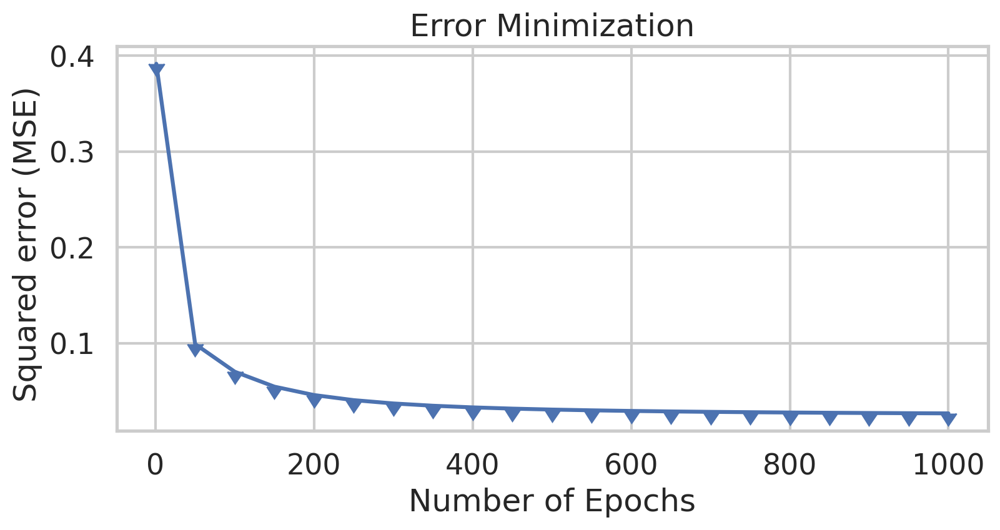

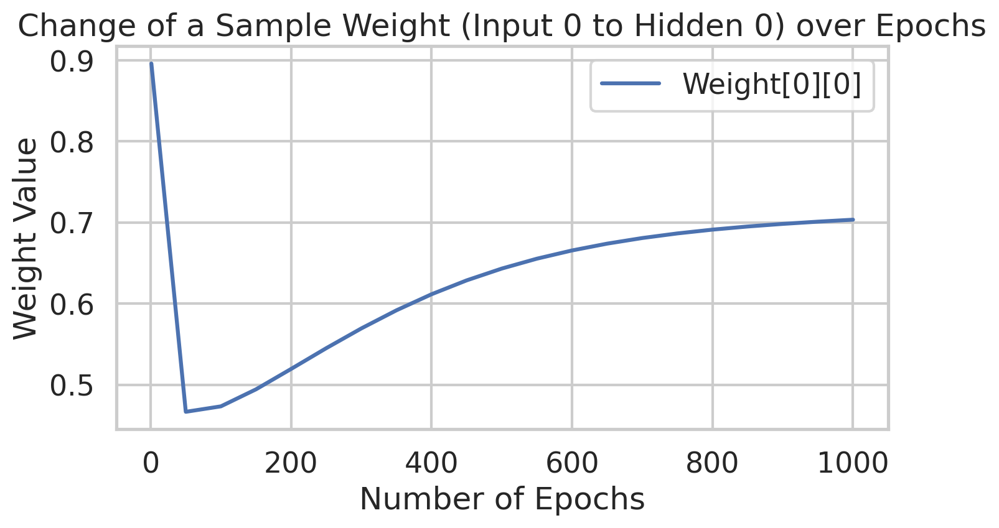

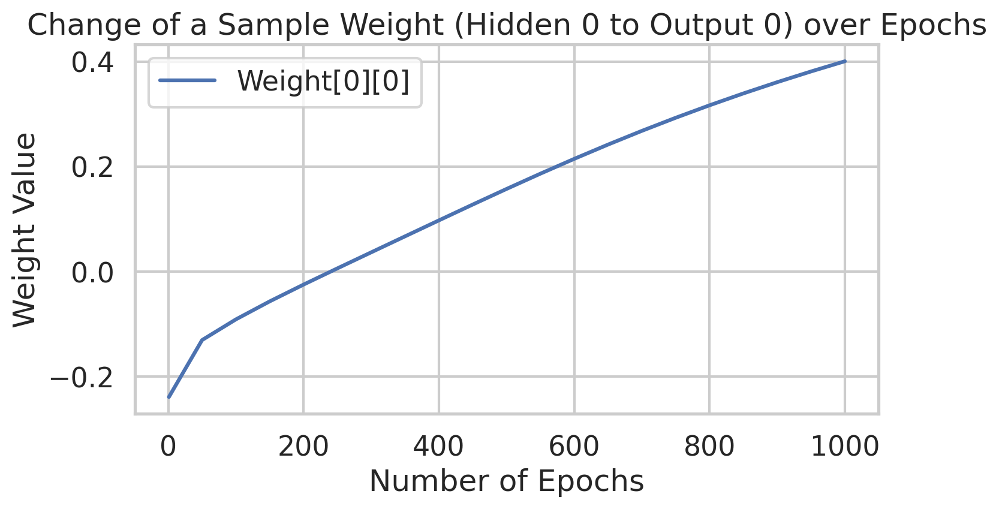


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.005
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3801352043479881
Epoch  50 - Total Error:  0.09970106116055248
Epoch  100 - Total Error:  0.05814926113662332
Epoch  150 - Total Error:  0.04129526023238908
Epoch  200 - Total Error:  0.034758541190873286
Epoch  250 - Total Error:  0.03161954232849996
Epoch  300 - Total Error:  0.029790905319814296
Epoch  350 - Total Error:  0.028483805049725267
Epoch  400 - Total Error:  0.027485982735620595
Epoch  450 - Total Error:  0.026793391539903358
Epoch  500 - Total Error: 

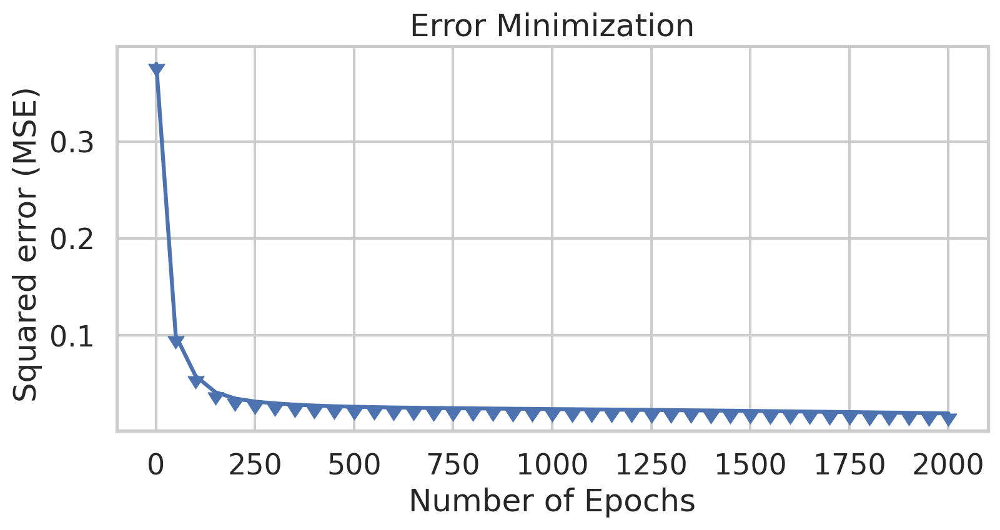

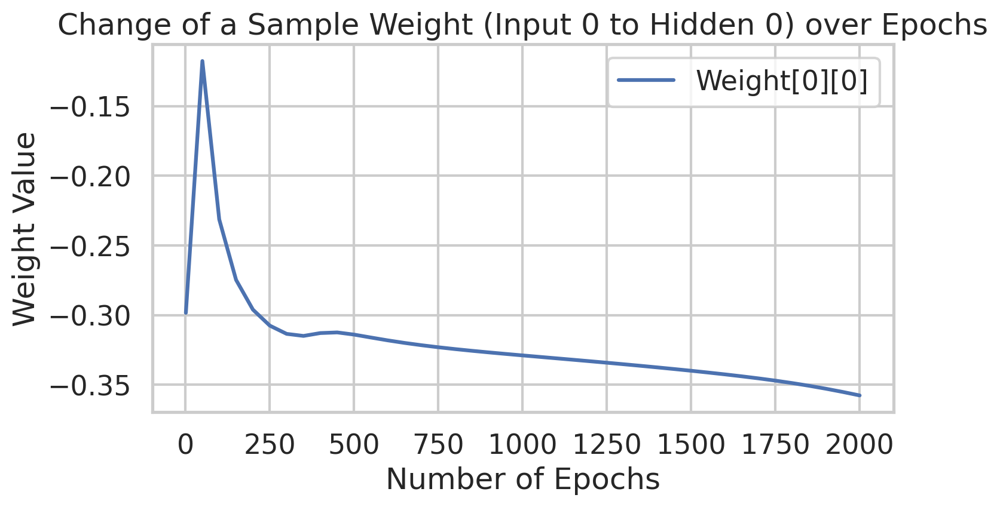

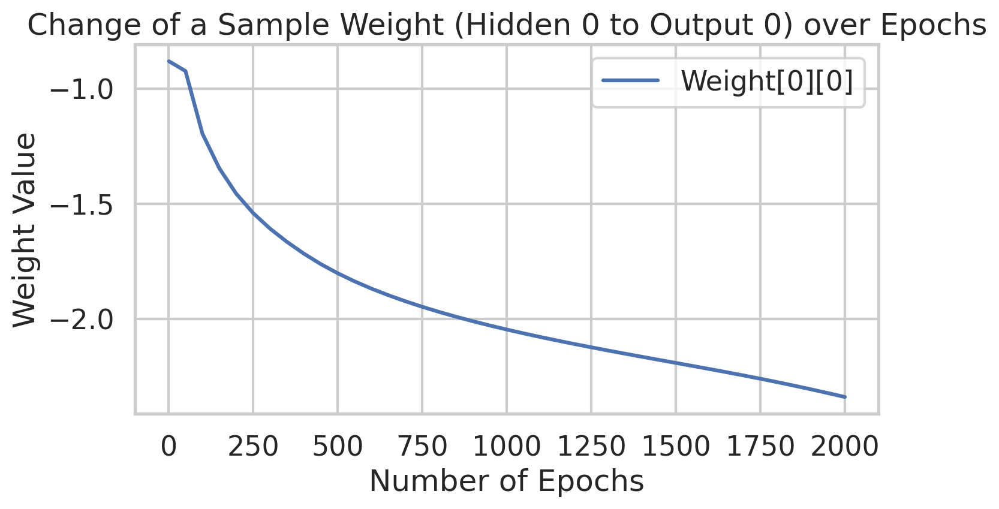


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.005
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3026328670521559
Epoch  50 - Total Error:  0.07230963027749507
Epoch  100 - Total Error:  0.04465029332803626
Epoch  150 - Total Error:  0.03590430681565435
Epoch  200 - Total Error:  0.032126837154439467
Epoch  250 - Total Error:  0.03011779940336227
Epoch  300 - Total Error:  0.02889647134035864
Epoch  350 - Total Error:  0.028083603213523513
Epoch  400 - Total Error:  0.027506493514242787
Epoch  450 - Total Error:  0.02707664675816244
Epoch  500 - Total Error:  0

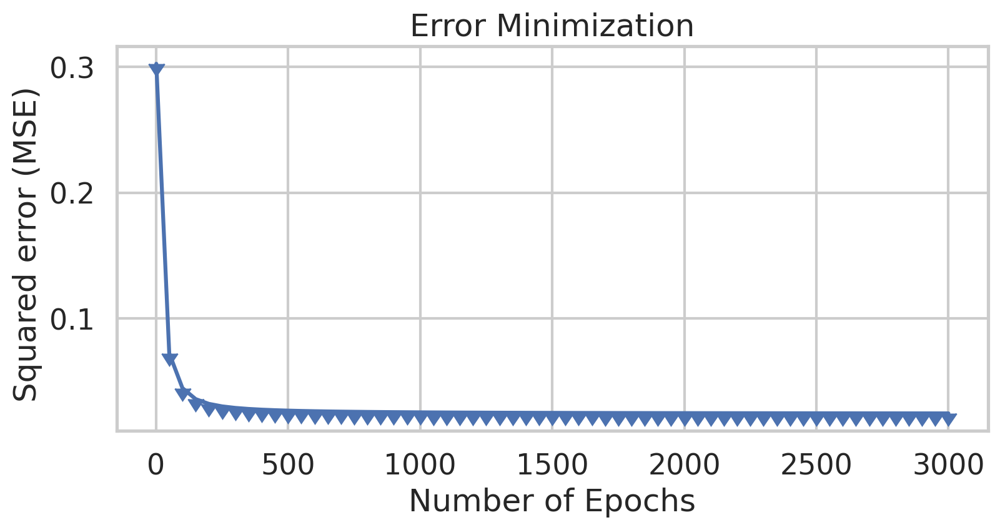

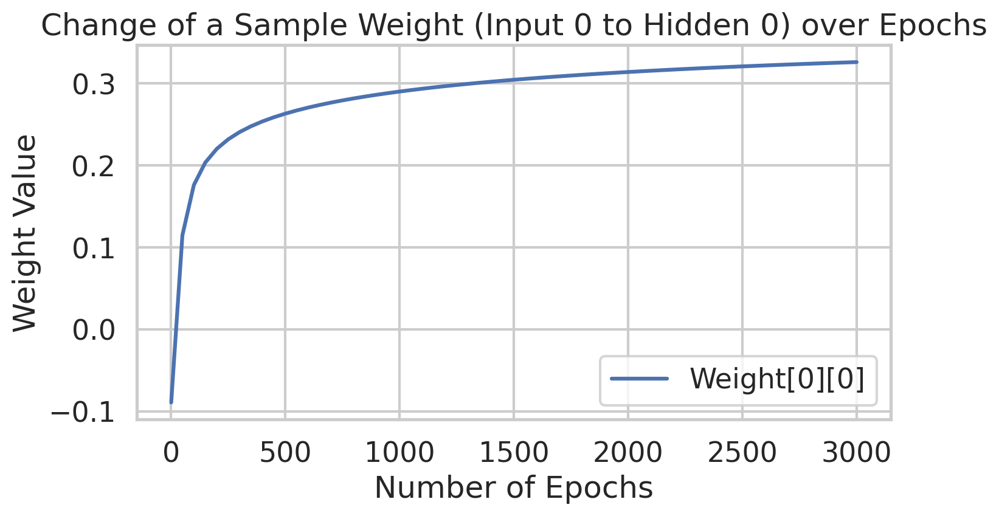

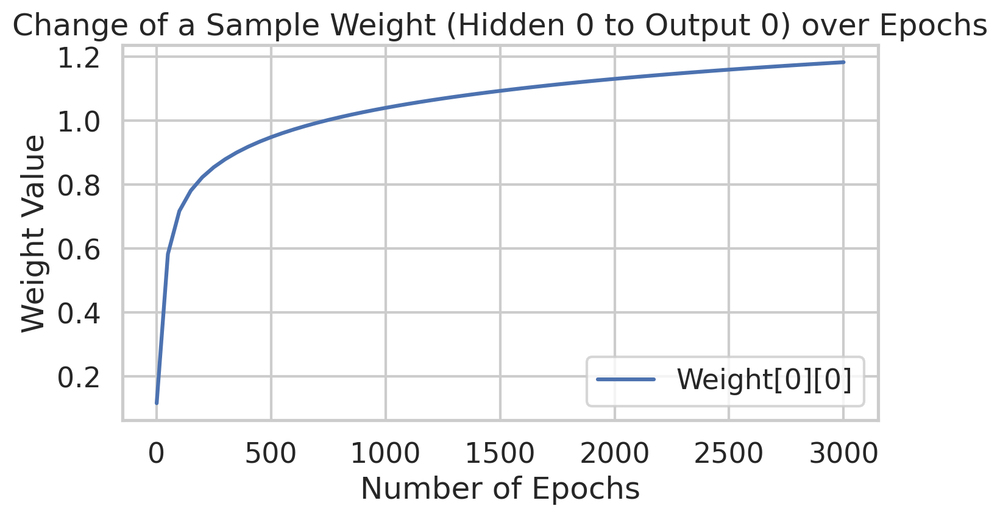


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.005
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.26781052696235486
Epoch  50 - Total Error:  0.12148023204969306
Epoch  100 - Total Error:  0.08271417205215069
Epoch  150 - Total Error:  0.06118388569782906
Epoch  200 - Total Error:  0.04972182062480265
Epoch  250 - Total Error:  0.043134798633129946
Epoch  300 - Total Error:  0.039016955221293476
Epoch  350 - Total Error:  0.03625710974293061
Epoch  400 - Total Error:  0.03430235695291636
Epoch  450 - Total Error:  0.032855139710597156
Epoch  500 - Total Error:  

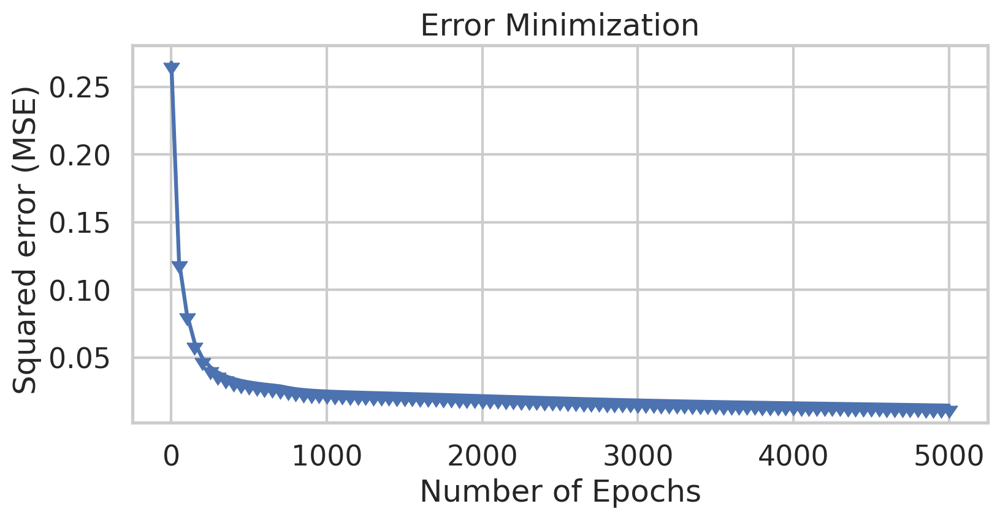

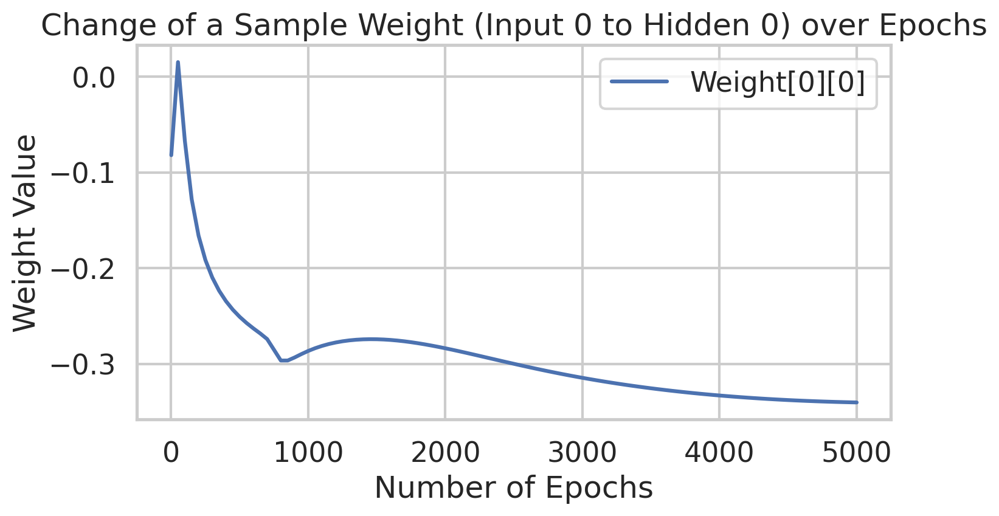

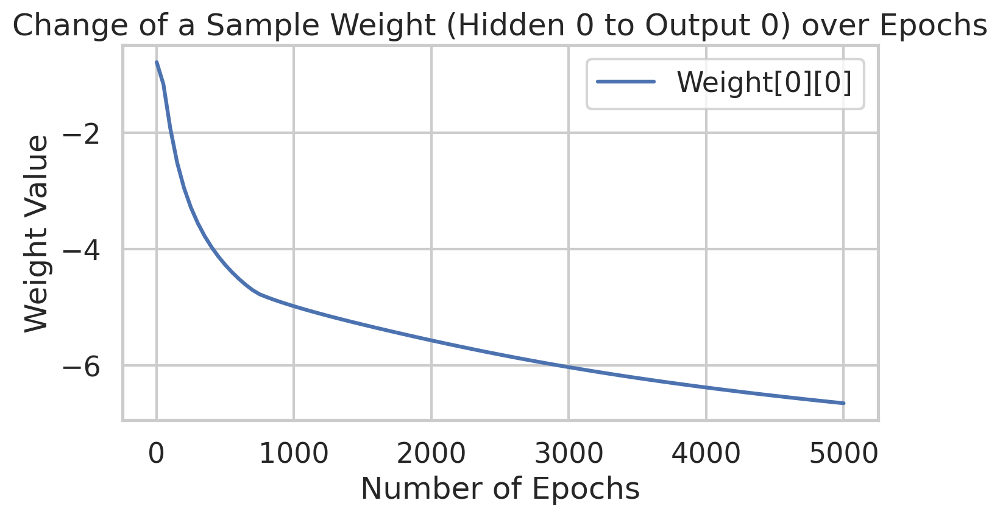


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 8 hits
* Iris-Virginica: 1 samples, 1 hits

=== Train Results ===
Porcents : 97.50% hits and 2.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 30 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.01
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2050775388870619
Epoch  50 - Total Error:  0.04955726925332061
Epoch  100 - Total Error:  0.03203557407946188
Epoch  150 - Total Error:  0.028471901396096583
Epoch  200 - Total Error:  0.027064227583379397
Epoch  250 - Total Error:  0.026332525435355778
Epoch  300 - Total Error:  0.025888122844660053
Epoch  350 - Total Error:  0.025589220079860756
Epoch  400 - Total Error:  0.02537267019741022
Epoch  450 - Total Error:  0.02520606828327402
Epoch  500 - Total Error:  0

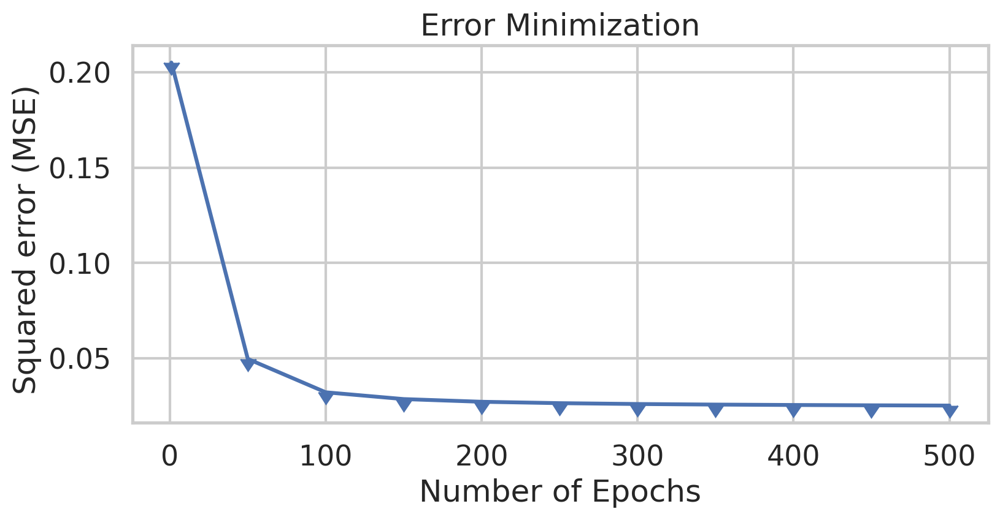

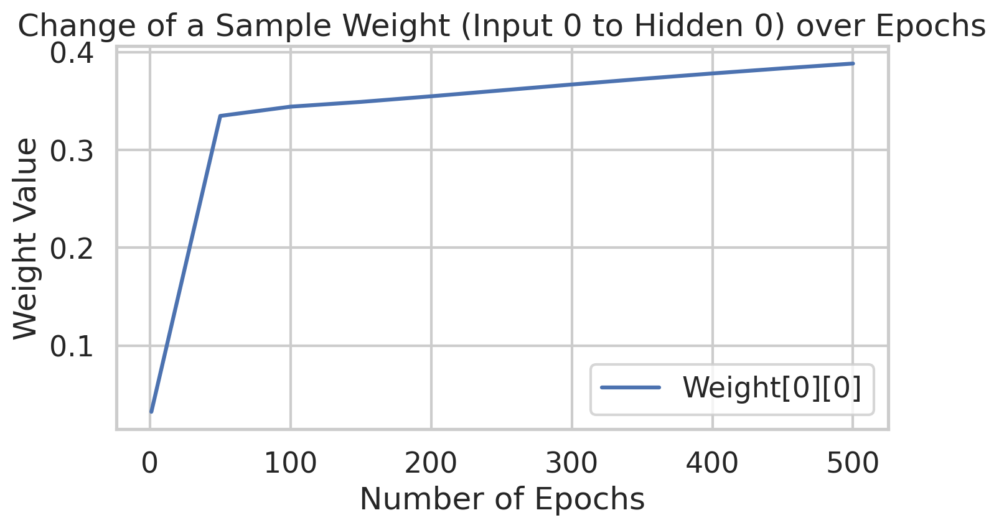

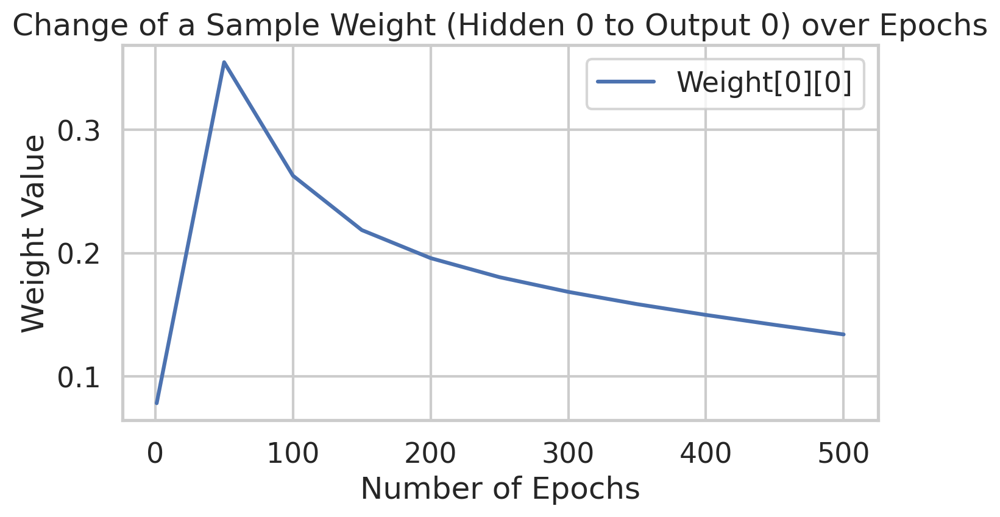


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.01
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3214437027115951
Epoch  50 - Total Error:  0.1532472088032781
Epoch  100 - Total Error:  0.15240181299771852
Epoch  150 - Total Error:  0.1521380669158913
Epoch  200 - Total Error:  0.1518757783056625
Epoch  250 - Total Error:  0.14724796655310213
Epoch  300 - Total Error:  0.09299001873367059
Epoch  350 - Total Error:  0.05460106931616721
Epoch  400 - Total Error:  0.041309270037603874
Epoch  450 - Total Error:  0.035660181499484835
Epoch  500 - Total Error:  0.0327

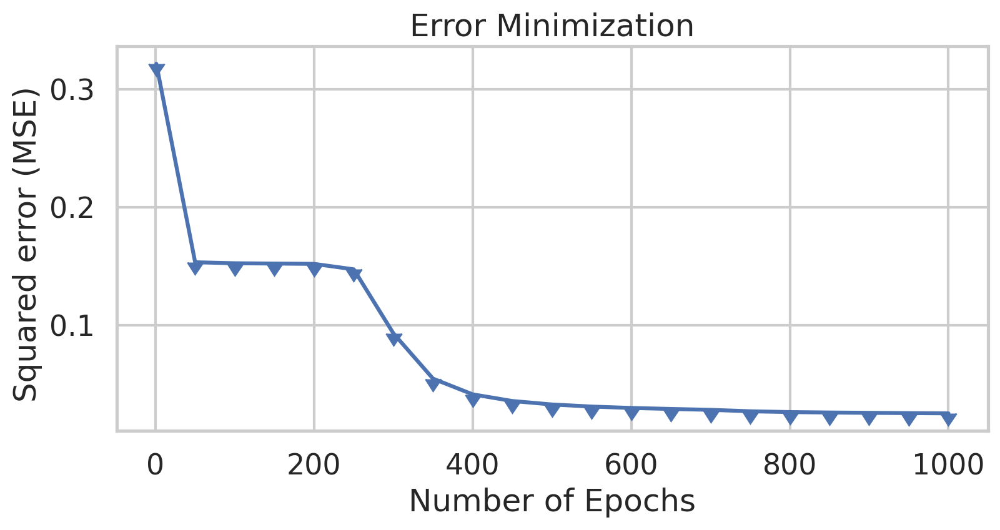

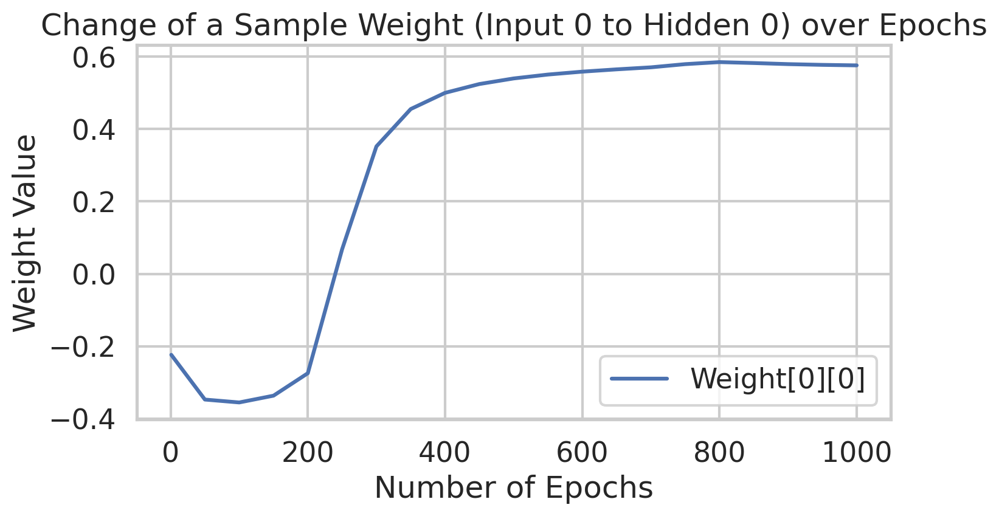

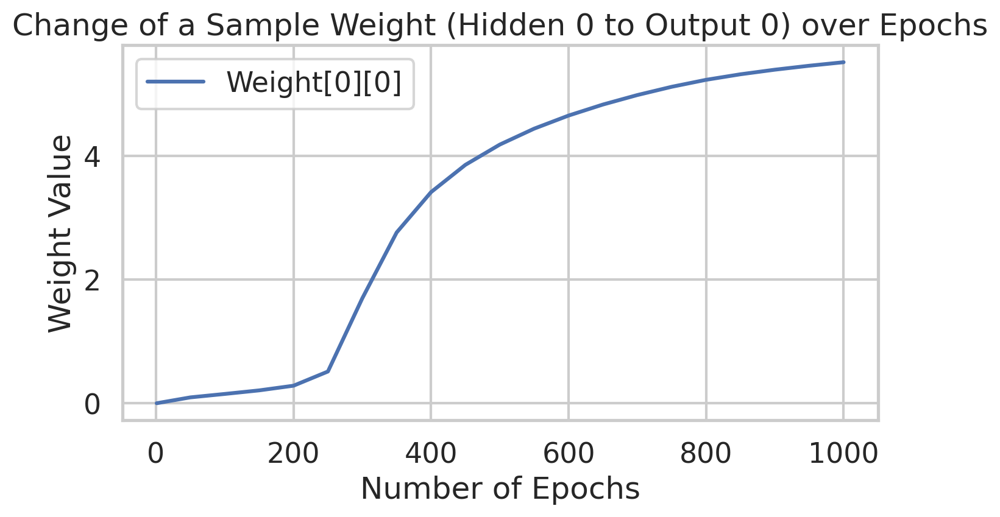


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.01
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.32170908447814056
Epoch  50 - Total Error:  0.07902712605059702
Epoch  100 - Total Error:  0.048345192874780535
Epoch  150 - Total Error:  0.03836889861546317
Epoch  200 - Total Error:  0.03391798896891749
Epoch  250 - Total Error:  0.03149085027418282
Epoch  300 - Total Error:  0.029989215661008282
Epoch  350 - Total Error:  0.02897774216920757
Epoch  400 - Total Error:  0.02825390516344061
Epoch  450 - Total Error:  0.02771204950054041
Epoch  500 - Total Error:  0.

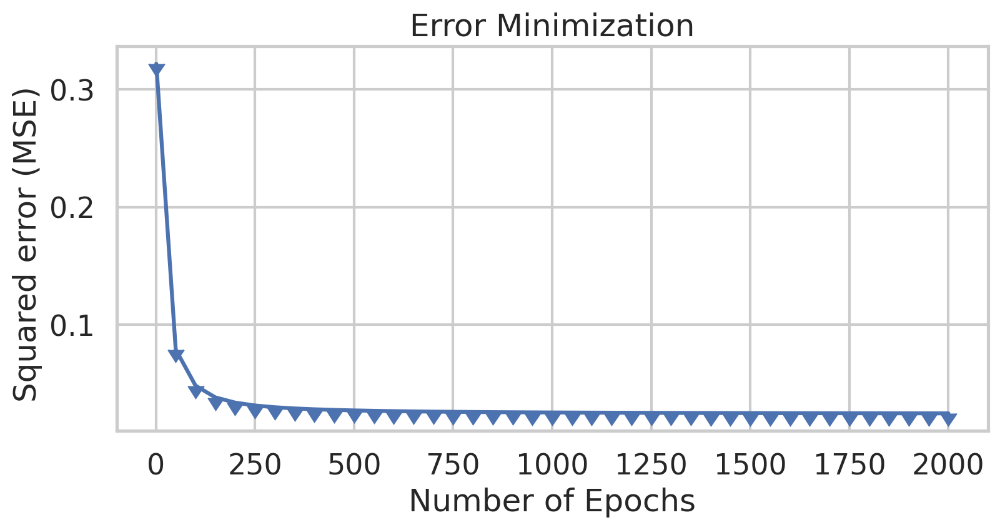

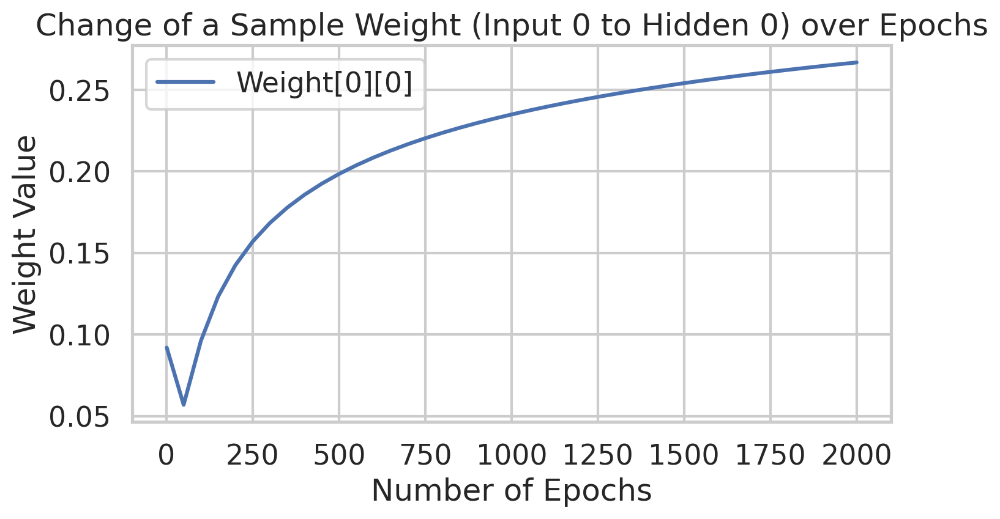

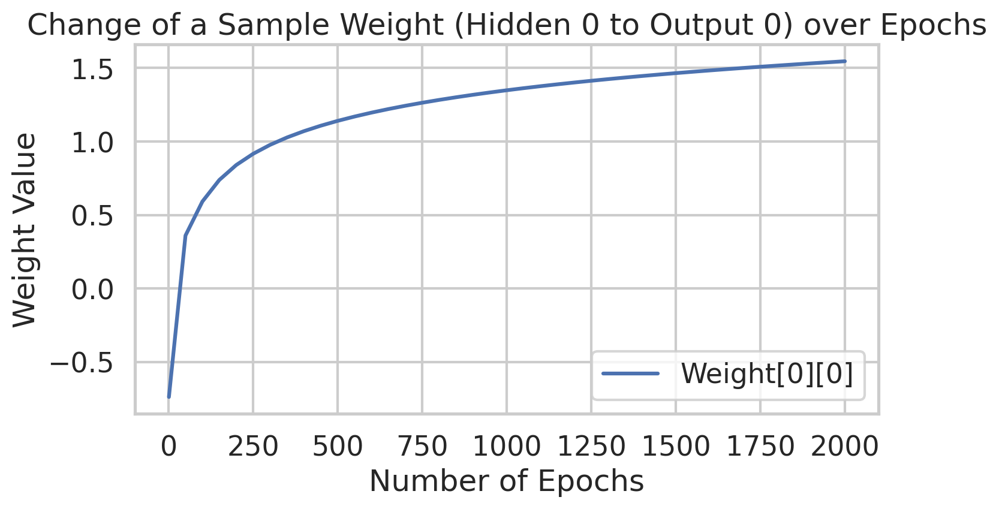


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 93.33% hits and 6.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 30 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.01
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.24516164928811288
Epoch  50 - Total Error:  0.1289621980350862
Epoch  100 - Total Error:  0.0674700518434377
Epoch  150 - Total Error:  0.04712973854605977
Epoch  200 - Total Error:  0.03927686181356623
Epoch  250 - Total Error:  0.035369697459261044
Epoch  300 - Total Error:  0.033093510781474704
Epoch  350 - Total Error:  0.03162225392145154
Epoch  400 - Total Error:  0.030598201619020927
Epoch  450 - Total Error:  0.02984375809484678
Epoch  500 - Total Error:  0.0

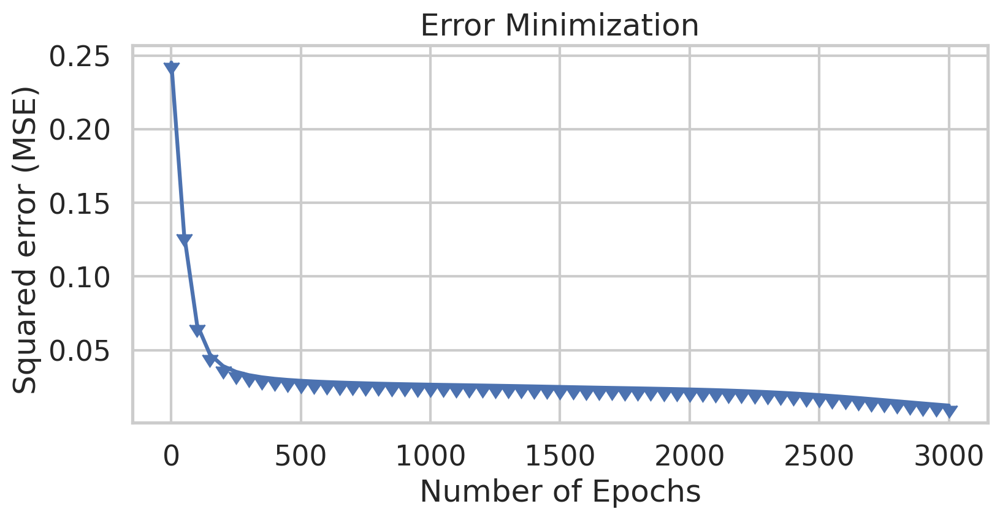

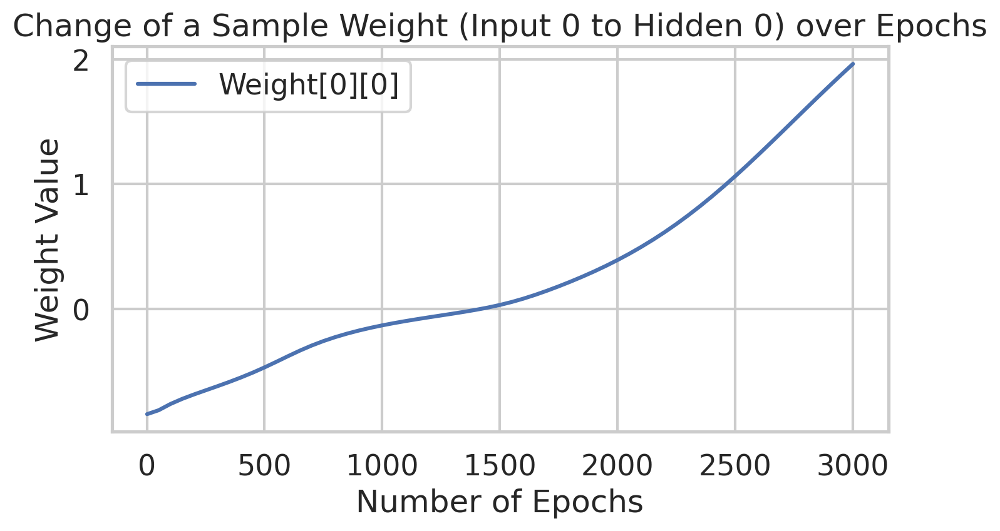

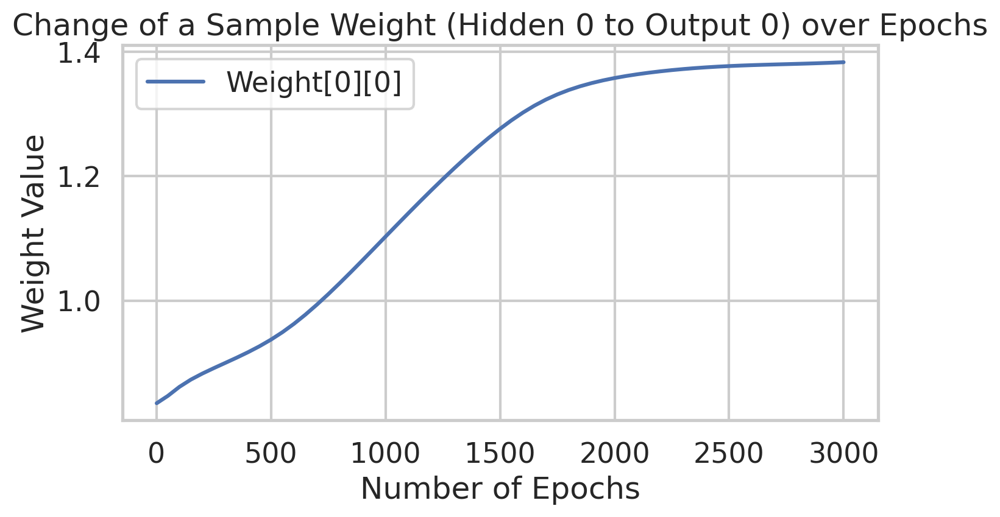


=== Test Results ===
Porcents : 70.00% hits and 30.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 0 hits
* Iris-Virginica: 1 samples, 1 hits

=== Train Results ===
Porcents : 72.50% hits and 27.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 0 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.01
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.33695631612032617
Epoch  50 - Total Error:  0.10357462311685535
Epoch  100 - Total Error:  0.04757574860119223
Epoch  150 - Total Error:  0.03612431441810363
Epoch  200 - Total Error:  0.03219186436009303
Epoch  250 - Total Error:  0.03029533883185611
Epoch  300 - Total Error:  0.029189790148265674
Epoch  350 - Total Error:  0.028460671007057136
Epoch  400 - Total Error:  0.027933823032383585
Epoch  450 - Total Error:  0.027523534646890144
Epoch  500 - Total Error: 

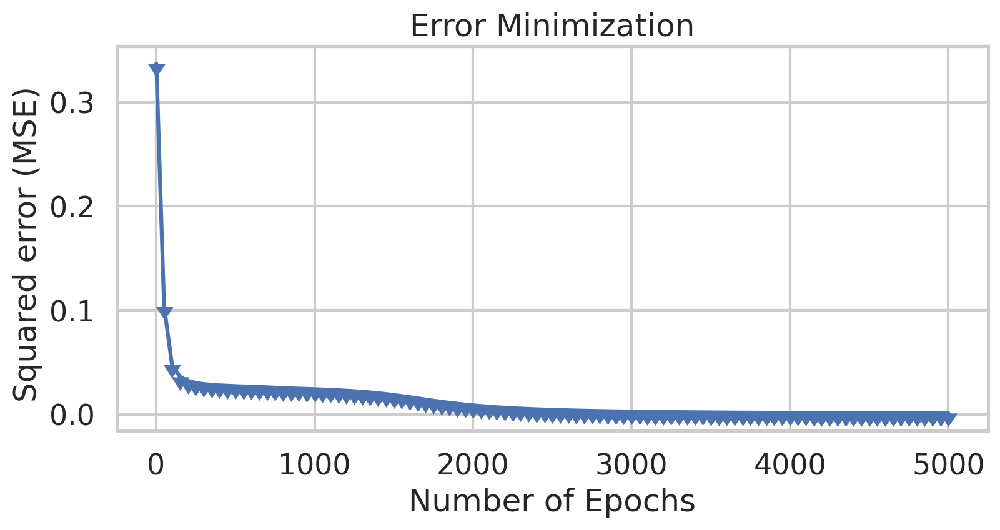

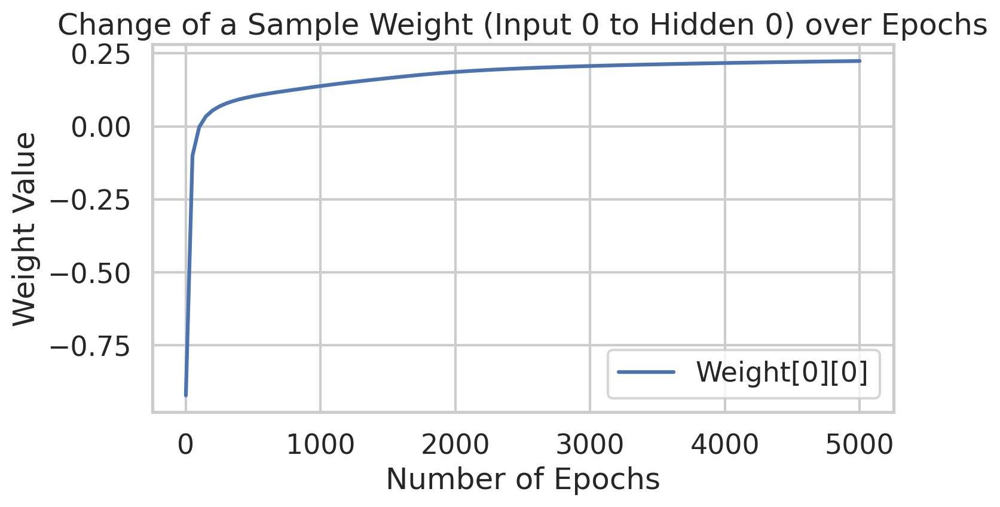

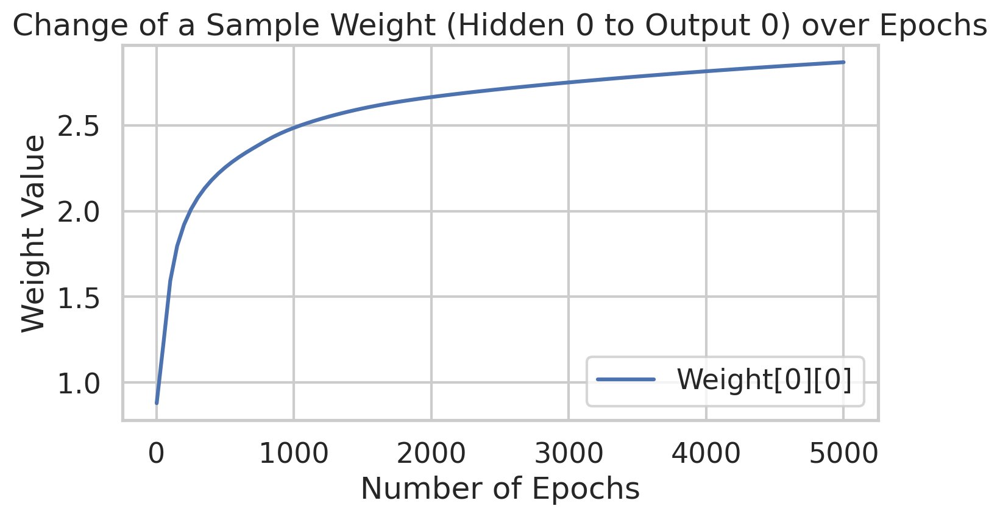


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.05
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3142623734454784
Epoch  50 - Total Error:  0.03235836733920018
Epoch  100 - Total Error:  0.028387512667611314
Epoch  150 - Total Error:  0.02716804383295537
Epoch  200 - Total Error:  0.02644820085677103
Epoch  250 - Total Error:  0.02586986178740397
Epoch  300 - Total Error:  0.025445105438208417
Epoch  350 - Total Error:  0.02516316668087272
Epoch  400 - Total Error:  0.024966674201932645
Epoch  450 - Total Error:  0.02481680093879061
Epoch  500 - Total Error:  0.0

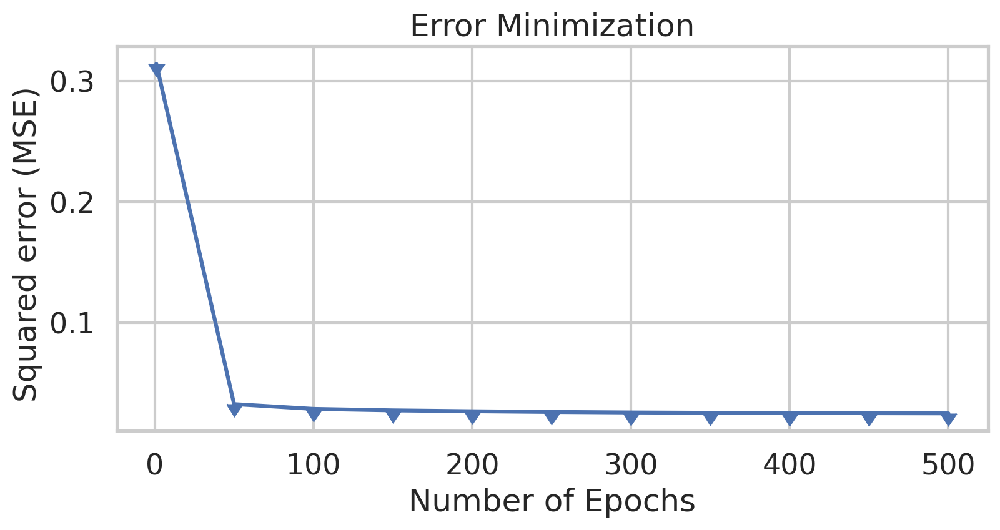

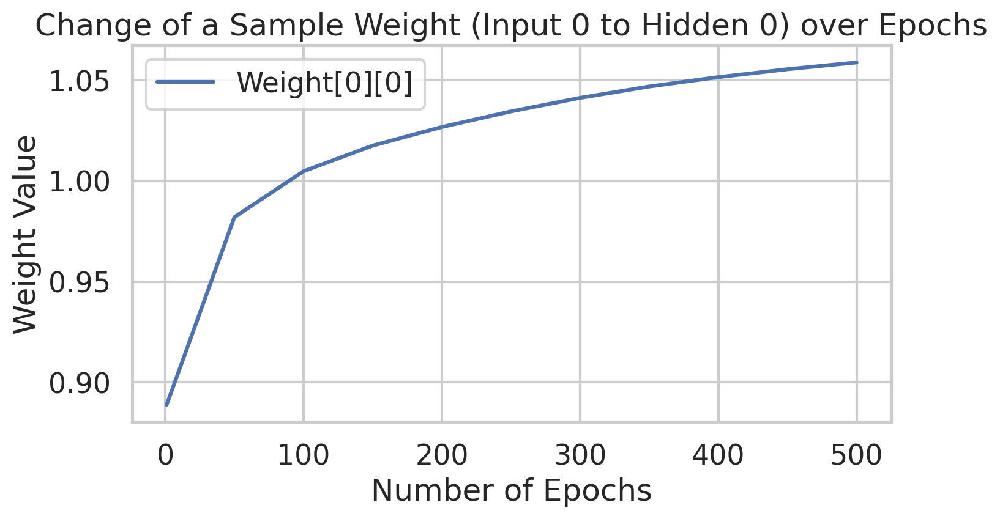

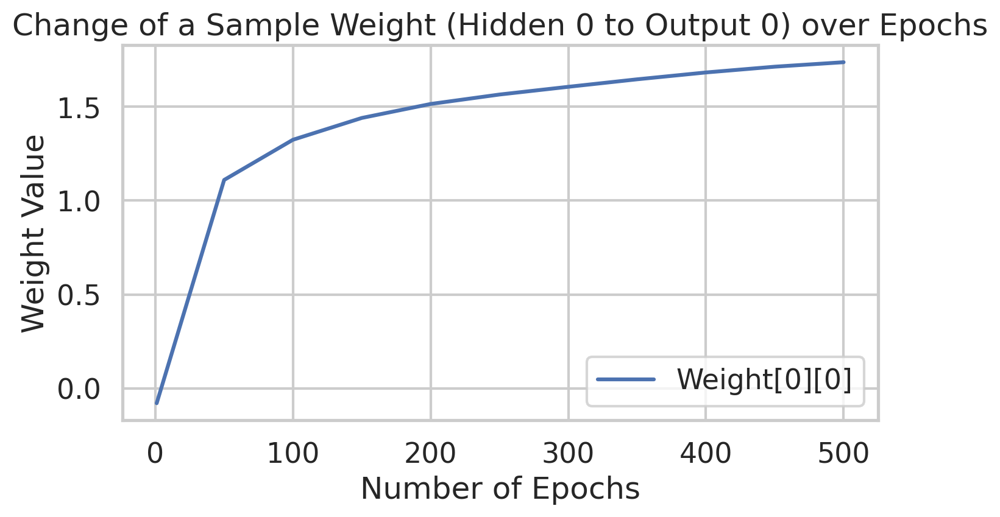


=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 32 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.05
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.23852197106976292
Epoch  50 - Total Error:  0.027571509408539068
Epoch  100 - Total Error:  0.02560282252965355
Epoch  150 - Total Error:  0.025031469149583953
Epoch  200 - Total Error:  0.024693025170063776
Epoch  250 - Total Error:  0.024436915500460826
Epoch  300 - Total Error:  0.024124942799262653
Epoch  350 - Total Error:  0.023627132215027036
Epoch  400 - Total Error:  0.02269035348509339
Epoch  450 - Total Error:  0.020785613780765707
Epoch  500 - Total Error

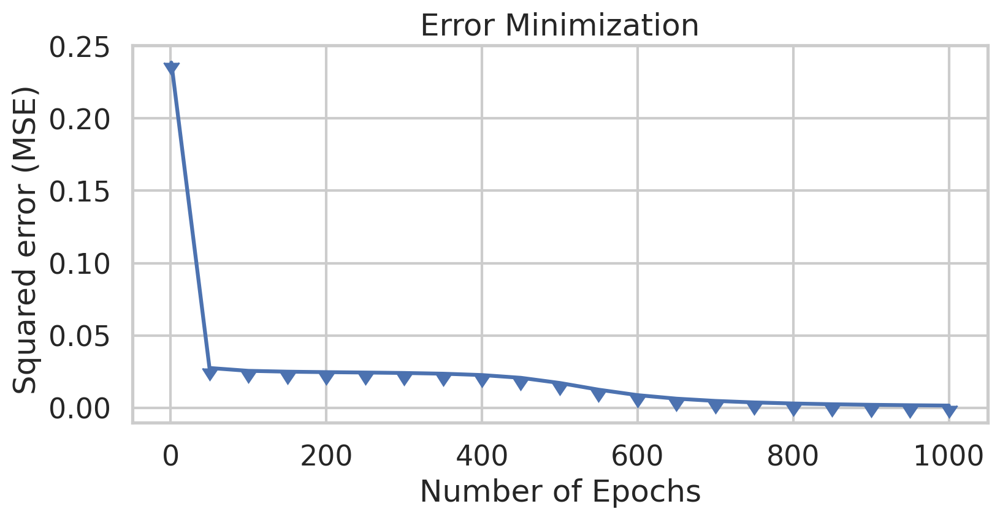

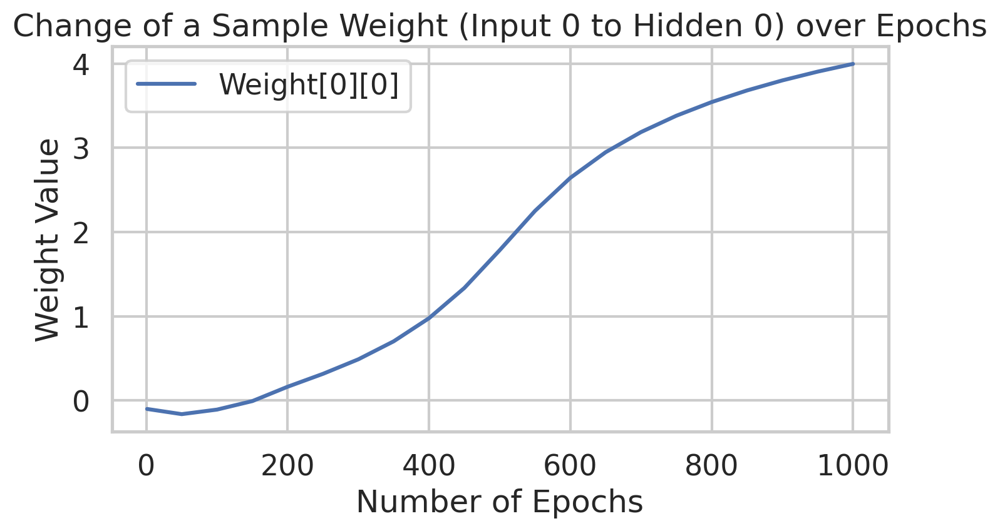

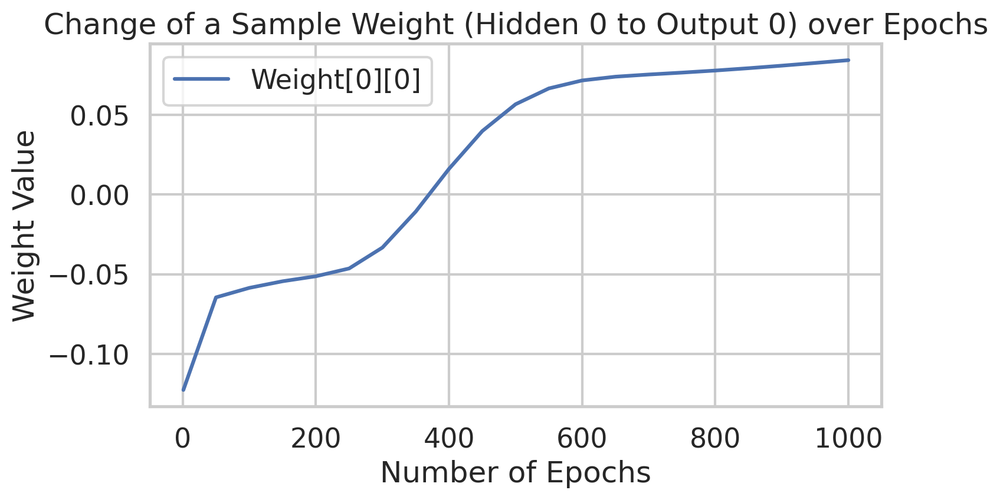


=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 1 hits
* Iris-Versicolour: 9 samples, 8 hits
* Iris-Virginica: 1 samples, 1 hits

=== Train Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 5 hits
* Iris-Versicolour: 33 samples, 30 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.05
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2134044963305868
Epoch  50 - Total Error:  0.028994020705082352
Epoch  100 - Total Error:  0.02494071621294179
Epoch  150 - Total Error:  0.023373259772839508
Epoch  200 - Total Error:  0.02153823851678309
Epoch  250 - Total Error:  0.019478671804788534
Epoch  300 - Total Error:  0.01762374740020004
Epoch  350 - Total Error:  0.015953847412002037
Epoch  400 - Total Error:  0.013979528242395121
Epoch  450 - Total Error:  0.01121037168740461
Epoch  500 - Total Error:  

In [ ]:
results = []

hidden_neurons_list = [3, 5, 7, 9, 12]
epochs_list = [500, 1000, 2000, 3000, 5000]
learning_rates = [0.001, 0.005, 0.01, 0.05, 0.1]
activation = 'sigmoid'  # you can also test 'tanh', etc.

for neurons in hidden_neurons_list:
    for lr in learning_rates:
        for ep in epochs_list:
            print("\n Running experiment:")
            print(f" - Hidden Neurons: {neurons}")
            print(f" - Learning Rate: {lr}")
            print(f" - Epochs: {ep}")
            print(f" - Activation: {activation}")

            result = run_experiment(
                train_X, train_y,
                test_X, test_y,
                n_hidden=neurons,
                learning_rate=lr,
                epochs=ep,
                activation=activation,
                show_plot=False  # Avoid plotting every time
            )

            if result:  # Ensure experiment was not skipped
                results.append(result)

print("\n All experiments completed.")


In [69]:
# Rewriting the `run_experiment` function to fix logical issues and prevent crashes.

def run_experiment(train_X, train_y, test_X, test_y,
                   n_input=4, n_hidden=5, n_output=3,
                   learning_rate=0.005, epochs=3000,
                   activation='sigmoid', show_plot=True):
    
    # Step 1: Setup Dictionary
    config = {
        'InputLayer': n_input,
        'HiddenLayer': n_hidden,
        'OutputLayer': n_output,
        'Epocas': epochs,
        'LearningRate': learning_rate,
        'BiasHiddenValue': -1,
        'BiasOutputValue': -1,
        'ActivationFunction': activation
    }

    # Step 2: Train MLP
    mlp = MultiLayerPerceptron(config)
    mlp.fit(train_X, train_y)

    # Step 3: Predict
    predictions, _ = mlp.predict(test_X, test_y)

    # Step 4: Evaluate
    hits = 0
    total = len(test_y)
    per_class_hits = [0, 0, 0]
    per_class_total = [0, 0, 0]

    for i, label in enumerate(test_y):
        label = int(label)  # Ensure valid index
        pred = int(predictions[i])
        if label == pred:
            hits += 1
            per_class_hits[label] += 1
        per_class_total[label] += 1

    if total == 0:
        print("Skipping experiment due to empty test set.")
        return None

    acc_total = (hits / total) * 100
    acc_class = [(per_class_hits[i] / per_class_total[i]) * 100 if per_class_total[i] else 0 for i in range(3)]

    print(f"Overall accuracy: {acc_total:.2f}%")
    for i, name in enumerate(['Setosa', 'Versicolour', 'Virginica']):
        print(f" - Accuracy {name}: {acc_class[i]:.2f}%")

    # Step 5: Plot (Optional)
    if show_plot:
        import matplotlib.pyplot as plt
        names = ["Setosa", "Versicolour", "Virginica"]
        x1 = [2.0, 4.0, 6.0]
        plt.figure()
        plt.bar(x1[0], acc_class[0], color='orange', label='Setosa')
        plt.bar(x1[1], acc_class[1], color='green', label='Versicolour')
        plt.bar(x1[2], acc_class[2], color='purple', label='Virginica')
        plt.ylabel('Accuracy (%)')
        plt.xticks(x1, names)
        plt.title(f'Accuracy by Class - Neurons: {n_hidden}, LR: {learning_rate}, Epochs: {epochs}')
        plt.ylim(0, 110)
        plt.show()

    # Step 6: Return results for logging/comparison
    return {
        'neurons': n_hidden,
        'epochs': epochs,
        'learning_rate': learning_rate,
        'accuracy_total': acc_total,
        'accuracy_per_class': acc_class
    }


Epoch  1 - Total Error:  0.33210101380096924
Epoch  50 - Total Error:  0.19788897271441563
Epoch  100 - Total Error:  0.1755715515472777
Epoch  150 - Total Error:  0.16470265512900084
Epoch  200 - Total Error:  0.15557250068465736
Epoch  250 - Total Error:  0.14603183977402395
Epoch  300 - Total Error:  0.1394961676255279
Epoch  350 - Total Error:  0.1329796070193642
Epoch  400 - Total Error:  0.12303592983267533
Epoch  450 - Total Error:  0.10627823620863171
Epoch  500 - Total Error:  0.09508472510472546
Epoch  550 - Total Error:  0.08505826053176356
Epoch  600 - Total Error:  0.07624129152557851
Epoch  650 - Total Error:  0.06871256451975052
Epoch  700 - Total Error:  0.06242194408414978


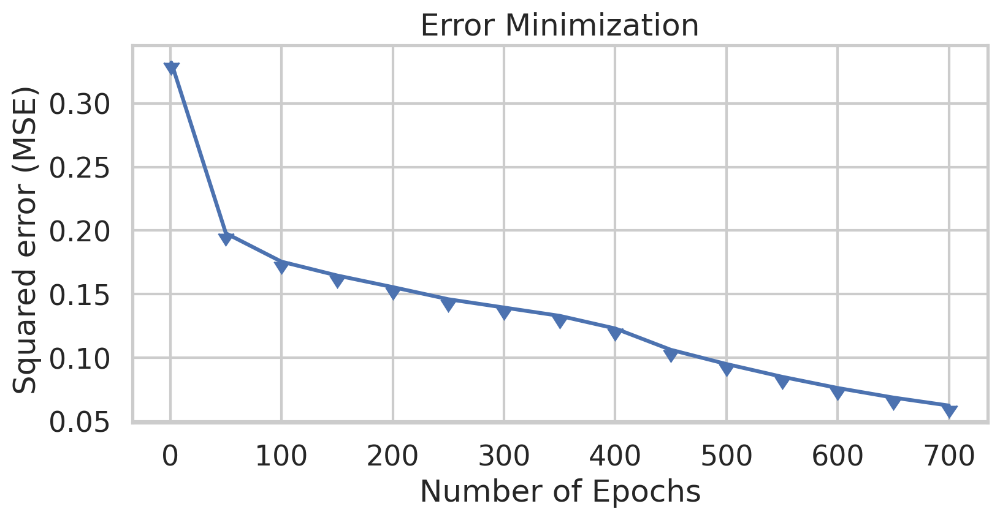

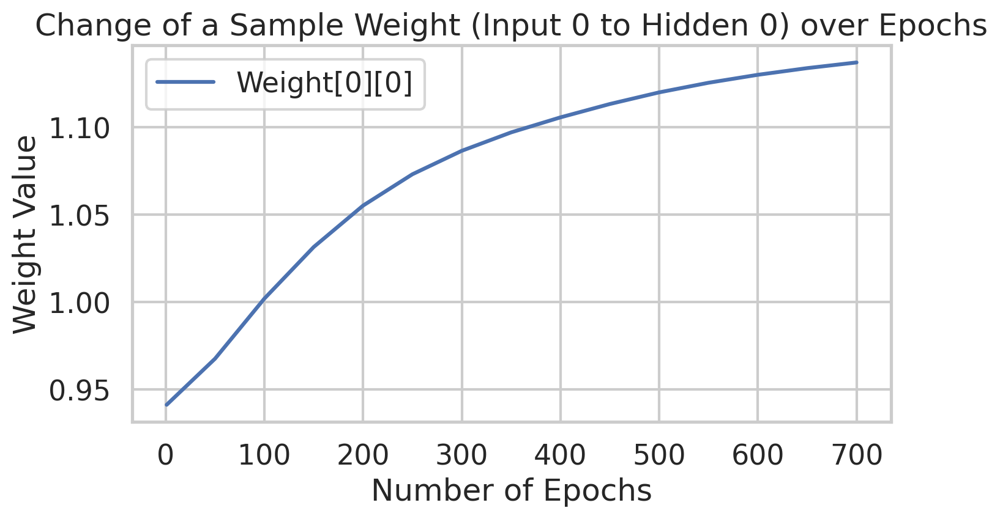

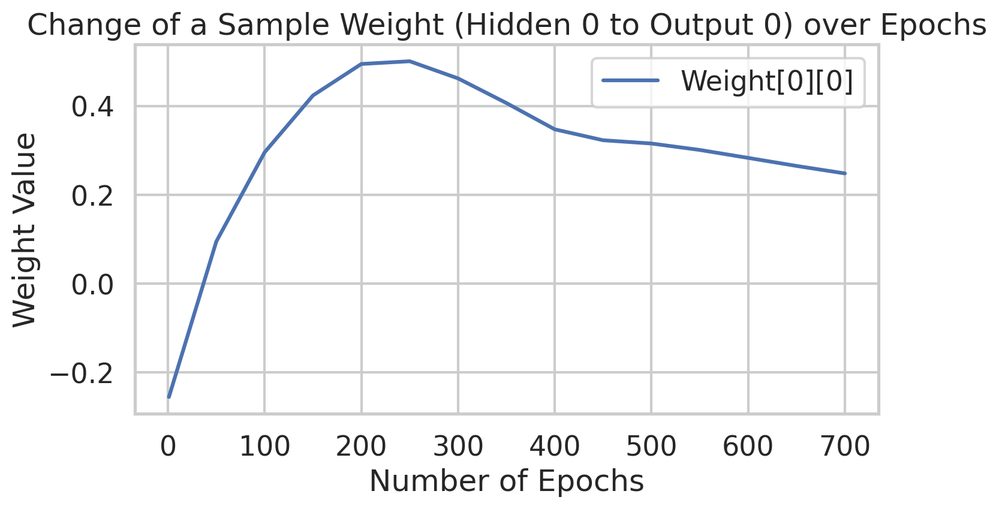

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


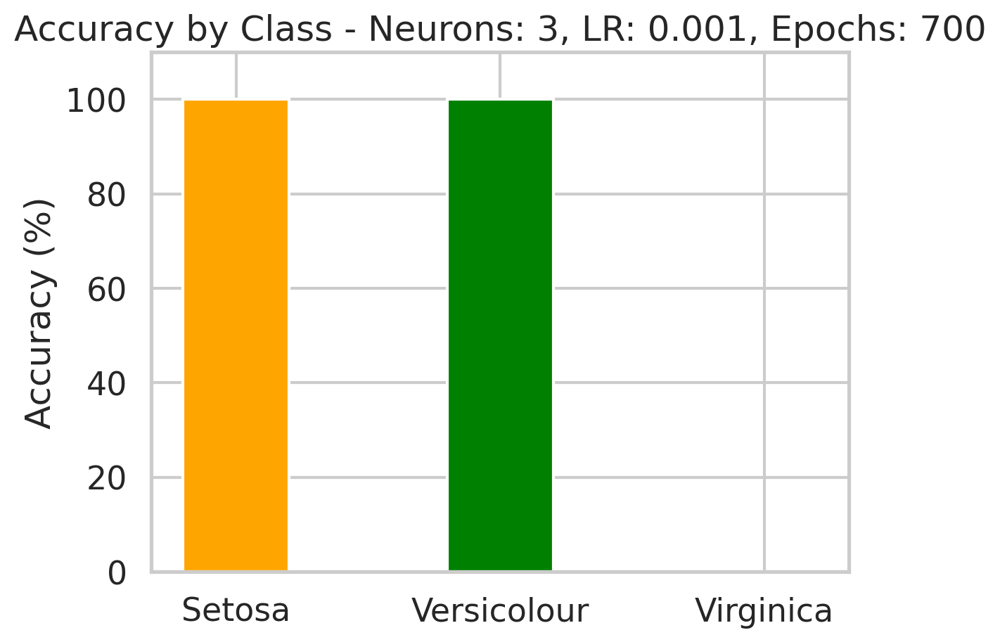

Epoch  1 - Total Error:  0.23643244577155764
Epoch  50 - Total Error:  0.1989485882196361
Epoch  100 - Total Error:  0.1769744186646289
Epoch  150 - Total Error:  0.16603422700265105
Epoch  200 - Total Error:  0.16009154645832513
Epoch  250 - Total Error:  0.15666148013720058
Epoch  300 - Total Error:  0.15455779717317236
Epoch  350 - Total Error:  0.15308776090218457
Epoch  400 - Total Error:  0.1518004014211443
Epoch  450 - Total Error:  0.15034408386495574
Epoch  500 - Total Error:  0.14838648353444353
Epoch  550 - Total Error:  0.14560826631204585
Epoch  600 - Total Error:  0.14173675100191707
Epoch  650 - Total Error:  0.13660145312024624
Epoch  700 - Total Error:  0.13022384796554076
Epoch  750 - Total Error:  0.12287154998765853
Epoch  800 - Total Error:  0.11500054401501385
Epoch  850 - Total Error:  0.10710638967997471
Epoch  900 - Total Error:  0.09958405195898523
Epoch  950 - Total Error:  0.0926698407056377
Epoch  1000 - Total Error:  0.08645886445599386


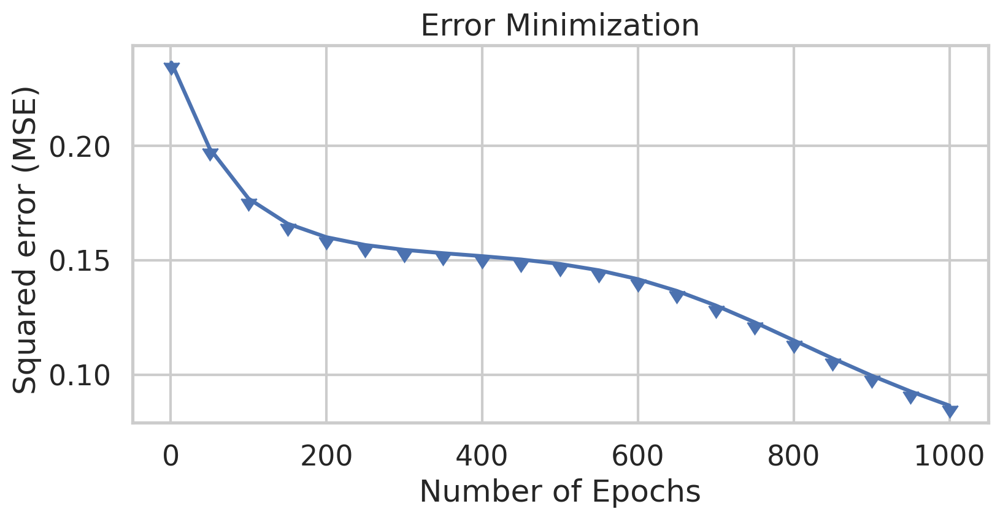

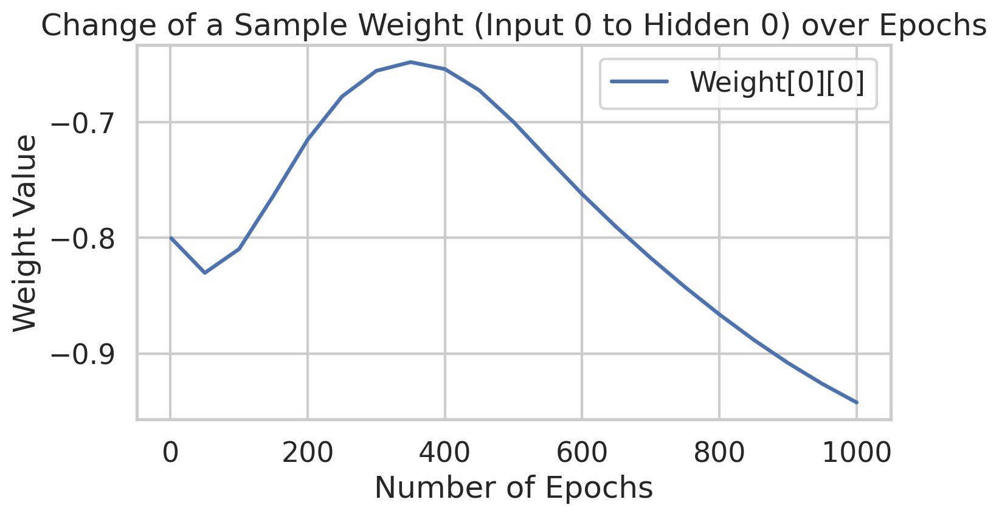

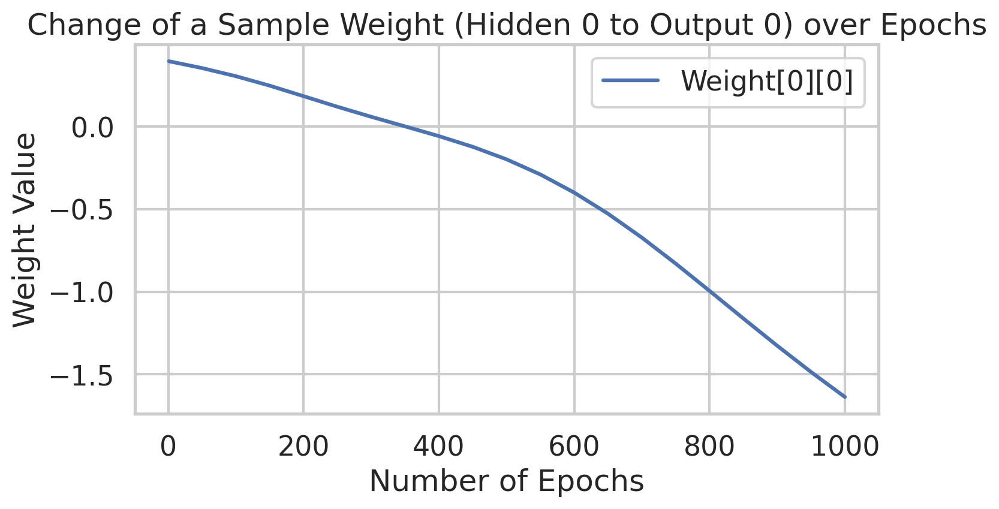

Overall accuracy: 66.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 0.00%


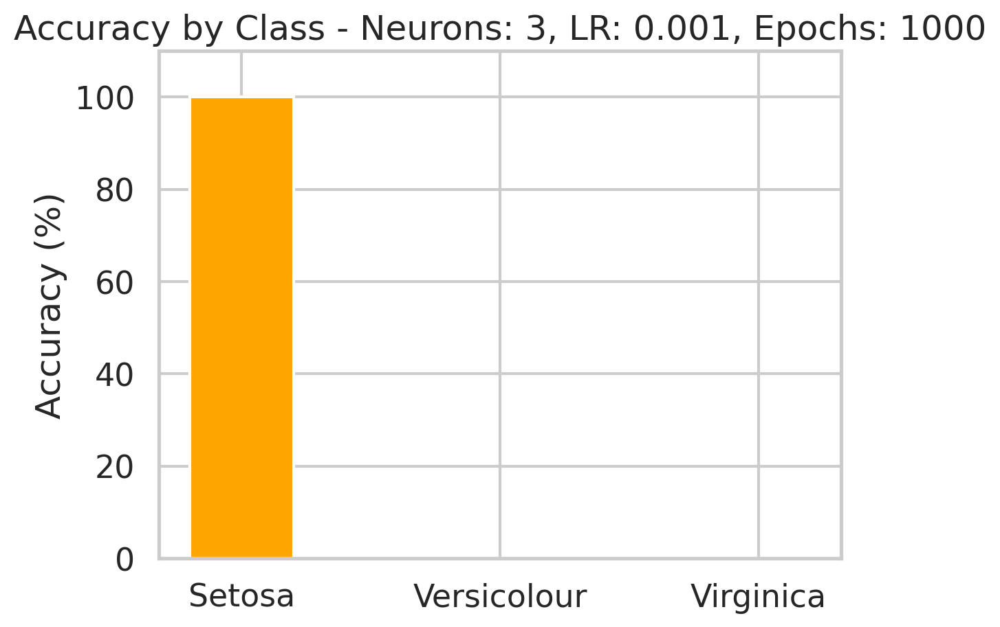

Epoch  1 - Total Error:  0.3238660387014794
Epoch  50 - Total Error:  0.24910014266701908
Epoch  100 - Total Error:  0.20028720769667868
Epoch  150 - Total Error:  0.17819046414809125
Epoch  200 - Total Error:  0.16752837801473328
Epoch  250 - Total Error:  0.16128028615129977
Epoch  300 - Total Error:  0.15300957872844392
Epoch  350 - Total Error:  0.1389206186125455
Epoch  400 - Total Error:  0.12868971599549847
Epoch  450 - Total Error:  0.12048799926310898
Epoch  500 - Total Error:  0.11404648649326056
Epoch  550 - Total Error:  0.10899614218424501
Epoch  600 - Total Error:  0.1050070930912943
Epoch  650 - Total Error:  0.10181997242598718
Epoch  700 - Total Error:  0.09924048782540937
Epoch  750 - Total Error:  0.09712546423911393
Epoch  800 - Total Error:  0.09536954170278243
Epoch  850 - Total Error:  0.09389471728107833
Epoch  900 - Total Error:  0.09264267945045672
Epoch  950 - Total Error:  0.09156934087763832
Epoch  1000 - Total Error:  0.09064097105326233
Epoch  1050 - Tota

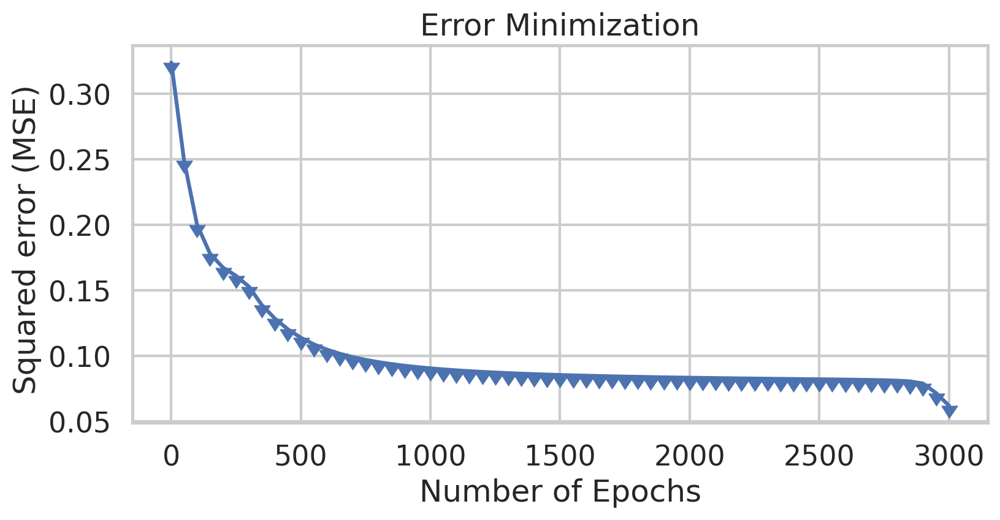

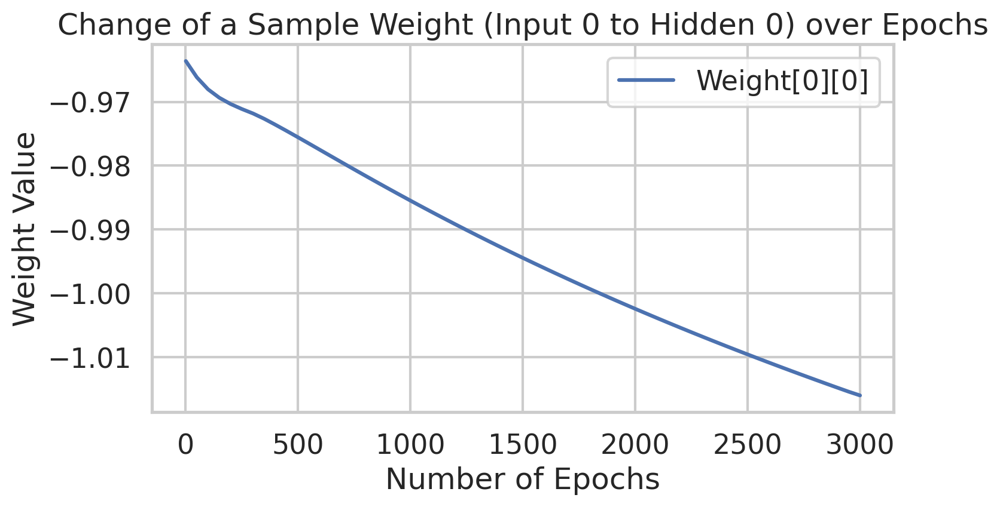

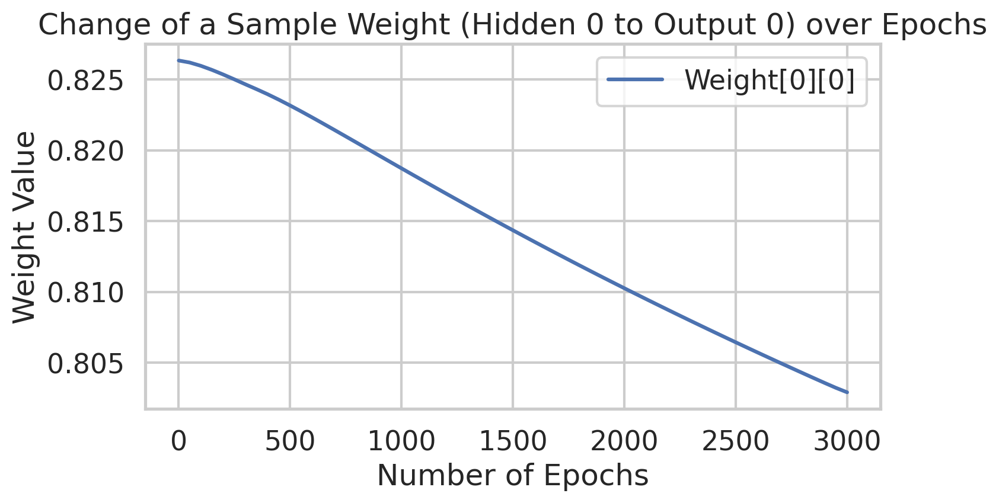

Overall accuracy: 70.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 100.00%


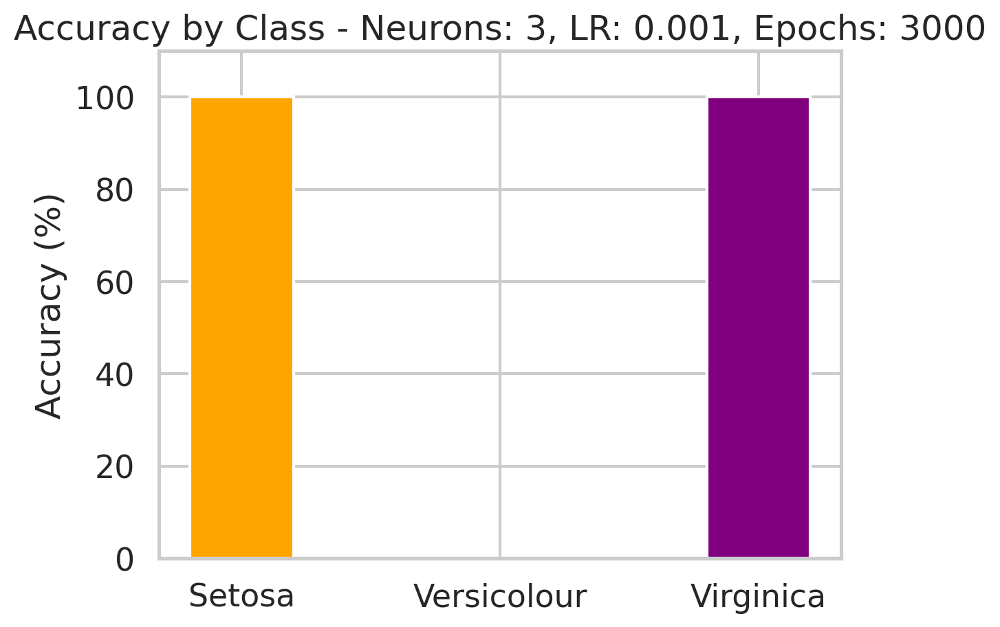

Epoch  1 - Total Error:  0.30935911668637245
Epoch  50 - Total Error:  0.2194202200900079
Epoch  100 - Total Error:  0.17585066341544336
Epoch  150 - Total Error:  0.16147830959761147
Epoch  200 - Total Error:  0.1548655261360845
Epoch  250 - Total Error:  0.15034042225296448
Epoch  300 - Total Error:  0.14599771203907233
Epoch  350 - Total Error:  0.14106025597268898
Epoch  400 - Total Error:  0.1352505461384145
Epoch  450 - Total Error:  0.1286058029663306
Epoch  500 - Total Error:  0.1213723435607555
Epoch  550 - Total Error:  0.11388891303380899
Epoch  600 - Total Error:  0.106481975225075
Epoch  650 - Total Error:  0.09940603844101017
Epoch  700 - Total Error:  0.09282685088284004
Epoch  750 - Total Error:  0.08682918550794443
Epoch  800 - Total Error:  0.08143526520392991
Epoch  850 - Total Error:  0.07662556333137743
Epoch  900 - Total Error:  0.07235691651932045
Epoch  950 - Total Error:  0.06857571466292901
Epoch  1000 - Total Error:  0.06522622674089683
Epoch  1050 - Total Er

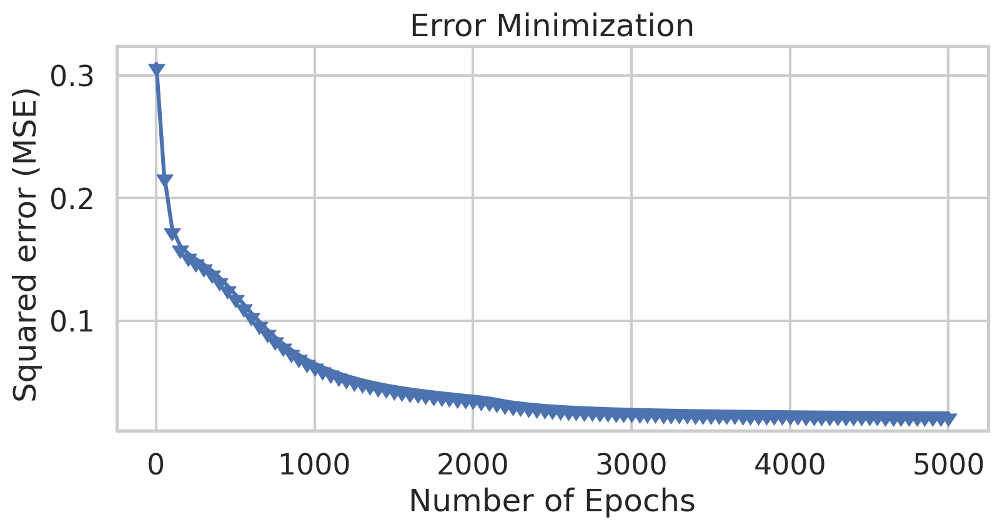

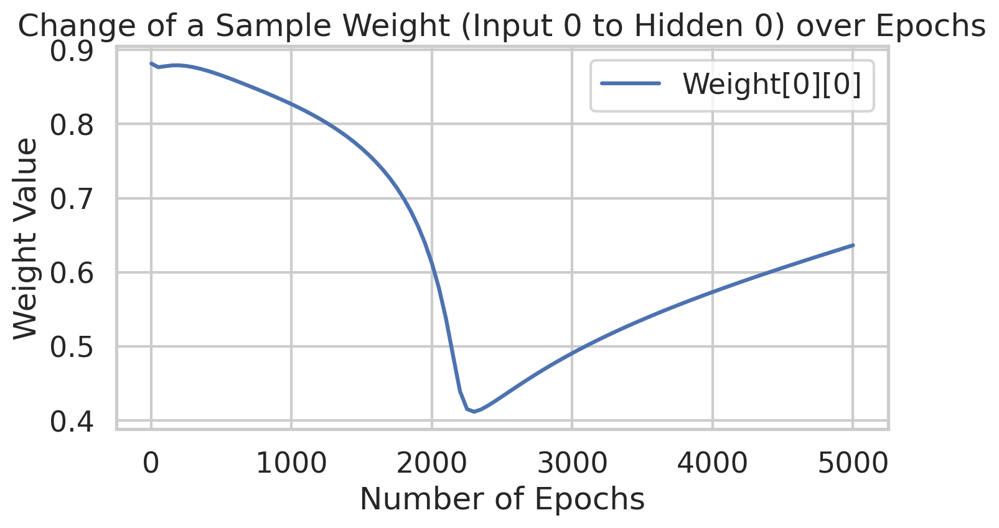

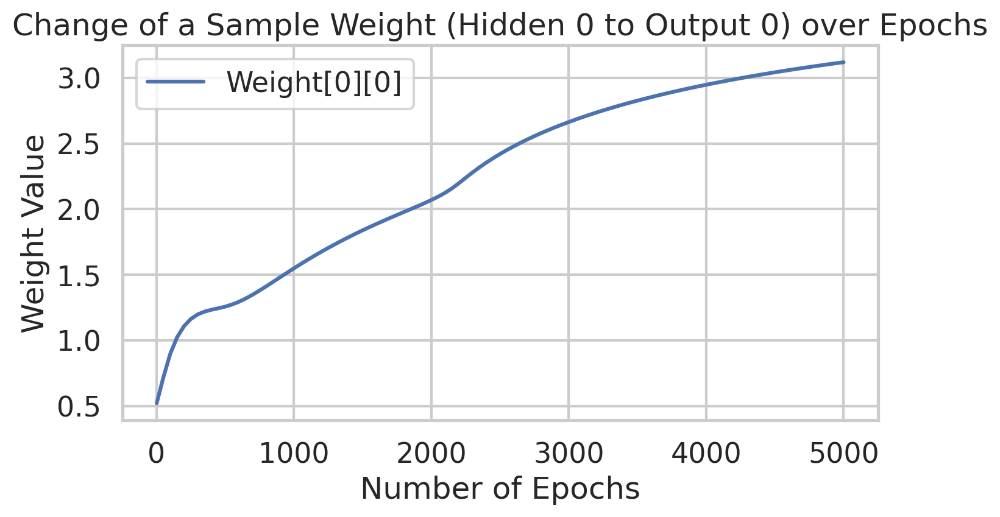

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


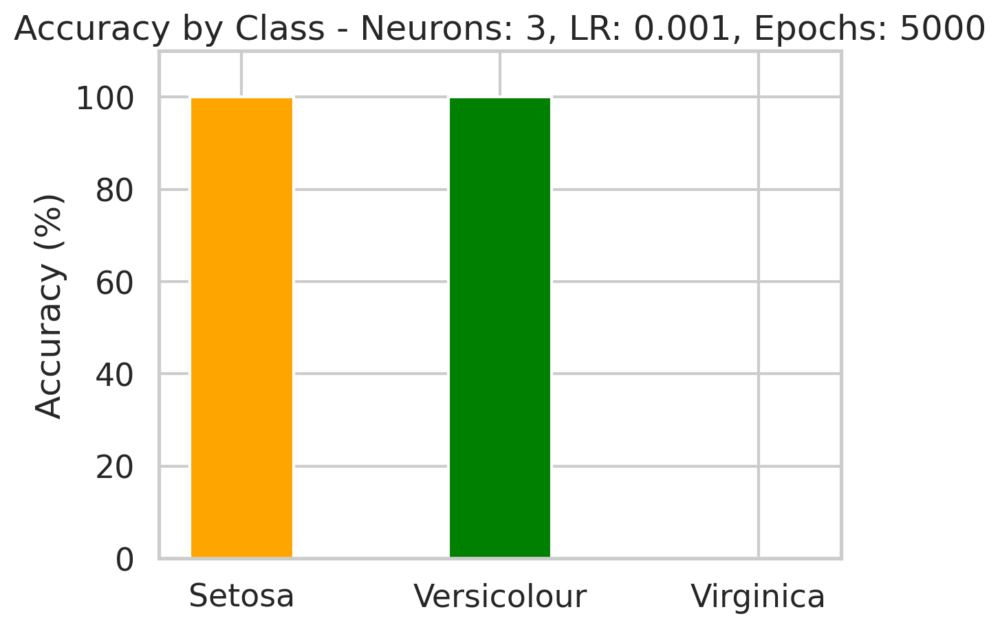

Epoch  1 - Total Error:  0.19374392486579514
Epoch  50 - Total Error:  0.11408933226912356
Epoch  100 - Total Error:  0.08490101197607554
Epoch  150 - Total Error:  0.06413109897370123
Epoch  200 - Total Error:  0.0512479174695558
Epoch  250 - Total Error:  0.04340331599873605
Epoch  300 - Total Error:  0.03848512750872404
Epoch  350 - Total Error:  0.03526662394301013
Epoch  400 - Total Error:  0.03306701046607159
Epoch  450 - Total Error:  0.031503237062189375
Epoch  500 - Total Error:  0.030352533790610134
Epoch  550 - Total Error:  0.02948032008031322
Epoch  600 - Total Error:  0.028802187124243983
Epoch  650 - Total Error:  0.028263317966991965
Epoch  700 - Total Error:  0.027826973380226116


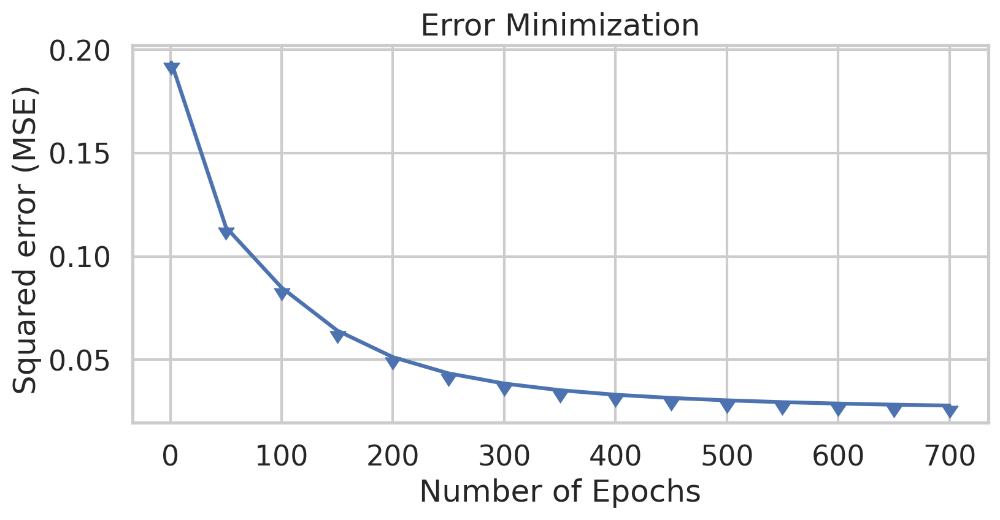

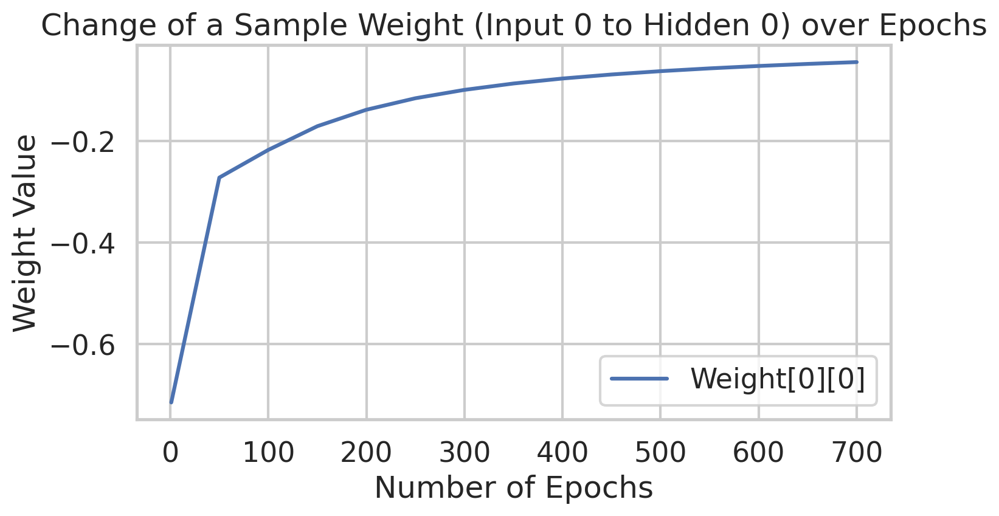

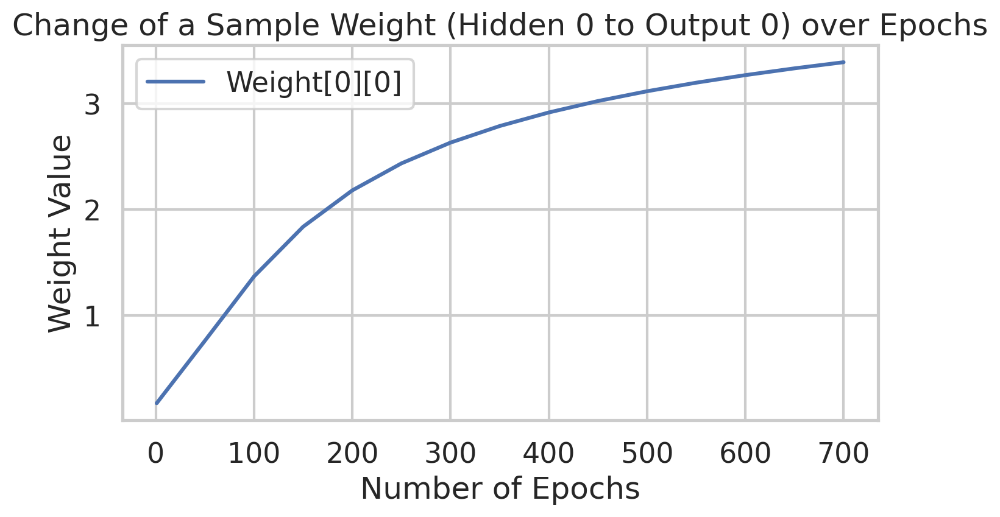

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


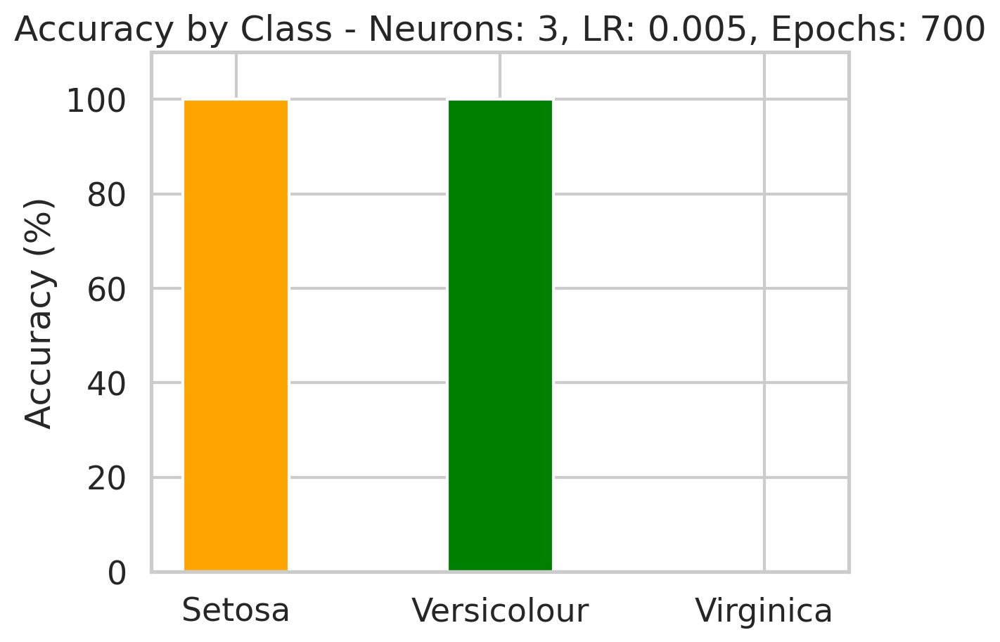

Epoch  1 - Total Error:  0.26807459393822053
Epoch  50 - Total Error:  0.15479040479349182
Epoch  100 - Total Error:  0.10760166297856212
Epoch  150 - Total Error:  0.07691710387141502
Epoch  200 - Total Error:  0.060239719834014105
Epoch  250 - Total Error:  0.05026393517411551
Epoch  300 - Total Error:  0.044007642409229206
Epoch  350 - Total Error:  0.03987072929326619
Epoch  400 - Total Error:  0.03699911921563422
Epoch  450 - Total Error:  0.034921576629945335
Epoch  500 - Total Error:  0.03336565848521055
Epoch  550 - Total Error:  0.032166304848230305
Epoch  600 - Total Error:  0.03121915416237512
Epoch  650 - Total Error:  0.030455688671924382
Epoch  700 - Total Error:  0.029829417501522418
Epoch  750 - Total Error:  0.02930787547904662
Epoch  800 - Total Error:  0.028867813949532826
Epoch  850 - Total Error:  0.028492211703462757
Epoch  900 - Total Error:  0.028168360616174594
Epoch  950 - Total Error:  0.02788660624105097
Epoch  1000 - Total Error:  0.027639499100938117


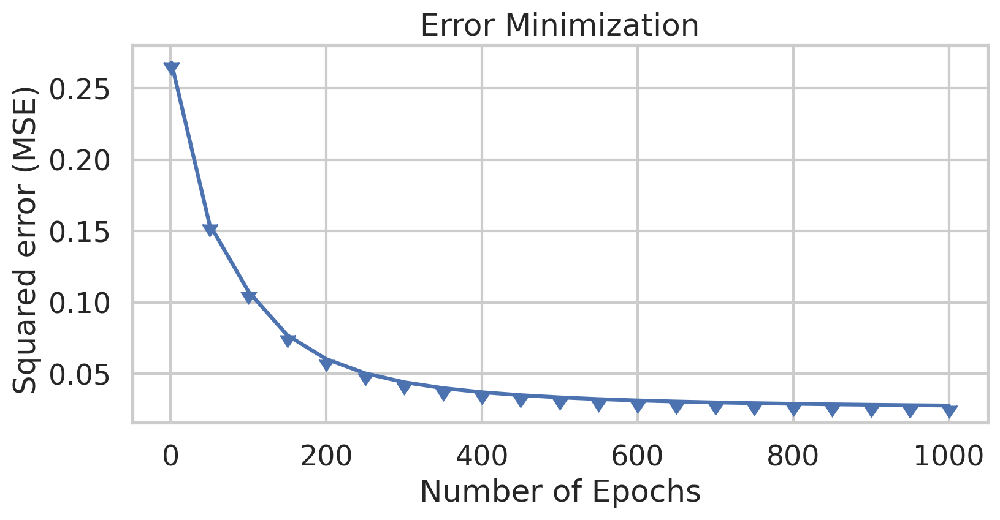

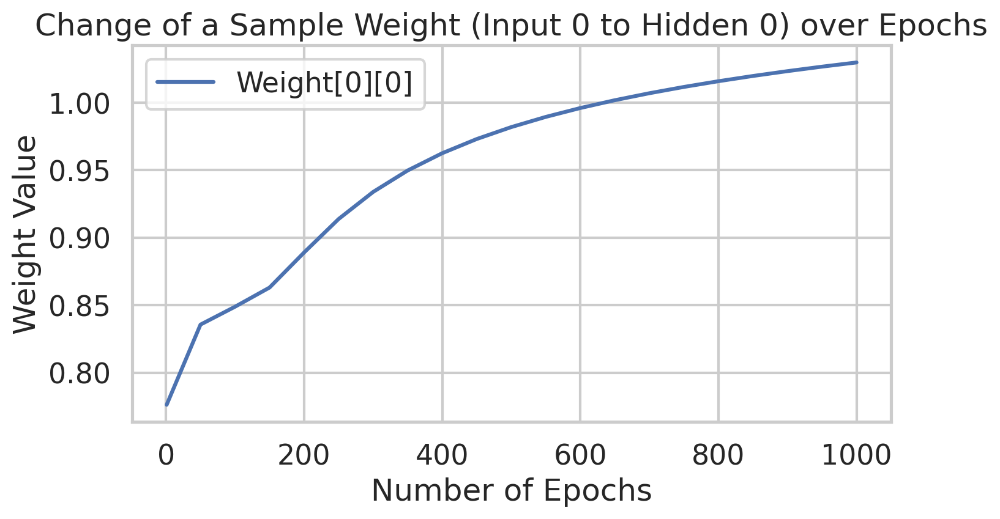

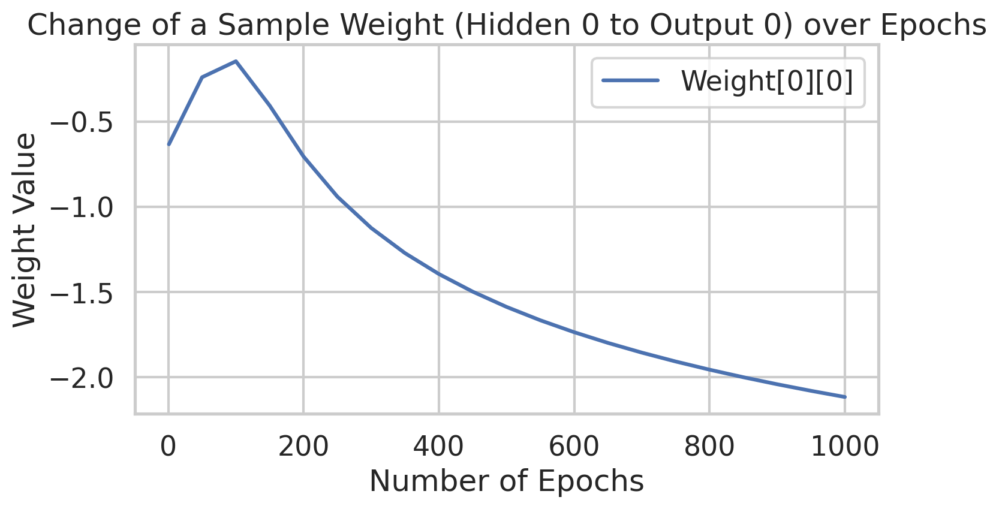

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


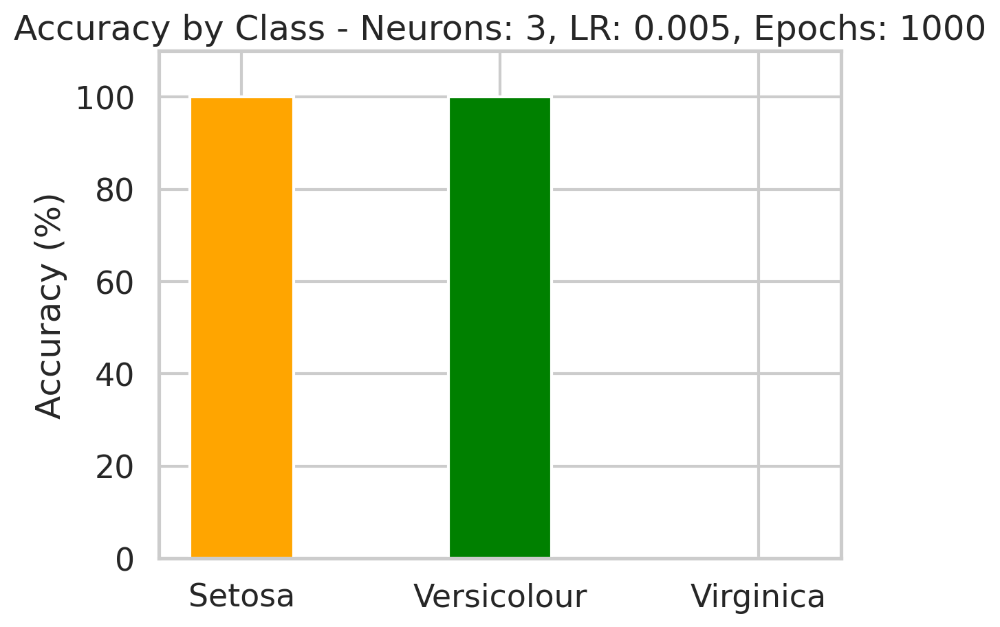

Epoch  1 - Total Error:  0.2583682944935647
Epoch  50 - Total Error:  0.14833718768534704
Epoch  100 - Total Error:  0.10438074499803124
Epoch  150 - Total Error:  0.07040308738372589
Epoch  200 - Total Error:  0.05155207436887511
Epoch  250 - Total Error:  0.04183048589538059
Epoch  300 - Total Error:  0.036568129355050334
Epoch  350 - Total Error:  0.033480271674966075
Epoch  400 - Total Error:  0.031524207673850634
Epoch  450 - Total Error:  0.03020125474604092
Epoch  500 - Total Error:  0.029256612129732344
Epoch  550 - Total Error:  0.028551372651029513
Epoch  600 - Total Error:  0.02800530078736442
Epoch  650 - Total Error:  0.0275696903404898
Epoch  700 - Total Error:  0.02721369983924356
Epoch  750 - Total Error:  0.026917078418654365
Epoch  800 - Total Error:  0.026666092520629625
Epoch  850 - Total Error:  0.02645114096477662
Epoch  900 - Total Error:  0.026265305530251123
Epoch  950 - Total Error:  0.026103444842510568
Epoch  1000 - Total Error:  0.025961617633605726
Epoch  

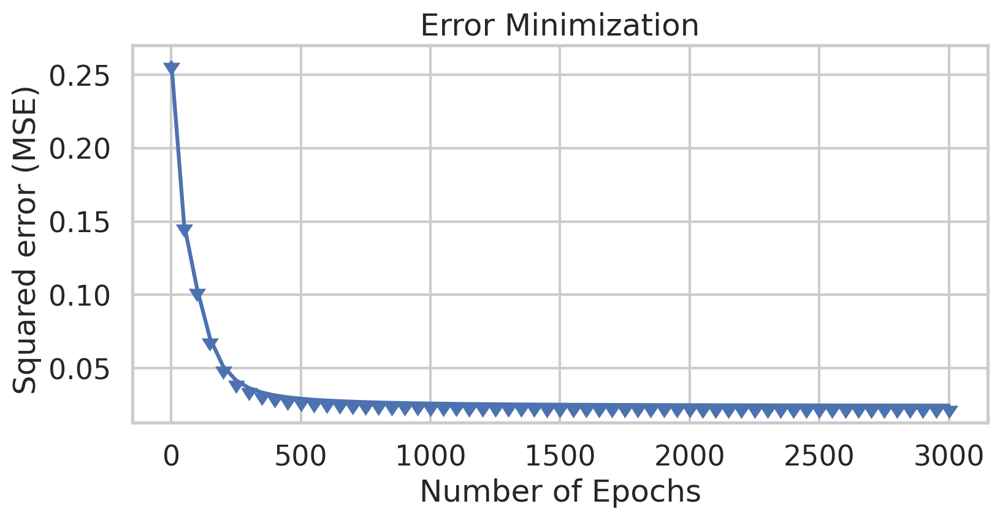

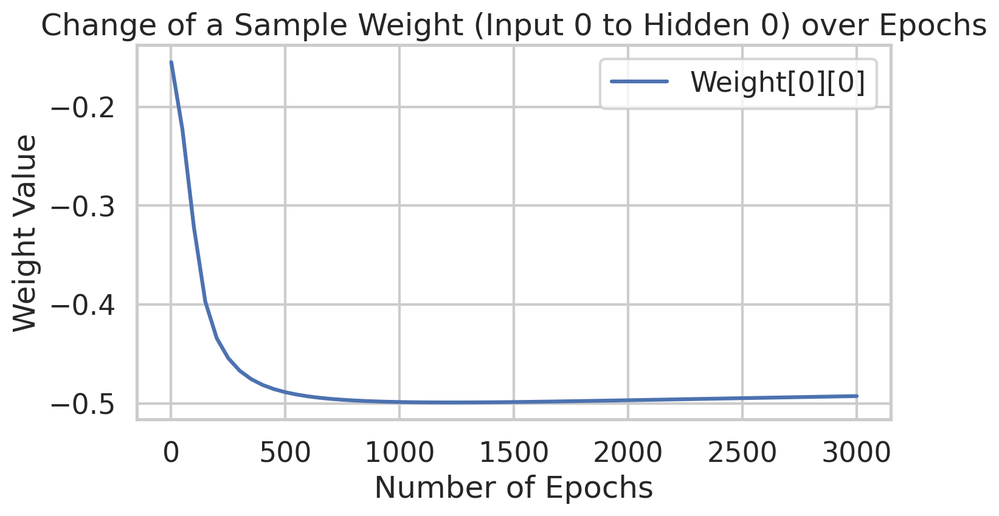

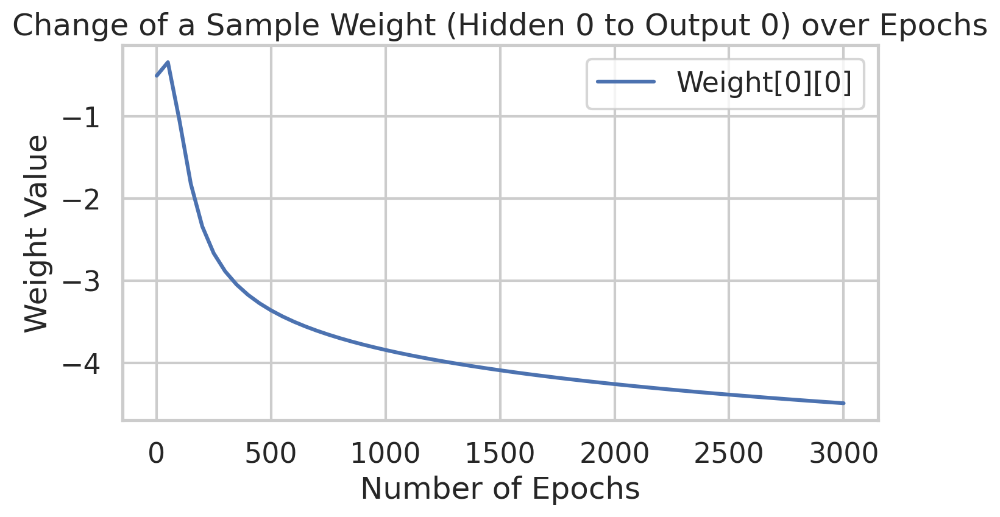

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


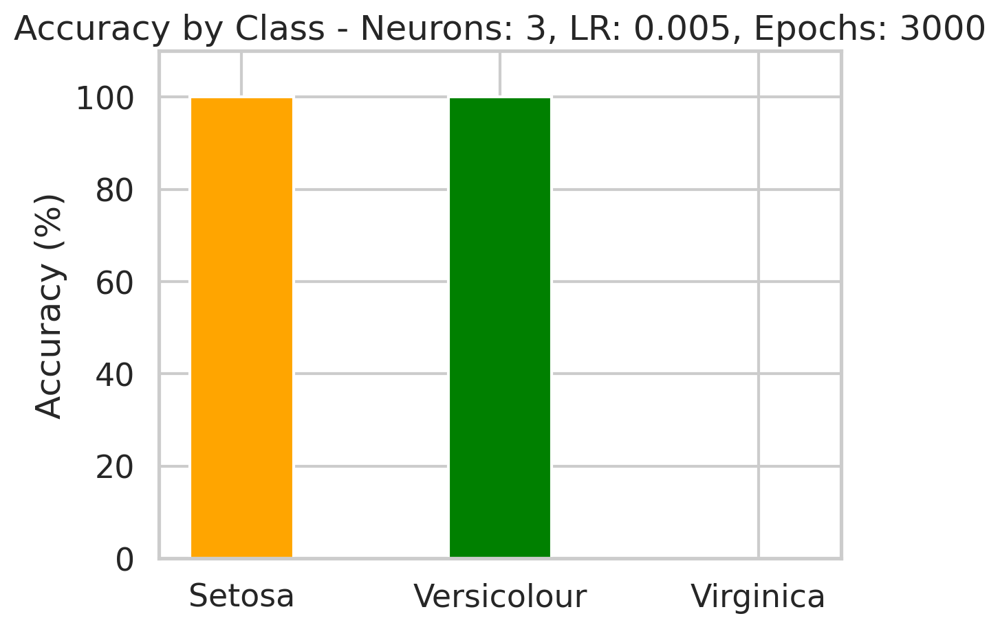

Epoch  1 - Total Error:  0.34955127377959516
Epoch  50 - Total Error:  0.13342587786557714
Epoch  100 - Total Error:  0.10122673399880795
Epoch  150 - Total Error:  0.07427709376853762
Epoch  200 - Total Error:  0.0573955565853928
Epoch  250 - Total Error:  0.0475434424699434
Epoch  300 - Total Error:  0.04158712723326716
Epoch  350 - Total Error:  0.03776599498835894
Epoch  400 - Total Error:  0.03517304066414258
Epoch  450 - Total Error:  0.03332816556525394
Epoch  500 - Total Error:  0.031963517737383026
Epoch  550 - Total Error:  0.030921395979118884
Epoch  600 - Total Error:  0.03010432176973341
Epoch  650 - Total Error:  0.029449431655124727
Epoch  700 - Total Error:  0.028914674595291588
Epoch  750 - Total Error:  0.028471019140591483
Epoch  800 - Total Error:  0.028097866205460995
Epoch  850 - Total Error:  0.02778024680832318
Epoch  900 - Total Error:  0.027507053053091375
Epoch  950 - Total Error:  0.027269888358434708
Epoch  1000 - Total Error:  0.02706230053211378
Epoch  10

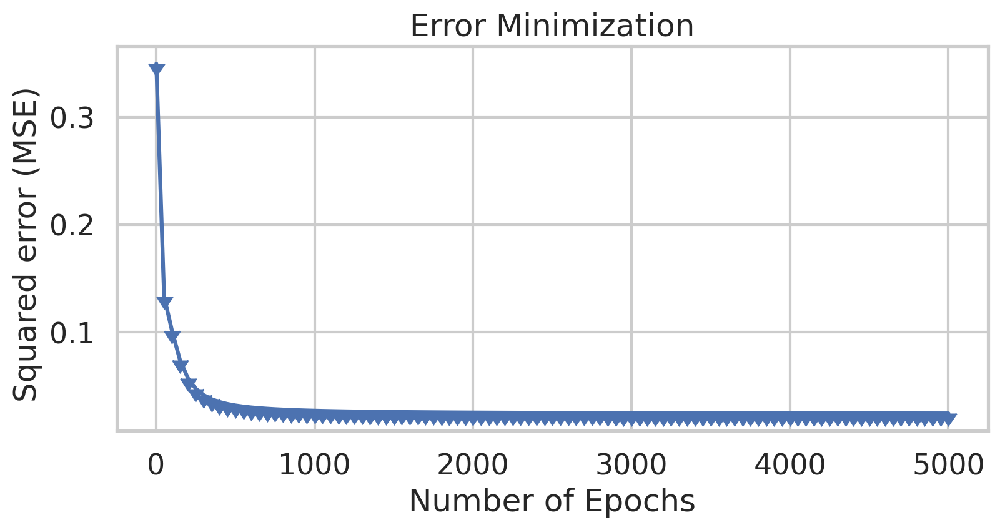

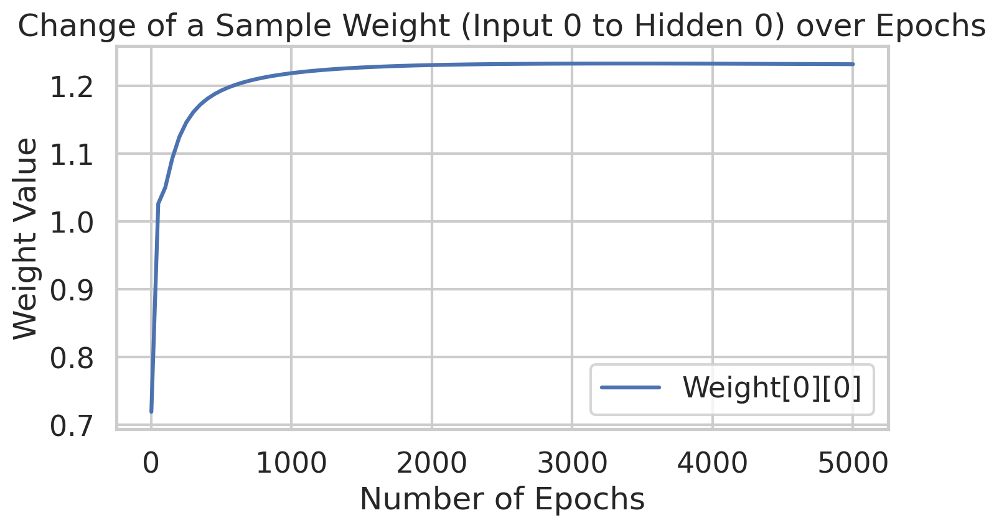

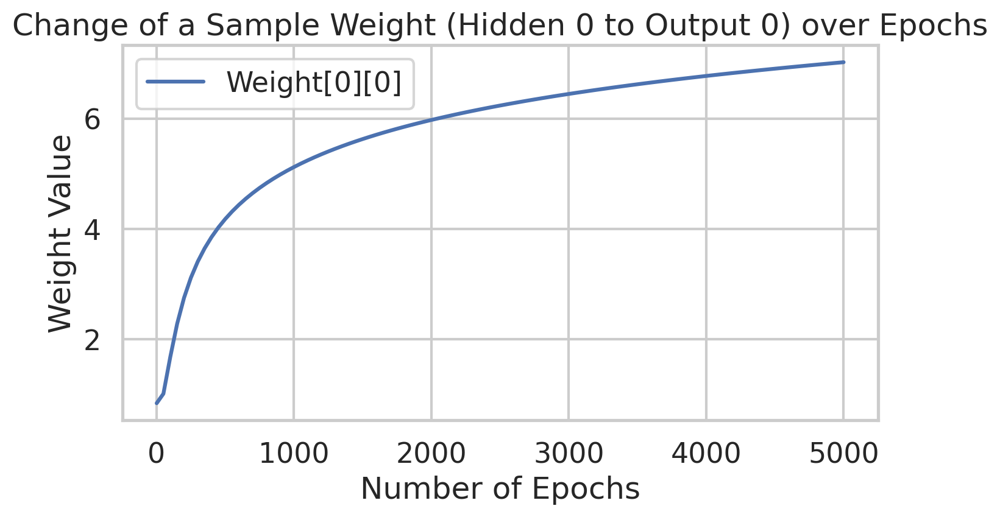

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


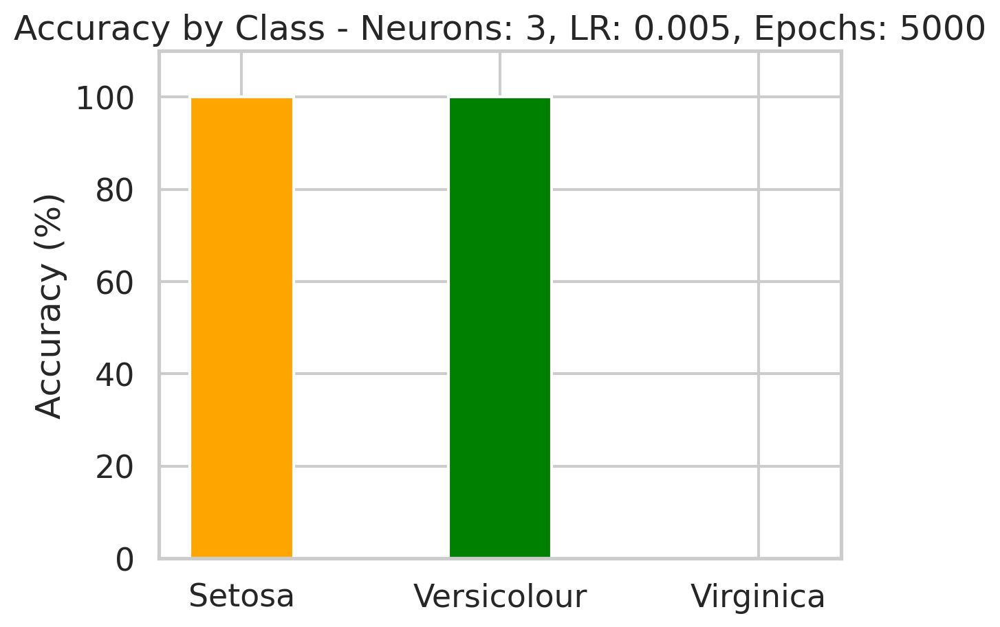

Epoch  1 - Total Error:  0.22791312033850128
Epoch  50 - Total Error:  0.12043605866791841
Epoch  100 - Total Error:  0.06330849646389079
Epoch  150 - Total Error:  0.04421831131290242
Epoch  200 - Total Error:  0.03682669680995269
Epoch  250 - Total Error:  0.031019619137184425
Epoch  300 - Total Error:  0.028819810033690527
Epoch  350 - Total Error:  0.027603388198435837
Epoch  400 - Total Error:  0.026832507670926282
Epoch  450 - Total Error:  0.026303664891863997
Epoch  500 - Total Error:  0.025917806190991356
Epoch  550 - Total Error:  0.025620317770059898
Epoch  600 - Total Error:  0.02537818452171915
Epoch  650 - Total Error:  0.02516969719332638
Epoch  700 - Total Error:  0.024979367135870678


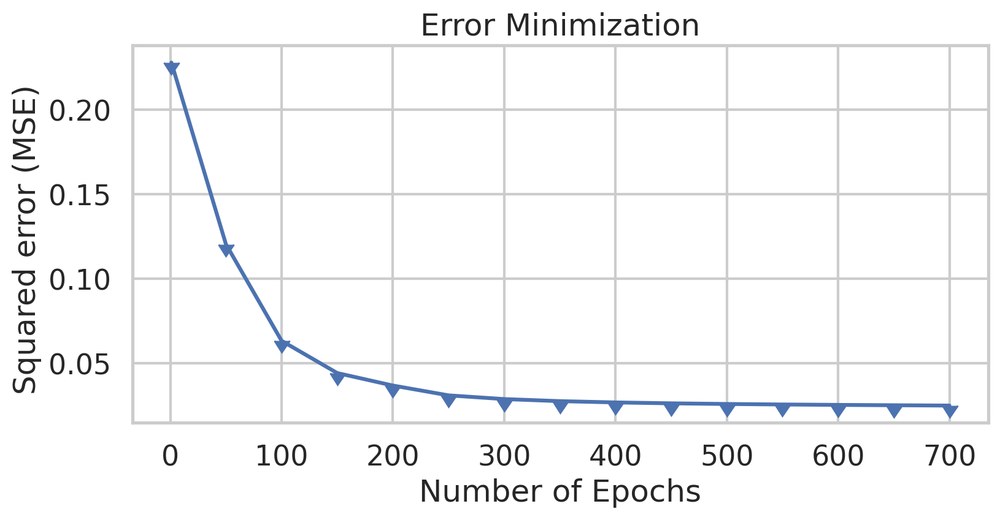

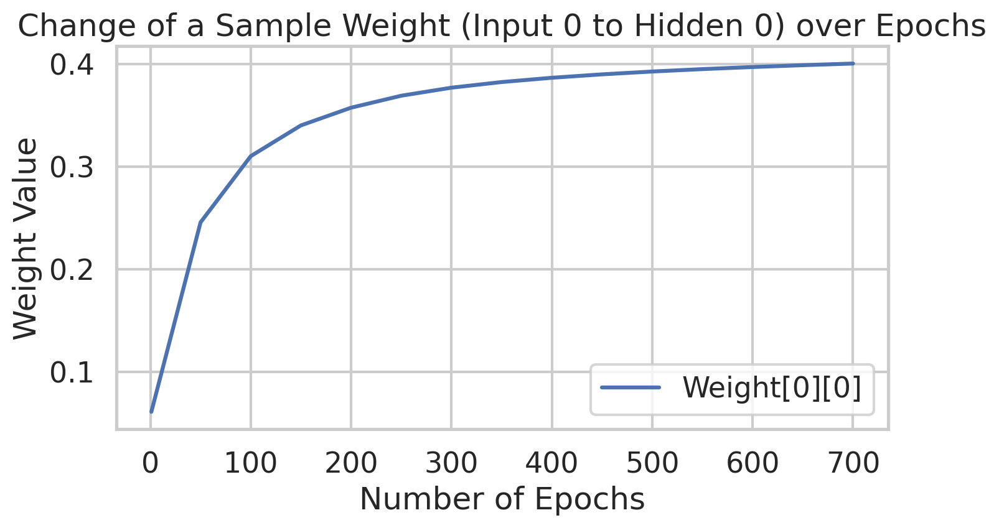

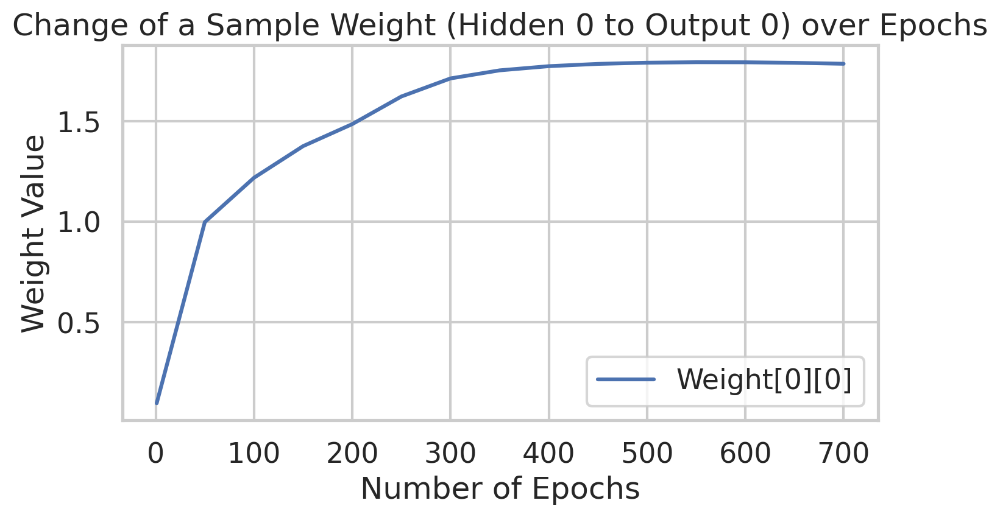

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


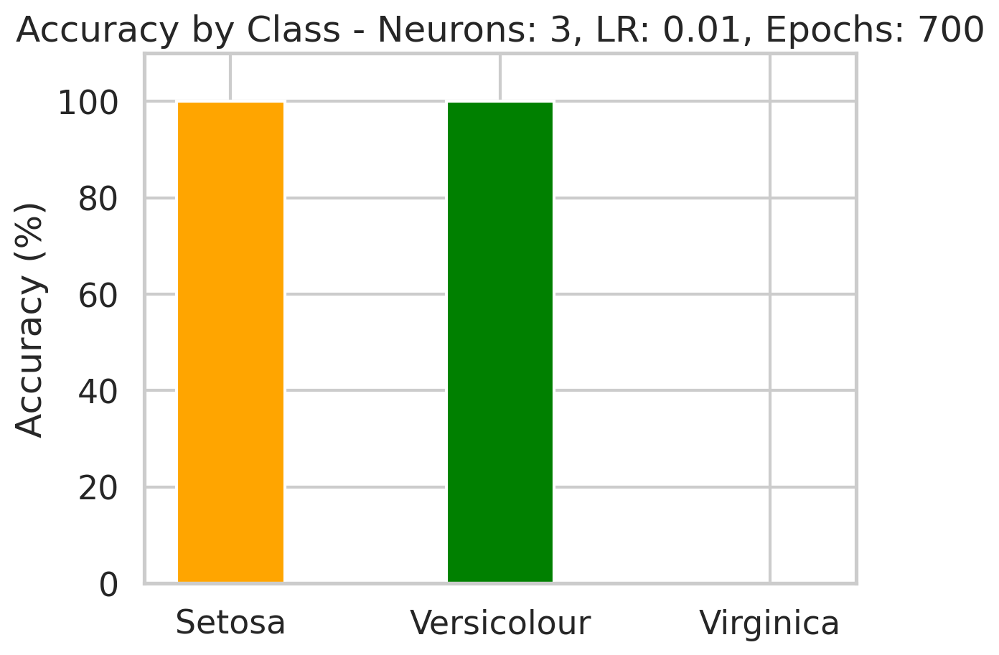

Epoch  1 - Total Error:  0.19594004544643118
Epoch  50 - Total Error:  0.10904455011110634
Epoch  100 - Total Error:  0.06105314176381673
Epoch  150 - Total Error:  0.043626704740939326
Epoch  200 - Total Error:  0.036695302337478516
Epoch  250 - Total Error:  0.03326528503184355
Epoch  300 - Total Error:  0.0312850533795796
Epoch  350 - Total Error:  0.030014697516679248
Epoch  400 - Total Error:  0.02913567278914734
Epoch  450 - Total Error:  0.028491723177846408
Epoch  500 - Total Error:  0.02799840279141561
Epoch  550 - Total Error:  0.027606589626360565
Epoch  600 - Total Error:  0.027286037078868286
Epoch  650 - Total Error:  0.027017276124566236
Epoch  700 - Total Error:  0.02678733308567933
Epoch  750 - Total Error:  0.026587324967871848
Epoch  800 - Total Error:  0.026411036623713437
Epoch  850 - Total Error:  0.02625403853503572
Epoch  900 - Total Error:  0.02611311662207592
Epoch  950 - Total Error:  0.02598589089934806
Epoch  1000 - Total Error:  0.025870554391119644


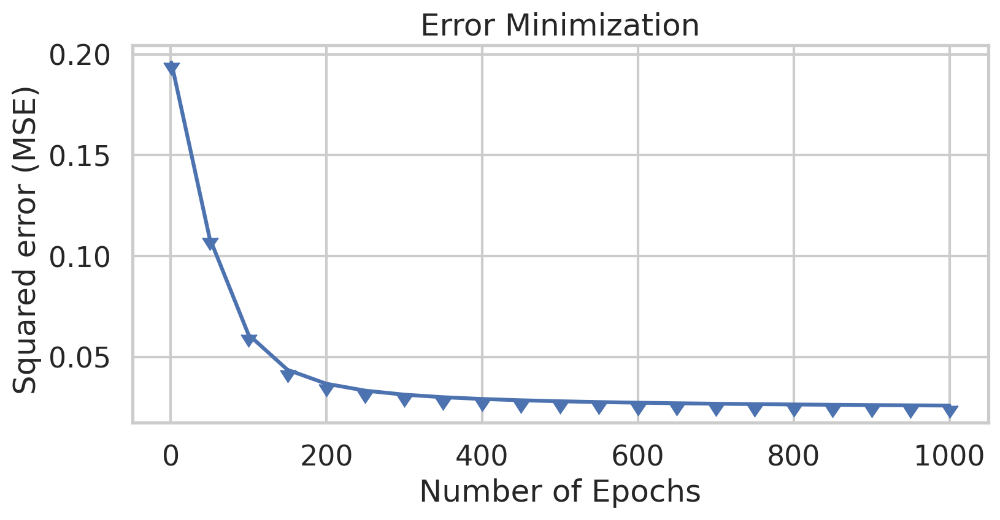

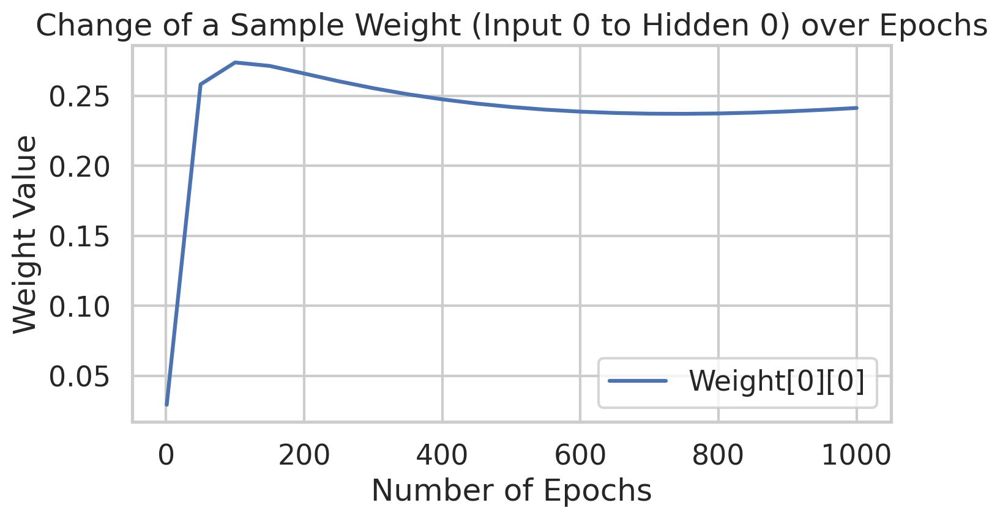

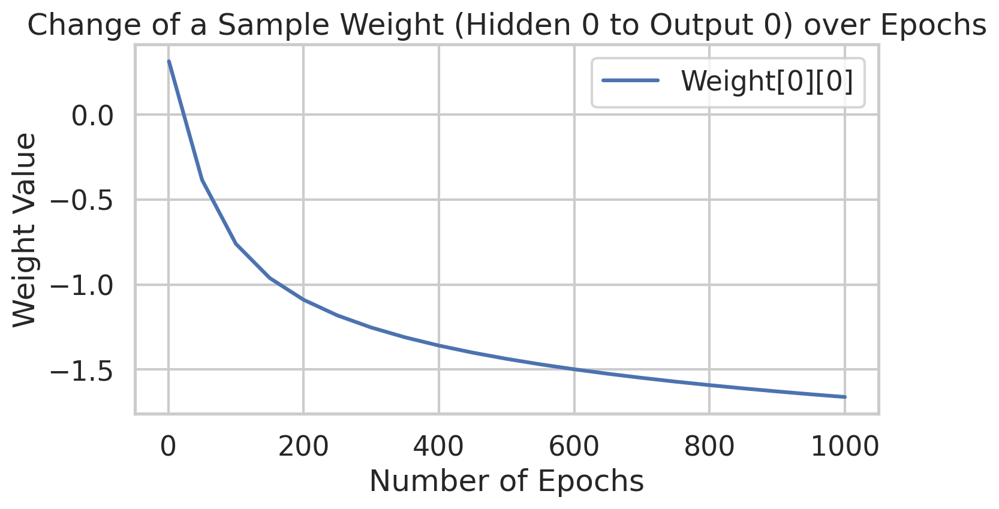

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


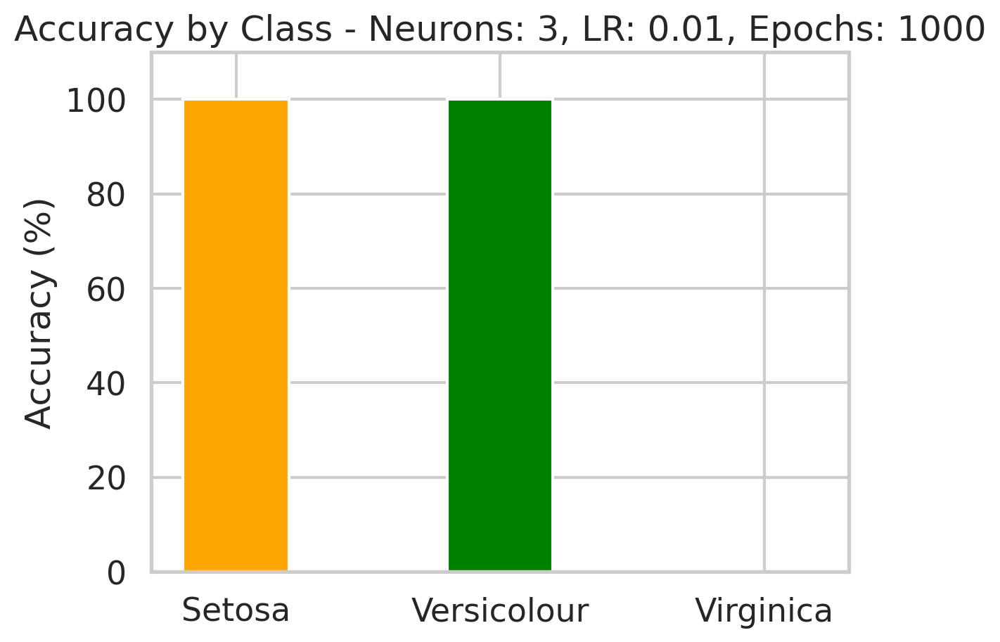

Epoch  1 - Total Error:  0.2198606842372948
Epoch  50 - Total Error:  0.11361506847036837
Epoch  100 - Total Error:  0.09055716708668556
Epoch  150 - Total Error:  0.0855235179224422
Epoch  200 - Total Error:  0.08349809589270786
Epoch  250 - Total Error:  0.08242688384133287
Epoch  300 - Total Error:  0.08176906731316182
Epoch  350 - Total Error:  0.08132527284455845
Epoch  400 - Total Error:  0.08100571325721792
Epoch  450 - Total Error:  0.08076413553289746
Epoch  500 - Total Error:  0.0805742027705667
Epoch  550 - Total Error:  0.0804195558343332
Epoch  600 - Total Error:  0.0802889362267955
Epoch  650 - Total Error:  0.0801730119501727
Epoch  700 - Total Error:  0.08006003723945437
Epoch  750 - Total Error:  0.07991764349404874
Epoch  800 - Total Error:  0.07934391581543526
Epoch  850 - Total Error:  0.04214381762698182
Epoch  900 - Total Error:  0.03278911094742181
Epoch  950 - Total Error:  0.030071215349915425
Epoch  1000 - Total Error:  0.028389446025275027
Epoch  1050 - Total

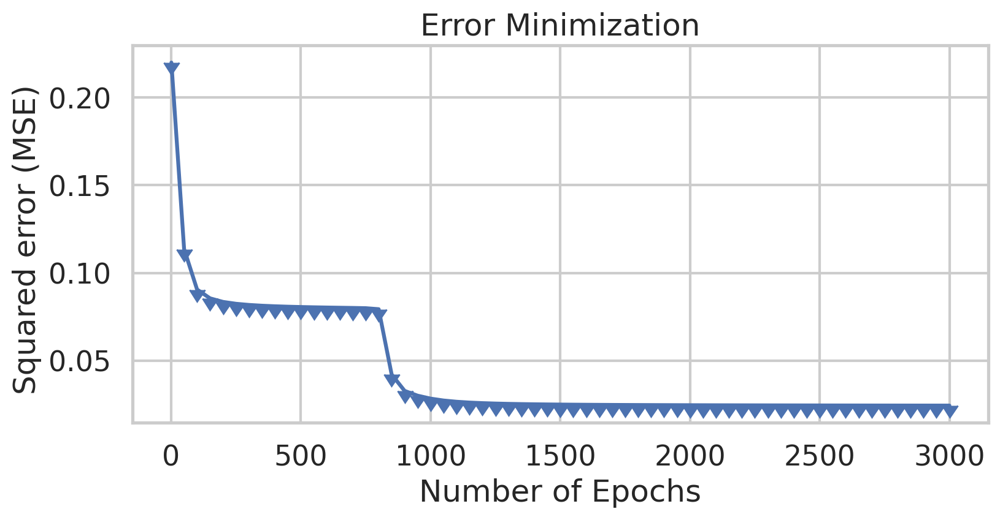

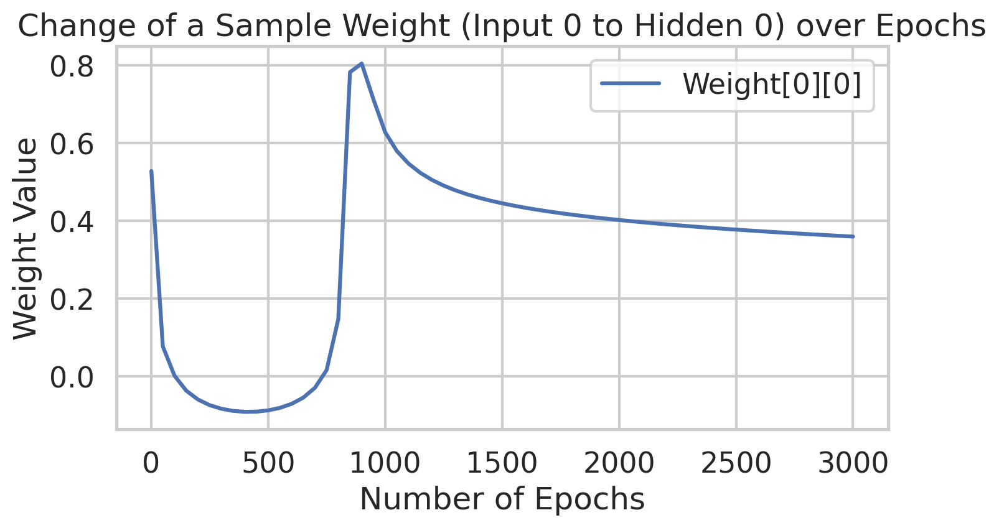

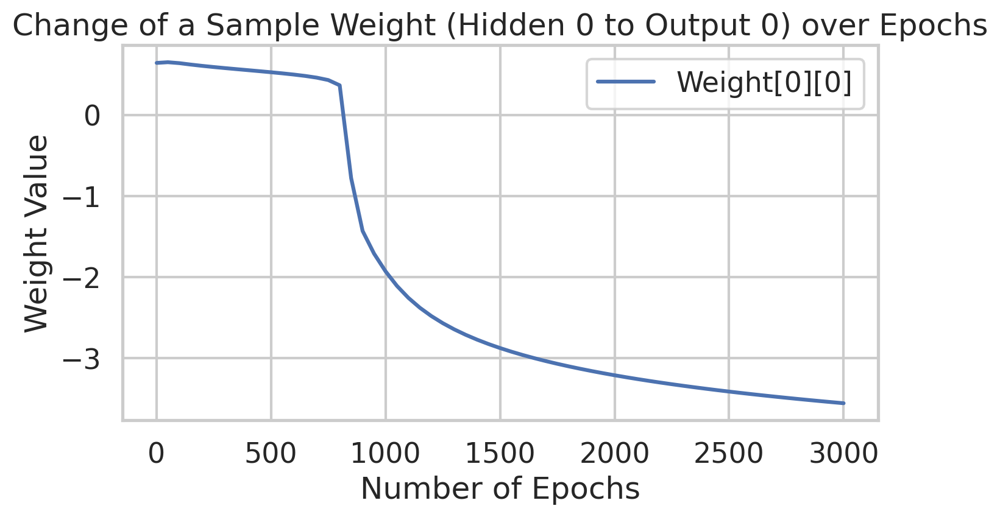

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


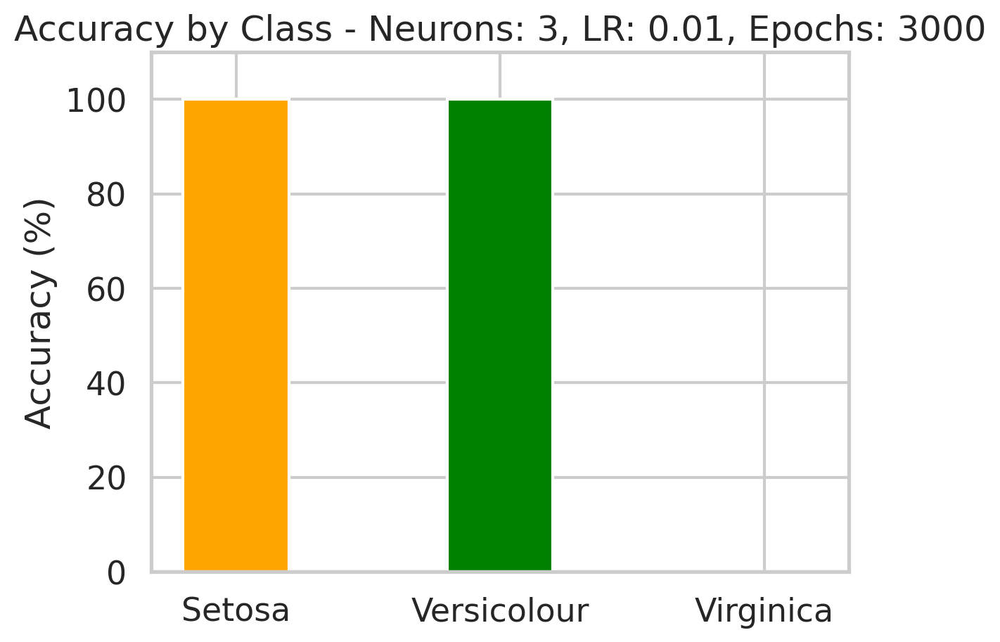

Epoch  1 - Total Error:  0.23293287110940447
Epoch  50 - Total Error:  0.08765210384718909
Epoch  100 - Total Error:  0.04159555591830864
Epoch  150 - Total Error:  0.03274992525410126
Epoch  200 - Total Error:  0.029699843902172597
Epoch  250 - Total Error:  0.02820990781694277
Epoch  300 - Total Error:  0.02732965123664992
Epoch  350 - Total Error:  0.02674707087905902
Epoch  400 - Total Error:  0.02633328065478581
Epoch  450 - Total Error:  0.02602567719465523
Epoch  500 - Total Error:  0.025789664276529806
Epoch  550 - Total Error:  0.02560408856203125
Epoch  600 - Total Error:  0.025455090899788292
Epoch  650 - Total Error:  0.025333212385778025
Epoch  700 - Total Error:  0.0252318409407624
Epoch  750 - Total Error:  0.02514627294668876
Epoch  800 - Total Error:  0.025073105920299894
Epoch  850 - Total Error:  0.025009834900180026
Epoch  900 - Total Error:  0.024954582133009346
Epoch  950 - Total Error:  0.024905915069019523
Epoch  1000 - Total Error:  0.024862722692879865
Epoch  

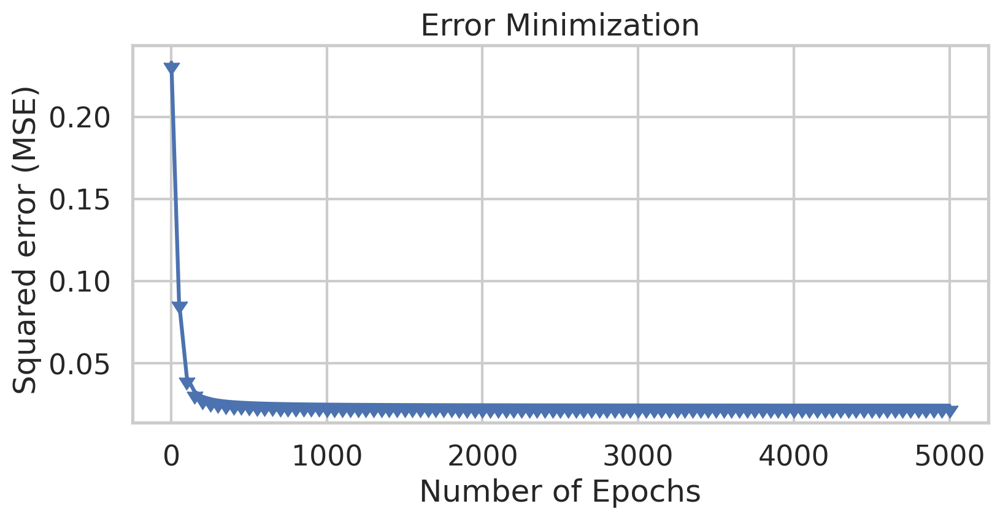

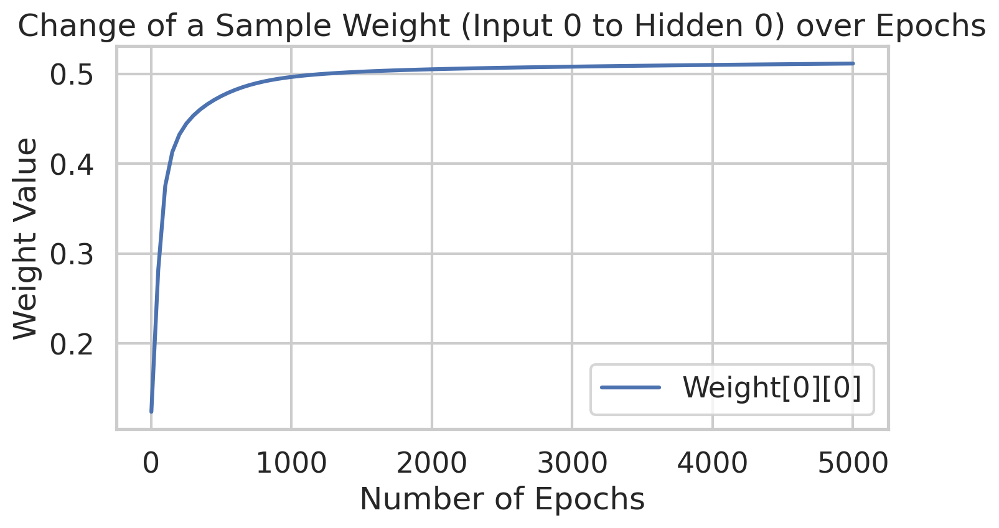

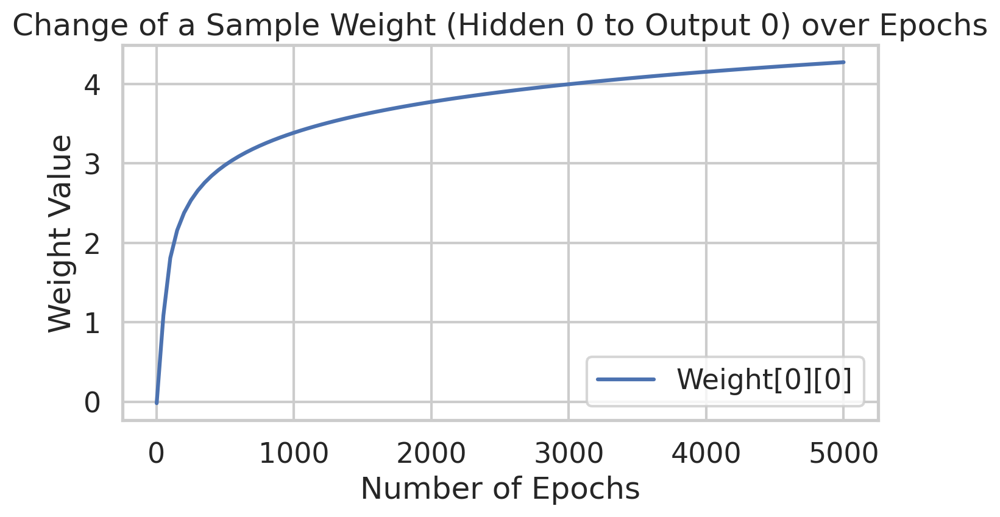

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


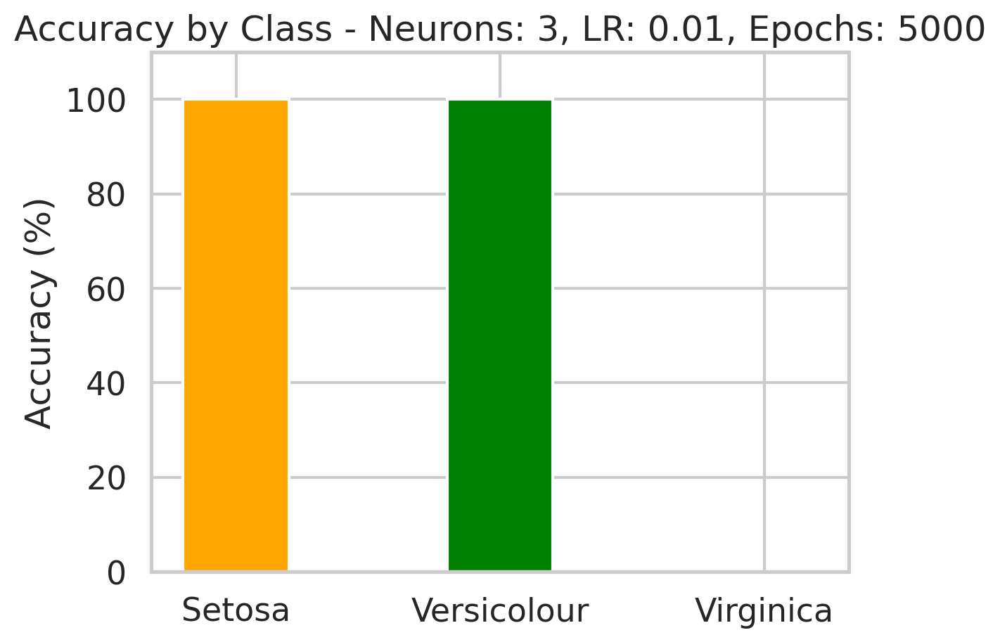

Epoch  1 - Total Error:  0.17132415885525284
Epoch  50 - Total Error:  0.02609285649863383
Epoch  100 - Total Error:  0.025004276741642618
Epoch  150 - Total Error:  0.02470056371585796
Epoch  200 - Total Error:  0.024558260606933842
Epoch  250 - Total Error:  0.024475512059836294
Epoch  300 - Total Error:  0.02442129442642855
Epoch  350 - Total Error:  0.02438296670644108
Epoch  400 - Total Error:  0.02435440606059804
Epoch  450 - Total Error:  0.024332283265097742
Epoch  500 - Total Error:  0.024314631058951215
Epoch  550 - Total Error:  0.024300211516315486
Epoch  600 - Total Error:  0.02428820629512806
Epoch  650 - Total Error:  0.02427805250752295
Epoch  700 - Total Error:  0.024269350108171113


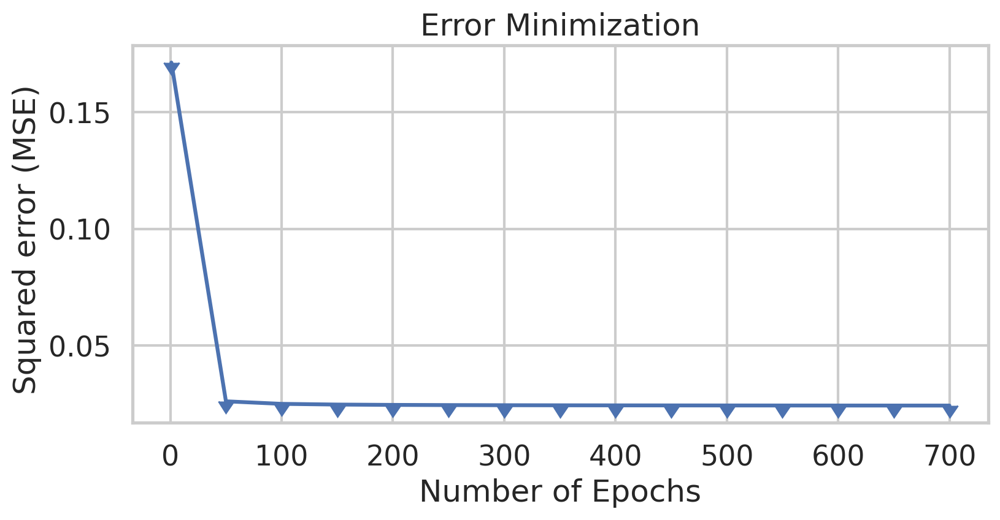

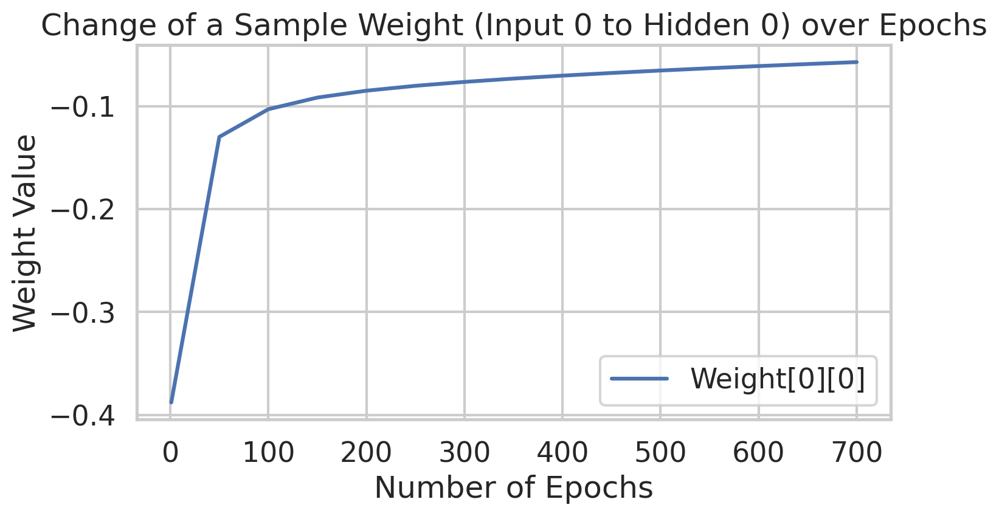

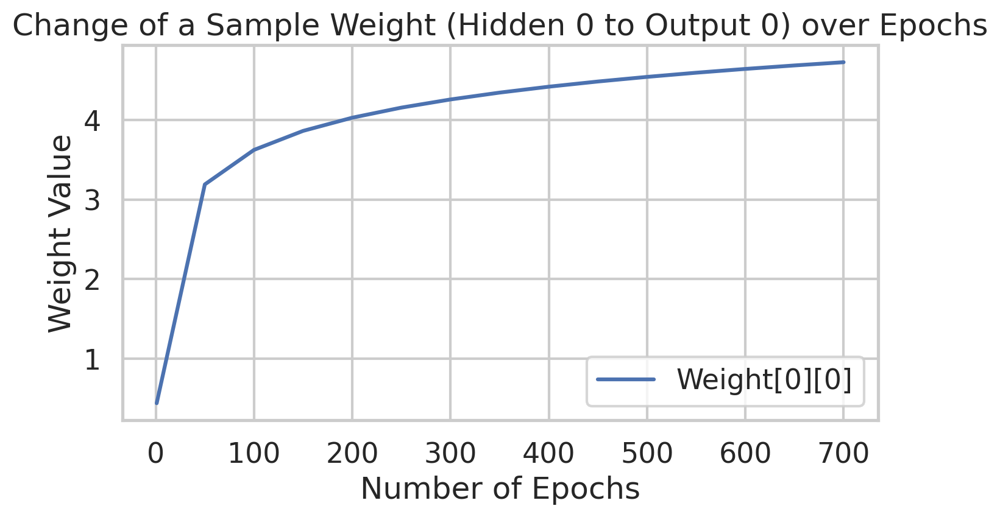

Overall accuracy: 93.33%
 - Accuracy Setosa: 95.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


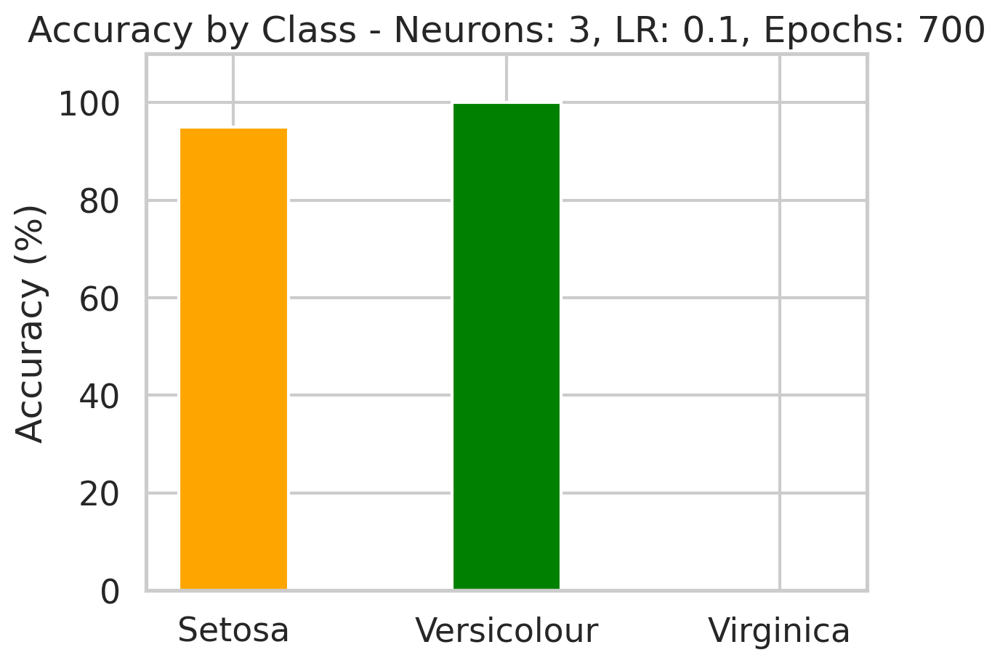

Epoch  1 - Total Error:  0.22889155313547013
Epoch  50 - Total Error:  0.028400444710604485
Epoch  100 - Total Error:  0.026040355162673126
Epoch  150 - Total Error:  0.02533303279853889
Epoch  200 - Total Error:  0.025007070582255198
Epoch  250 - Total Error:  0.024821307625836488
Epoch  300 - Total Error:  0.024701291830099167
Epoch  350 - Total Error:  0.024616813541582693
Epoch  400 - Total Error:  0.02455315027379166
Epoch  450 - Total Error:  0.024501814356390664
Epoch  500 - Total Error:  0.024456468956204416
Epoch  550 - Total Error:  0.024409274825595524
Epoch  600 - Total Error:  0.024341244910704943
Epoch  650 - Total Error:  0.024181147391862525
Epoch  700 - Total Error:  0.023695586943576007
Epoch  750 - Total Error:  0.02192823024756848
Epoch  800 - Total Error:  0.016228635885016704
Epoch  850 - Total Error:  0.00932160477688353
Epoch  900 - Total Error:  0.005930319199635192
Epoch  950 - Total Error:  0.004140104115551728
Epoch  1000 - Total Error:  0.003018485757142786

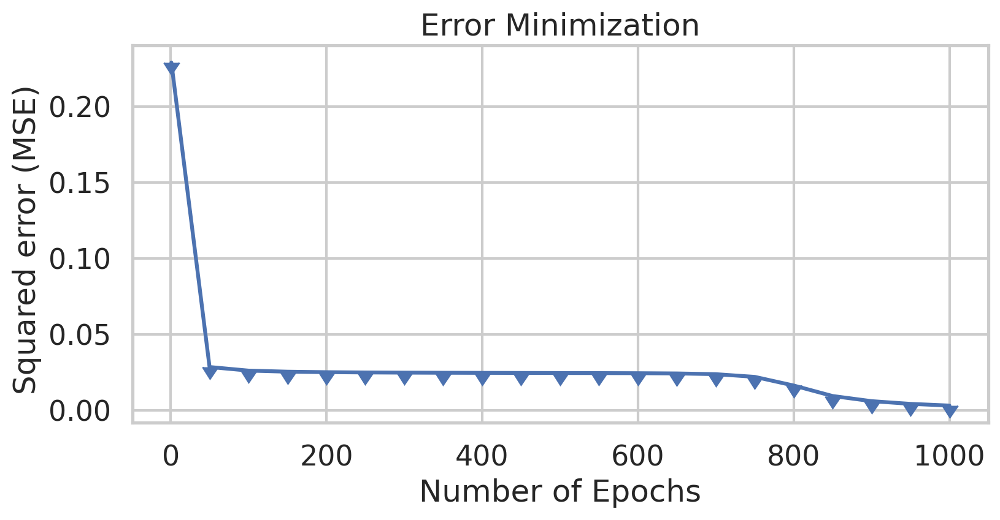

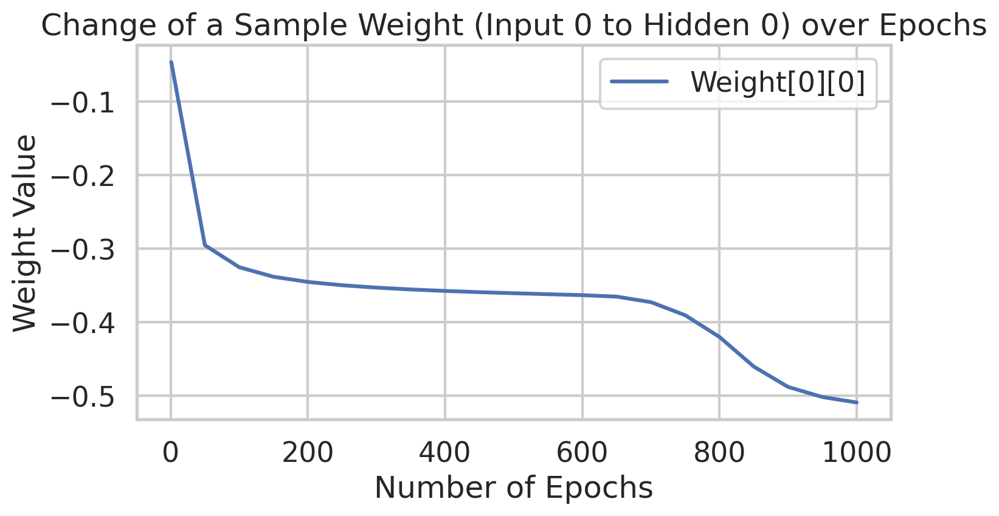

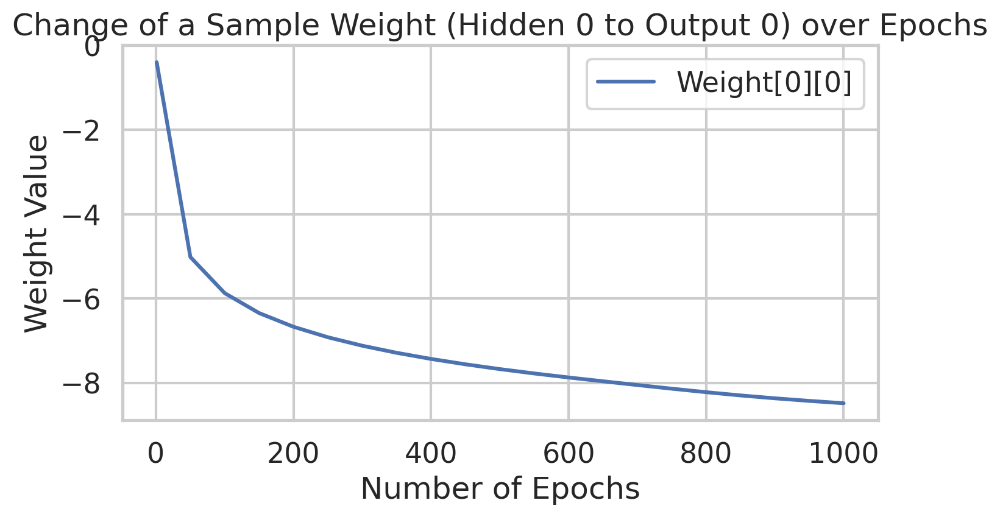

Overall accuracy: 70.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 100.00%


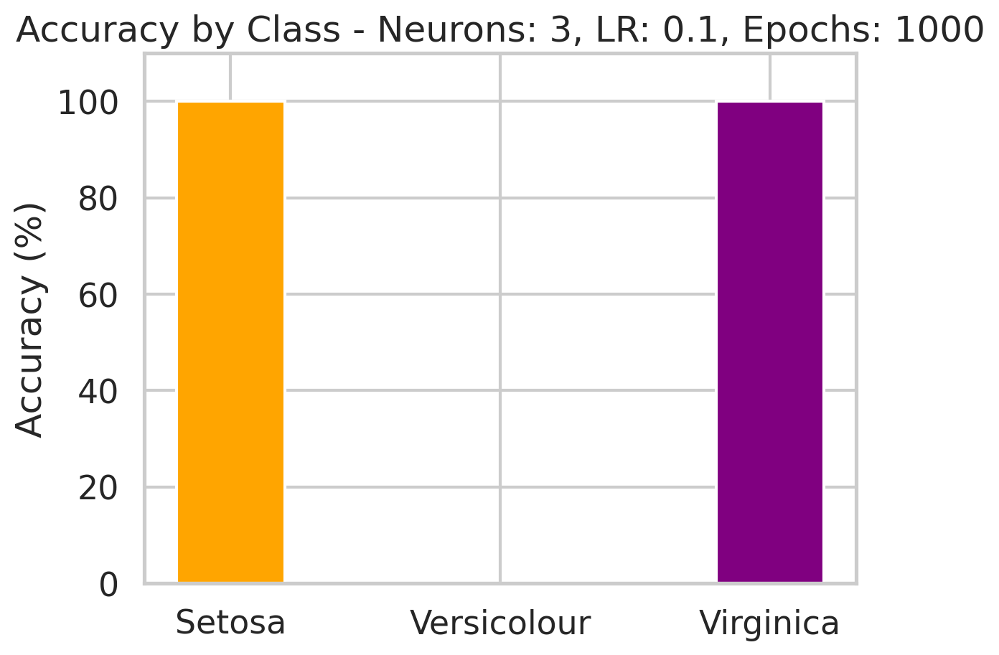

Epoch  1 - Total Error:  0.2137271977268903
Epoch  50 - Total Error:  0.026164361704781716
Epoch  100 - Total Error:  0.025010836881366287
Epoch  150 - Total Error:  0.024704430507948
Epoch  200 - Total Error:  0.024560342723676496
Epoch  250 - Total Error:  0.024476348634276272
Epoch  300 - Total Error:  0.024421272808274018
Epoch  350 - Total Error:  0.024382345689657543
Epoch  400 - Total Error:  0.024353358926950133
Epoch  450 - Total Error:  0.02433092843882102
Epoch  500 - Total Error:  0.024313051359757542
Epoch  550 - Total Error:  0.0242984661261083
Epoch  600 - Total Error:  0.024286338321314126
Epoch  650 - Total Error:  0.024276093875975274
Epoch  700 - Total Error:  0.02426732480527948
Epoch  750 - Total Error:  0.02425973315579311
Epoch  800 - Total Error:  0.02425309622918787
Epoch  850 - Total Error:  0.02424724421773476
Epoch  900 - Total Error:  0.024242045371791105
Epoch  950 - Total Error:  0.024237395896093417
Epoch  1000 - Total Error:  0.024233212904103518
Epoch 

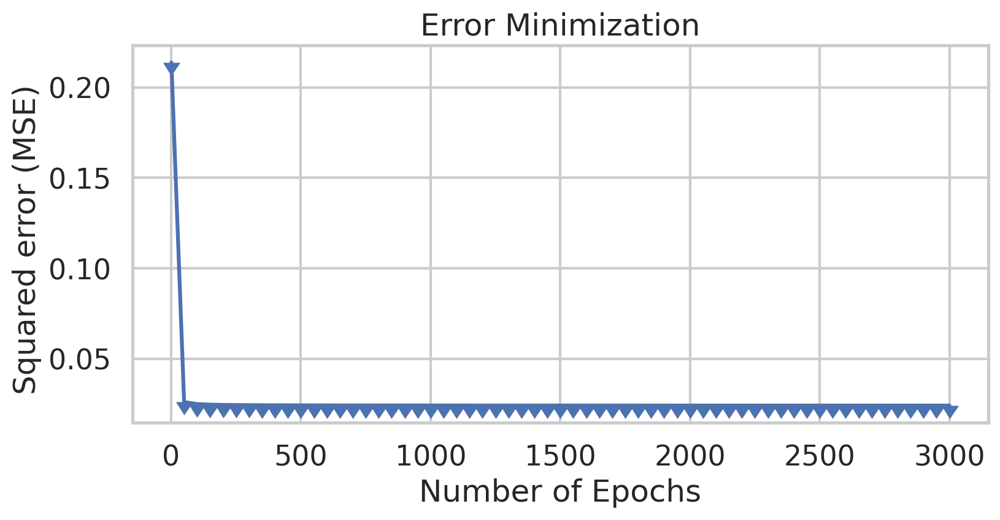

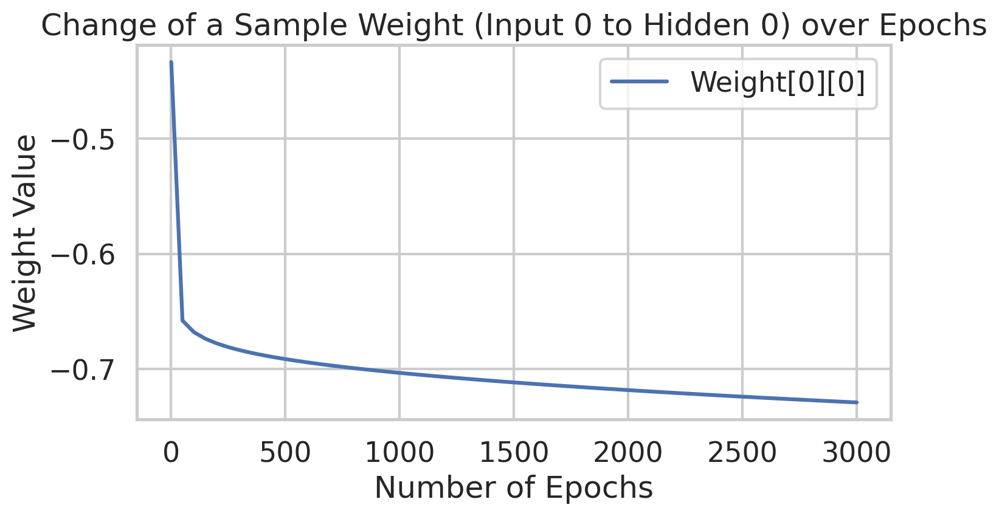

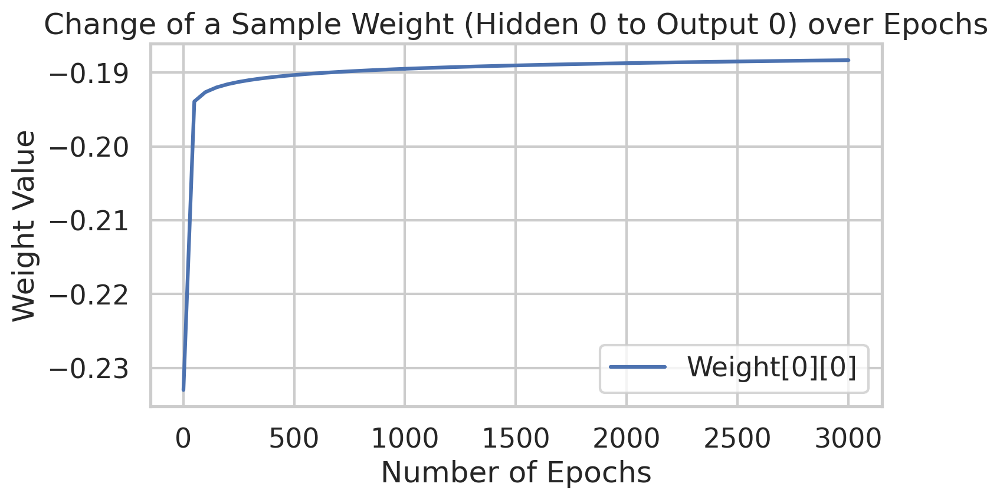

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


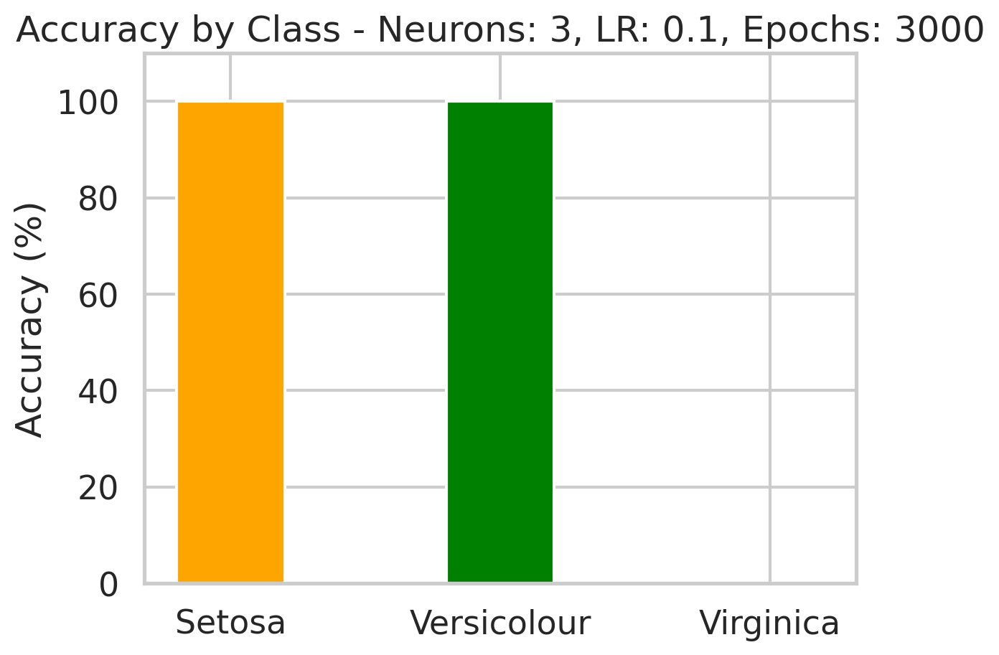

Epoch  1 - Total Error:  0.19858782782791806
Epoch  50 - Total Error:  0.027533739619642696
Epoch  100 - Total Error:  0.025530319301716446
Epoch  150 - Total Error:  0.02500726221347375
Epoch  200 - Total Error:  0.024771857166489473
Epoch  250 - Total Error:  0.024638518087750805
Epoch  300 - Total Error:  0.024552722961374136
Epoch  350 - Total Error:  0.024492869505640315
Epoch  400 - Total Error:  0.02444871762736635
Epoch  450 - Total Error:  0.024414792049422002
Epoch  500 - Total Error:  0.024387900155812586
Epoch  550 - Total Error:  0.02436605446960615
Epoch  600 - Total Error:  0.02434795278046659
Epoch  650 - Total Error:  0.02433270604468658
Epoch  700 - Total Error:  0.024319686436018506
Epoch  750 - Total Error:  0.024308437888531743
Epoch  800 - Total Error:  0.0242986210646101
Epoch  850 - Total Error:  0.02428997821969394
Epoch  900 - Total Error:  0.024282310045163288
Epoch  950 - Total Error:  0.02427545997942224
Epoch  1000 - Total Error:  0.024269303319321093
Epoc

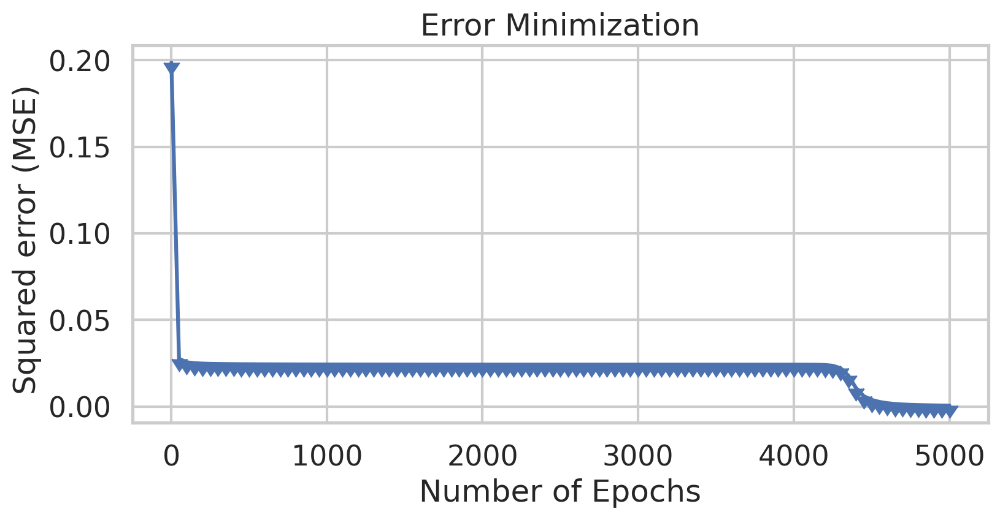

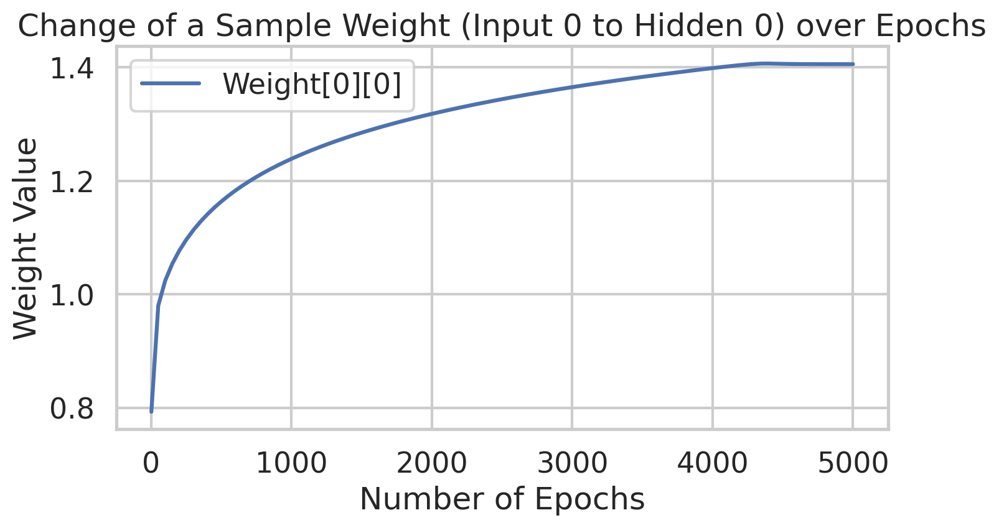

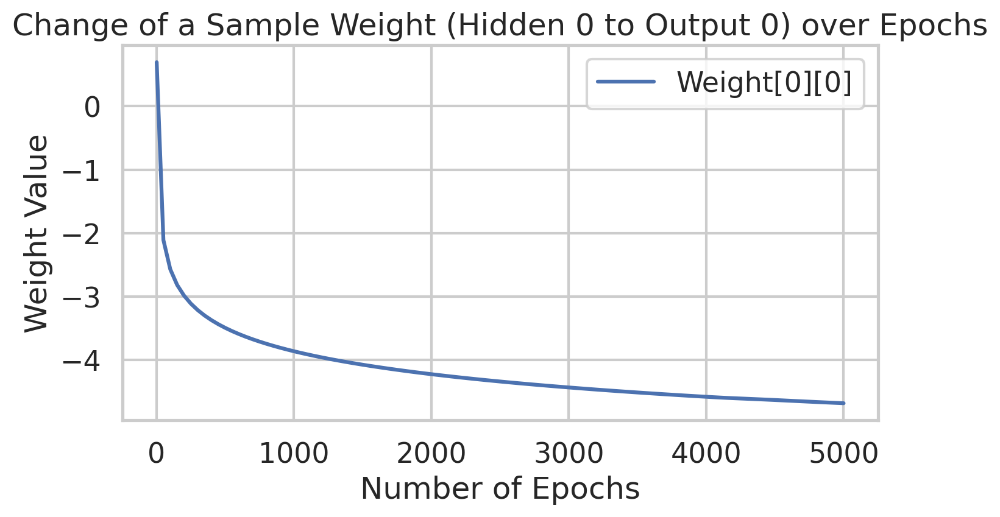

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 88.89%
 - Accuracy Virginica: 100.00%


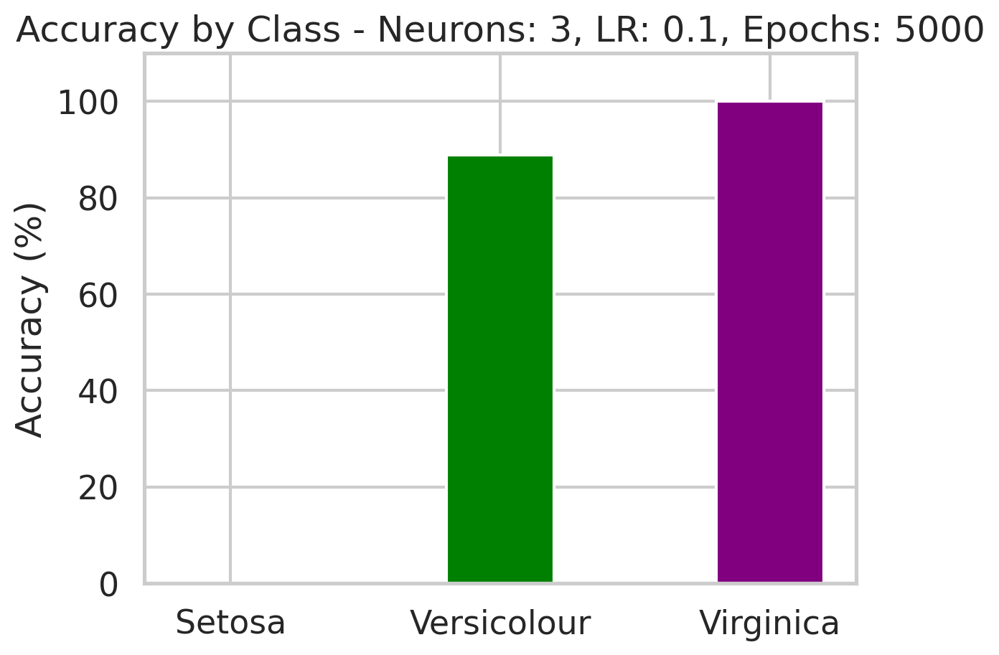

Epoch  1 - Total Error:  0.21425698088804
Epoch  50 - Total Error:  0.17939915781064297
Epoch  100 - Total Error:  0.16562629511705293
Epoch  150 - Total Error:  0.15970440629489618
Epoch  200 - Total Error:  0.156739288859621
Epoch  250 - Total Error:  0.1551954976033767
Epoch  300 - Total Error:  0.1543648825764663
Epoch  350 - Total Error:  0.1538818604942302
Epoch  400 - Total Error:  0.15356941224520276
Epoch  450 - Total Error:  0.15334642836691562
Epoch  500 - Total Error:  0.15317559642423498
Epoch  550 - Total Error:  0.15303862656038583
Epoch  600 - Total Error:  0.15292558541589835
Epoch  650 - Total Error:  0.1528304526397695
Epoch  700 - Total Error:  0.15274923062978976


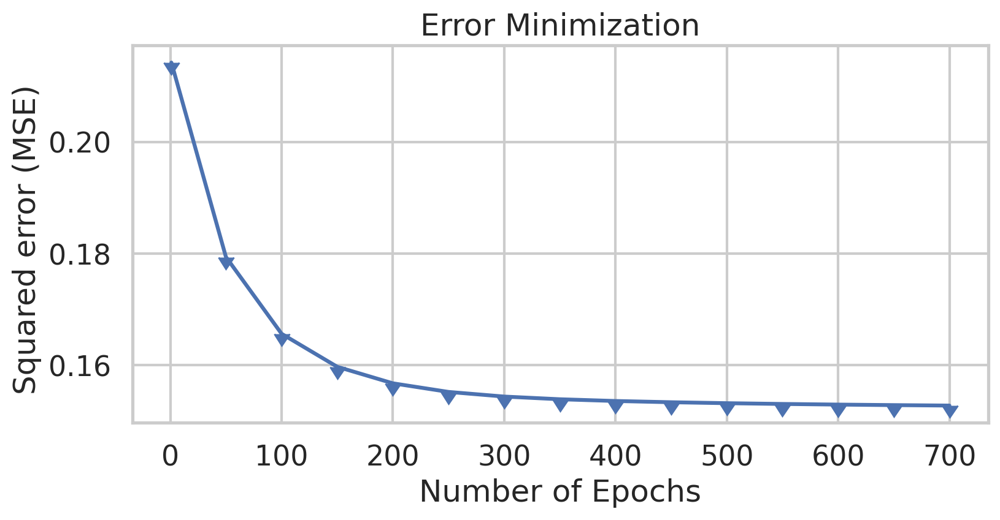

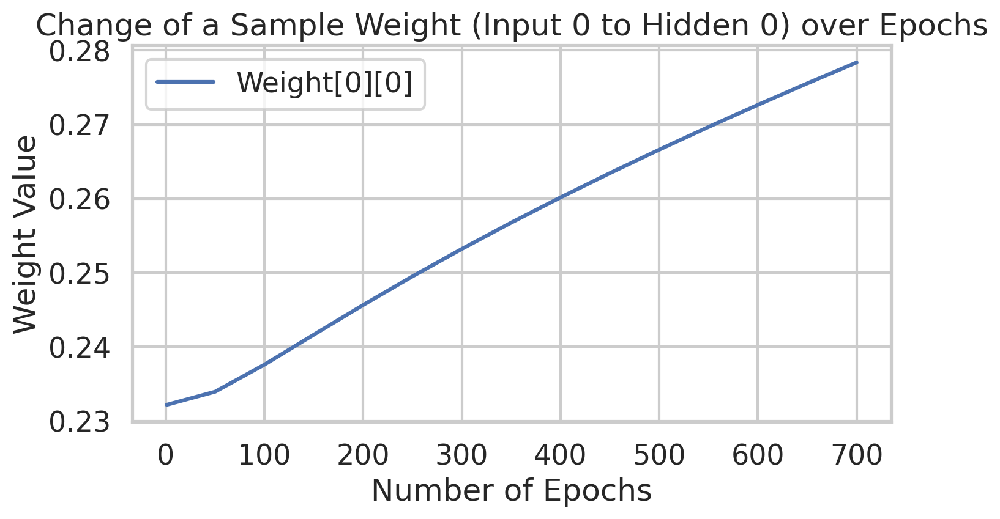

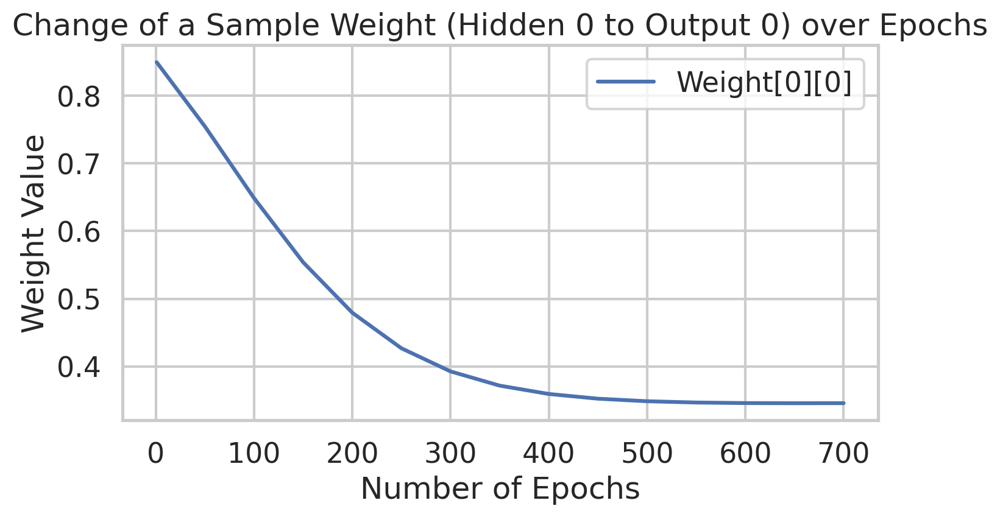

Overall accuracy: 3.33%
 - Accuracy Setosa: 5.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 0.00%


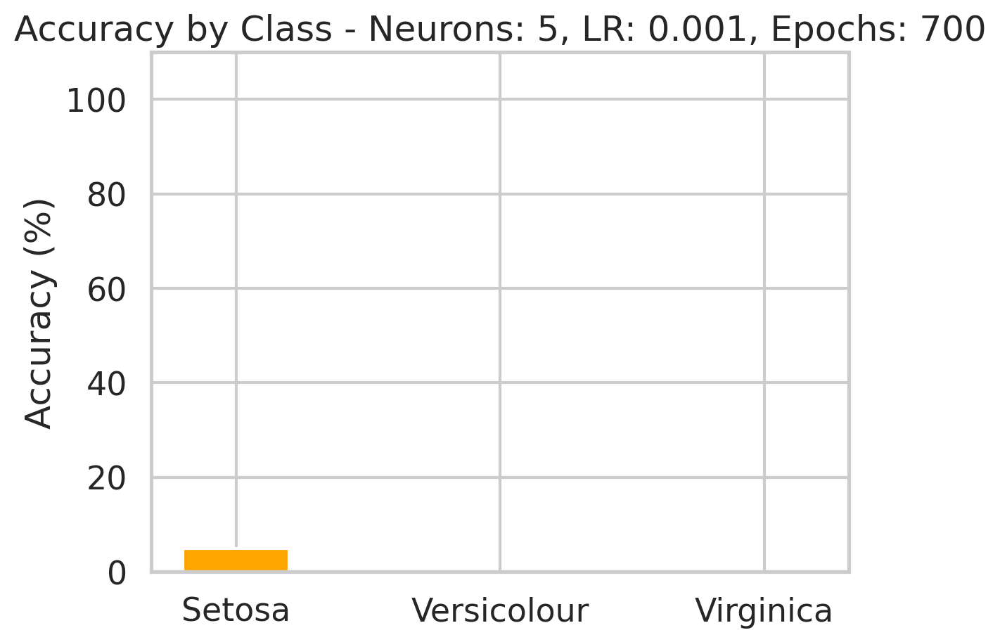

Epoch  1 - Total Error:  0.2836259005170001
Epoch  50 - Total Error:  0.2106377052043701
Epoch  100 - Total Error:  0.1822297533352265
Epoch  150 - Total Error:  0.16749987897952048
Epoch  200 - Total Error:  0.158318347652914
Epoch  250 - Total Error:  0.15025866721422892
Epoch  300 - Total Error:  0.1394873144690195
Epoch  350 - Total Error:  0.1264377118915783
Epoch  400 - Total Error:  0.11547513416934317
Epoch  450 - Total Error:  0.10421162381207472
Epoch  500 - Total Error:  0.09311583600003771
Epoch  550 - Total Error:  0.08293295203031667
Epoch  600 - Total Error:  0.07409336741319107
Epoch  650 - Total Error:  0.06669577682340848
Epoch  700 - Total Error:  0.06062762233545129
Epoch  750 - Total Error:  0.05568905786980756
Epoch  800 - Total Error:  0.05166978120533497
Epoch  850 - Total Error:  0.048383273920140114
Epoch  900 - Total Error:  0.045676403800594914
Epoch  950 - Total Error:  0.043428017187599345
Epoch  1000 - Total Error:  0.041543840266659054


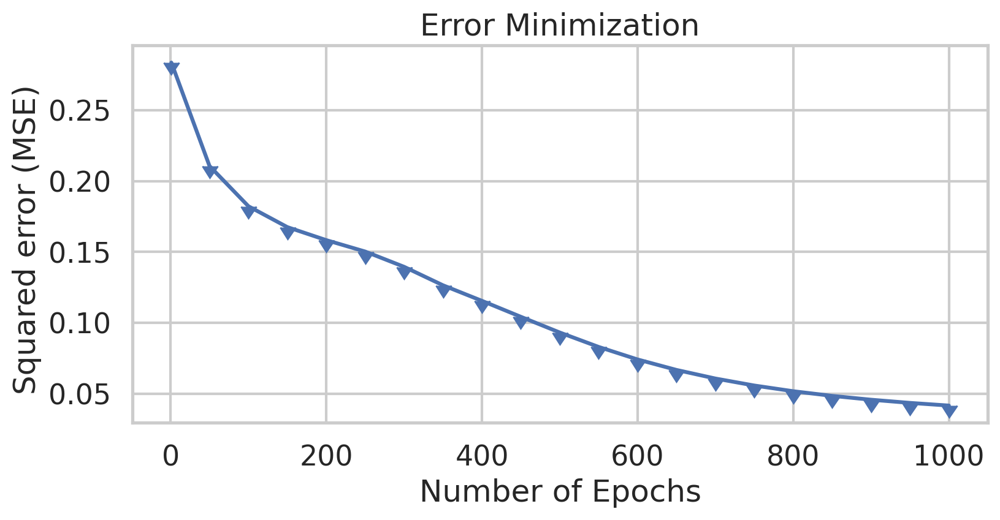

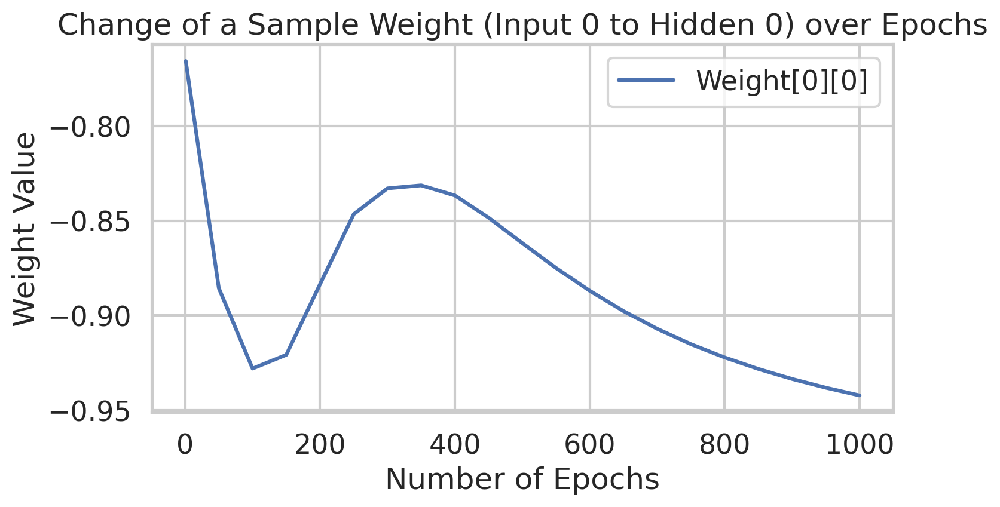

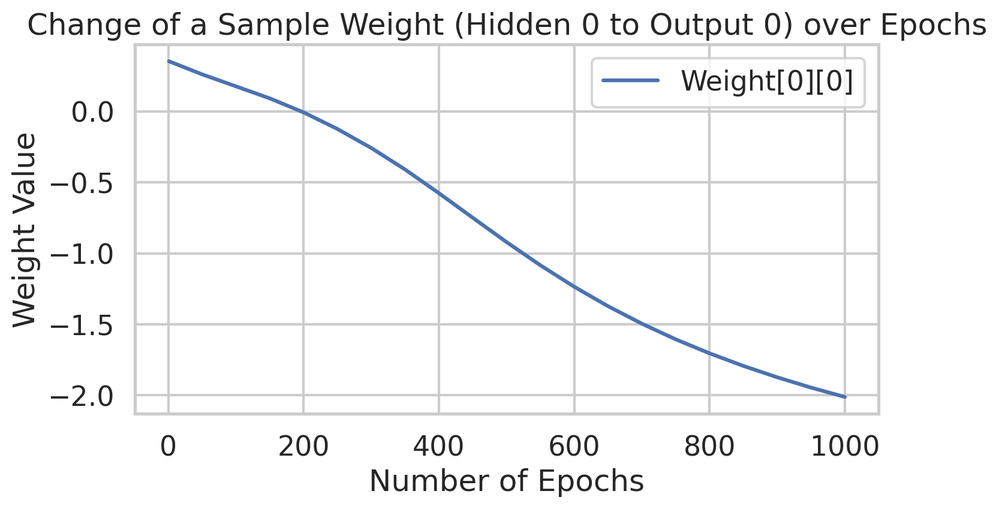

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


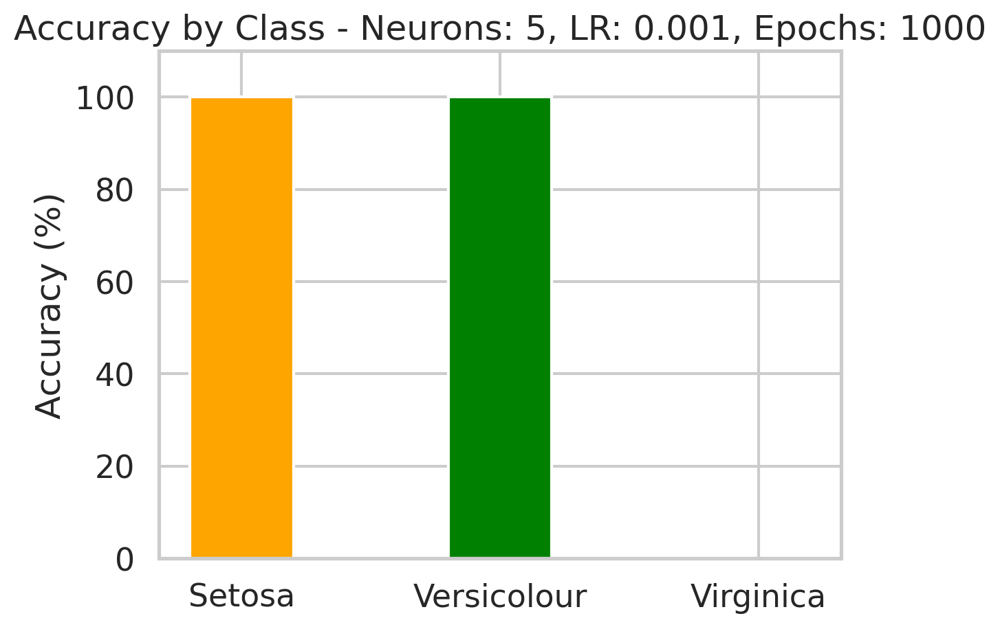

Epoch  1 - Total Error:  0.26028557162858185
Epoch  50 - Total Error:  0.1723972256428372
Epoch  100 - Total Error:  0.1580342052629189
Epoch  150 - Total Error:  0.15472121207172682
Epoch  200 - Total Error:  0.15348099281713753
Epoch  250 - Total Error:  0.15280336589187984
Epoch  300 - Total Error:  0.1522767095779348
Epoch  350 - Total Error:  0.15164123626798043
Epoch  400 - Total Error:  0.15035006051926827
Epoch  450 - Total Error:  0.1475348941603514
Epoch  500 - Total Error:  0.14401521031525855
Epoch  550 - Total Error:  0.13998845225383186
Epoch  600 - Total Error:  0.13530512537312758
Epoch  650 - Total Error:  0.12999312930610193
Epoch  700 - Total Error:  0.12415974509711658
Epoch  750 - Total Error:  0.11796251927772868
Epoch  800 - Total Error:  0.11157998634338023
Epoch  850 - Total Error:  0.10518556995451551
Epoch  900 - Total Error:  0.09893024275117353
Epoch  950 - Total Error:  0.09293382868799688
Epoch  1000 - Total Error:  0.08728245331235894
Epoch  1050 - Total

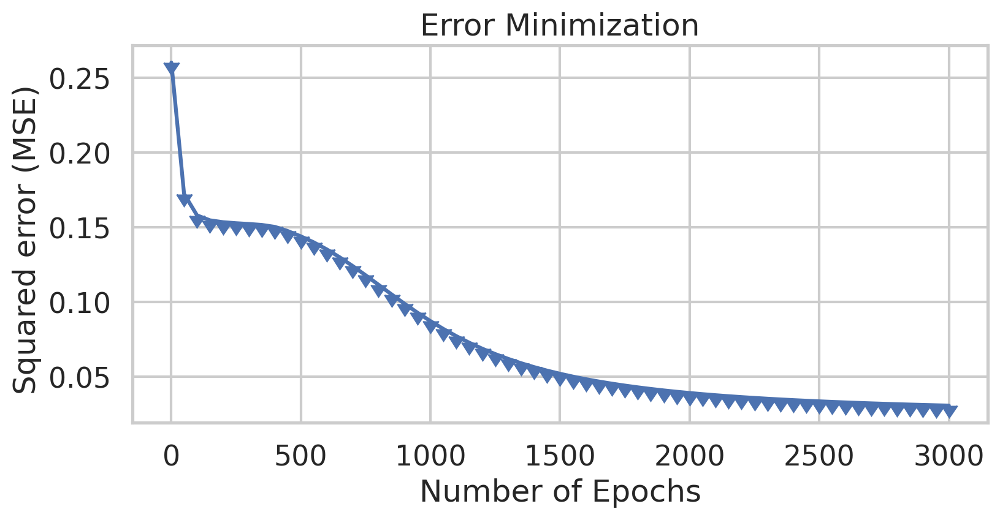

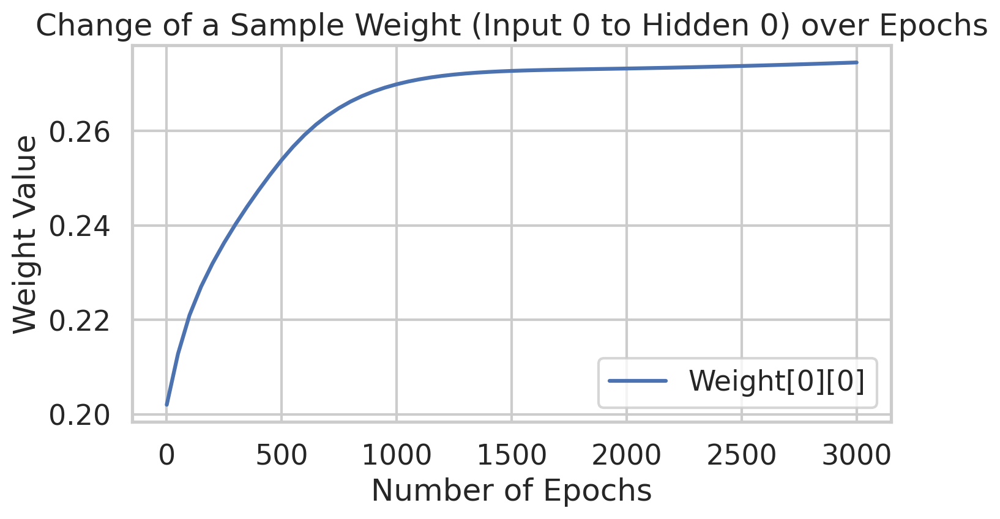

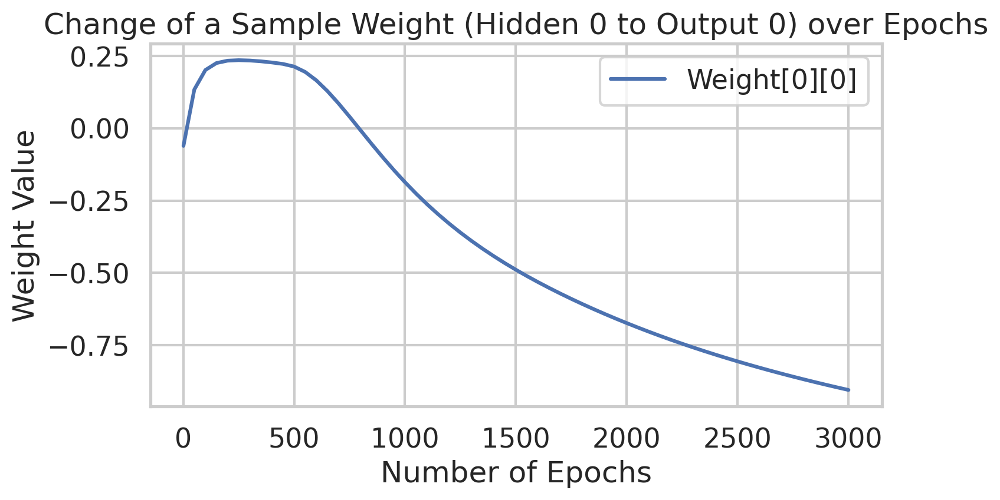

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


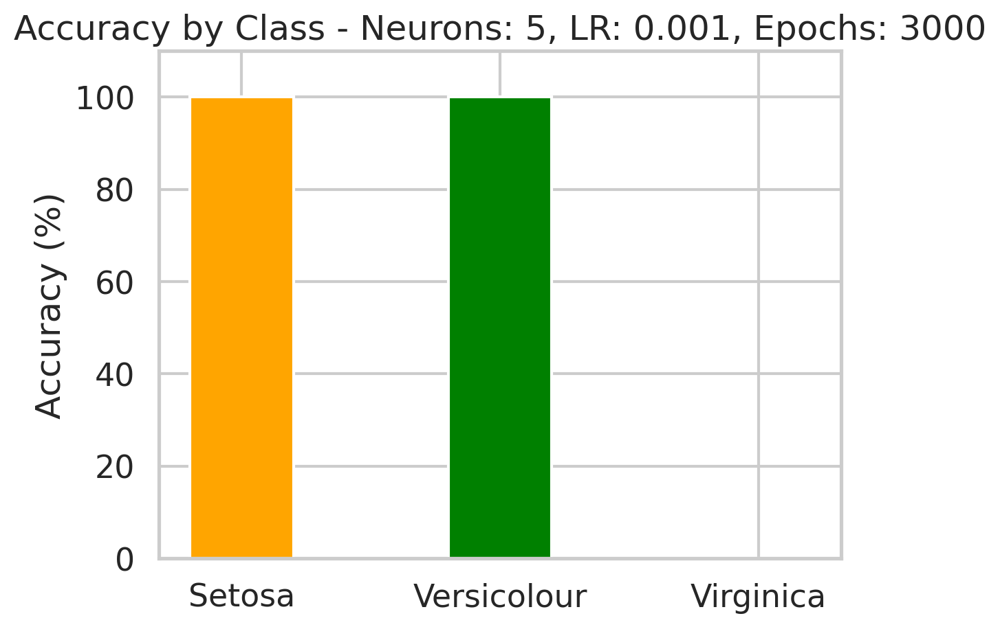

Epoch  1 - Total Error:  0.2555299758294957
Epoch  50 - Total Error:  0.16538718597112362
Epoch  100 - Total Error:  0.15570905013207412
Epoch  150 - Total Error:  0.15287645063344915
Epoch  200 - Total Error:  0.15103692327370496
Epoch  250 - Total Error:  0.14885298048227788
Epoch  300 - Total Error:  0.1456025994180404
Epoch  350 - Total Error:  0.14097198887522203
Epoch  400 - Total Error:  0.13480324806557495
Epoch  450 - Total Error:  0.12708785329100813
Epoch  500 - Total Error:  0.11800207111059062
Epoch  550 - Total Error:  0.10797806147313596
Epoch  600 - Total Error:  0.09783836472469454
Epoch  650 - Total Error:  0.08828005046732491
Epoch  700 - Total Error:  0.07966419214351443
Epoch  750 - Total Error:  0.072159989502557
Epoch  800 - Total Error:  0.06578387111782907
Epoch  850 - Total Error:  0.06044891348634272
Epoch  900 - Total Error:  0.056018645525329855
Epoch  950 - Total Error:  0.052345835937022085
Epoch  1000 - Total Error:  0.049293865800002994
Epoch  1050 - To

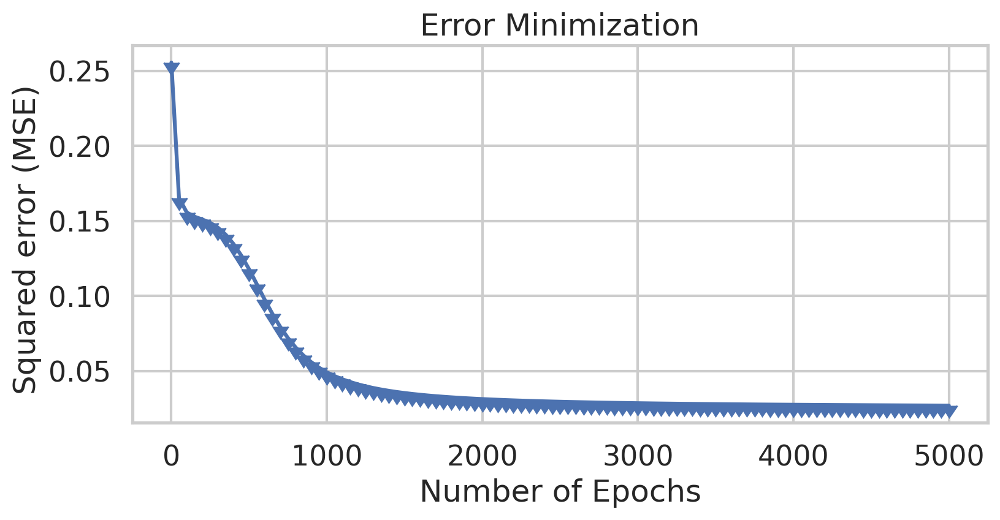

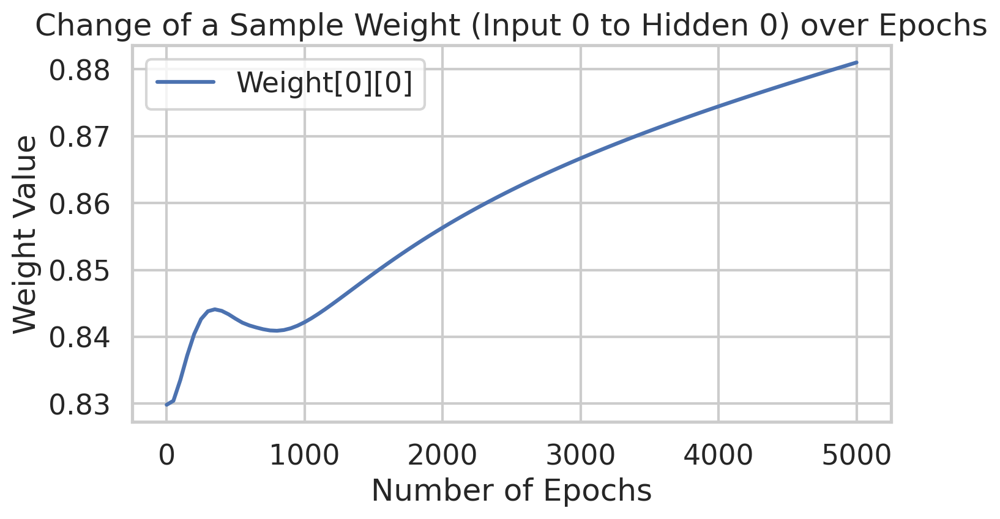

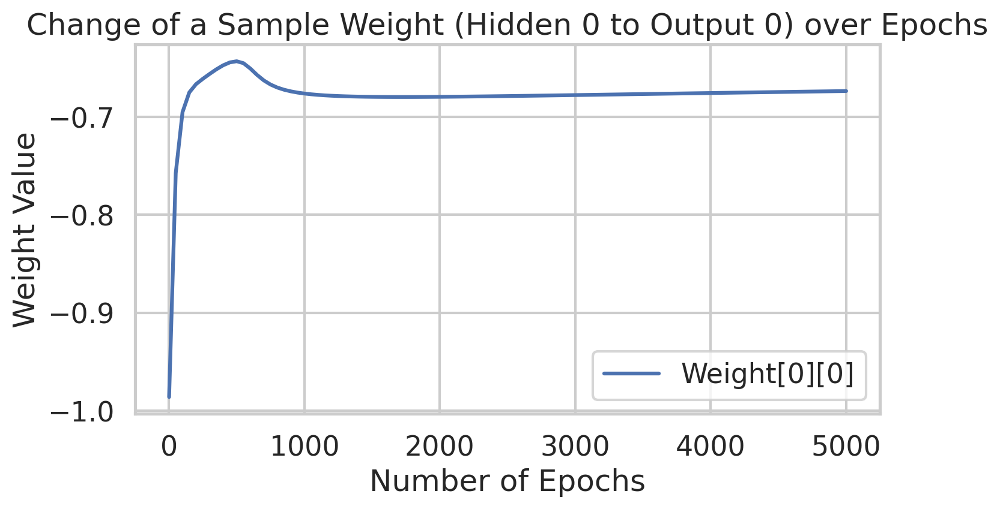

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


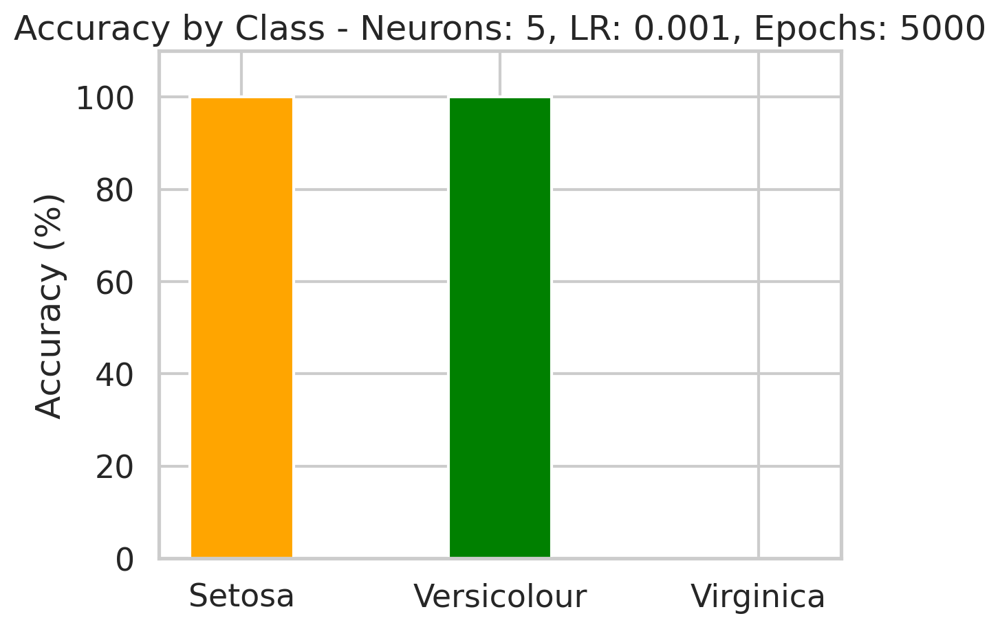

Epoch  1 - Total Error:  0.17455852392727692
Epoch  50 - Total Error:  0.11846207333564505
Epoch  100 - Total Error:  0.08204346707096215
Epoch  150 - Total Error:  0.05804199598083104
Epoch  200 - Total Error:  0.04481421852838697
Epoch  250 - Total Error:  0.037419068127272095
Epoch  300 - Total Error:  0.033577908770733945
Epoch  350 - Total Error:  0.03139272801339132
Epoch  400 - Total Error:  0.03001976372992373
Epoch  450 - Total Error:  0.029090739753027582
Epoch  500 - Total Error:  0.028424411416689874
Epoch  550 - Total Error:  0.027923490020296236
Epoch  600 - Total Error:  0.027532004008130807
Epoch  650 - Total Error:  0.02721590187667311
Epoch  700 - Total Error:  0.02695351200856285


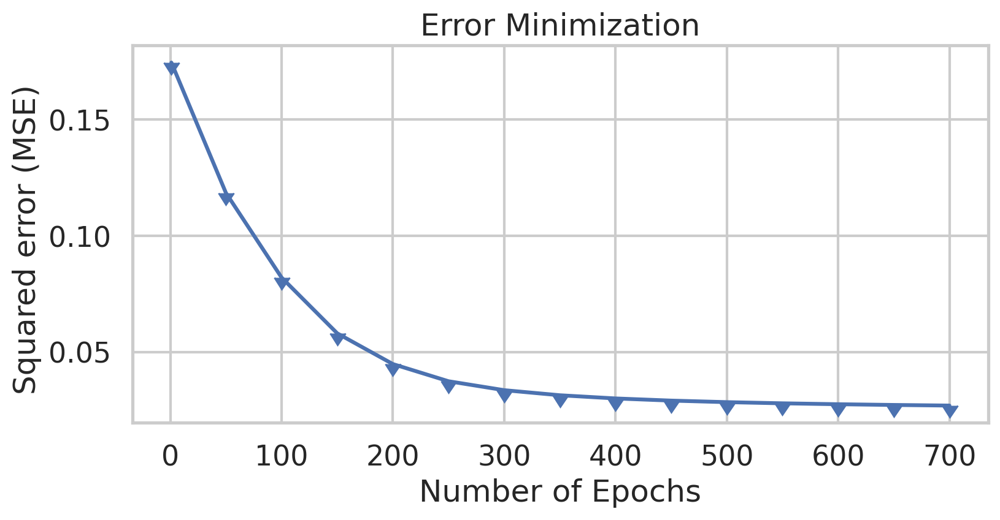

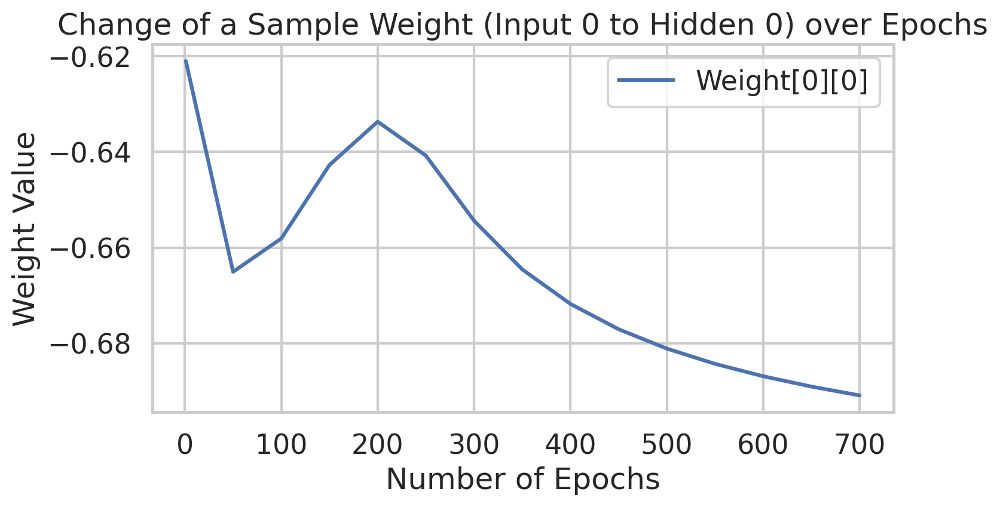

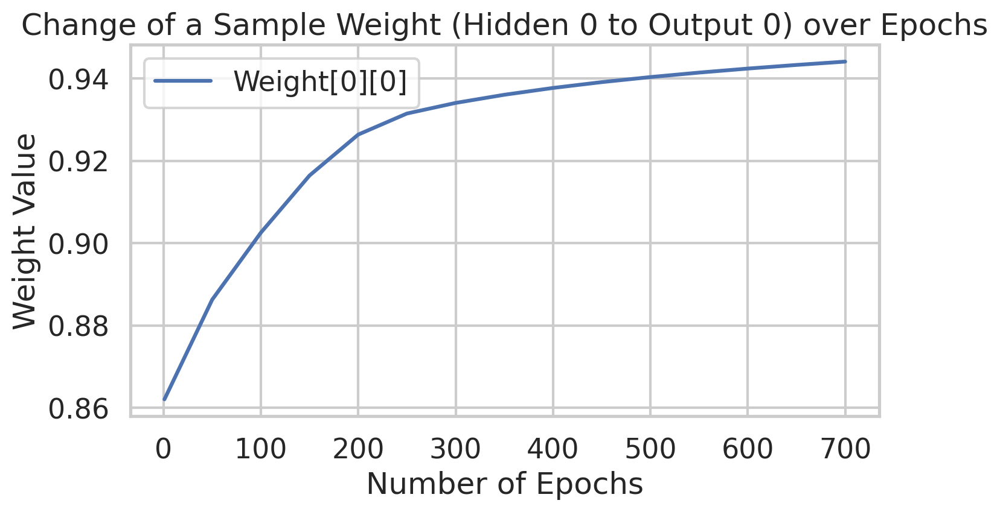

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


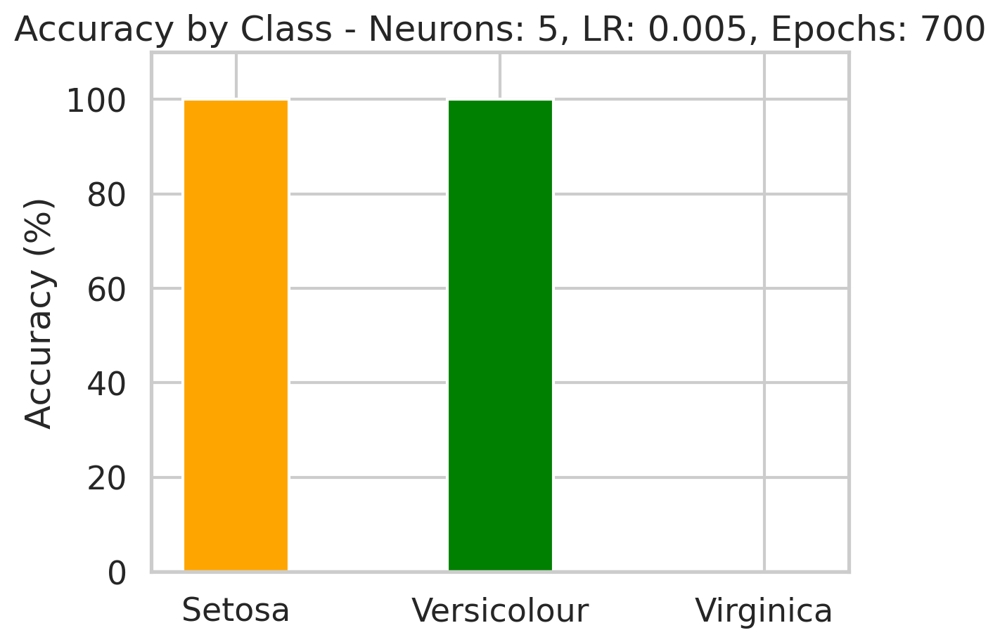

Epoch  1 - Total Error:  0.25476182607134323
Epoch  50 - Total Error:  0.11650868255502558
Epoch  100 - Total Error:  0.07832470723001322
Epoch  150 - Total Error:  0.05647960865844896
Epoch  200 - Total Error:  0.04519245512618015
Epoch  250 - Total Error:  0.039045154238737174
Epoch  300 - Total Error:  0.0353911575523992
Epoch  350 - Total Error:  0.03304359591240818
Epoch  400 - Total Error:  0.031438265010996405
Epoch  450 - Total Error:  0.030284873835116667
Epoch  500 - Total Error:  0.02942281605302651
Epoch  550 - Total Error:  0.02875760125162236
Epoch  600 - Total Error:  0.028230731605464496
Epoch  650 - Total Error:  0.027804430395054716
Epoch  700 - Total Error:  0.027453412828753535
Epoch  750 - Total Error:  0.0271601979146393
Epoch  800 - Total Error:  0.0269123065421739
Epoch  850 - Total Error:  0.02670053567234342
Epoch  900 - Total Error:  0.026517892931613277
Epoch  950 - Total Error:  0.02635894858751177
Epoch  1000 - Total Error:  0.026219437293761142


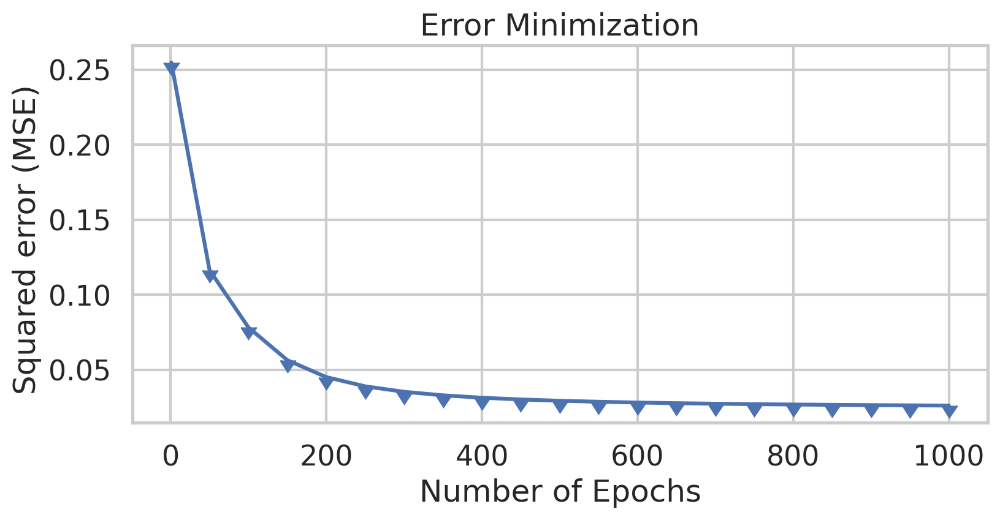

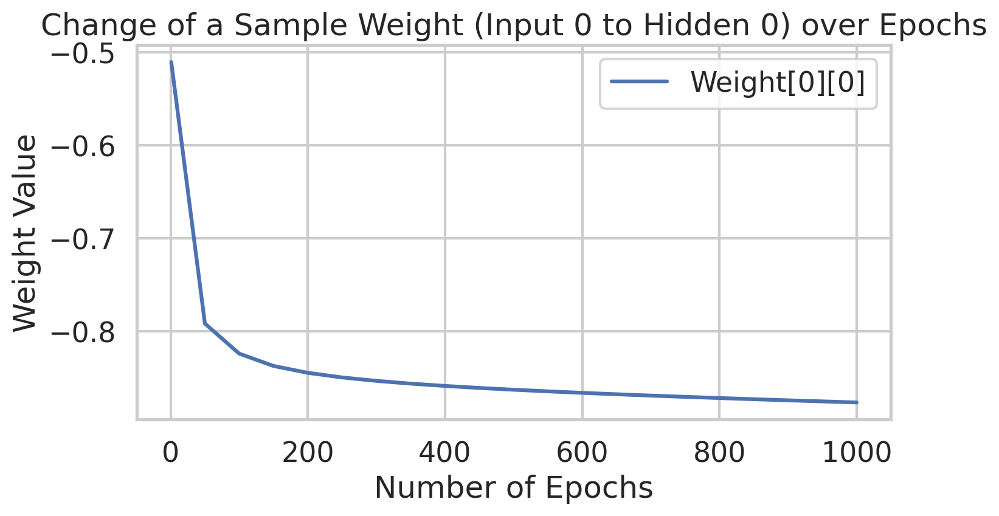

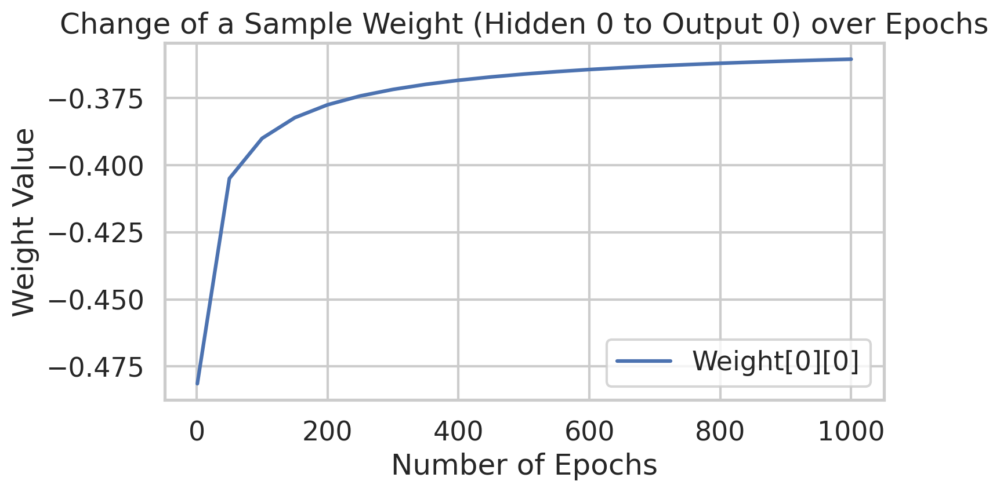

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


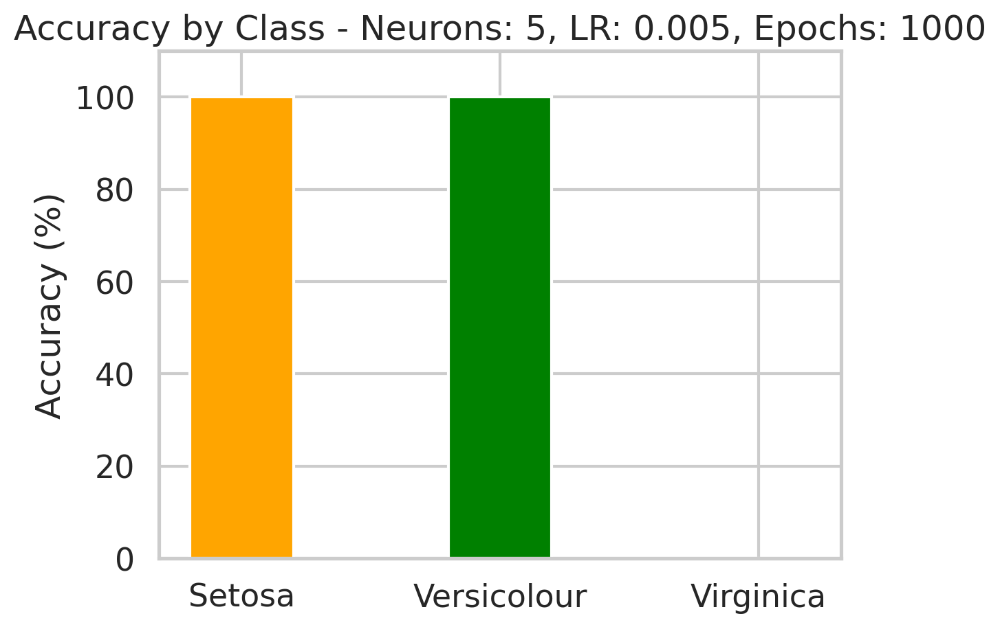

Epoch  1 - Total Error:  0.1916231639926645
Epoch  50 - Total Error:  0.13171257937697484
Epoch  100 - Total Error:  0.09840039345991759
Epoch  150 - Total Error:  0.08140559009258862
Epoch  200 - Total Error:  0.05595239331771387
Epoch  250 - Total Error:  0.04225327835139312
Epoch  300 - Total Error:  0.034948369522792774
Epoch  350 - Total Error:  0.03093424264778949
Epoch  400 - Total Error:  0.02850476862837244
Epoch  450 - Total Error:  0.026890477145833206
Epoch  500 - Total Error:  0.02573261640100676
Epoch  550 - Total Error:  0.02484985492612085
Epoch  600 - Total Error:  0.024143010864094667
Epoch  650 - Total Error:  0.023554074828661963
Epoch  700 - Total Error:  0.023047212558497586
Epoch  750 - Total Error:  0.022599294556177305
Epoch  800 - Total Error:  0.022194859951108852
Epoch  850 - Total Error:  0.02182328338057776
Epoch  900 - Total Error:  0.021477101347775043
Epoch  950 - Total Error:  0.021150980470391954
Epoch  1000 - Total Error:  0.0208410572509955
Epoch  1

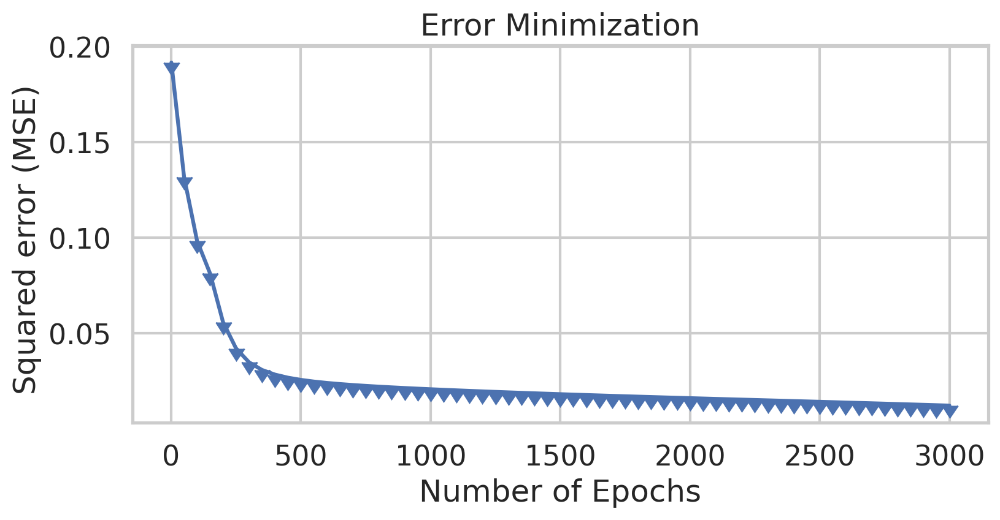

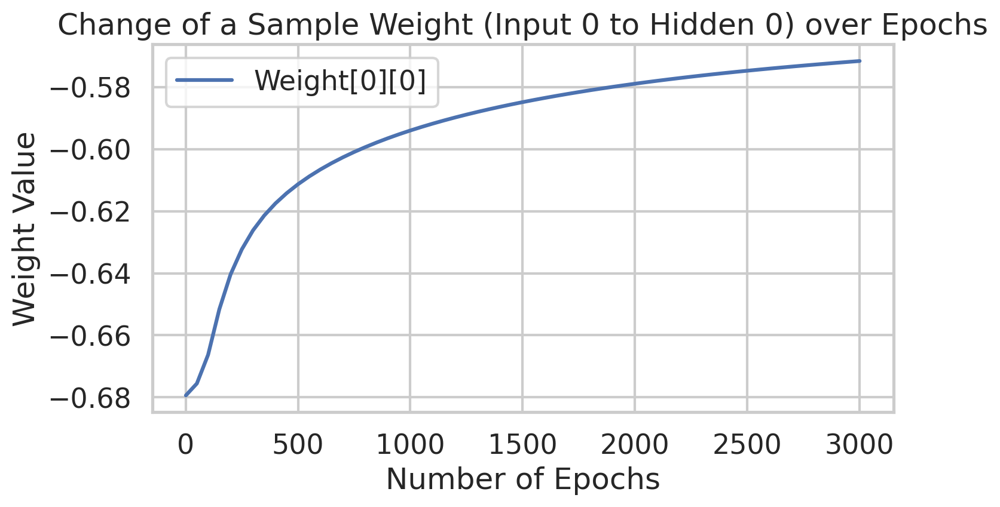

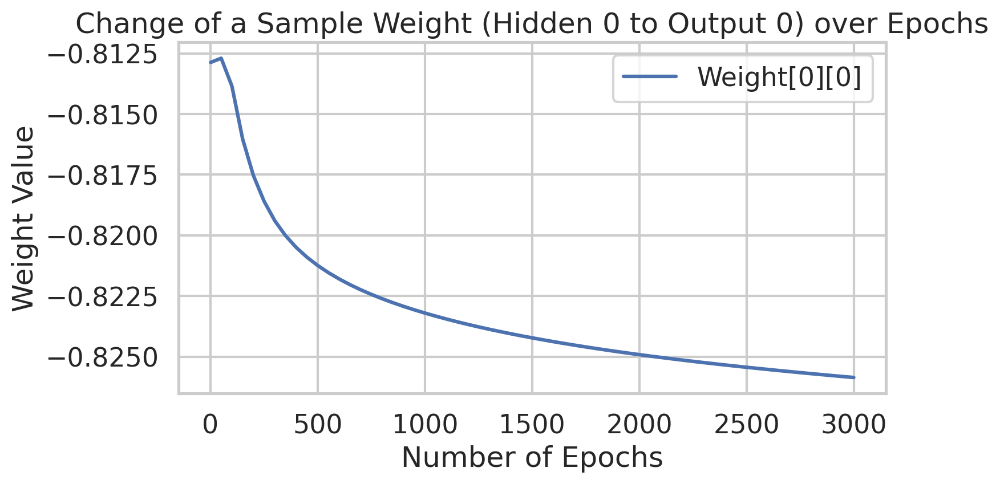

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


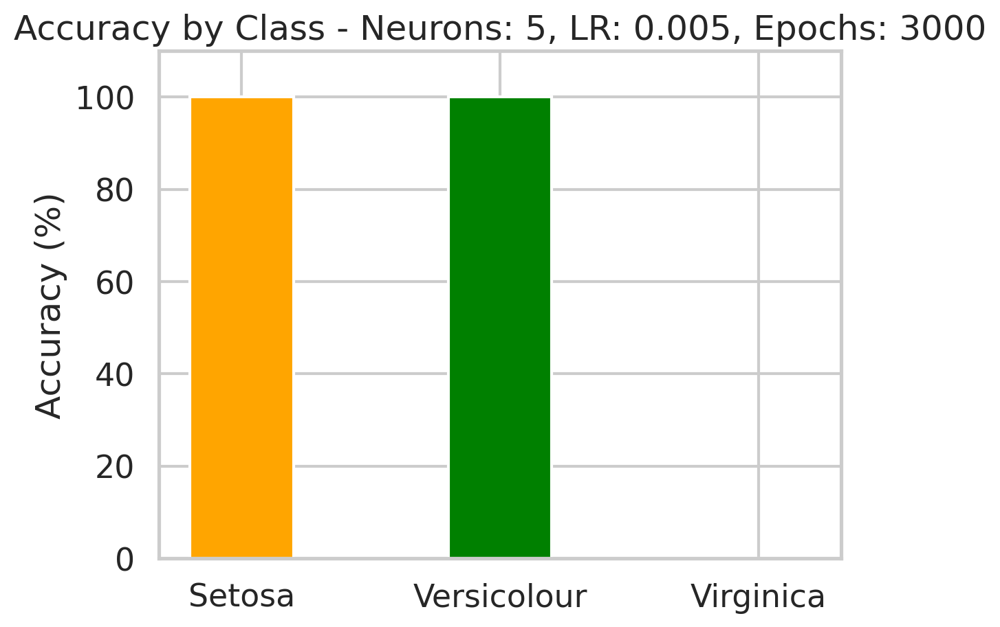

Epoch  1 - Total Error:  0.35609499719092635
Epoch  50 - Total Error:  0.11952750643696075
Epoch  100 - Total Error:  0.06712274569930911
Epoch  150 - Total Error:  0.04591070050288522
Epoch  200 - Total Error:  0.03748316252785622
Epoch  250 - Total Error:  0.0334360252277532
Epoch  300 - Total Error:  0.031163306820464934
Epoch  350 - Total Error:  0.02973991130971494
Epoch  400 - Total Error:  0.028776651220480114
Epoch  450 - Total Error:  0.02808645961160664
Epoch  500 - Total Error:  0.027569870604136276
Epoch  550 - Total Error:  0.027169714733007756
Epoch  600 - Total Error:  0.0268510437923221
Epoch  650 - Total Error:  0.026591395125222673
Epoch  700 - Total Error:  0.026375712023785046
Epoch  750 - Total Error:  0.026193527045426202
Epoch  800 - Total Error:  0.026037314618726312
Epoch  850 - Total Error:  0.025901475885710065
Epoch  900 - Total Error:  0.025781671258726067
Epoch  950 - Total Error:  0.02567433034334341
Epoch  1000 - Total Error:  0.025576203566319303
Epoch 

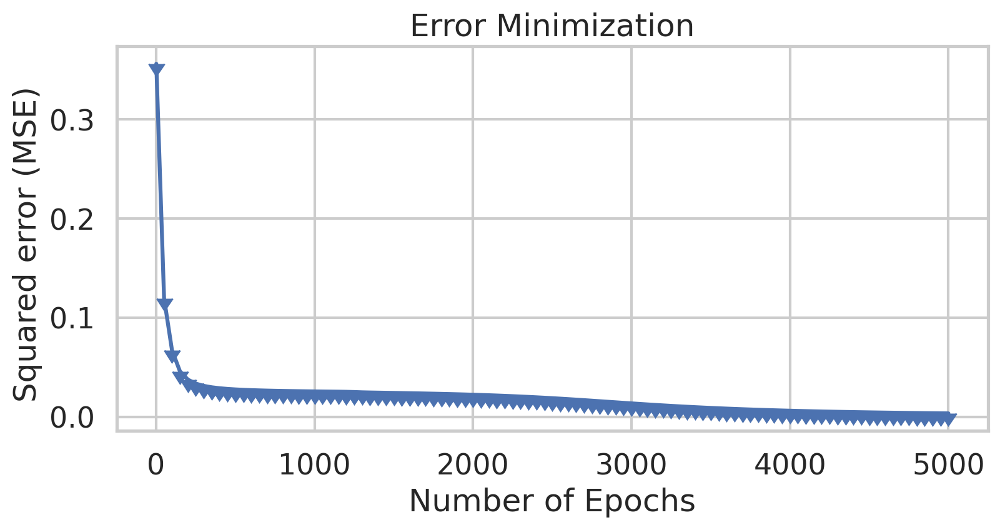

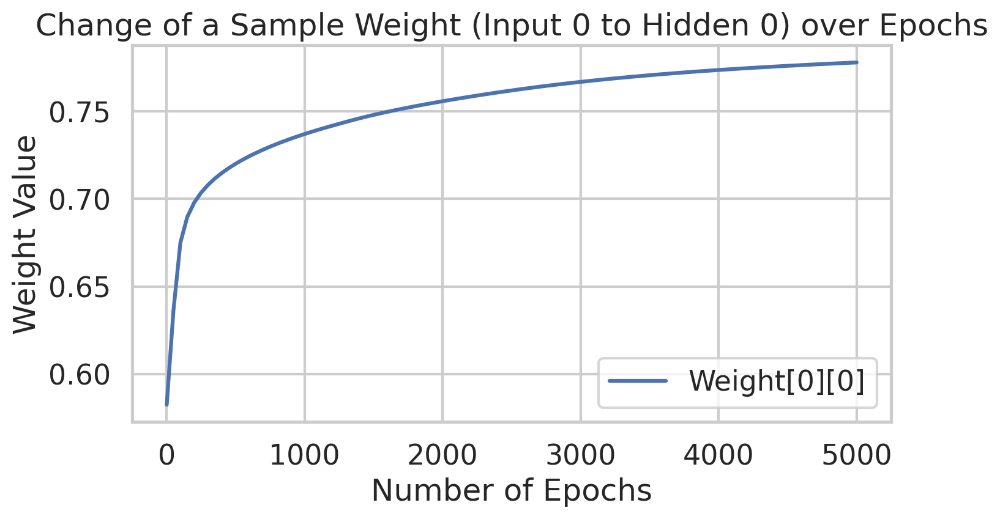

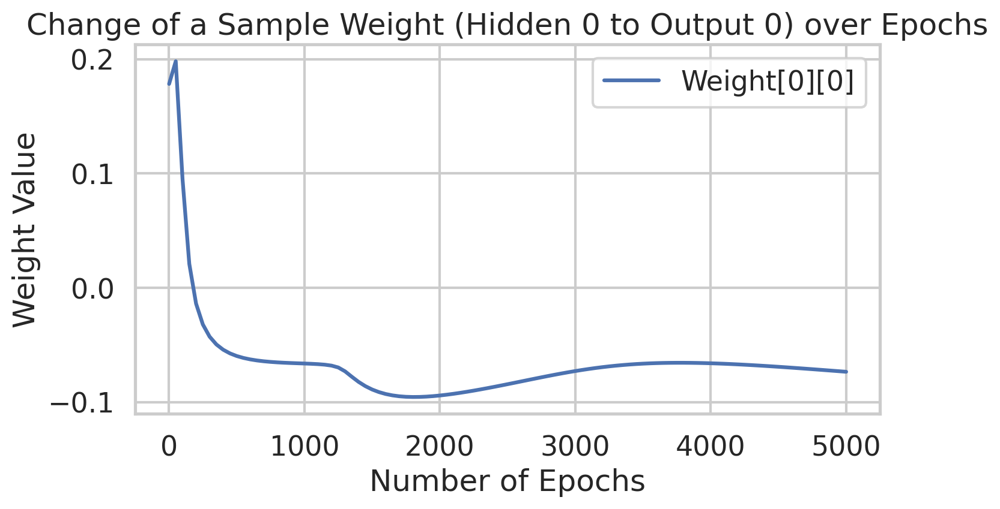

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


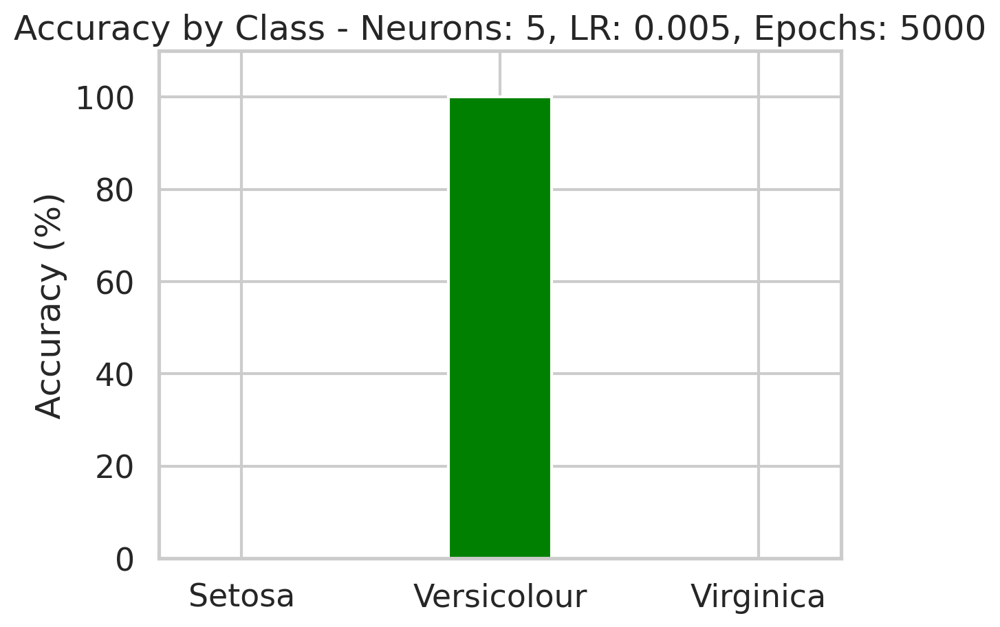

Epoch  1 - Total Error:  0.2400242306631291
Epoch  50 - Total Error:  0.13264054265899225
Epoch  100 - Total Error:  0.07232545870736738
Epoch  150 - Total Error:  0.046921603710149286
Epoch  200 - Total Error:  0.0379257180614128
Epoch  250 - Total Error:  0.03381452842142374
Epoch  300 - Total Error:  0.03155212744978239
Epoch  350 - Total Error:  0.03014343916272715
Epoch  400 - Total Error:  0.029187059665090623
Epoch  450 - Total Error:  0.02849492860477619
Epoch  500 - Total Error:  0.027968863880941705
Epoch  550 - Total Error:  0.027553318314565426
Epoch  600 - Total Error:  0.027214887208528986
Epoch  650 - Total Error:  0.026932502343938288
Epoch  700 - Total Error:  0.02669235268633153


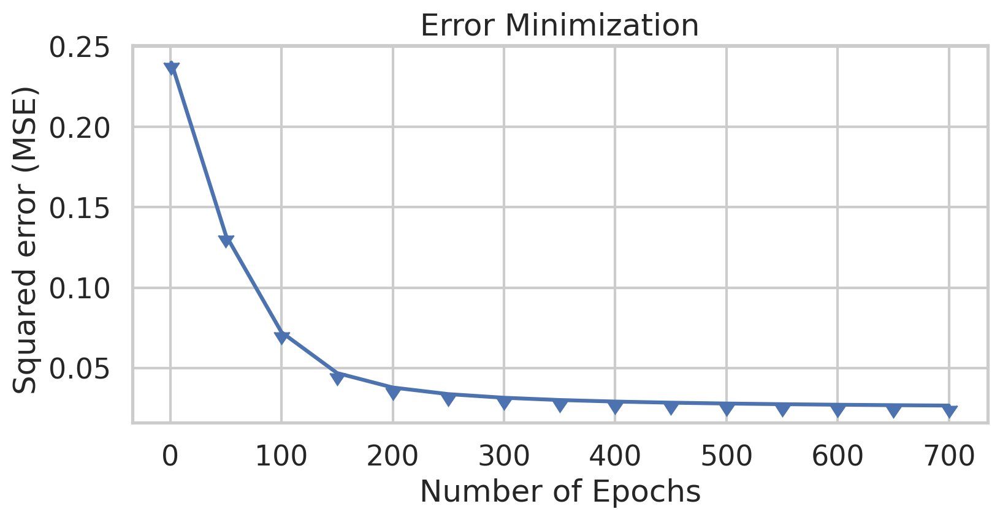

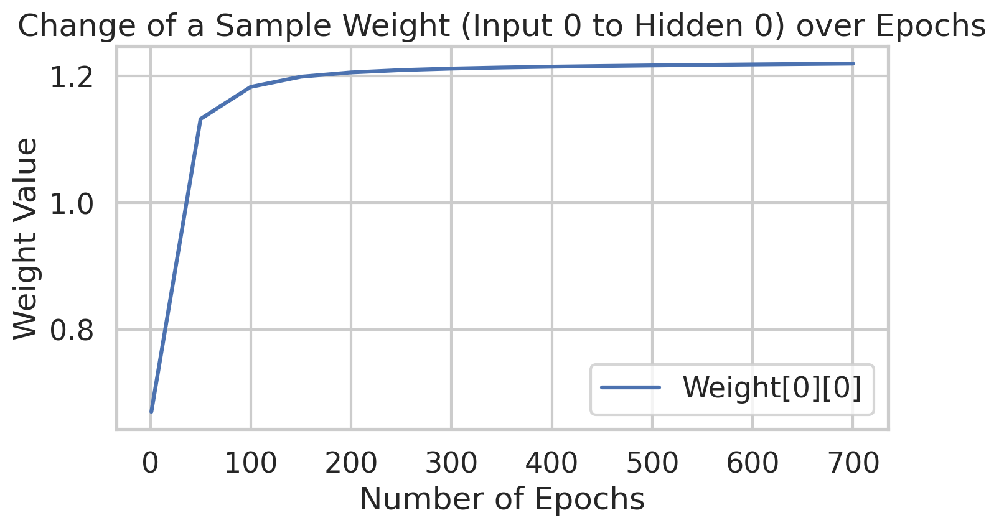

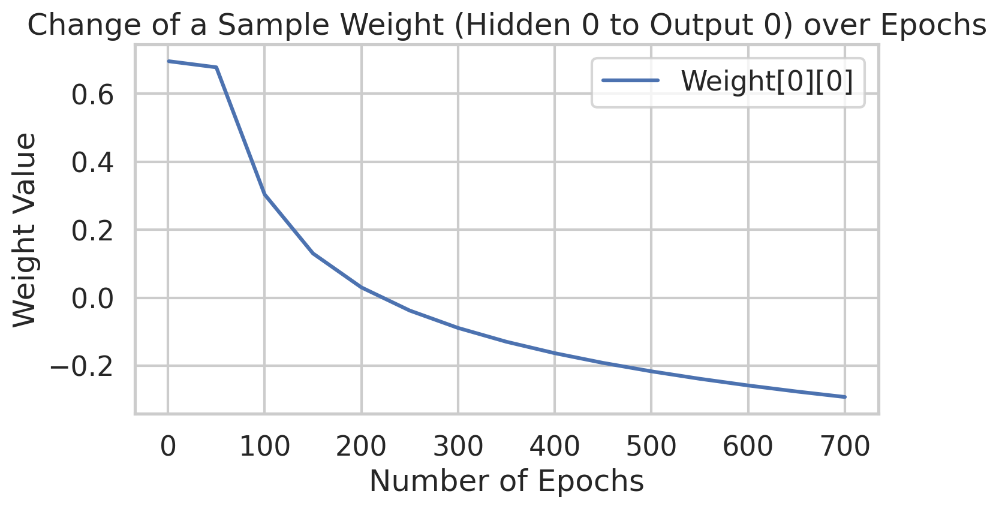

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


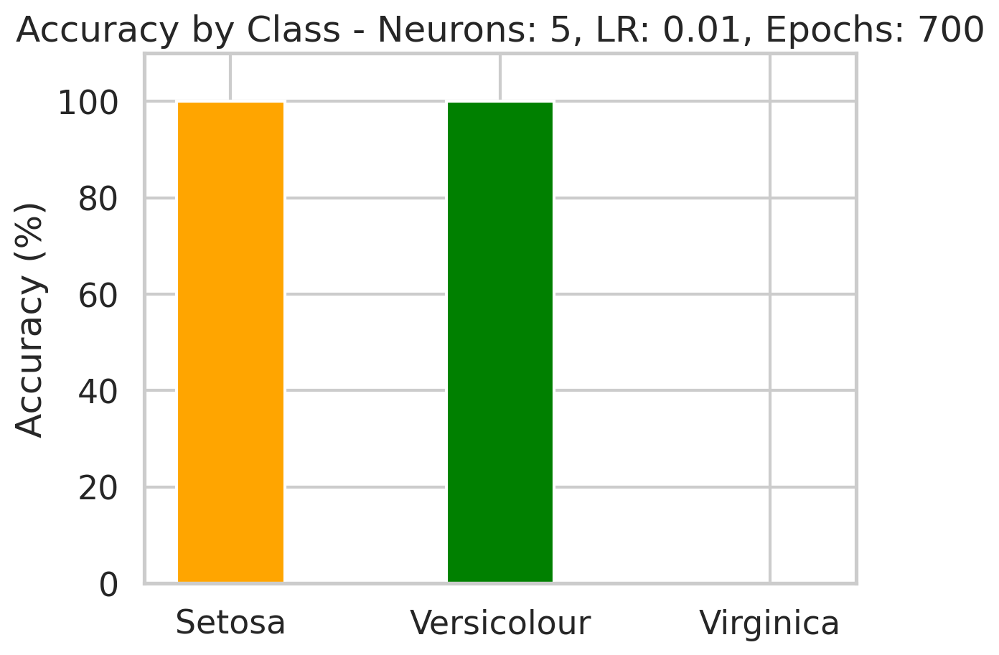

Epoch  1 - Total Error:  0.18139711533744945
Epoch  50 - Total Error:  0.07059589072398727
Epoch  100 - Total Error:  0.036248837111056524
Epoch  150 - Total Error:  0.030065673884277885
Epoch  200 - Total Error:  0.027962815928376645
Epoch  250 - Total Error:  0.026937658739049502
Epoch  300 - Total Error:  0.026336163293565338
Epoch  350 - Total Error:  0.02594337434495674
Epoch  400 - Total Error:  0.025668334042303075
Epoch  450 - Total Error:  0.02546577076150223
Epoch  500 - Total Error:  0.02531066449149518
Epoch  550 - Total Error:  0.025188158697850828
Epoch  600 - Total Error:  0.025088937443288623
Epoch  650 - Total Error:  0.02500689234114099
Epoch  700 - Total Error:  0.02493786398607363
Epoch  750 - Total Error:  0.02487892700056542
Epoch  800 - Total Error:  0.024827965689154515
Epoch  850 - Total Error:  0.02478341228421088
Epoch  900 - Total Error:  0.02474407987451407
Epoch  950 - Total Error:  0.024709052470800165
Epoch  1000 - Total Error:  0.024677610654519337


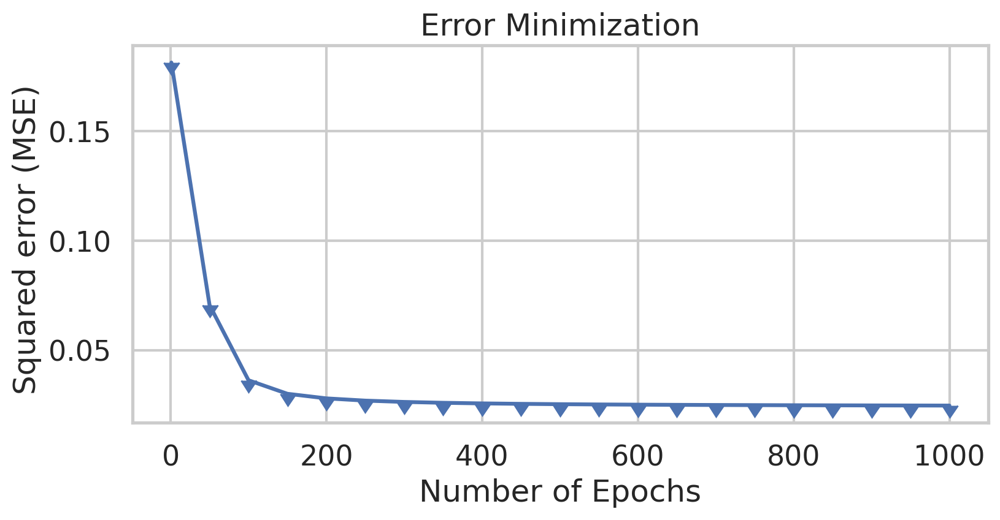

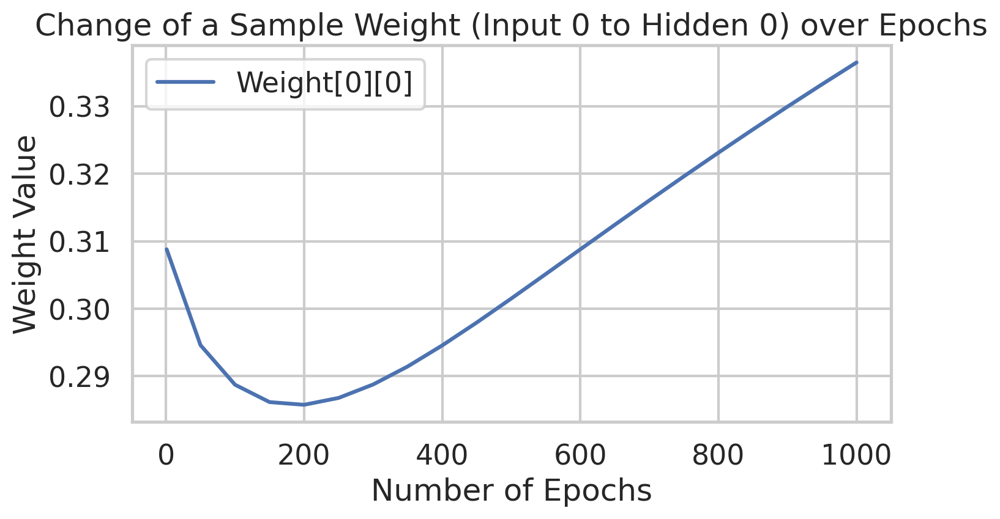

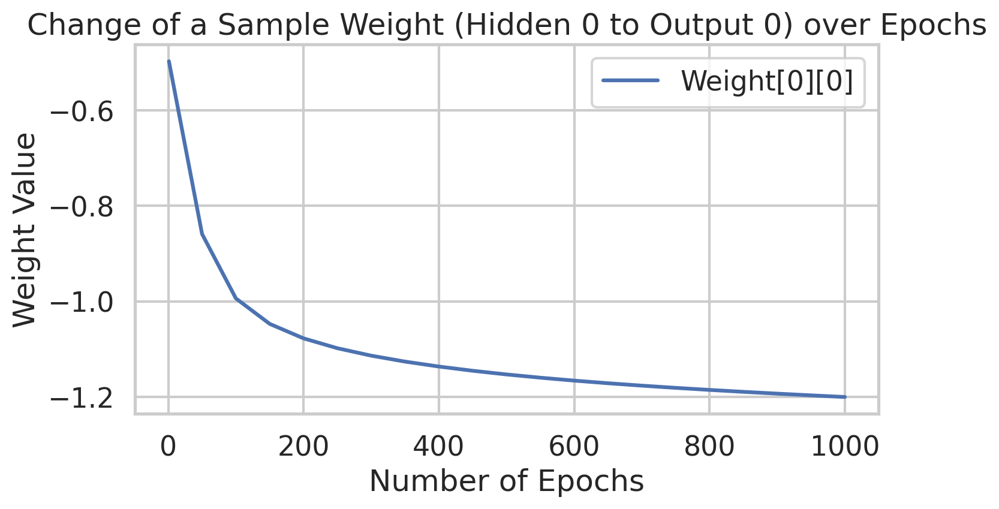

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


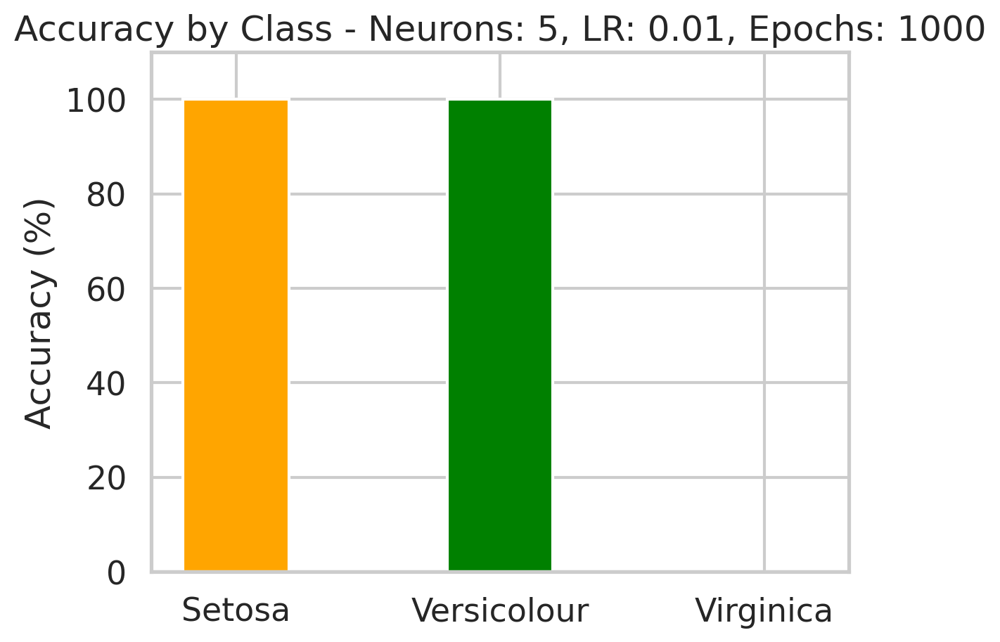

Epoch  1 - Total Error:  0.18690366351495705
Epoch  50 - Total Error:  0.1528383628055952
Epoch  100 - Total Error:  0.15240770121815791
Epoch  150 - Total Error:  0.1521955199014241
Epoch  200 - Total Error:  0.11077379408527636
Epoch  250 - Total Error:  0.058082881962731654
Epoch  300 - Total Error:  0.04171613961438163
Epoch  350 - Total Error:  0.035333189624119674
Epoch  400 - Total Error:  0.03216201903489203
Epoch  450 - Total Error:  0.03032050796148244
Epoch  500 - Total Error:  0.02913469831084794
Epoch  550 - Total Error:  0.028313882186259402
Epoch  600 - Total Error:  0.02771485179835216
Epoch  650 - Total Error:  0.027259784533260768
Epoch  700 - Total Error:  0.02690308621203541
Epoch  750 - Total Error:  0.026616409663178818
Epoch  800 - Total Error:  0.026381262959605977
Epoch  850 - Total Error:  0.02618509532753418
Epoch  900 - Total Error:  0.02601910074716123
Epoch  950 - Total Error:  0.025876924136881543
Epoch  1000 - Total Error:  0.025753867116699188
Epoch  10

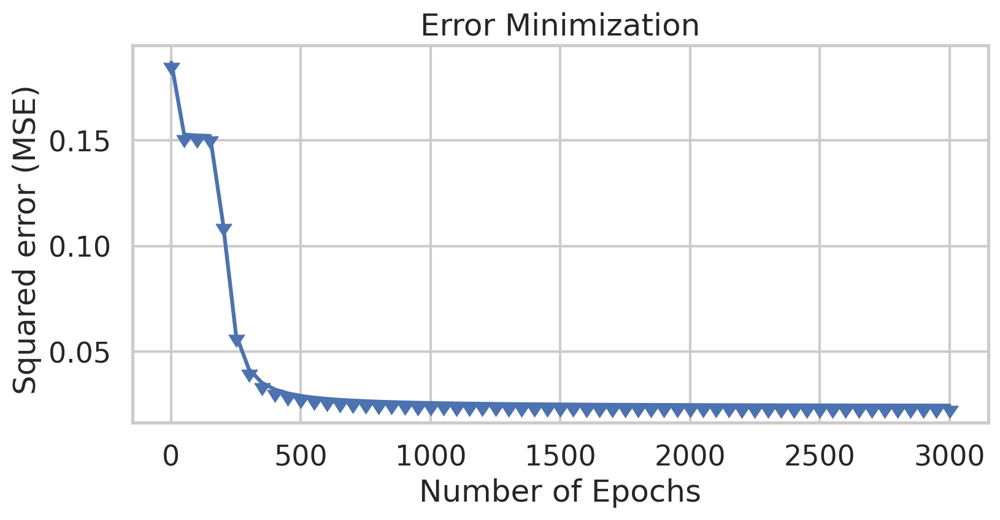

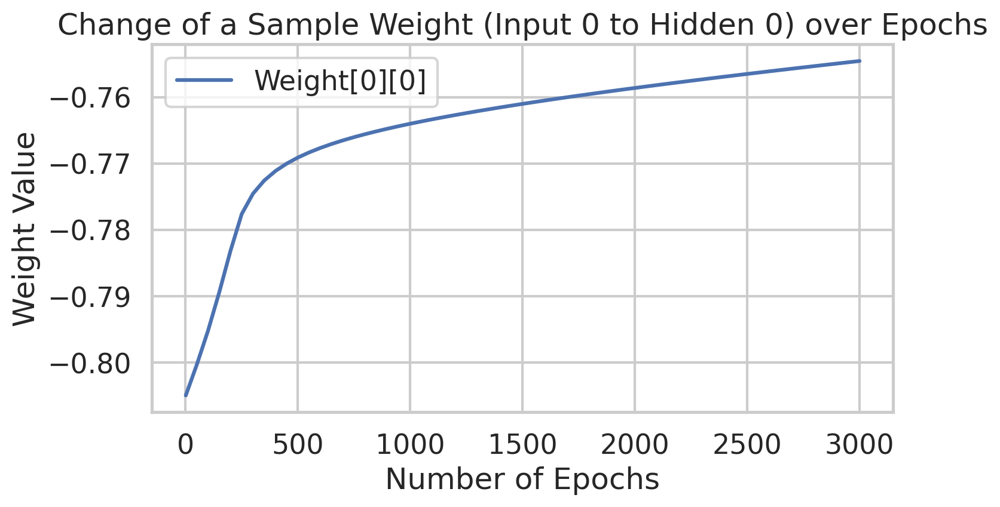

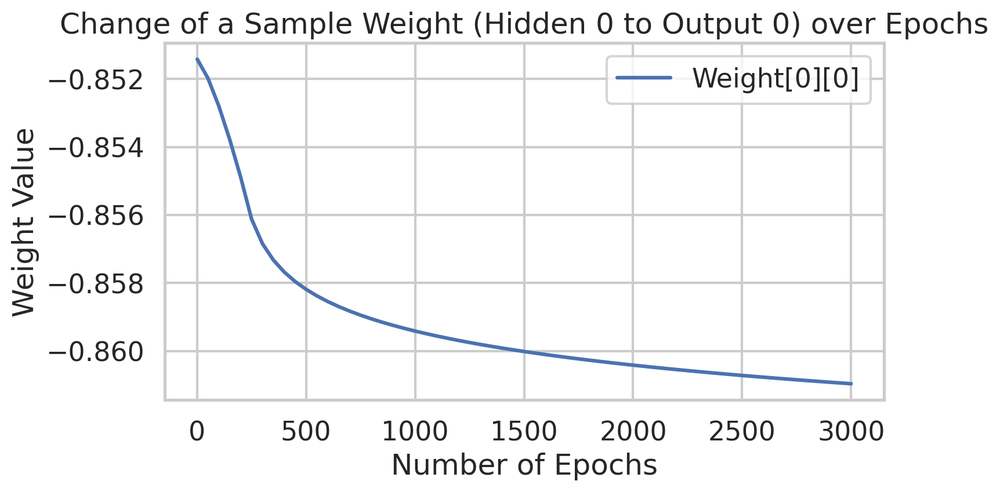

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


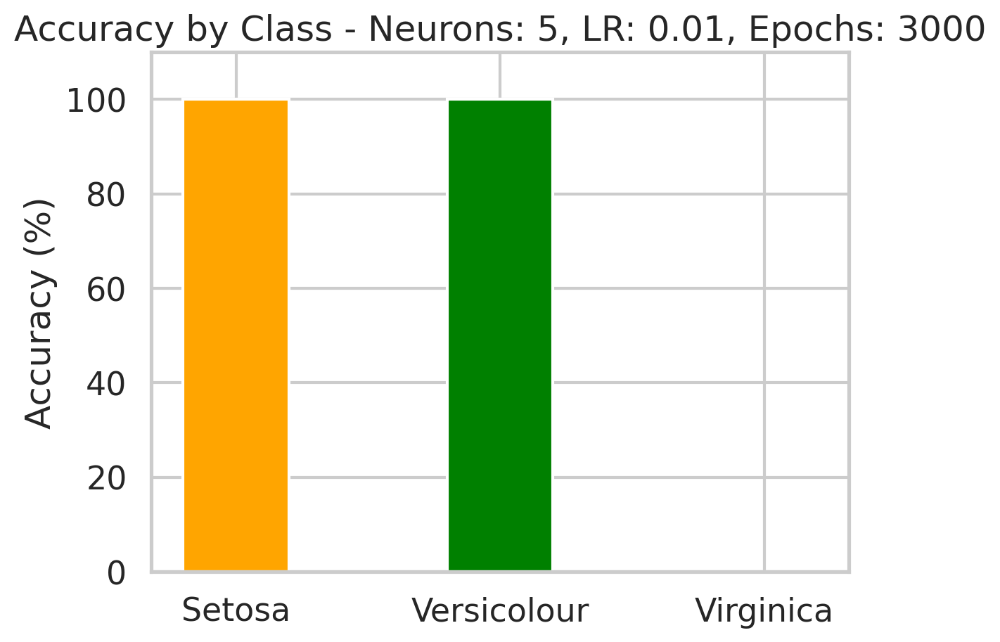

Epoch  1 - Total Error:  0.373816022271852
Epoch  50 - Total Error:  0.1553385803687095
Epoch  100 - Total Error:  0.1531313065123475
Epoch  150 - Total Error:  0.15259671684501389
Epoch  200 - Total Error:  0.15236903573229213
Epoch  250 - Total Error:  0.15224666806624626
Epoch  300 - Total Error:  0.15216922247161394
Epoch  350 - Total Error:  0.15210616508228508
Epoch  400 - Total Error:  0.15198620477570282
Epoch  450 - Total Error:  0.14172790854836187
Epoch  500 - Total Error:  0.0759600439290887
Epoch  550 - Total Error:  0.04878646134214492
Epoch  600 - Total Error:  0.03929960674045932
Epoch  650 - Total Error:  0.03484962387443101
Epoch  700 - Total Error:  0.03233973521727316
Epoch  750 - Total Error:  0.030748577522393017
Epoch  800 - Total Error:  0.029656709146286174
Epoch  850 - Total Error:  0.028863880981292455
Epoch  900 - Total Error:  0.0282634894204549
Epoch  950 - Total Error:  0.02779389871721665
Epoch  1000 - Total Error:  0.02741709473543118
Epoch  1050 - Tota

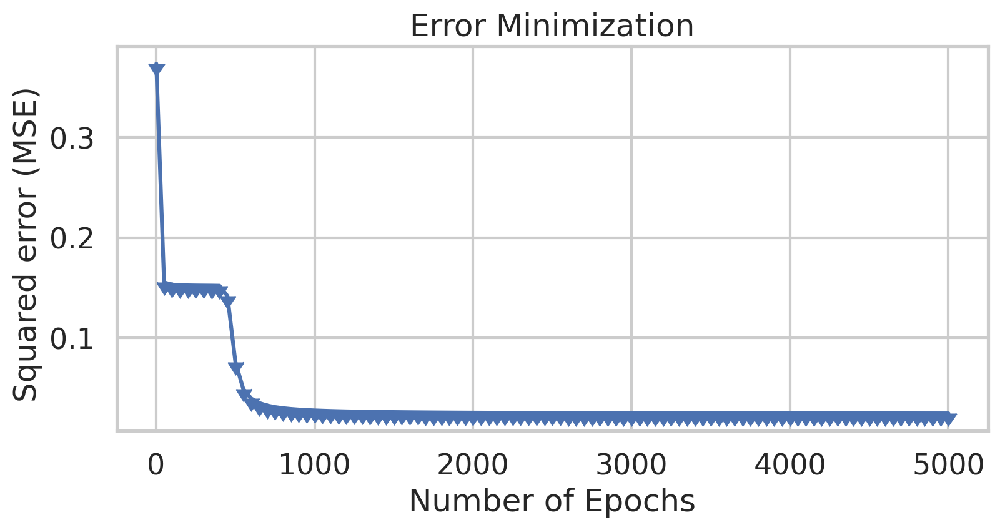

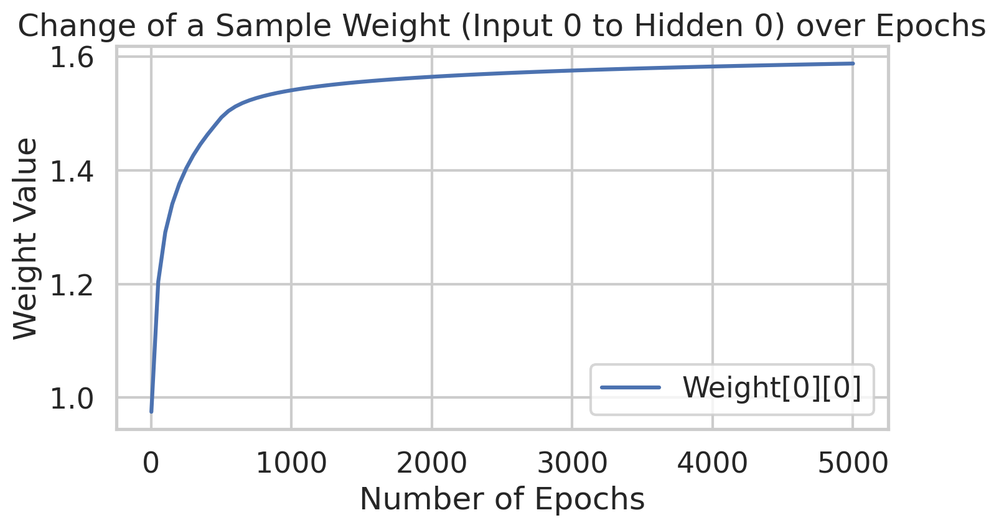

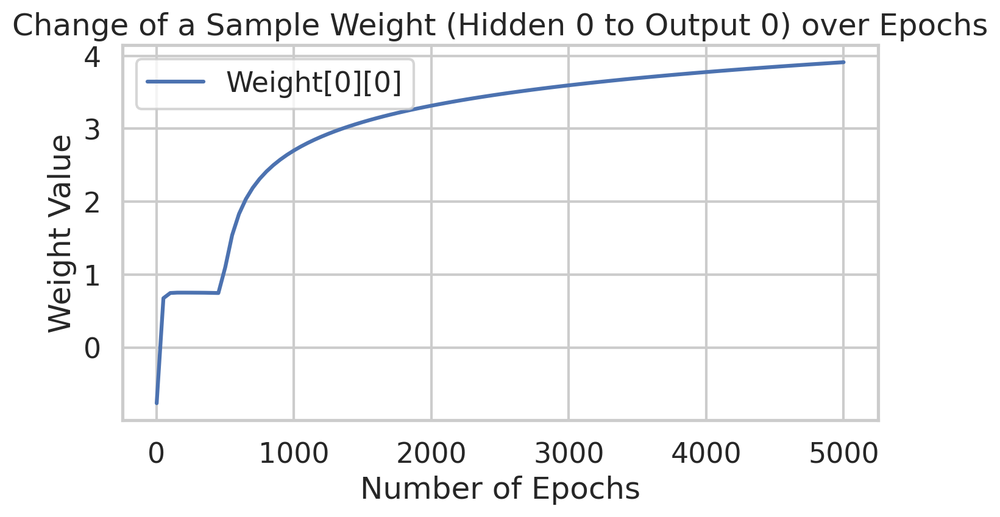

Overall accuracy: 73.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 22.22%
 - Accuracy Virginica: 0.00%


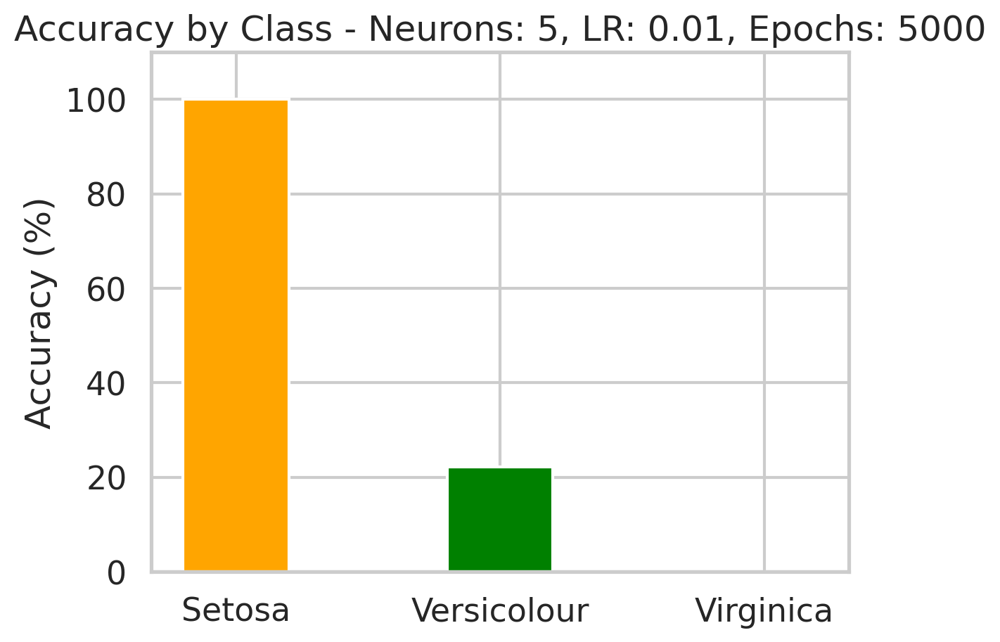

Epoch  1 - Total Error:  0.19300306710718015
Epoch  50 - Total Error:  0.026723649828463703
Epoch  100 - Total Error:  0.025088835721998163
Epoch  150 - Total Error:  0.024647869296971985
Epoch  200 - Total Error:  0.024119027756568337
Epoch  250 - Total Error:  0.021422750200709086
Epoch  300 - Total Error:  0.016351694601105565
Epoch  350 - Total Error:  0.009456921858499704
Epoch  400 - Total Error:  0.005356849238561311
Epoch  450 - Total Error:  0.0035184758551765963
Epoch  500 - Total Error:  0.002434731324624341
Epoch  550 - Total Error:  0.001776209745518717
Epoch  600 - Total Error:  0.0013651784286610328
Epoch  650 - Total Error:  0.0010978349670493115
Epoch  700 - Total Error:  0.0009148160725510799


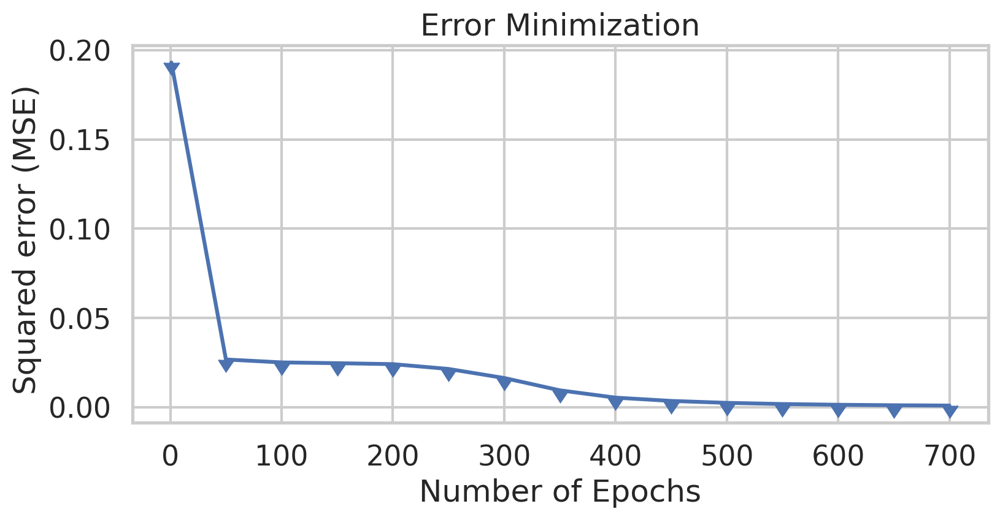

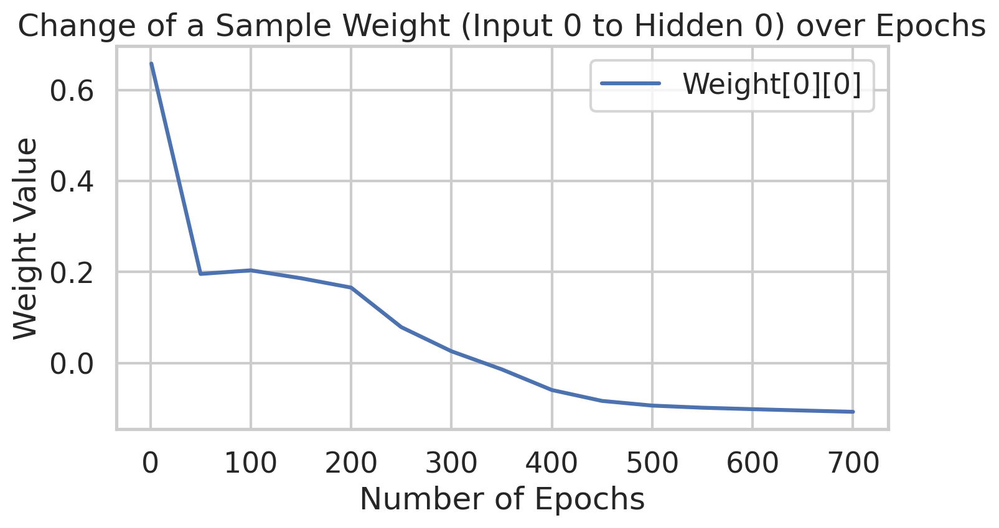

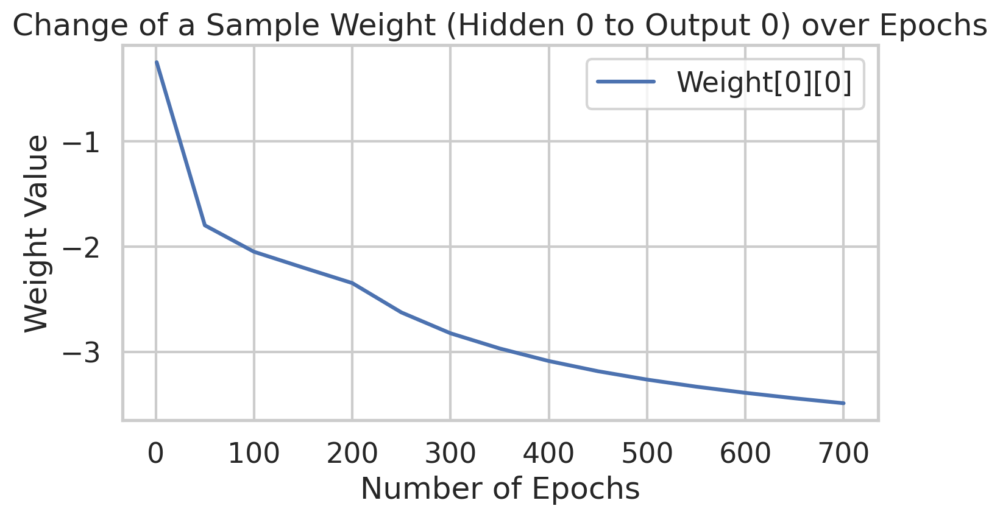

Overall accuracy: 40.00%
 - Accuracy Setosa: 10.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%


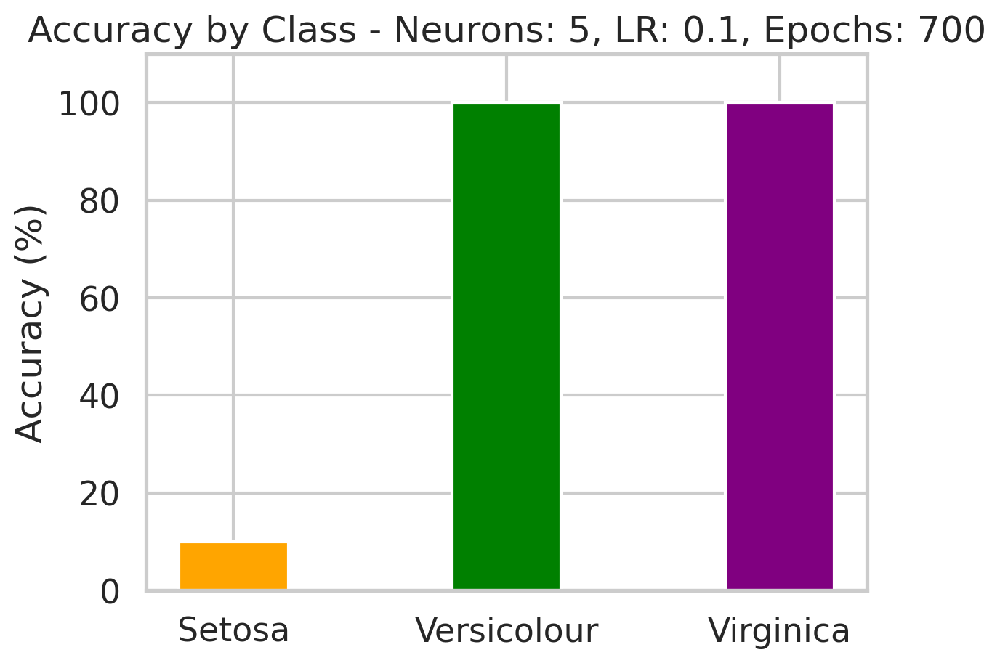

Epoch  1 - Total Error:  0.16568774729686556
Epoch  50 - Total Error:  0.026192577363372993
Epoch  100 - Total Error:  0.025043366567697053
Epoch  150 - Total Error:  0.02473387118695206
Epoch  200 - Total Error:  0.02459282227377791
Epoch  250 - Total Error:  0.024512239250430928
Epoch  300 - Total Error:  0.024460074634503372
Epoch  350 - Total Error:  0.02442351944753087
Epoch  400 - Total Error:  0.02439645821122492
Epoch  450 - Total Error:  0.024375602446699767
Epoch  500 - Total Error:  0.02435902604906289
Epoch  550 - Total Error:  0.02434552565539625
Epoch  600 - Total Error:  0.024334310460239053
Epoch  650 - Total Error:  0.024324839166234354
Epoch  700 - Total Error:  0.02431672860137481
Epoch  750 - Total Error:  0.02430969975157833
Epoch  800 - Total Error:  0.02430354446932841
Epoch  850 - Total Error:  0.02429810416312765
Epoch  900 - Total Error:  0.024293255713593438
Epoch  950 - Total Error:  0.02428890190055581
Epoch  1000 - Total Error:  0.024284964729846495


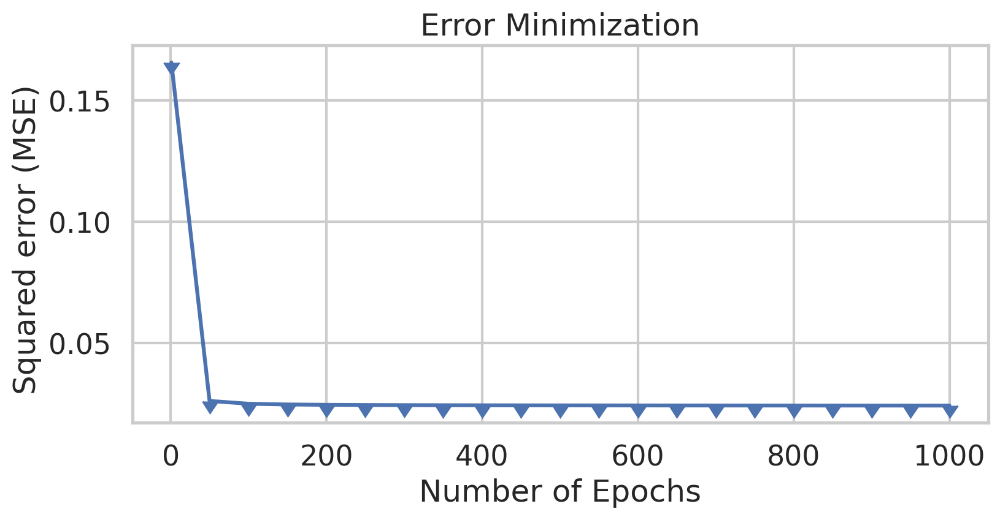

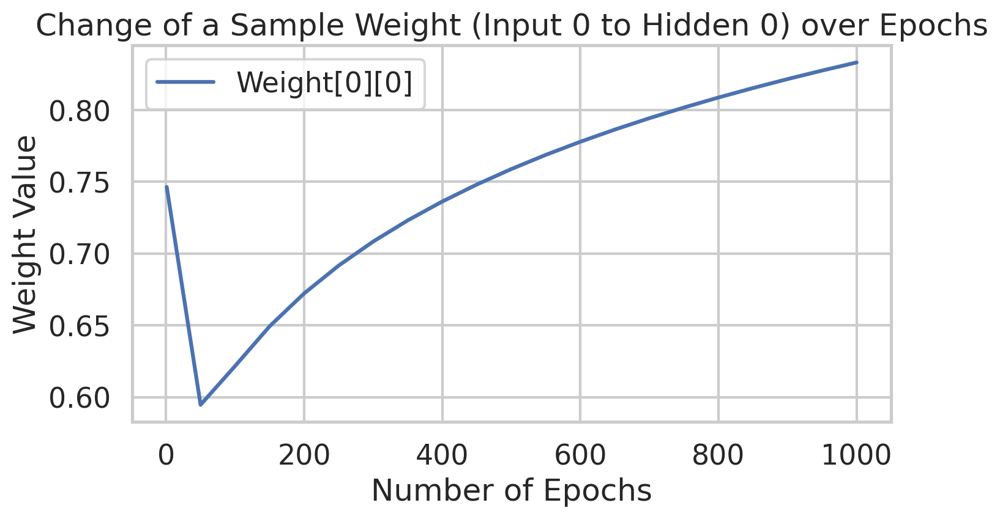

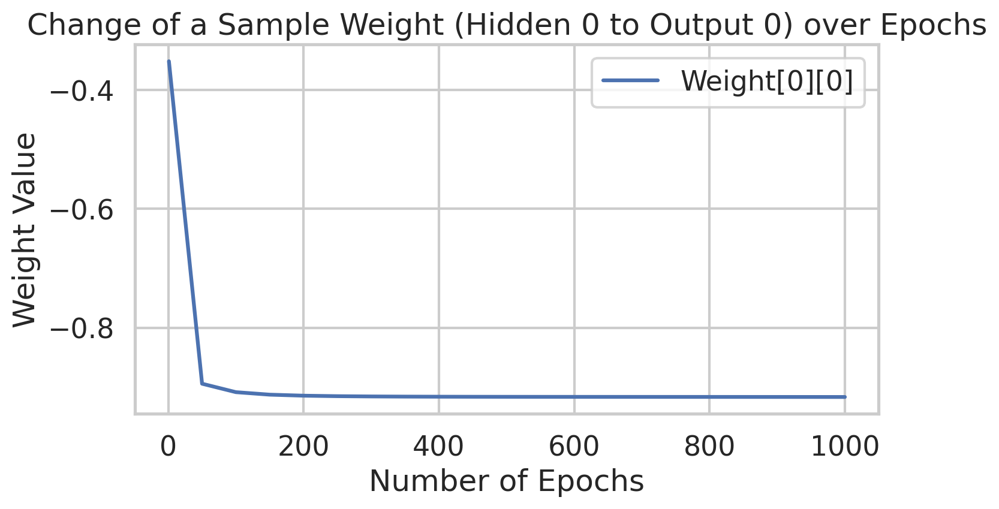

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


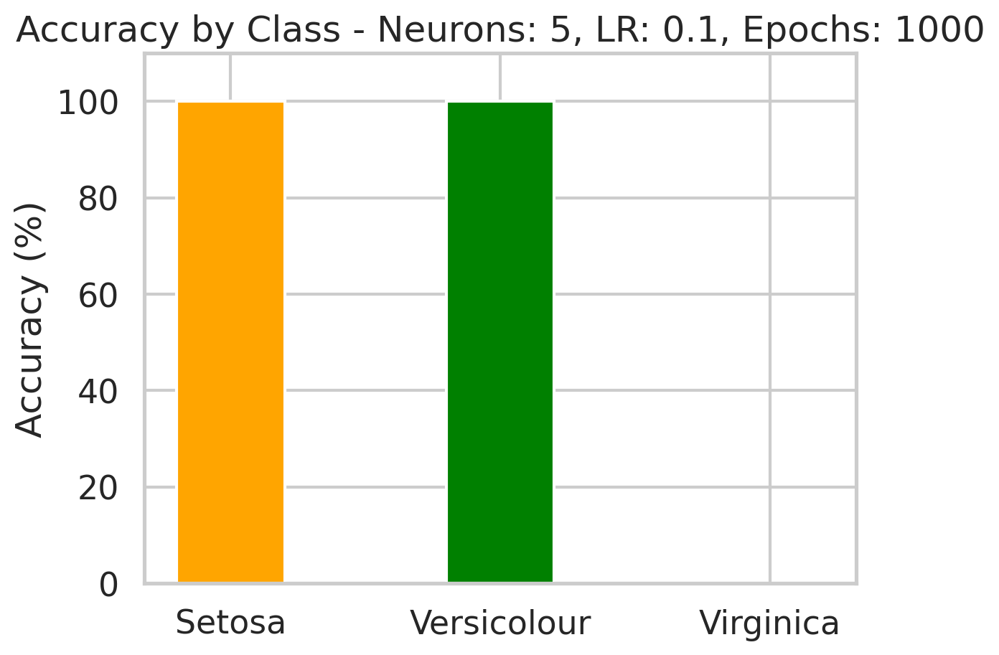

Epoch  1 - Total Error:  0.22429172231685338
Epoch  50 - Total Error:  0.025962144831316158
Epoch  100 - Total Error:  0.02494777062752722
Epoch  150 - Total Error:  0.024667930545846477
Epoch  200 - Total Error:  0.024538864666203964
Epoch  250 - Total Error:  0.024464614046904778
Epoch  300 - Total Error:  0.024416351915939296
Epoch  350 - Total Error:  0.024382445271114994
Epoch  400 - Total Error:  0.02435730338712945
Epoch  450 - Total Error:  0.024337906317380194
Epoch  500 - Total Error:  0.024322479614232402
Epoch  550 - Total Error:  0.02430991216275274
Epoch  600 - Total Error:  0.024299472620608446
Epoch  650 - Total Error:  0.024290659865510437
Epoch  700 - Total Error:  0.024283118962958105
Epoch  750 - Total Error:  0.024276591444091562
Epoch  800 - Total Error:  0.024270884590713672
Epoch  850 - Total Error:  0.02426585175760358
Epoch  900 - Total Error:  0.02426137936569409
Epoch  950 - Total Error:  0.024257378068328686
Epoch  1000 - Total Error:  0.024253776607482878


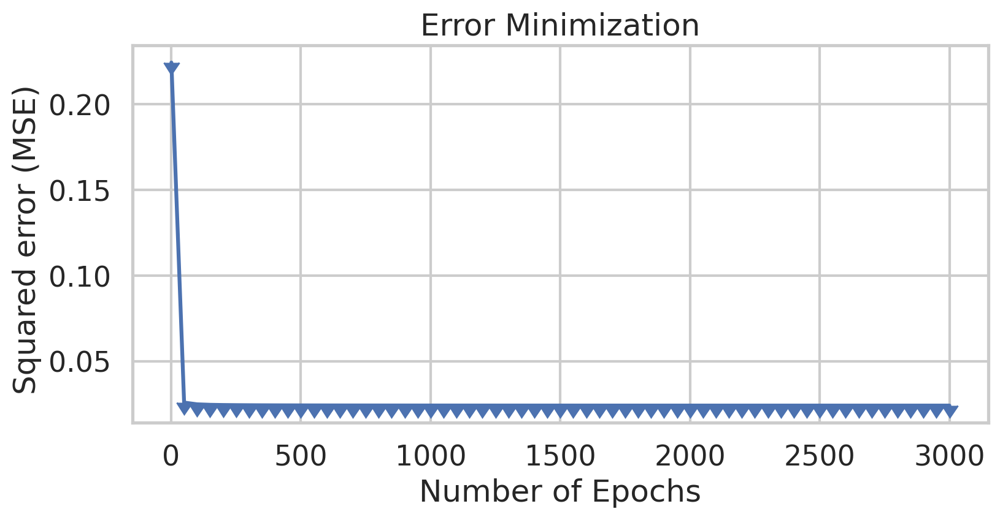

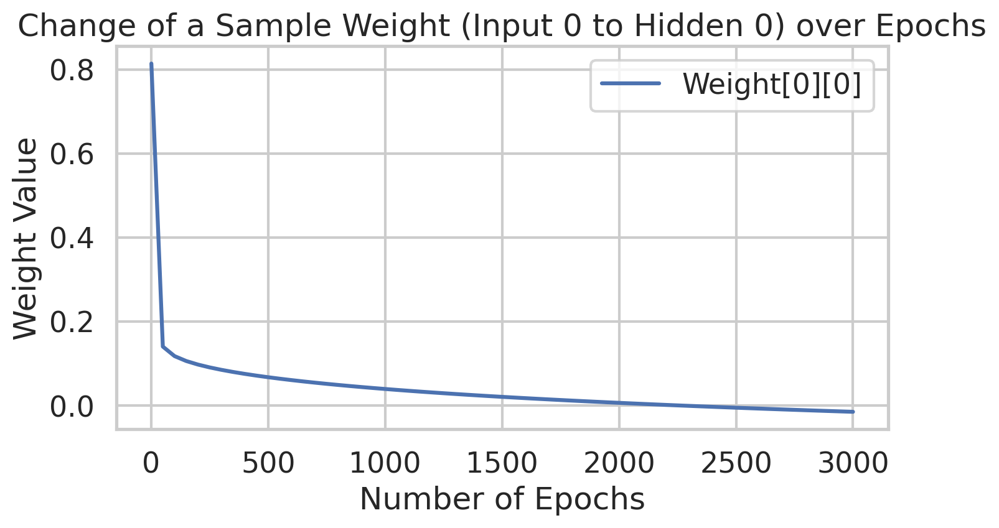

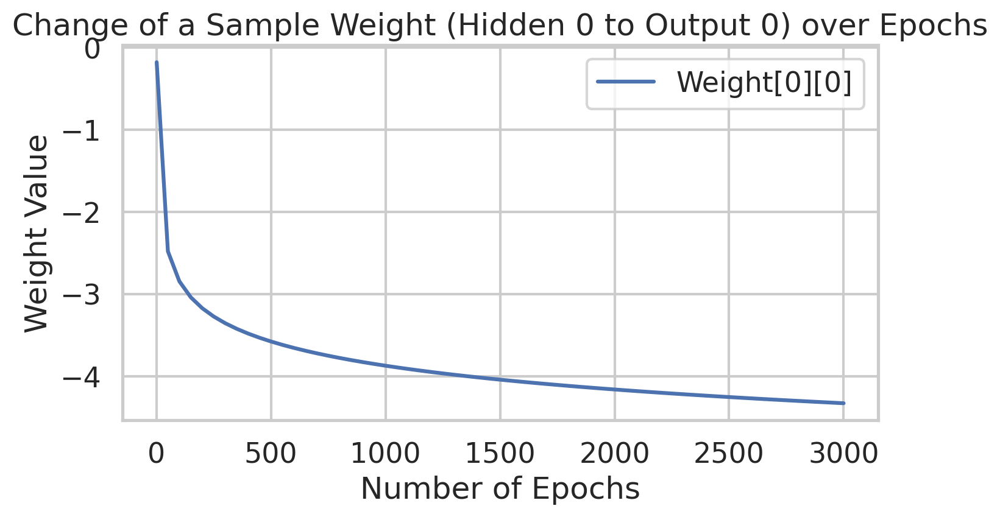

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


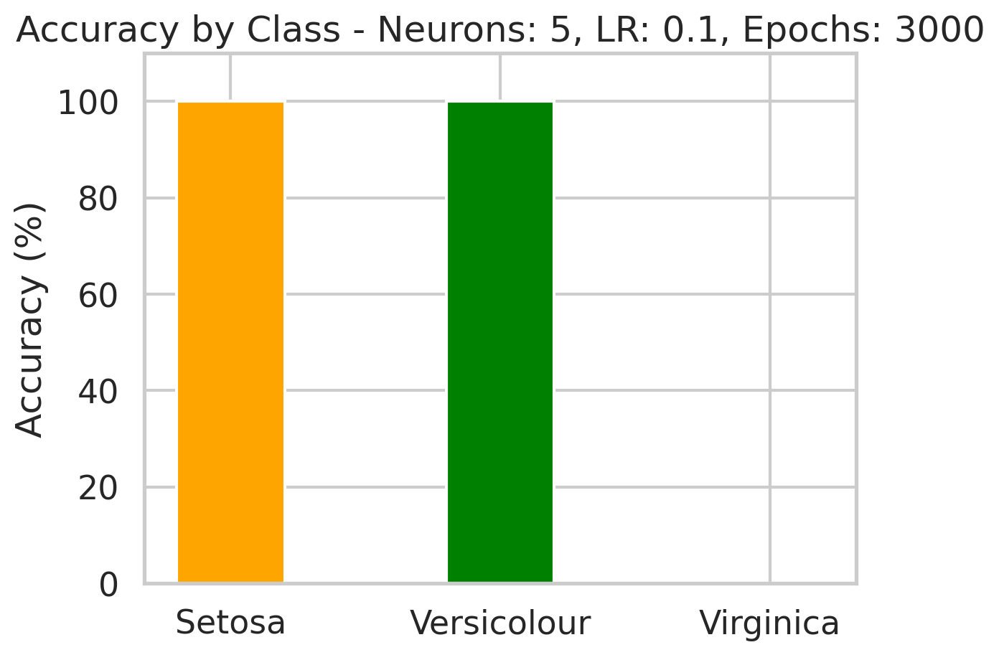

Epoch  1 - Total Error:  0.1965824771094896
Epoch  50 - Total Error:  0.024830617369587218
Epoch  100 - Total Error:  0.022657876704783798
Epoch  150 - Total Error:  0.018137947966162412
Epoch  200 - Total Error:  0.011262393102582974
Epoch  250 - Total Error:  0.006294840354801578
Epoch  300 - Total Error:  0.003912135863910838
Epoch  350 - Total Error:  0.0026116105281002297
Epoch  400 - Total Error:  0.0018646916350386774
Epoch  450 - Total Error:  0.0014123058330244894
Epoch  500 - Total Error:  0.0011222348593333206
Epoch  550 - Total Error:  0.0009259986150008251
Epoch  600 - Total Error:  0.0007861523713159357
Epoch  650 - Total Error:  0.000681943436578098
Epoch  700 - Total Error:  0.0006014552321207377
Epoch  750 - Total Error:  0.0005374890062294974
Epoch  800 - Total Error:  0.0004854722818098224
Epoch  850 - Total Error:  0.00044236998788626646
Epoch  900 - Total Error:  0.0004060909611975067
Epoch  950 - Total Error:  0.0003751483700336614
Epoch  1000 - Total Error:  0.00

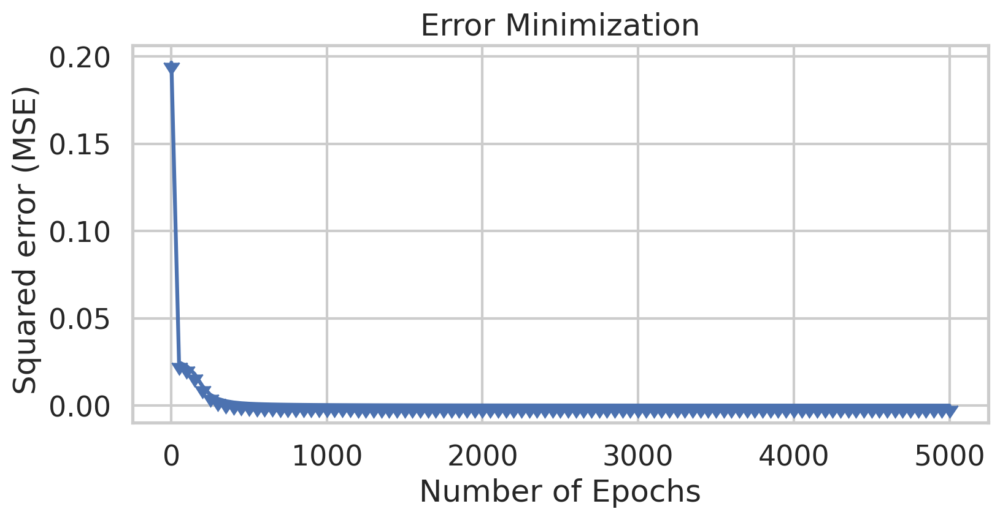

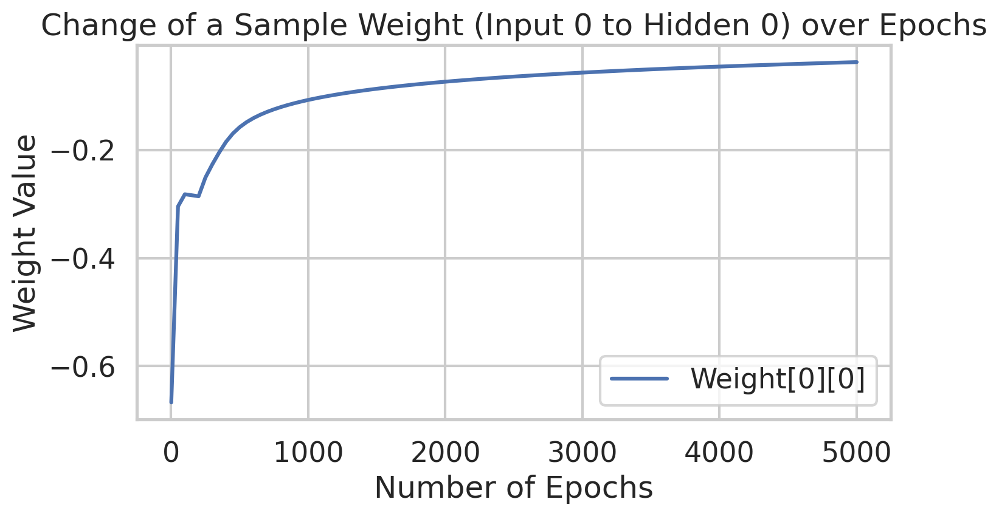

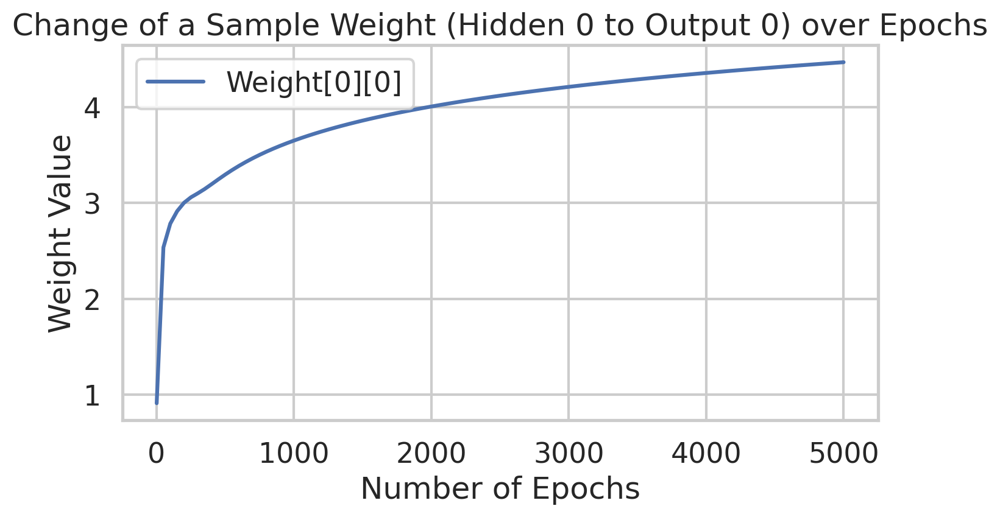

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%


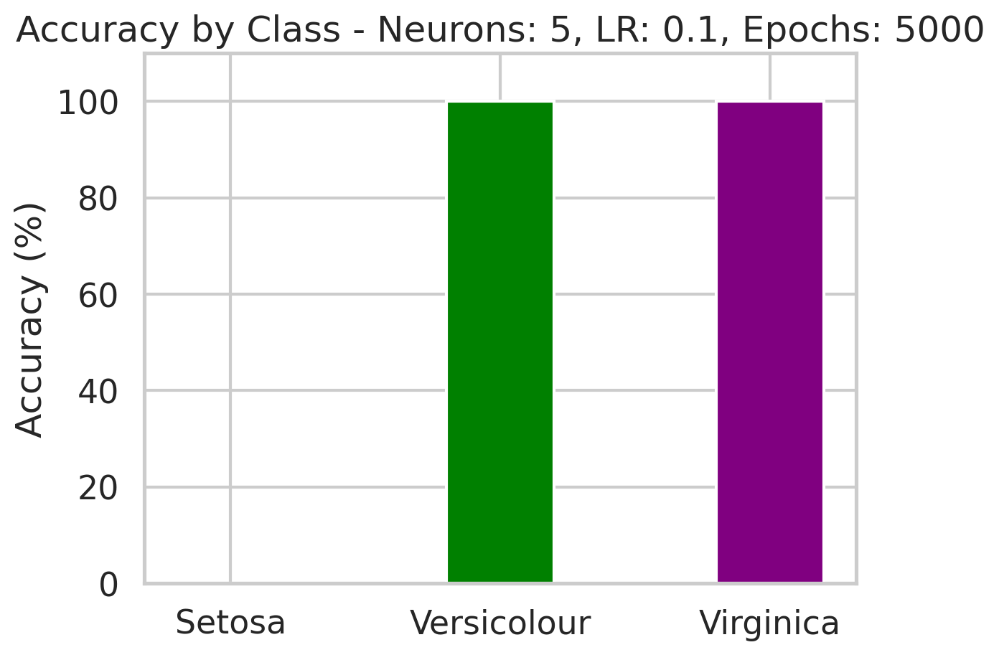

Epoch  1 - Total Error:  0.2279263945711442
Epoch  50 - Total Error:  0.15374234647055698
Epoch  100 - Total Error:  0.13139344031988373
Epoch  150 - Total Error:  0.11505409797254812
Epoch  200 - Total Error:  0.09968855194329637
Epoch  250 - Total Error:  0.08653619667694482
Epoch  300 - Total Error:  0.07577905494819406
Epoch  350 - Total Error:  0.06714946495927386
Epoch  400 - Total Error:  0.06032392538068445
Epoch  450 - Total Error:  0.05494115513084675
Epoch  500 - Total Error:  0.05067463900939266
Epoch  550 - Total Error:  0.04726200693135552
Epoch  600 - Total Error:  0.04450286222790333
Epoch  650 - Total Error:  0.04224696332249651
Epoch  700 - Total Error:  0.04038208188074442


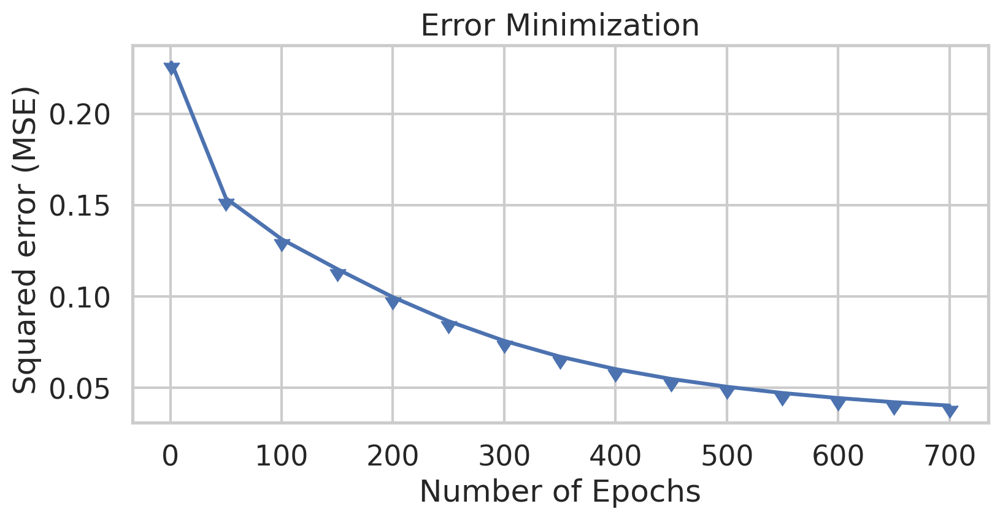

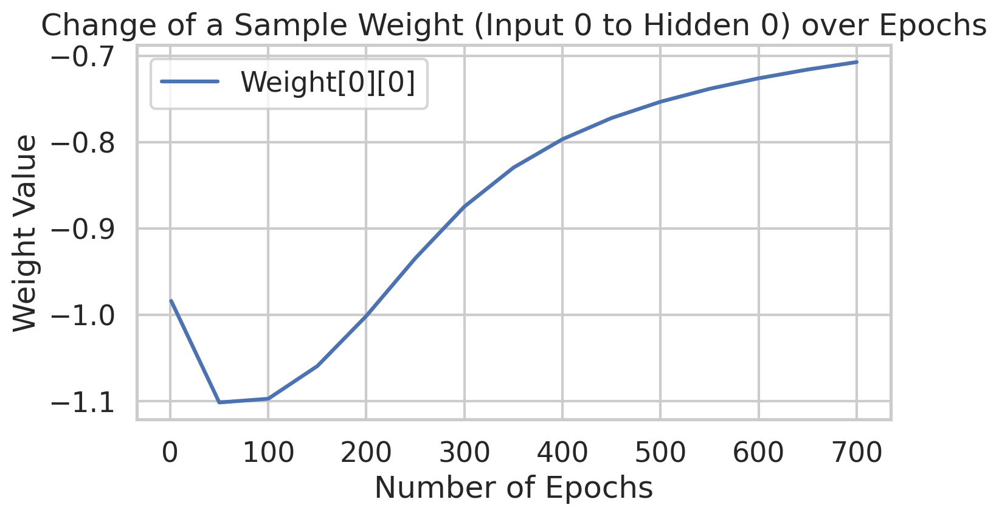

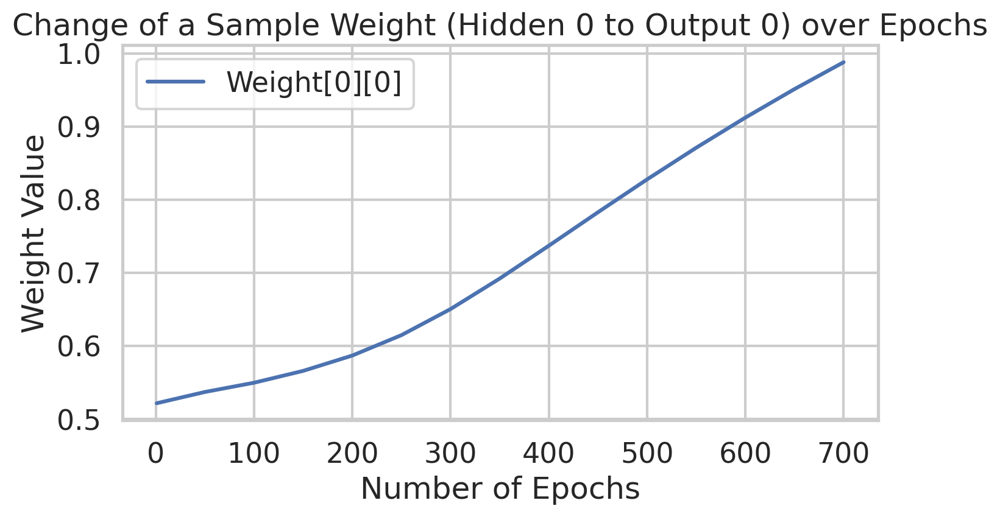

Overall accuracy: 70.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 11.11%
 - Accuracy Virginica: 0.00%


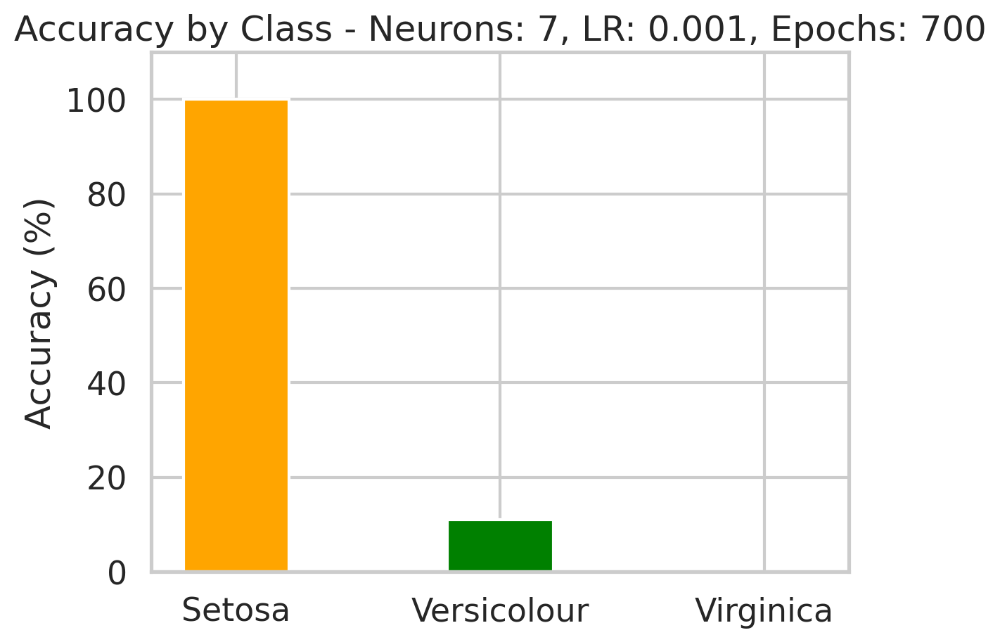

Epoch  1 - Total Error:  0.161863536820565
Epoch  50 - Total Error:  0.11103017918577246
Epoch  100 - Total Error:  0.08717727230646415
Epoch  150 - Total Error:  0.07088159233110884
Epoch  200 - Total Error:  0.059414326754752854
Epoch  250 - Total Error:  0.052476971159300764
Epoch  300 - Total Error:  0.04759494265309829
Epoch  350 - Total Error:  0.04396652553358646
Epoch  400 - Total Error:  0.04118487120193935
Epoch  450 - Total Error:  0.039001409543269
Epoch  500 - Total Error:  0.03725364555204981
Epoch  550 - Total Error:  0.03583102978520873
Epoch  600 - Total Error:  0.03465608938903981
Epoch  650 - Total Error:  0.03367319896878929
Epoch  700 - Total Error:  0.03284158180134117
Epoch  750 - Total Error:  0.03213079649018589
Epoch  800 - Total Error:  0.031517745505795954
Epoch  850 - Total Error:  0.030984645827496556
Epoch  900 - Total Error:  0.030517623997935228
Epoch  950 - Total Error:  0.03010572567078801
Epoch  1000 - Total Error:  0.029740205832498583


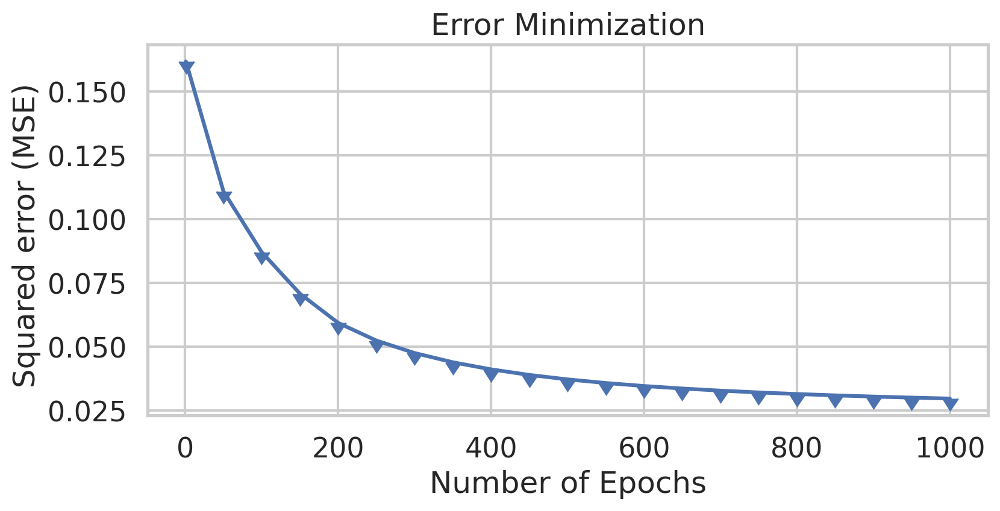

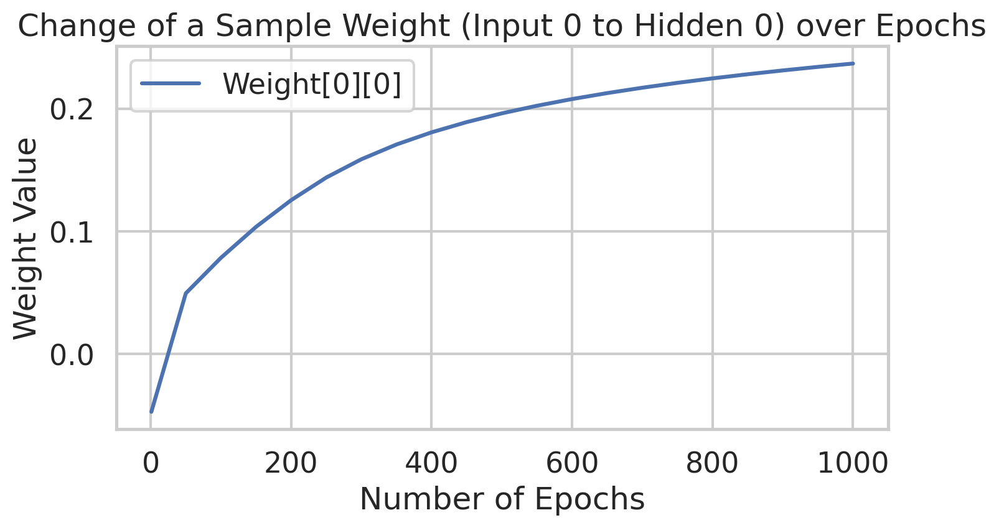

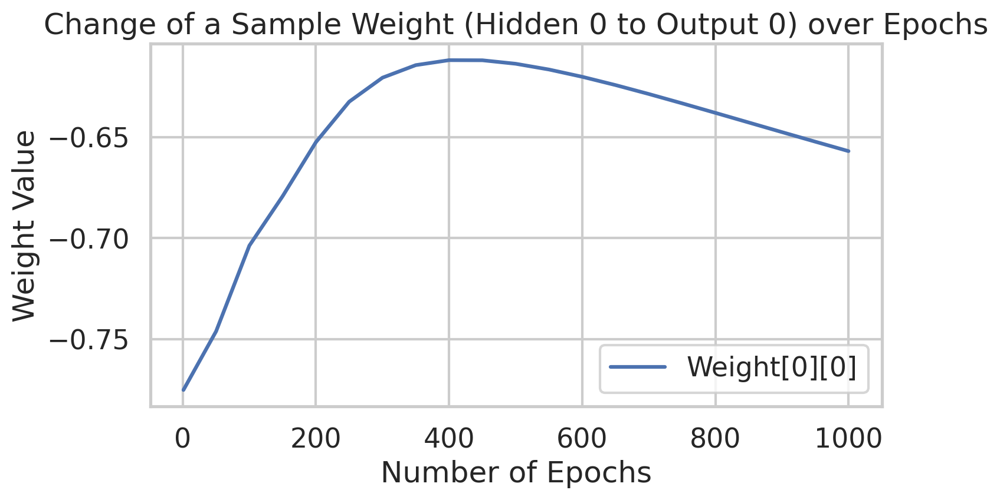

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


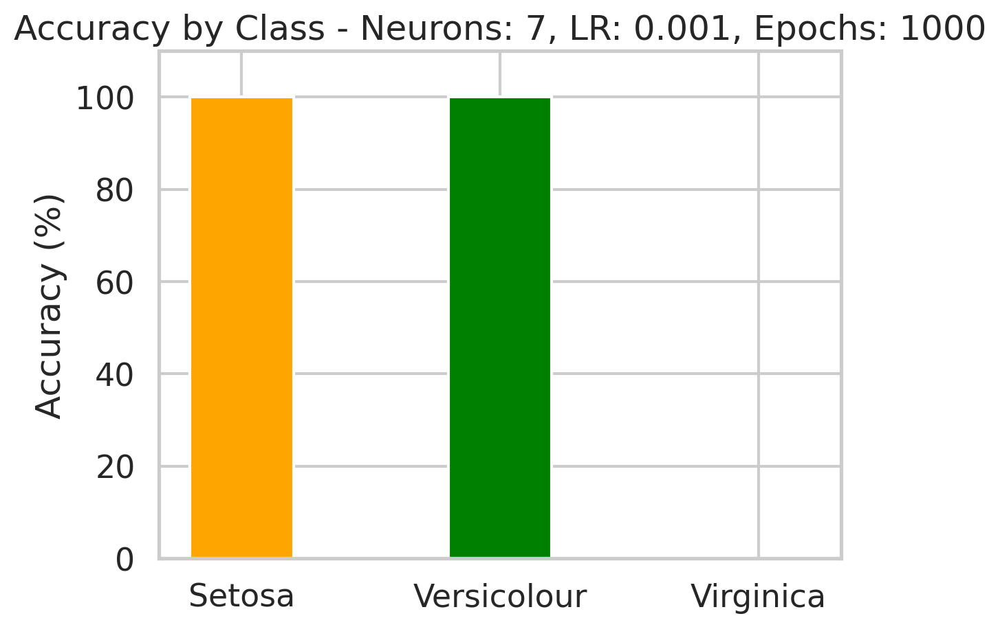

Epoch  1 - Total Error:  0.30405648044808425
Epoch  50 - Total Error:  0.17857334848683246
Epoch  100 - Total Error:  0.16400096519311747
Epoch  150 - Total Error:  0.1592241894079334
Epoch  200 - Total Error:  0.15704304312603928
Epoch  250 - Total Error:  0.15583413809627455
Epoch  300 - Total Error:  0.15507408393261585
Epoch  350 - Total Error:  0.15455340203108467
Epoch  400 - Total Error:  0.15417452375268406
Epoch  450 - Total Error:  0.153886495730084
Epoch  500 - Total Error:  0.1536602231340073
Epoch  550 - Total Error:  0.15347787889204084
Epoch  600 - Total Error:  0.15332791184210798
Epoch  650 - Total Error:  0.1532024959724838
Epoch  700 - Total Error:  0.15309613488081694
Epoch  750 - Total Error:  0.15300485283923967
Epoch  800 - Total Error:  0.1529257025124137
Epoch  850 - Total Error:  0.15285645289111718
Epoch  900 - Total Error:  0.15279538455652888
Epoch  950 - Total Error:  0.15274115139459787
Epoch  1000 - Total Error:  0.15269268483498752
Epoch  1050 - Total E

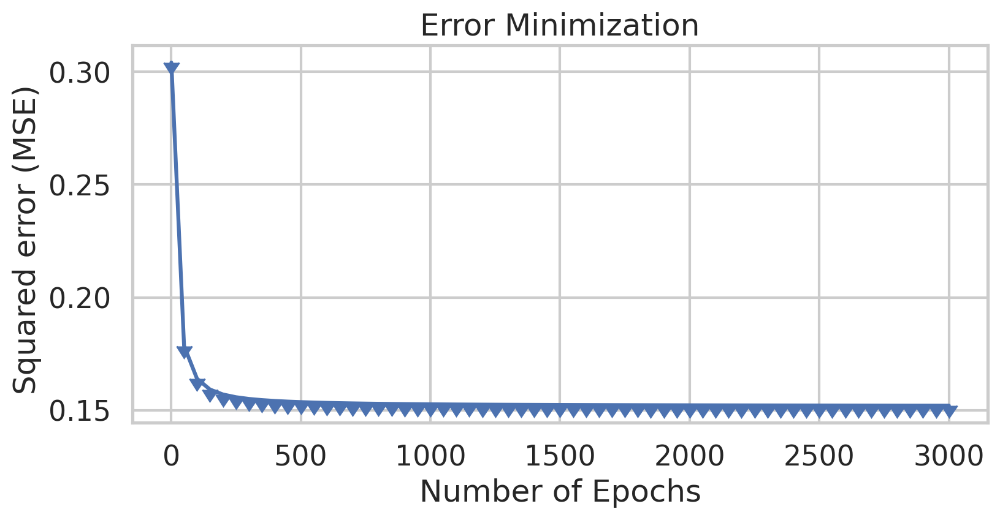

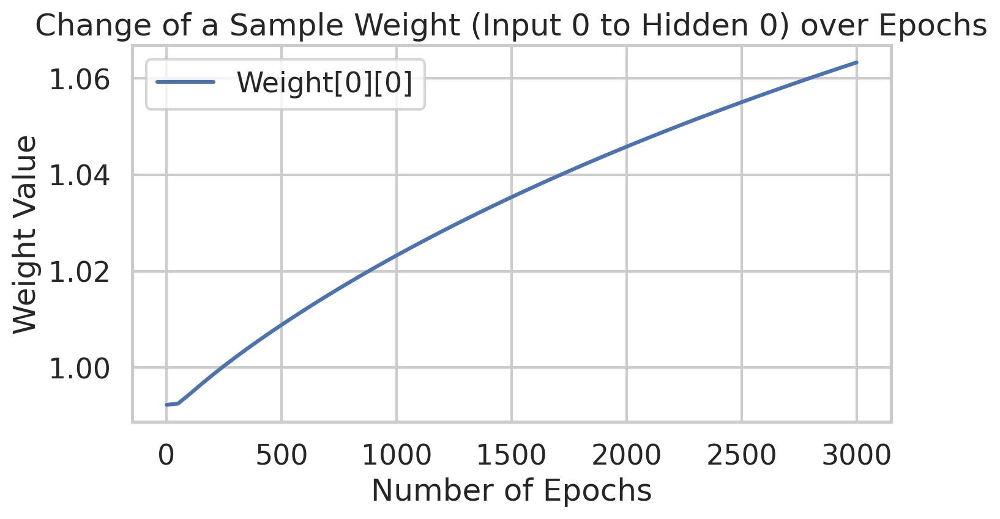

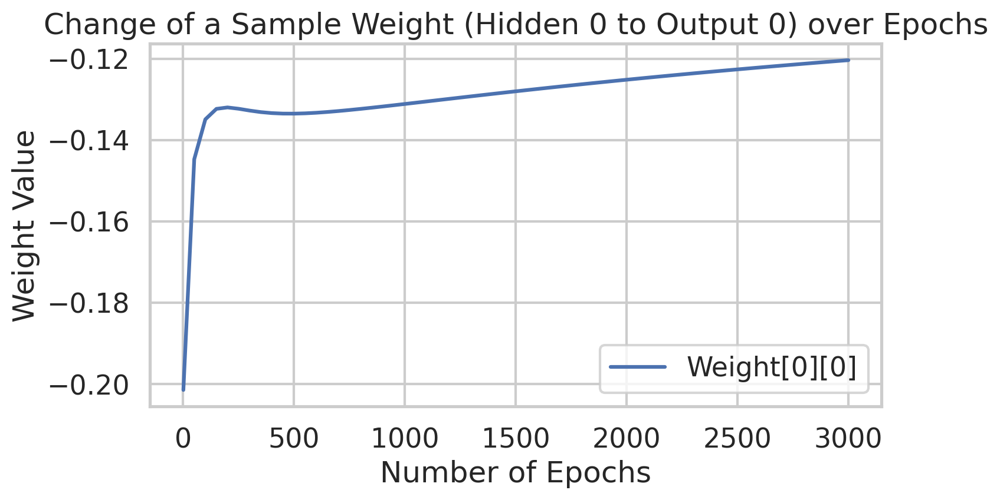

Overall accuracy: 66.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 0.00%


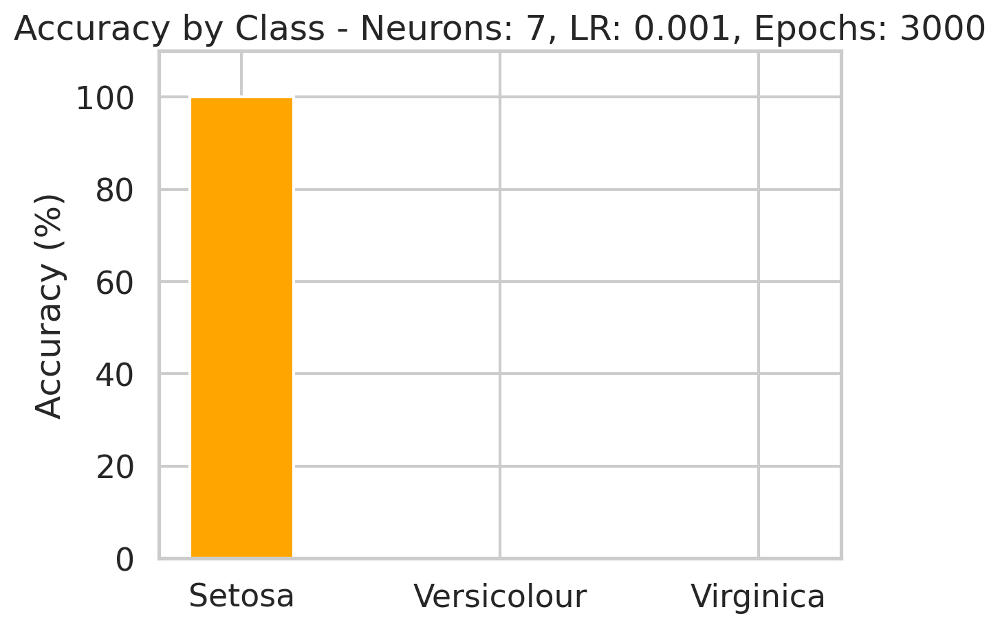

Epoch  1 - Total Error:  0.23557116930411587
Epoch  50 - Total Error:  0.16673896886073525
Epoch  100 - Total Error:  0.15073937621929948
Epoch  150 - Total Error:  0.1414098634631046
Epoch  200 - Total Error:  0.13312495304380606
Epoch  250 - Total Error:  0.12463444818239243
Epoch  300 - Total Error:  0.11592748867337367
Epoch  350 - Total Error:  0.10733248842827875
Epoch  400 - Total Error:  0.09918663454987896
Epoch  450 - Total Error:  0.09171284049160015
Epoch  500 - Total Error:  0.08500880170183756
Epoch  550 - Total Error:  0.07908050686659092
Epoch  600 - Total Error:  0.07388047537592532
Epoch  650 - Total Error:  0.06933638005035234
Epoch  700 - Total Error:  0.06536876465108812
Epoch  750 - Total Error:  0.06190063596049096
Epoch  800 - Total Error:  0.05886194000966394
Epoch  850 - Total Error:  0.05619112755702969
Epoch  900 - Total Error:  0.053835199829637206
Epoch  950 - Total Error:  0.05174904204771148
Epoch  1000 - Total Error:  0.04989448585594439
Epoch  1050 - T

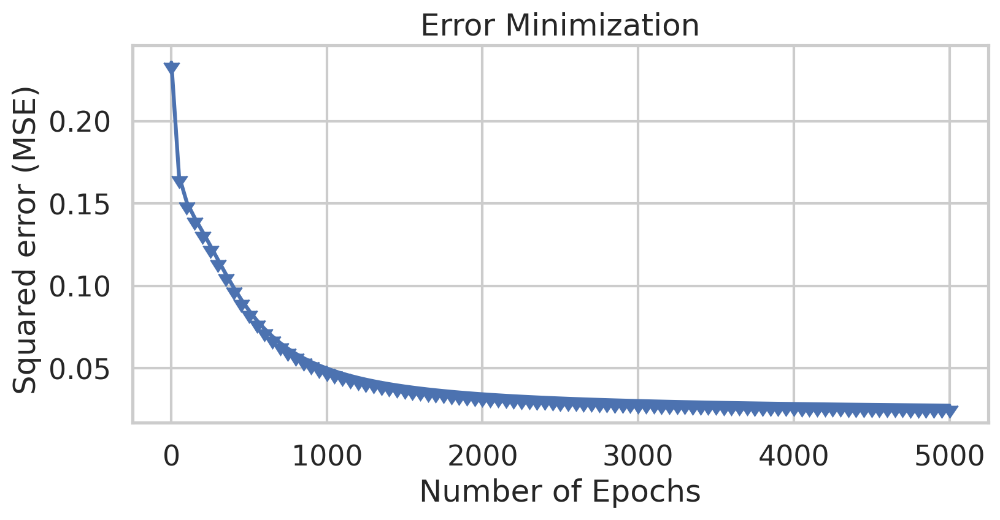

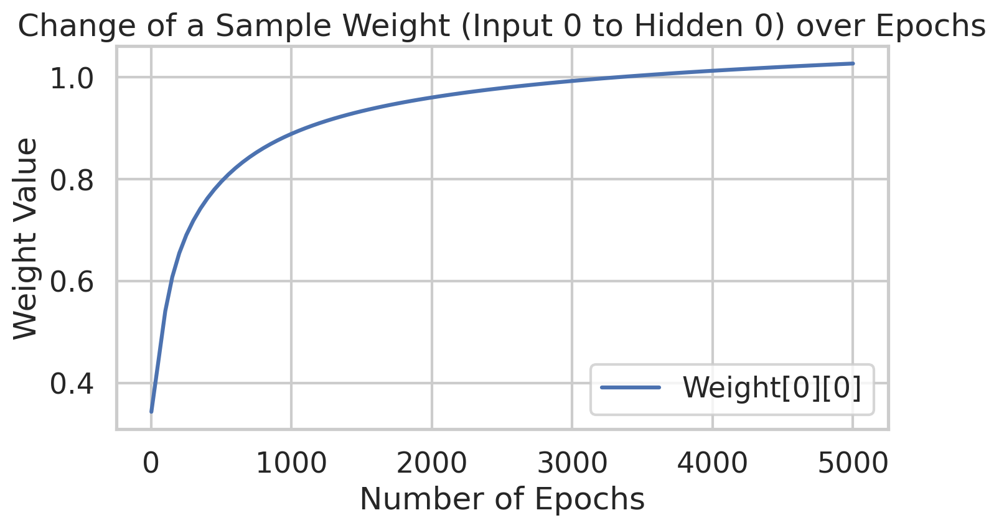

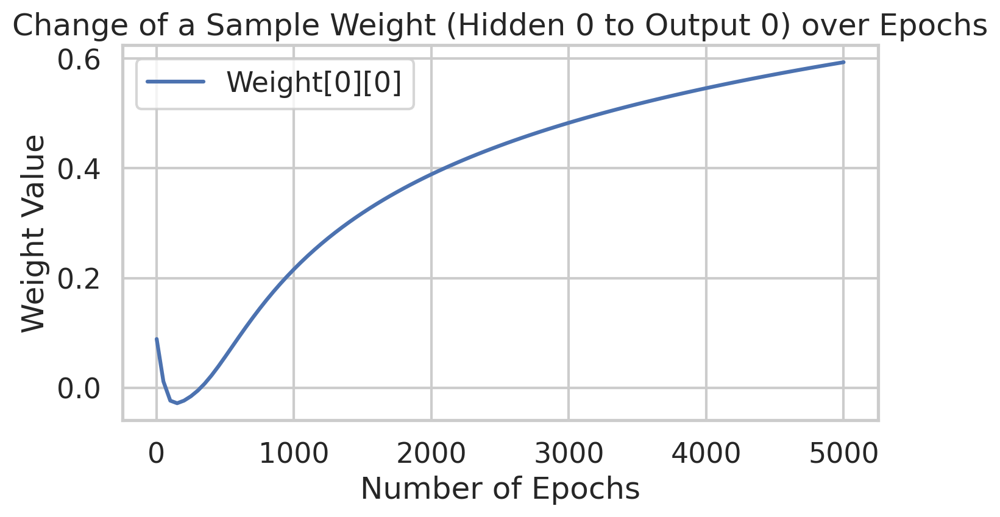

Overall accuracy: 90.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 77.78%
 - Accuracy Virginica: 0.00%


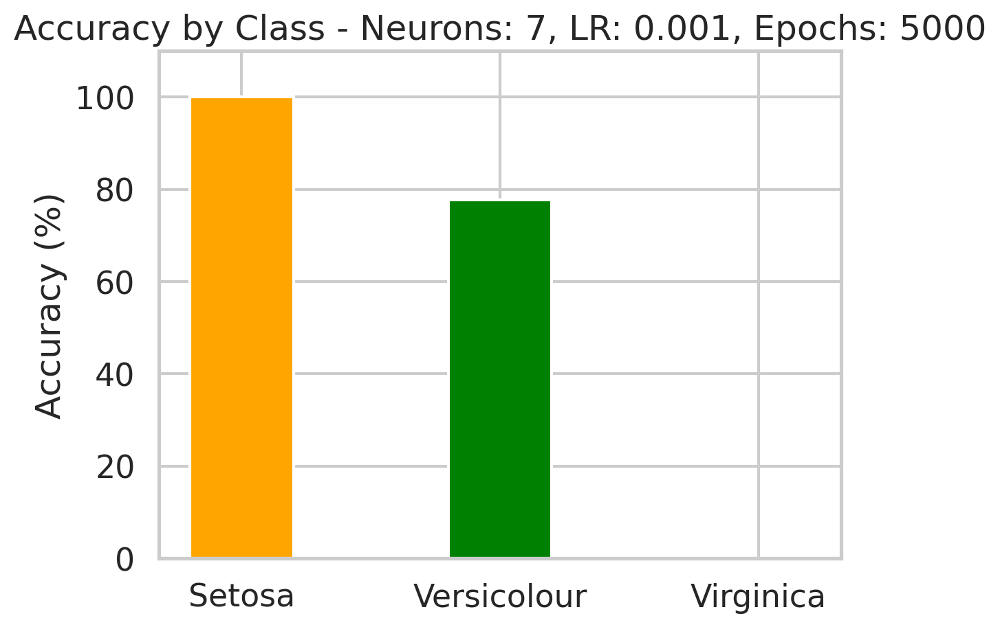

Epoch  1 - Total Error:  0.2152390507707354
Epoch  50 - Total Error:  0.08099817870604203
Epoch  100 - Total Error:  0.052267137122575115
Epoch  150 - Total Error:  0.040206063005167686
Epoch  200 - Total Error:  0.03468717568495351
Epoch  250 - Total Error:  0.03175839703535995
Epoch  300 - Total Error:  0.030010510899926384
Epoch  350 - Total Error:  0.0288739855819335
Epoch  400 - Total Error:  0.02808653344044004
Epoch  450 - Total Error:  0.027513902012347418
Epoch  500 - Total Error:  0.027081420804521767
Epoch  550 - Total Error:  0.0267447265331665
Epoch  600 - Total Error:  0.02647601989567344
Epoch  650 - Total Error:  0.026257101655313128
Epoch  700 - Total Error:  0.026075614104994146


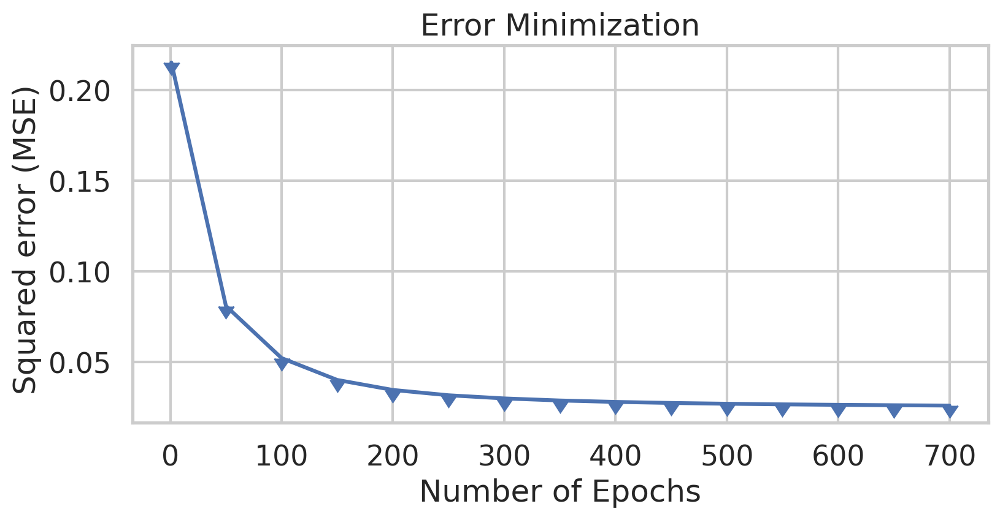

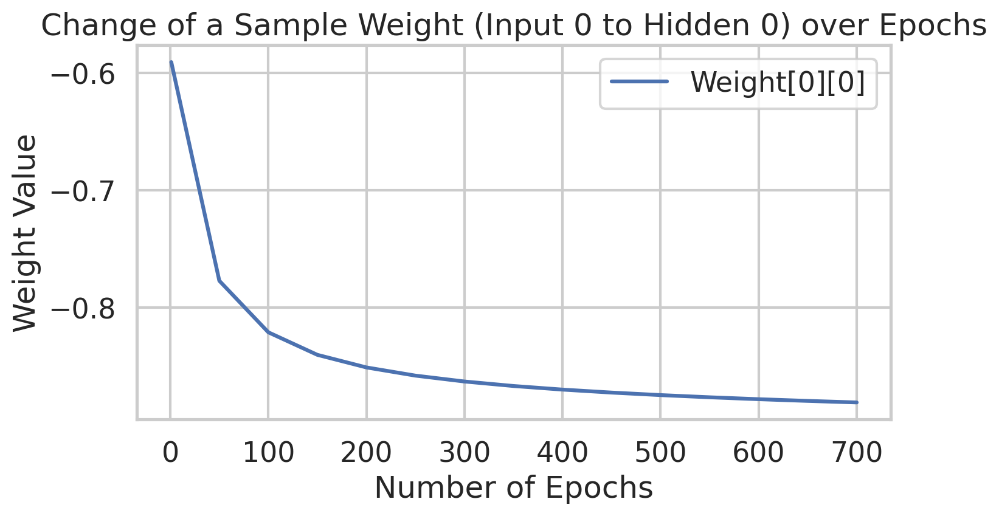

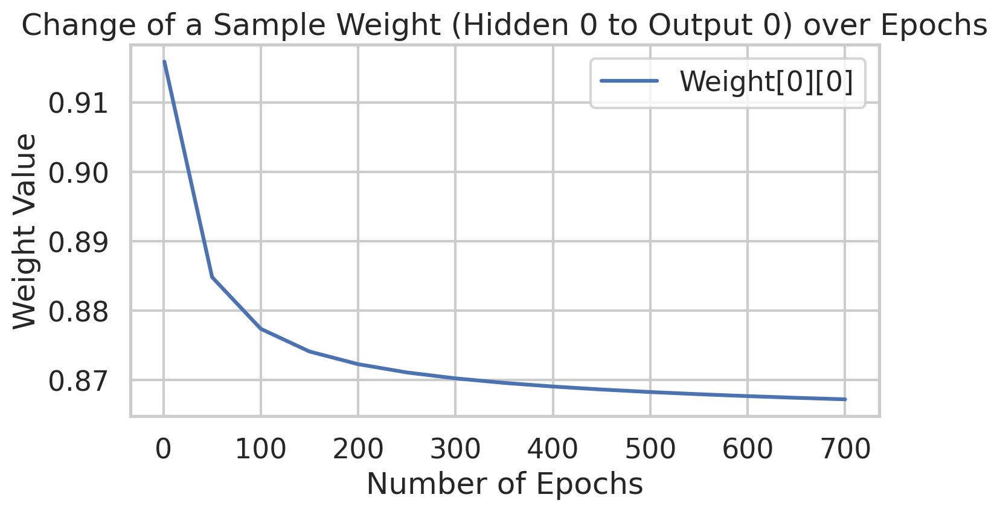

Overall accuracy: 93.33%
 - Accuracy Setosa: 95.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


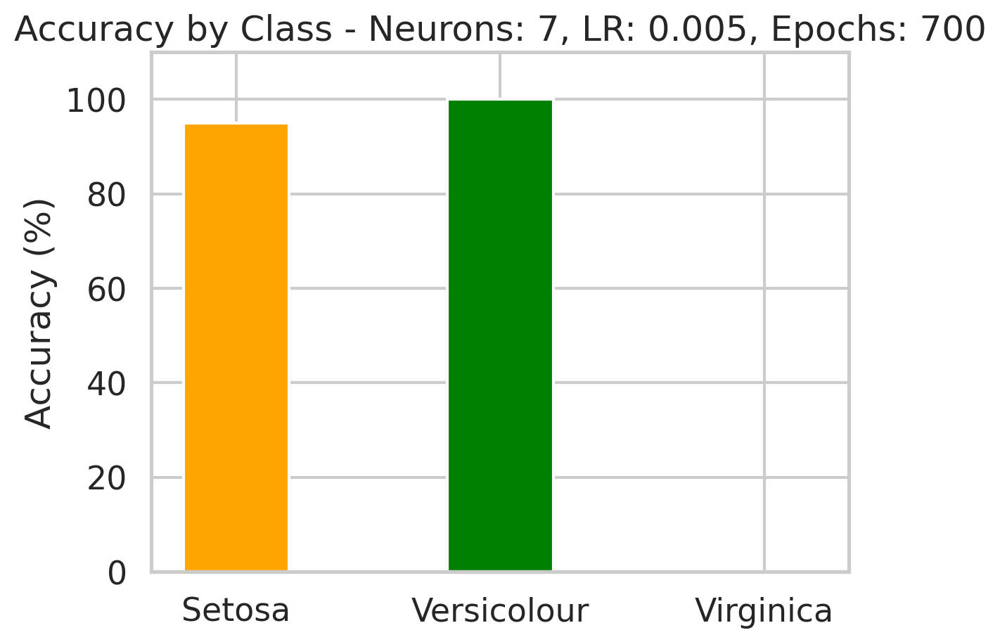

Epoch  1 - Total Error:  0.2748002111878554
Epoch  50 - Total Error:  0.09174627562359196
Epoch  100 - Total Error:  0.057963268715056686
Epoch  150 - Total Error:  0.04246811615036963
Epoch  200 - Total Error:  0.035384777430150546
Epoch  250 - Total Error:  0.03183047803976529
Epoch  300 - Total Error:  0.029761899531786873
Epoch  350 - Total Error:  0.028430307272312754
Epoch  400 - Total Error:  0.02750453276174712
Epoch  450 - Total Error:  0.02681951377759171
Epoch  500 - Total Error:  0.026284924987224897
Epoch  550 - Total Error:  0.02584776405228005
Epoch  600 - Total Error:  0.02547538199943079
Epoch  650 - Total Error:  0.02514699653048418
Epoch  700 - Total Error:  0.024849038632964938
Epoch  750 - Total Error:  0.024572405672730405
Epoch  800 - Total Error:  0.024310770288858762
Epoch  850 - Total Error:  0.024059531446603354
Epoch  900 - Total Error:  0.02381517568604005
Epoch  950 - Total Error:  0.023574899768634916
Epoch  1000 - Total Error:  0.02333639365579989


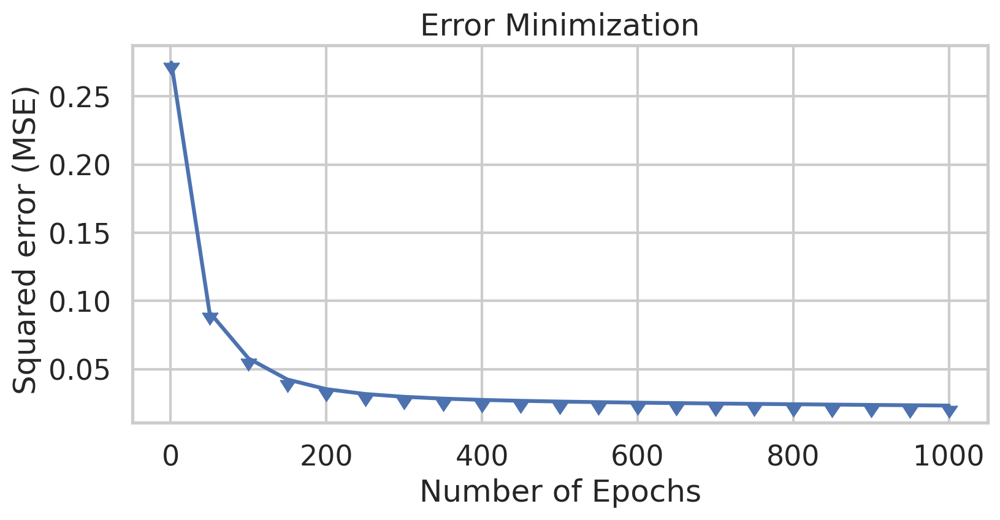

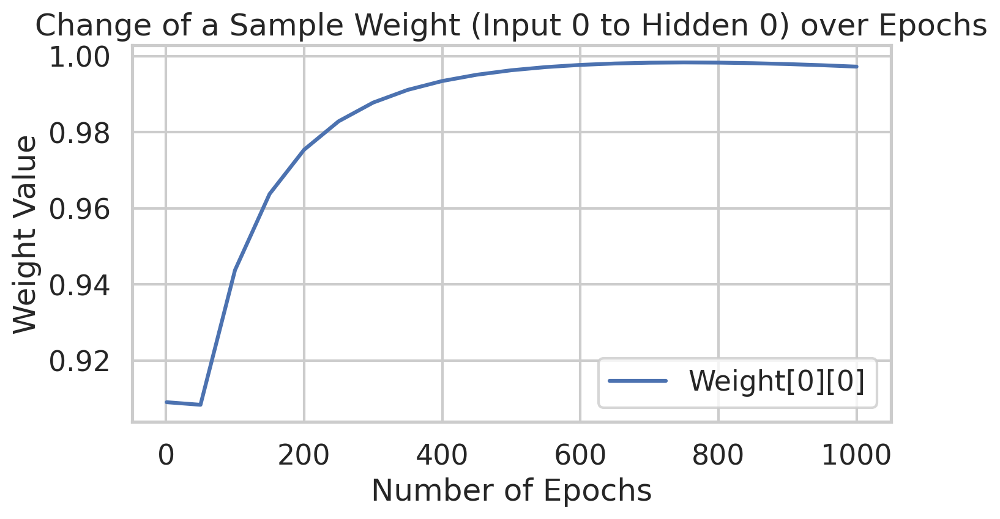

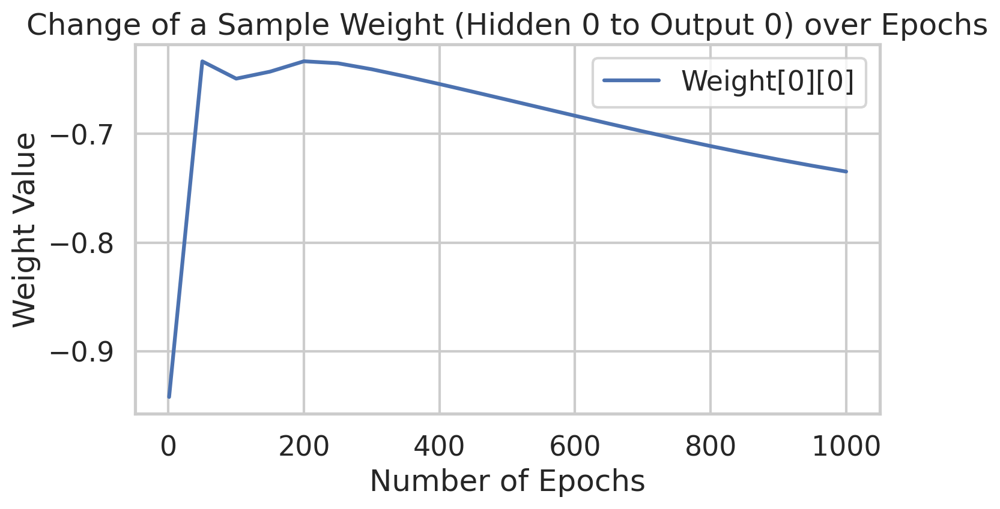

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


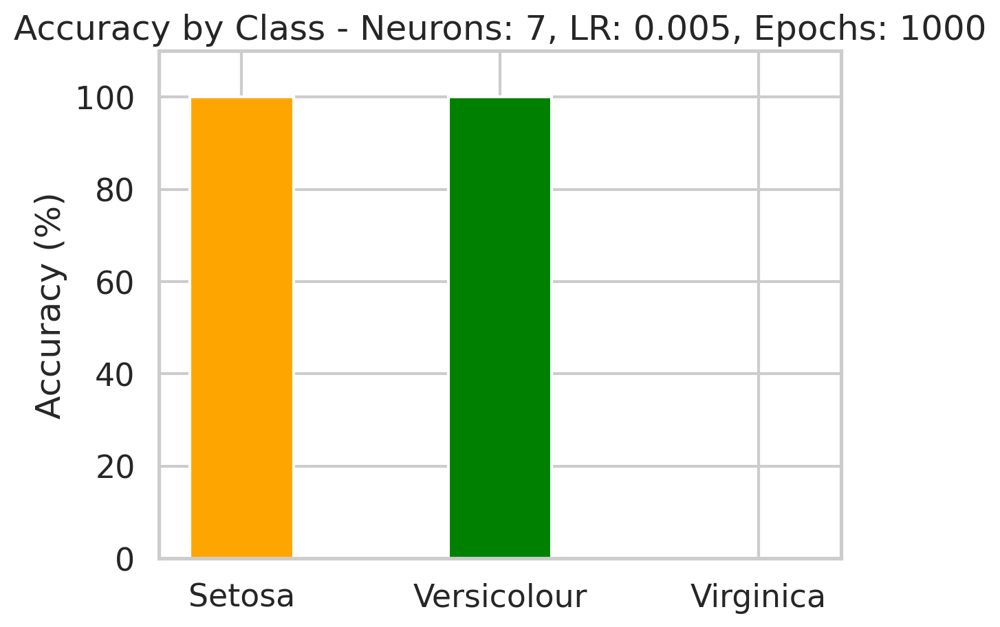

Epoch  1 - Total Error:  0.2469919155793775
Epoch  50 - Total Error:  0.08335058151252078
Epoch  100 - Total Error:  0.04575684893910363
Epoch  150 - Total Error:  0.035635195910966394
Epoch  200 - Total Error:  0.03164930021808519
Epoch  250 - Total Error:  0.02961867624538108
Epoch  300 - Total Error:  0.02840987552534692
Epoch  350 - Total Error:  0.02761164285457032
Epoch  400 - Total Error:  0.02704334273970331
Epoch  450 - Total Error:  0.026614393601382614
Epoch  500 - Total Error:  0.02627471168142959
Epoch  550 - Total Error:  0.025994427919763127
Epoch  600 - Total Error:  0.025754611274811153
Epoch  650 - Total Error:  0.02554264774914953
Epoch  700 - Total Error:  0.025349778403598984
Epoch  750 - Total Error:  0.02516971493722373
Epoch  800 - Total Error:  0.024997826037028714
Epoch  850 - Total Error:  0.024830640790453898
Epoch  900 - Total Error:  0.02466553477403015
Epoch  950 - Total Error:  0.024500524161568175
Epoch  1000 - Total Error:  0.024334124839915604
Epoch  

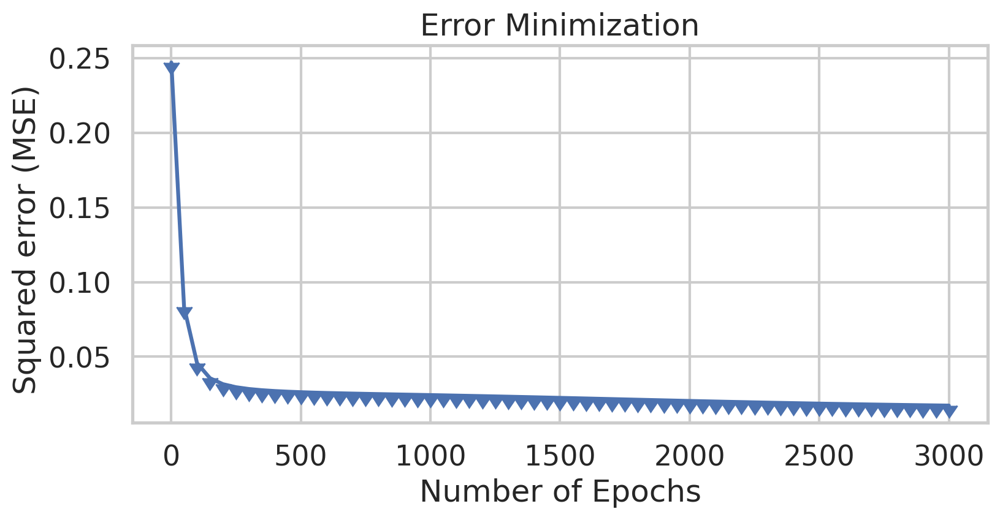

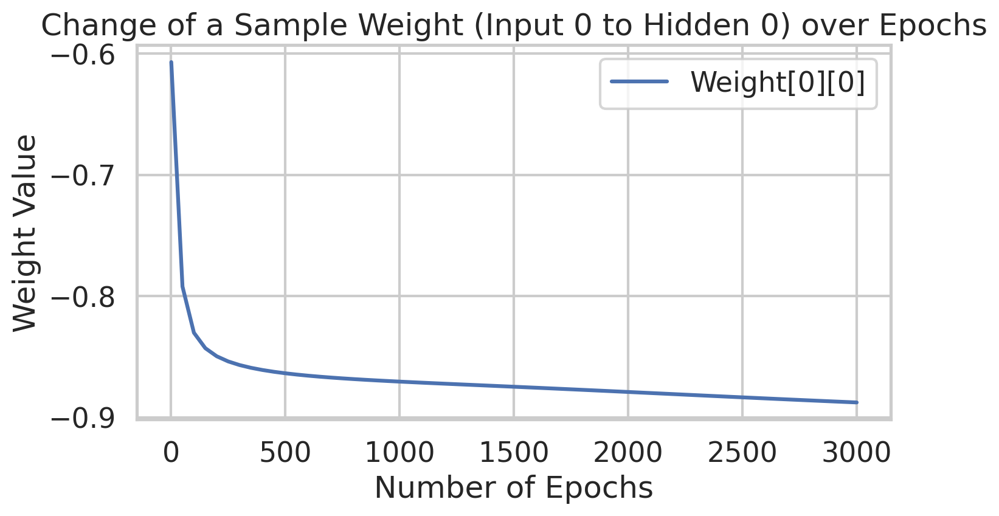

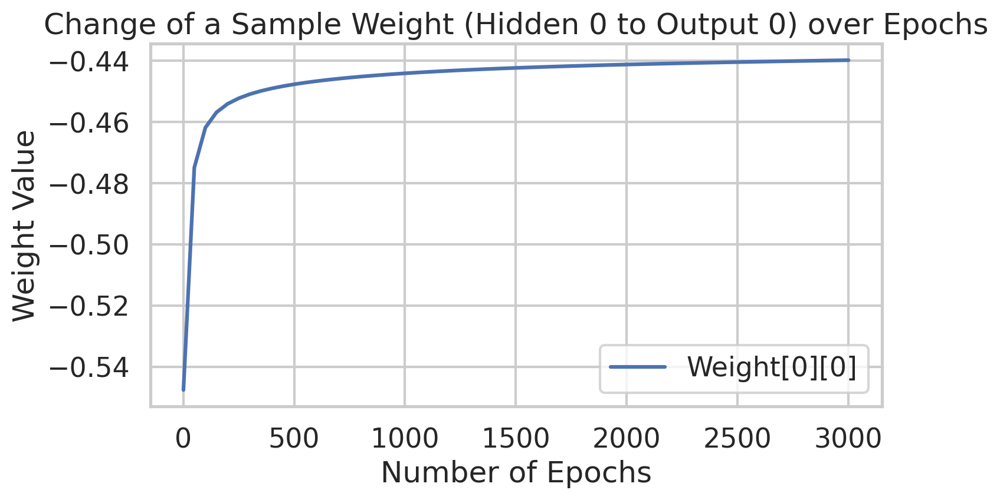

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


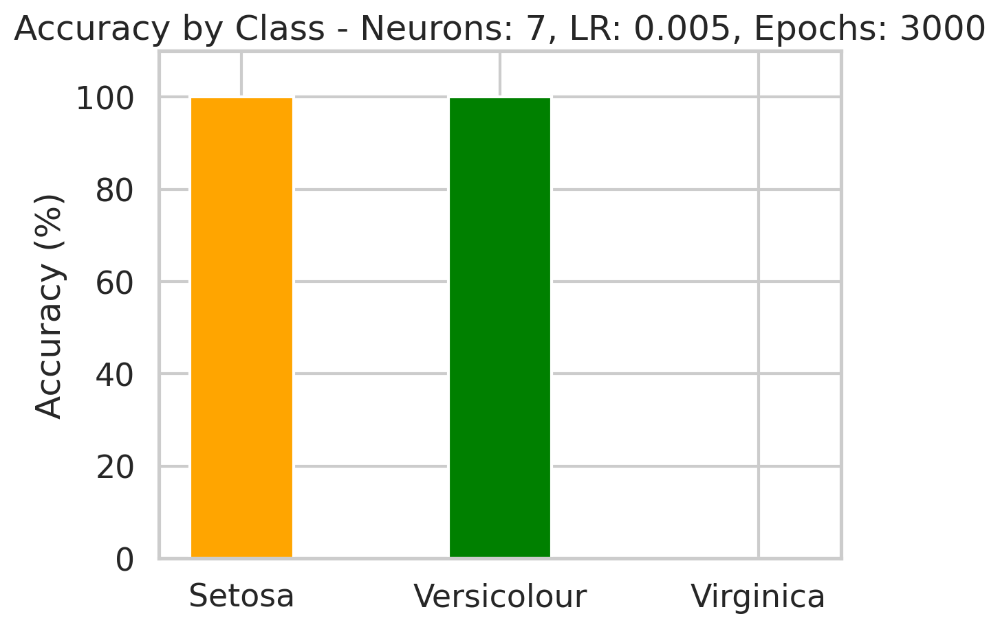

Epoch  1 - Total Error:  0.24147916237946335
Epoch  50 - Total Error:  0.0926387780640487
Epoch  100 - Total Error:  0.05595283810796496
Epoch  150 - Total Error:  0.04036539905070477
Epoch  200 - Total Error:  0.034153932570386715
Epoch  250 - Total Error:  0.03120717509223588
Epoch  300 - Total Error:  0.029563411185010855
Epoch  350 - Total Error:  0.028530800272596482
Epoch  400 - Total Error:  0.027824259111660705
Epoch  450 - Total Error:  0.02730996952398194
Epoch  500 - Total Error:  0.026918361790876158
Epoch  550 - Total Error:  0.02661015999160176
Epoch  600 - Total Error:  0.026361576821244417
Epoch  650 - Total Error:  0.02615728282951469
Epoch  700 - Total Error:  0.02598684908570907
Epoch  750 - Total Error:  0.02584285683380234
Epoch  800 - Total Error:  0.025719846143754225
Epoch  850 - Total Error:  0.025613700021880605
Epoch  900 - Total Error:  0.025521261070719472
Epoch  950 - Total Error:  0.02544007768140604
Epoch  1000 - Total Error:  0.02536822705528278
Epoch  

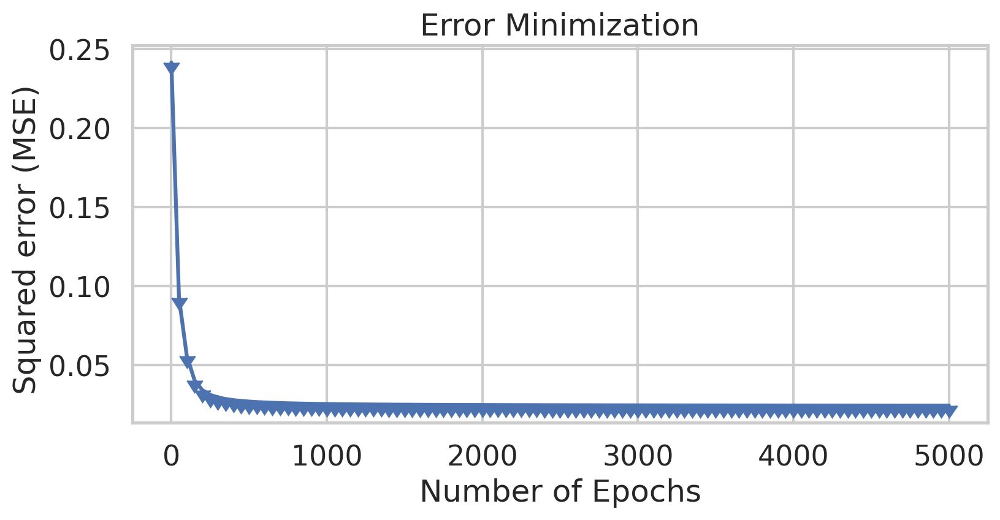

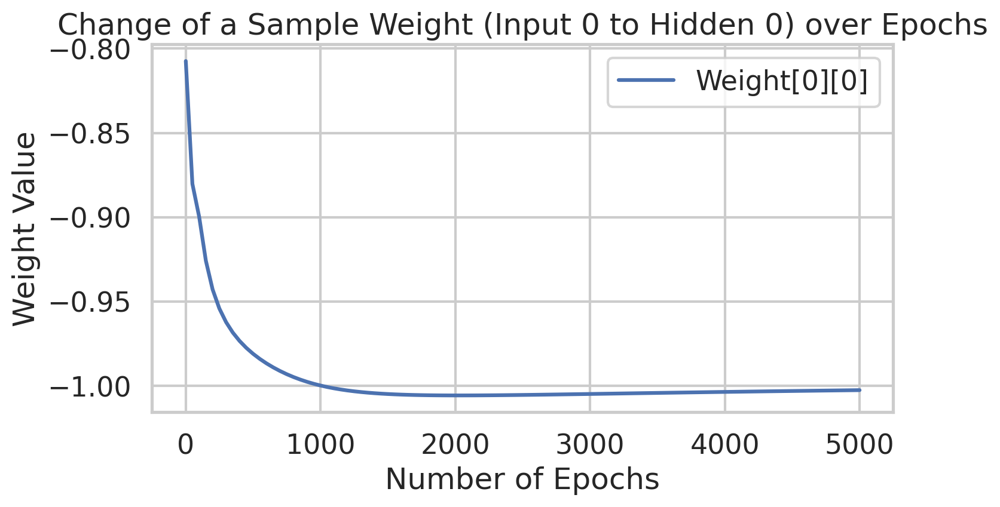

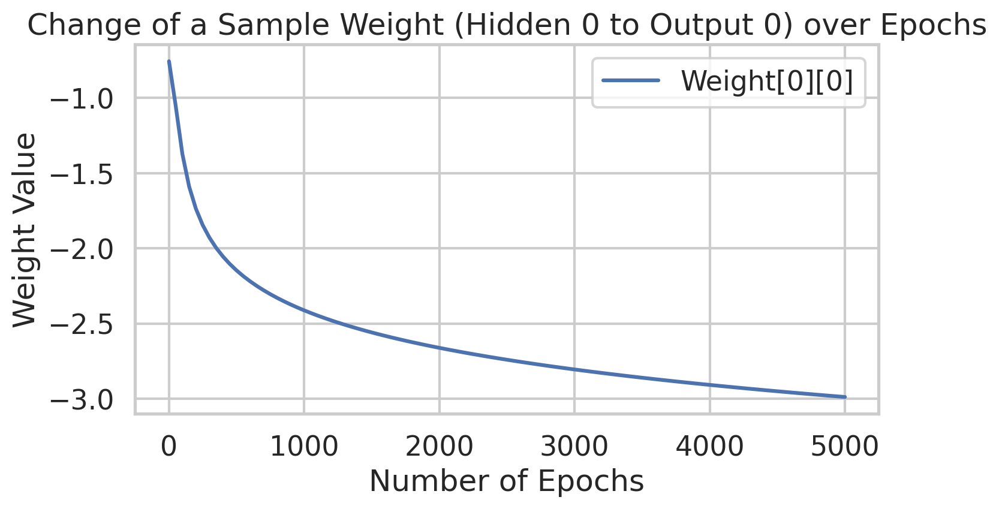

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


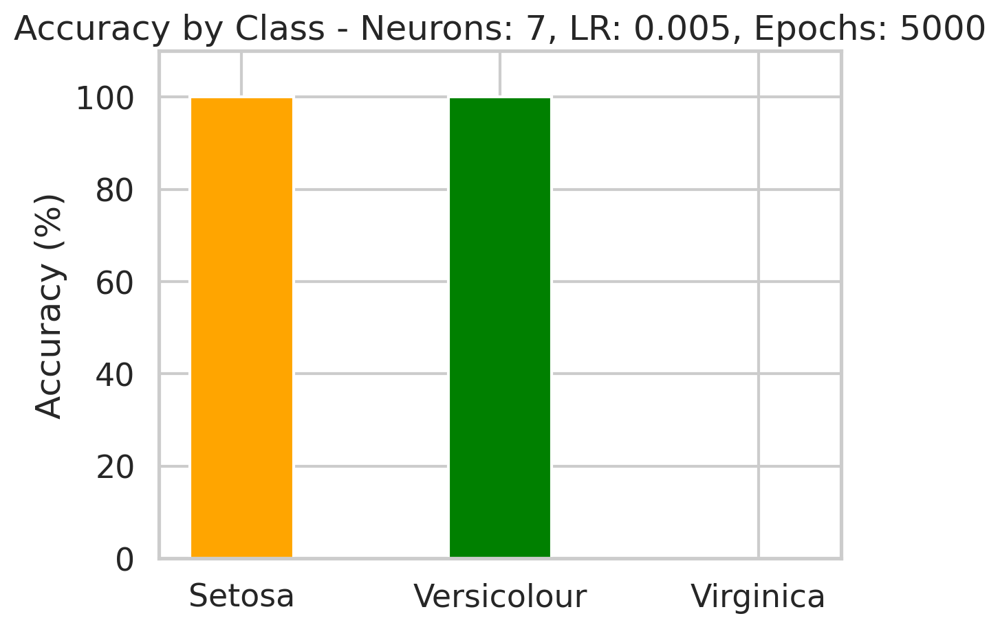

Epoch  1 - Total Error:  0.2533258681678606
Epoch  50 - Total Error:  0.11425401027005472
Epoch  100 - Total Error:  0.042661520850217335
Epoch  150 - Total Error:  0.03153195952947056
Epoch  200 - Total Error:  0.028467974745641743
Epoch  250 - Total Error:  0.027146971943315265
Epoch  300 - Total Error:  0.026431834663392488
Epoch  350 - Total Error:  0.0259891749235013
Epoch  400 - Total Error:  0.02568999559496773
Epoch  450 - Total Error:  0.02547484644551028
Epoch  500 - Total Error:  0.025312826937696525
Epoch  550 - Total Error:  0.02518639848855602
Epoch  600 - Total Error:  0.025084912974863198
Epoch  650 - Total Error:  0.025001551199990882
Epoch  700 - Total Error:  0.024931751796148444


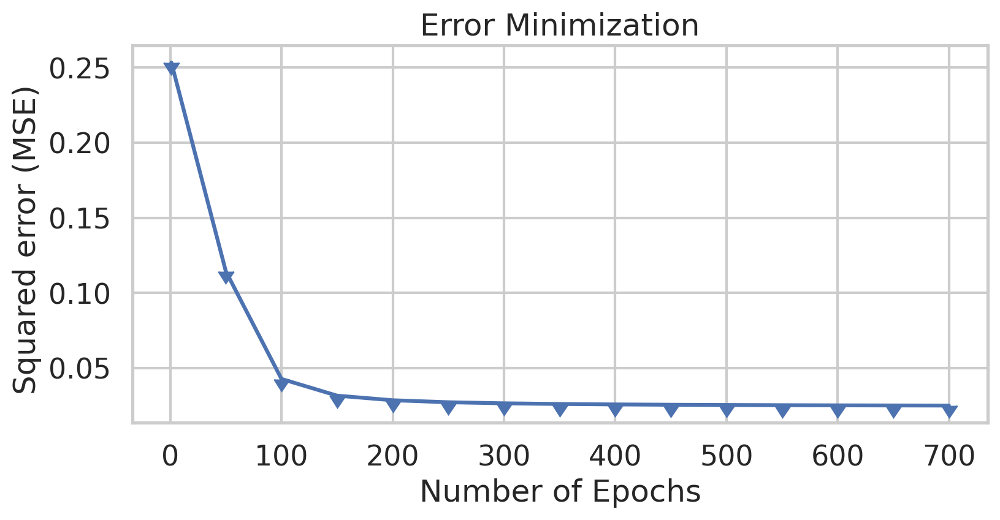

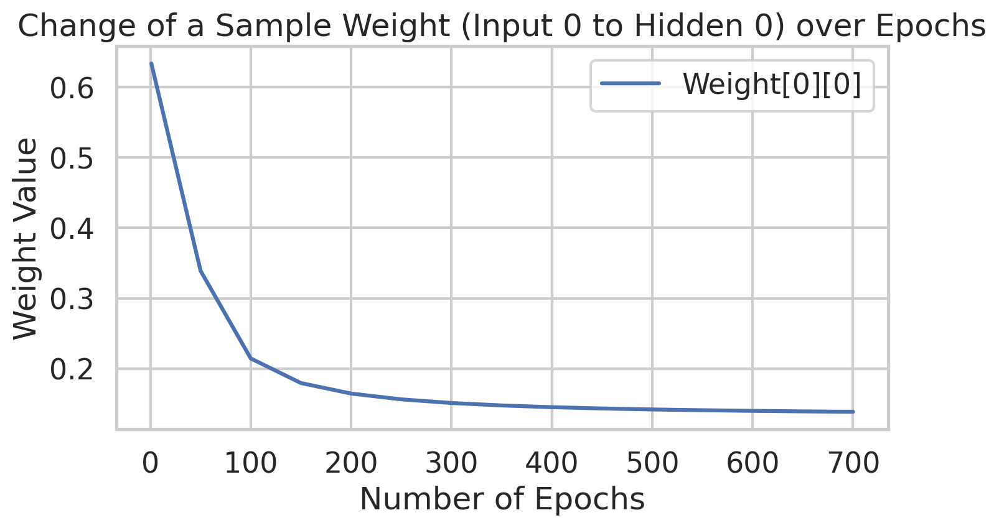

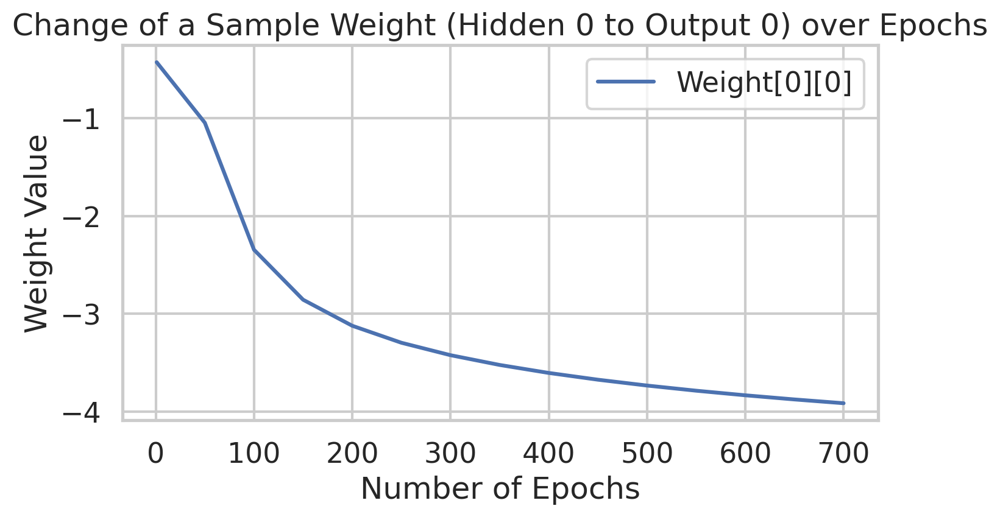

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


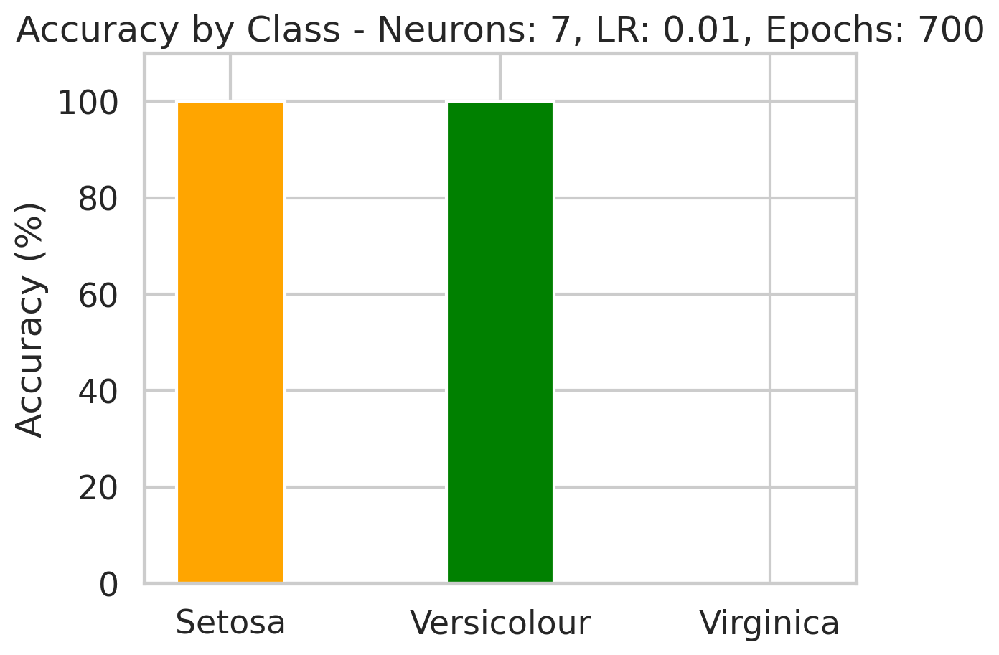

Epoch  1 - Total Error:  0.31086126302594536
Epoch  50 - Total Error:  0.07974964571119304
Epoch  100 - Total Error:  0.042976124145613456
Epoch  150 - Total Error:  0.03350968712597517
Epoch  200 - Total Error:  0.030024815599400487
Epoch  250 - Total Error:  0.028330147111396857
Epoch  300 - Total Error:  0.02734642662939128
Epoch  350 - Total Error:  0.026694315022244498
Epoch  400 - Total Error:  0.02617216602236451
Epoch  450 - Total Error:  0.025585617376787786
Epoch  500 - Total Error:  0.025177822386714323
Epoch  550 - Total Error:  0.024876133786137886
Epoch  600 - Total Error:  0.024600544098170005
Epoch  650 - Total Error:  0.02433139669620643
Epoch  700 - Total Error:  0.02405706347557357
Epoch  750 - Total Error:  0.023767869046203285
Epoch  800 - Total Error:  0.023454143129611065
Epoch  850 - Total Error:  0.023105311096916954
Epoch  900 - Total Error:  0.022709686602057386
Epoch  950 - Total Error:  0.022254613987900875
Epoch  1000 - Total Error:  0.021726856136310806


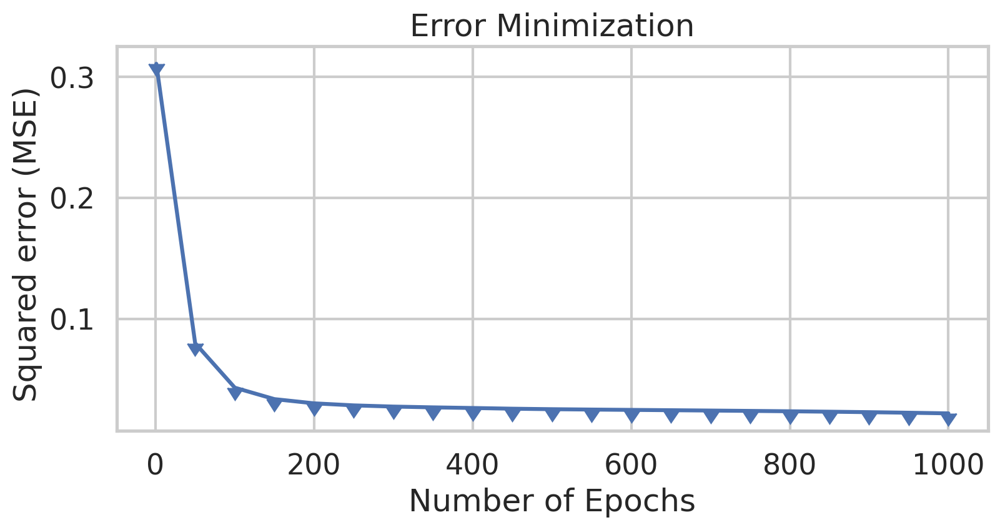

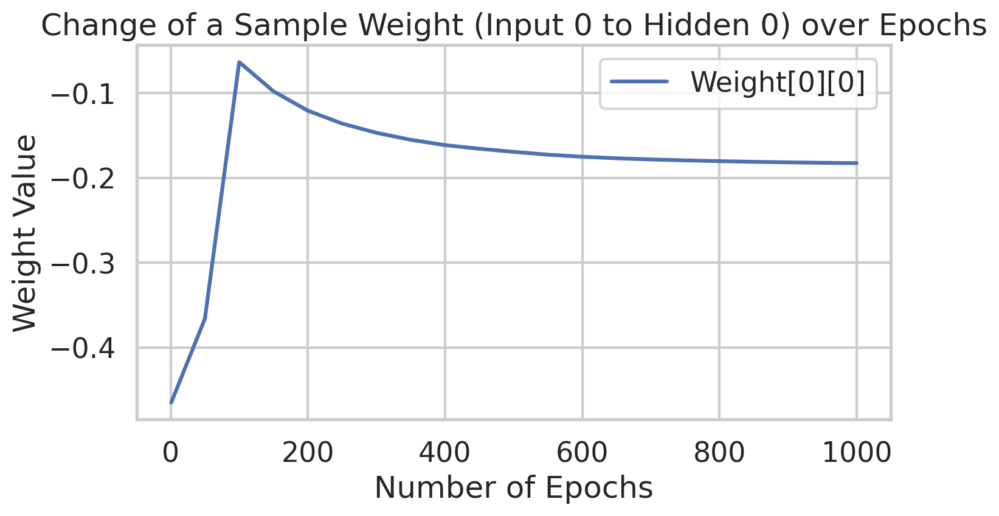

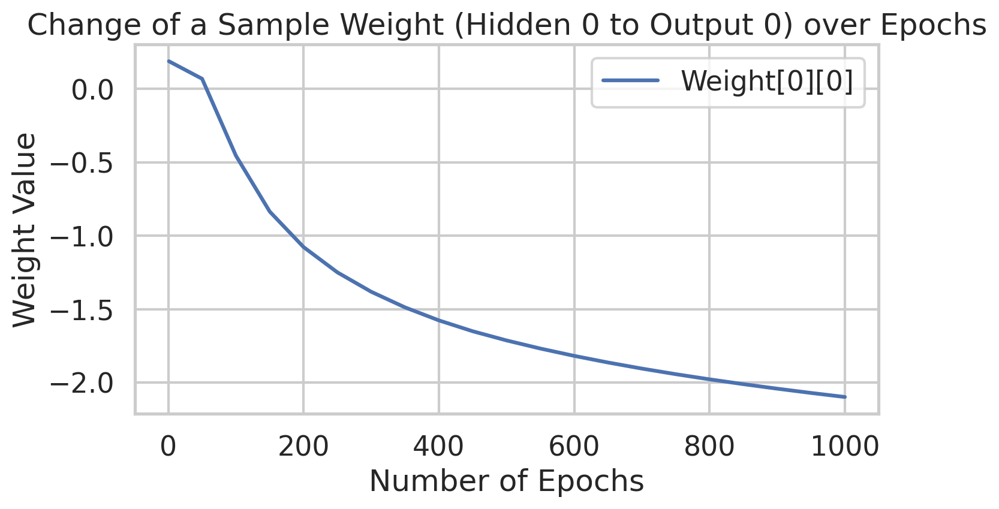

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


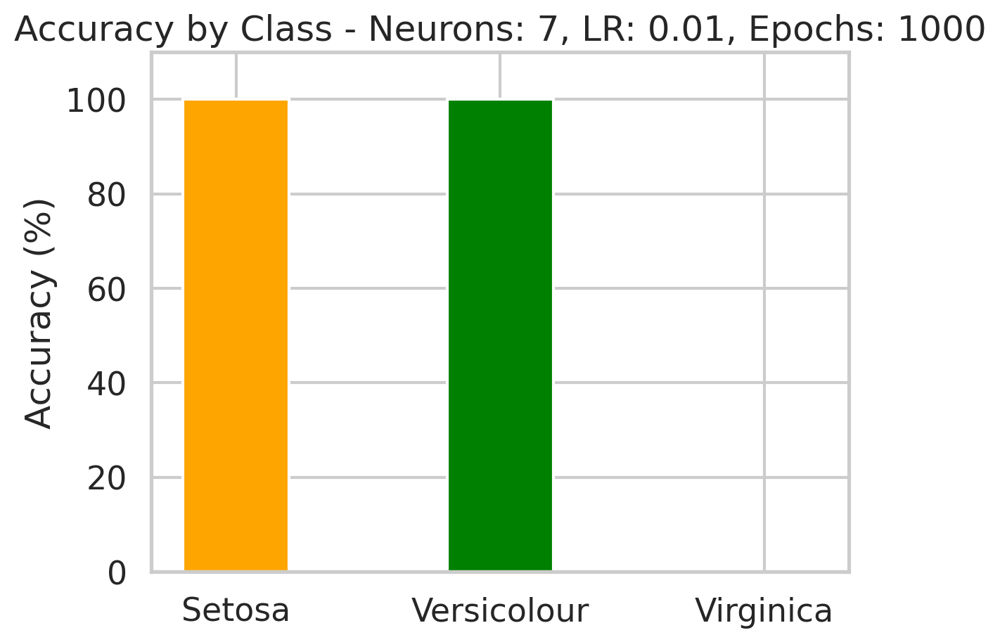

Epoch  1 - Total Error:  0.21068498510217112
Epoch  50 - Total Error:  0.05407446636101599
Epoch  100 - Total Error:  0.03253817334262952
Epoch  150 - Total Error:  0.02877794619431669
Epoch  200 - Total Error:  0.026588116683214147
Epoch  250 - Total Error:  0.02539787437734485
Epoch  300 - Total Error:  0.02470460418691206
Epoch  350 - Total Error:  0.02415528897208164
Epoch  400 - Total Error:  0.023657860216394985
Epoch  450 - Total Error:  0.02316468720840791
Epoch  500 - Total Error:  0.02264496210422803
Epoch  550 - Total Error:  0.022075408771856216
Epoch  600 - Total Error:  0.021437016206366635
Epoch  650 - Total Error:  0.02071456748429263
Epoch  700 - Total Error:  0.019897853236977712
Epoch  750 - Total Error:  0.018983874601246377
Epoch  800 - Total Error:  0.01797911748308282
Epoch  850 - Total Error:  0.01690064040869902
Epoch  900 - Total Error:  0.015774828944828942
Epoch  950 - Total Error:  0.014633590463343445
Epoch  1000 - Total Error:  0.01350910707494294
Epoch  

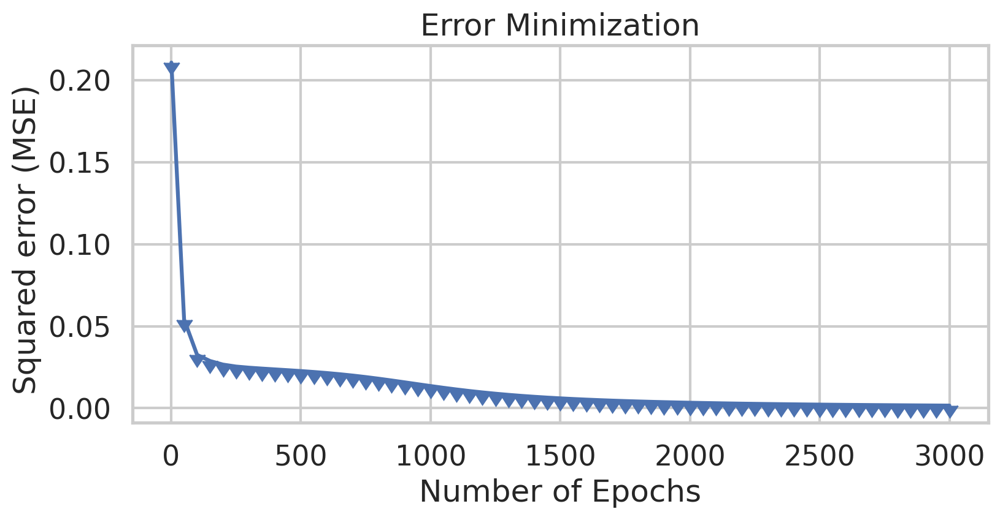

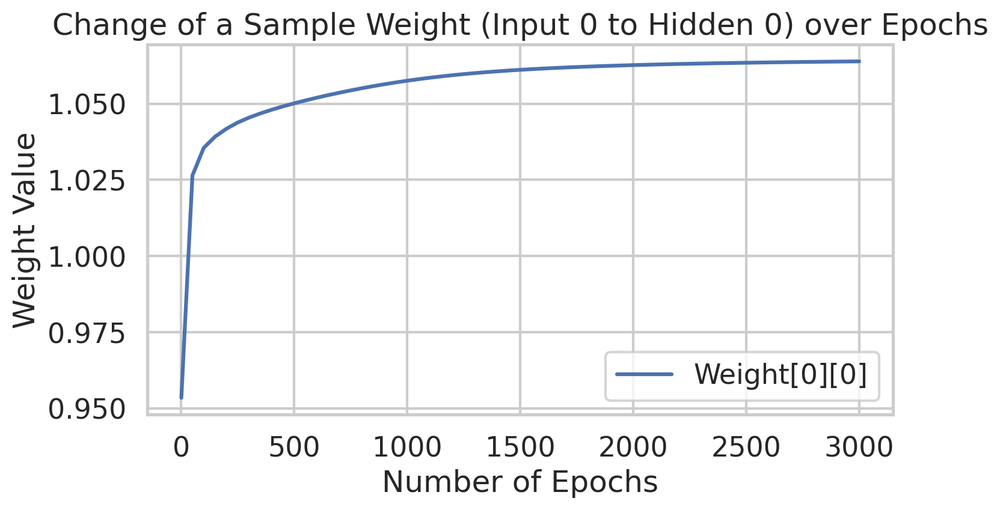

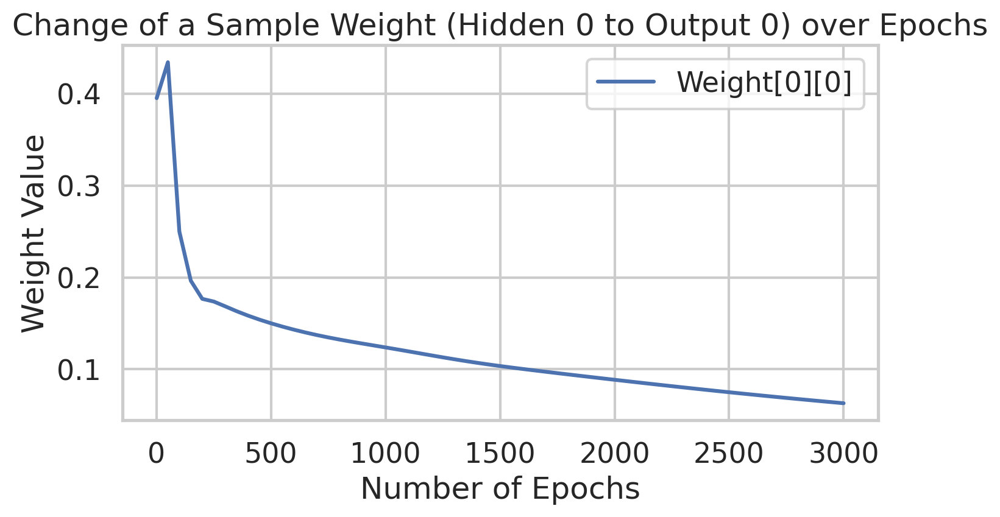

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


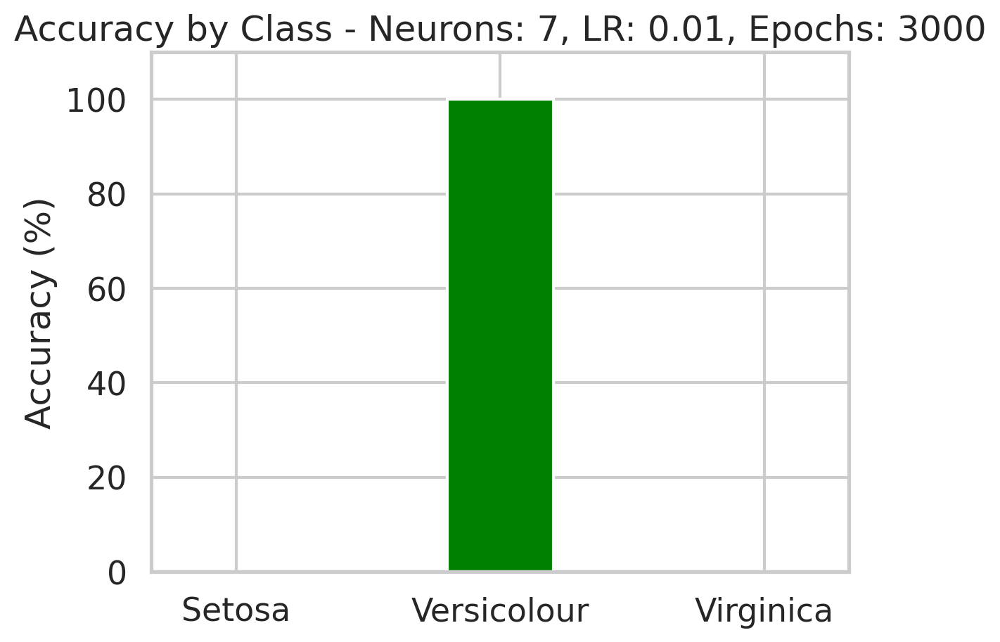

Epoch  1 - Total Error:  0.2419422966028402
Epoch  50 - Total Error:  0.051309213272214785
Epoch  100 - Total Error:  0.03255476640762565
Epoch  150 - Total Error:  0.02821108916564744
Epoch  200 - Total Error:  0.026419283504595947
Epoch  250 - Total Error:  0.02538784170689846
Epoch  300 - Total Error:  0.024658646605593283
Epoch  350 - Total Error:  0.02406887814912462
Epoch  400 - Total Error:  0.023546485072571212
Epoch  450 - Total Error:  0.02305367160881414
Epoch  500 - Total Error:  0.02256791464571759
Epoch  550 - Total Error:  0.02207478322188301
Epoch  600 - Total Error:  0.021564926629758334
Epoch  650 - Total Error:  0.021032594186707824
Epoch  700 - Total Error:  0.02047470121324322
Epoch  750 - Total Error:  0.019890061419768904
Epoch  800 - Total Error:  0.0192786395057389
Epoch  850 - Total Error:  0.018640744067578673
Epoch  900 - Total Error:  0.01797593242416258
Epoch  950 - Total Error:  0.017280341195673173
Epoch  1000 - Total Error:  0.016533035081370204
Epoch  

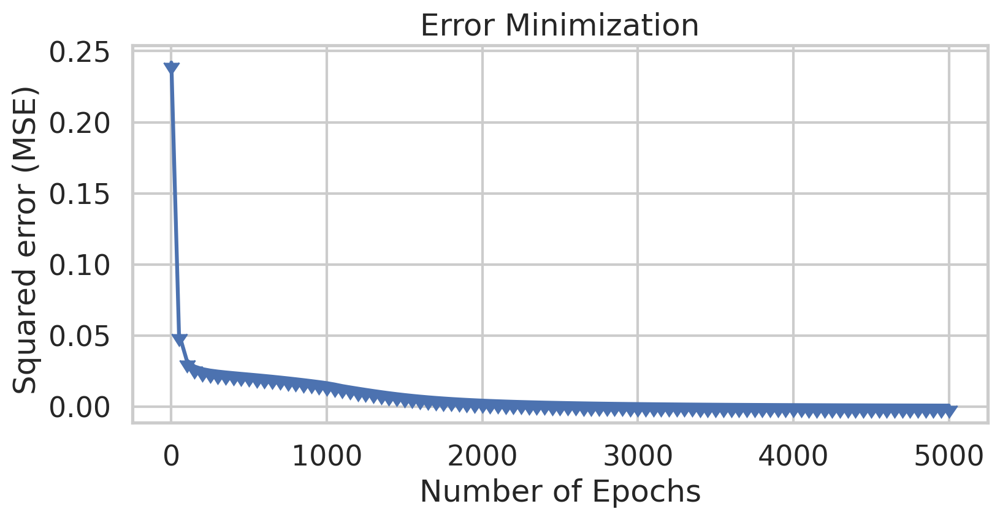

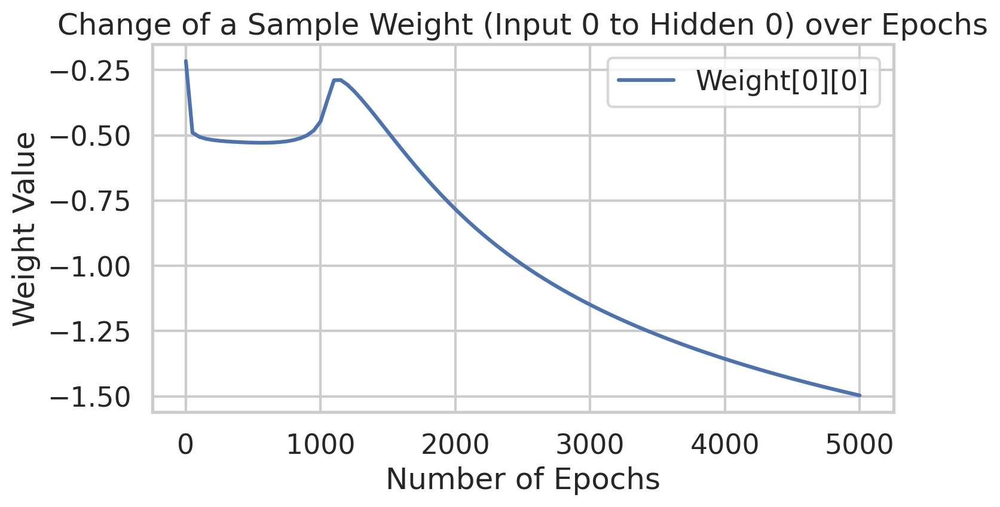

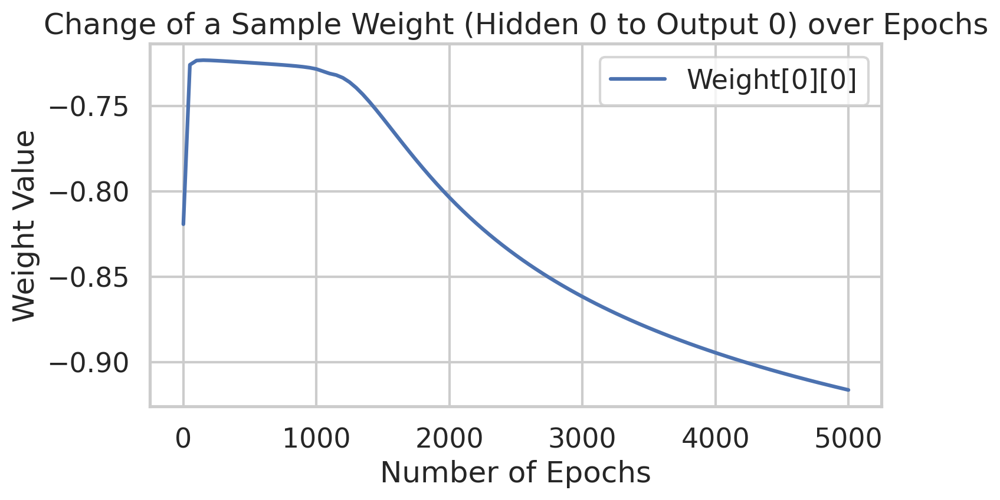

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%


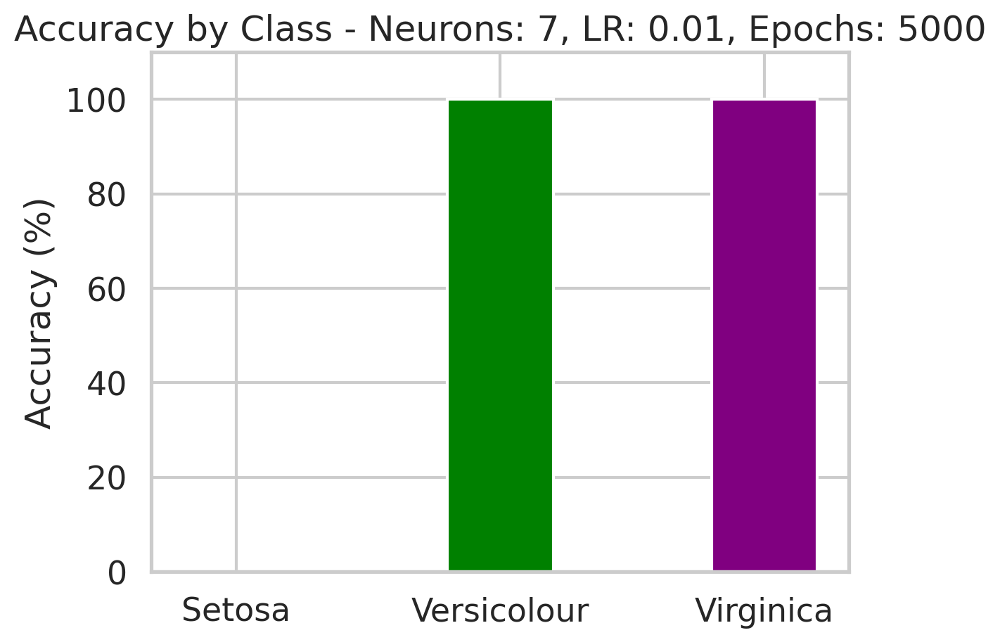

Epoch  1 - Total Error:  0.18257905653712564
Epoch  50 - Total Error:  0.02402534328782012
Epoch  100 - Total Error:  0.019451933954068946
Epoch  150 - Total Error:  0.015470674189634307
Epoch  200 - Total Error:  0.009831734888025044
Epoch  250 - Total Error:  0.0055143455533334055
Epoch  300 - Total Error:  0.003490193700247884
Epoch  350 - Total Error:  0.0023767685289692096
Epoch  400 - Total Error:  0.0017318877059236443
Epoch  450 - Total Error:  0.0013344574139982684
Epoch  500 - Total Error:  0.0010755841426584145
Epoch  550 - Total Error:  0.000897541026231383
Epoch  600 - Total Error:  0.0007686462717570033
Epoch  650 - Total Error:  0.0006712985129925889
Epoch  700 - Total Error:  0.0005952762759388532


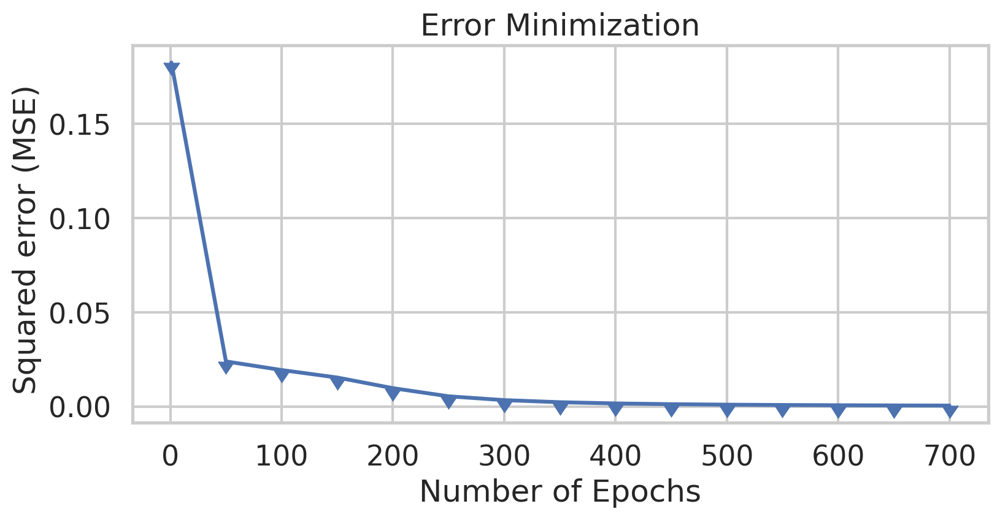

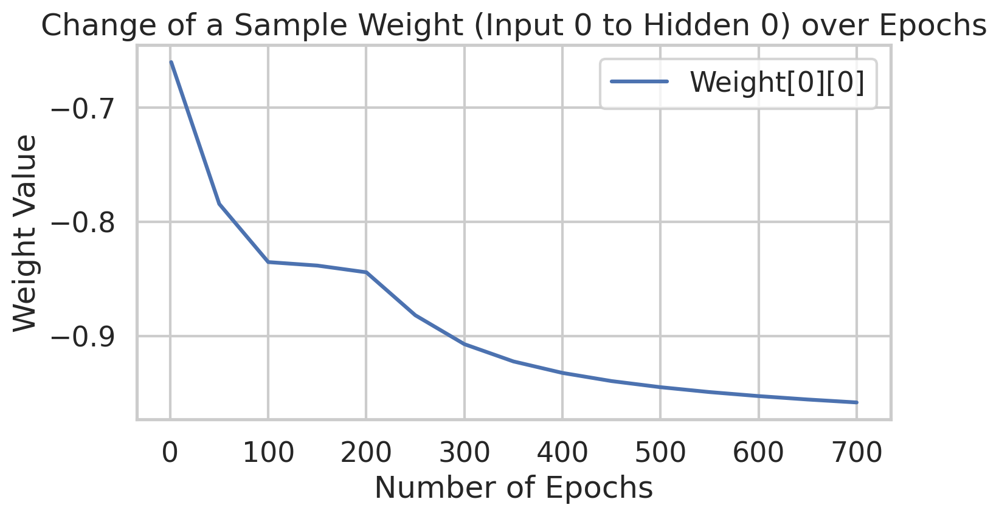

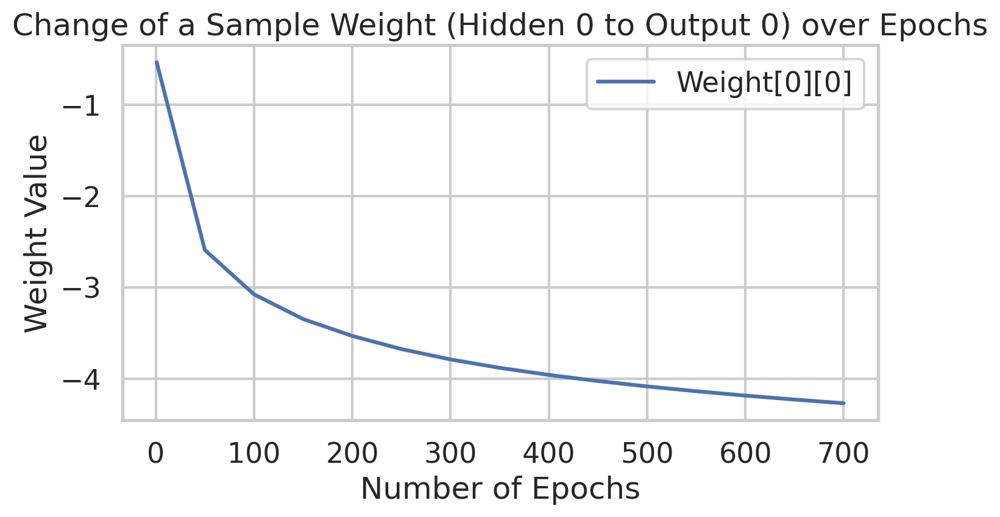

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 88.89%
 - Accuracy Virginica: 100.00%


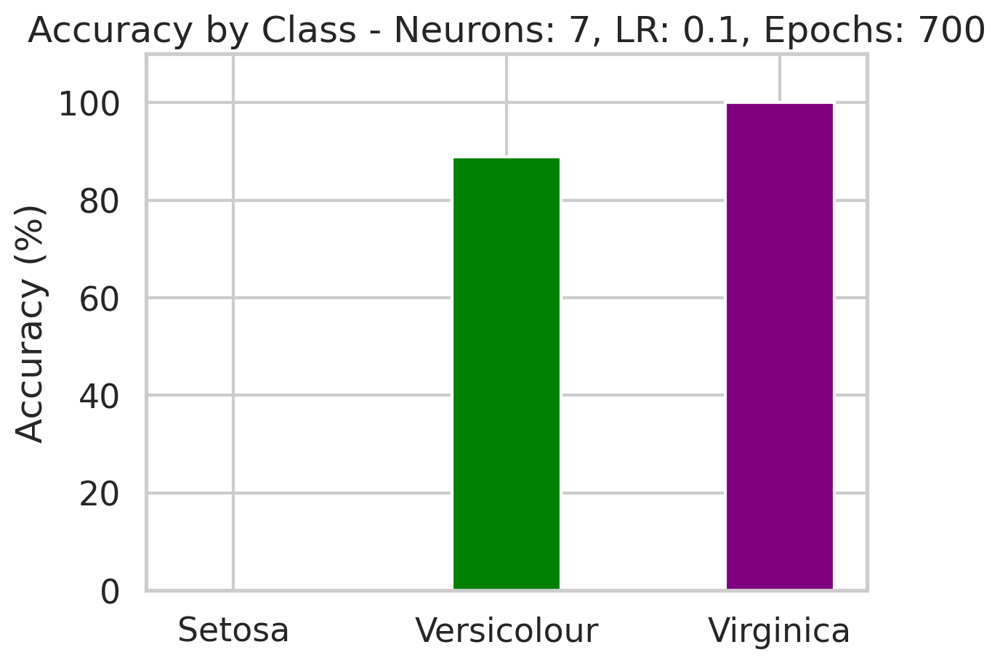

Epoch  1 - Total Error:  0.18427408928397498
Epoch  50 - Total Error:  0.02708562822845363
Epoch  100 - Total Error:  0.02584305915057716
Epoch  150 - Total Error:  0.024826581869461482
Epoch  200 - Total Error:  0.02462099893369182
Epoch  250 - Total Error:  0.02451471484470842
Epoch  300 - Total Error:  0.024436614218380906
Epoch  350 - Total Error:  0.02435658947984016
Epoch  400 - Total Error:  0.024221248753672705
Epoch  450 - Total Error:  0.02379822570336952
Epoch  500 - Total Error:  0.02210225432548304
Epoch  550 - Total Error:  0.015973568828818598
Epoch  600 - Total Error:  0.00841314109607189
Epoch  650 - Total Error:  0.005019760465800142
Epoch  700 - Total Error:  0.003349118675515927
Epoch  750 - Total Error:  0.0023339888813694036
Epoch  800 - Total Error:  0.001719989401320399
Epoch  850 - Total Error:  0.0013341973557355227
Epoch  900 - Total Error:  0.0010794317125435893
Epoch  950 - Total Error:  0.0009027217685551419
Epoch  1000 - Total Error:  0.000774181322462306

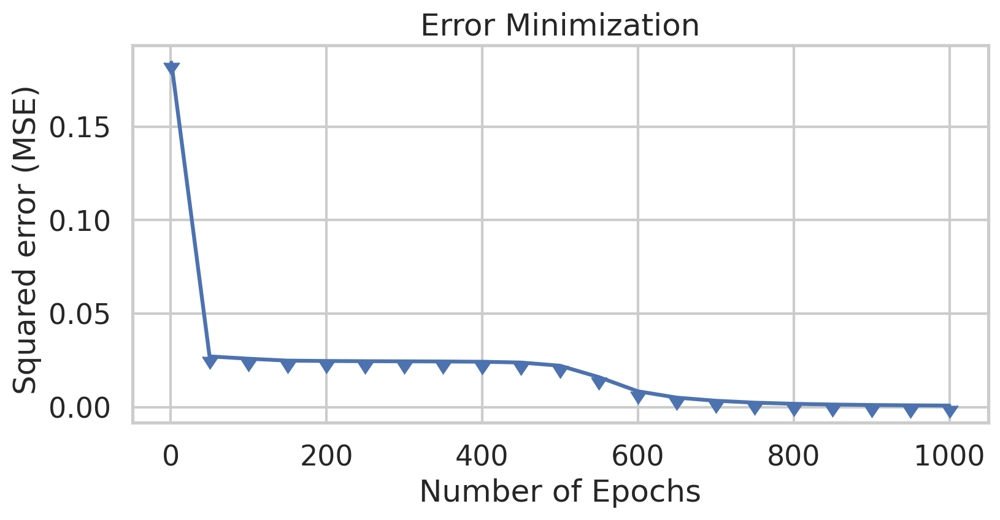

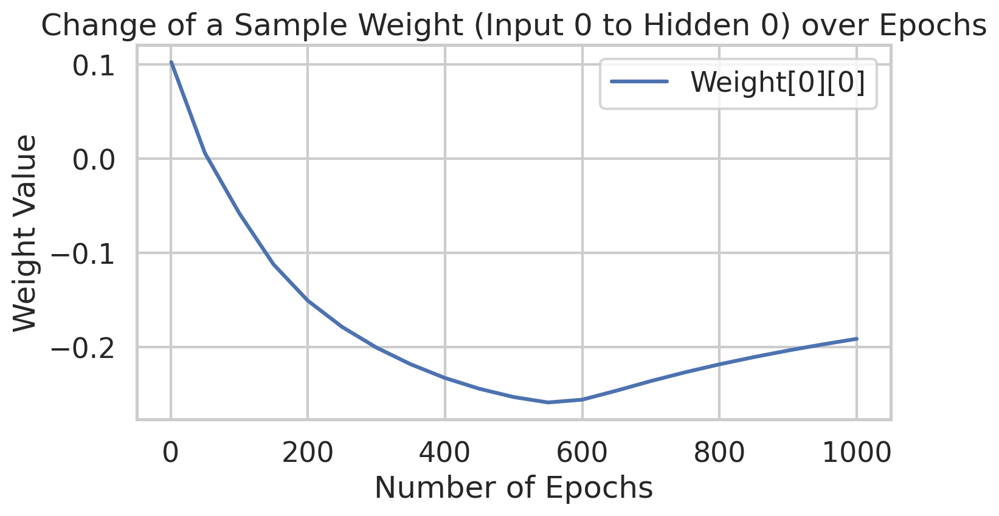

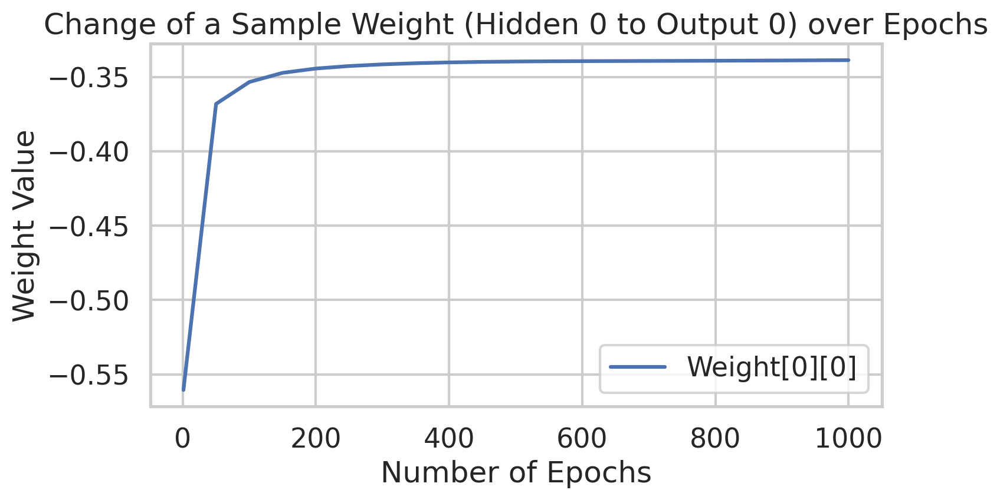

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 88.89%
 - Accuracy Virginica: 100.00%


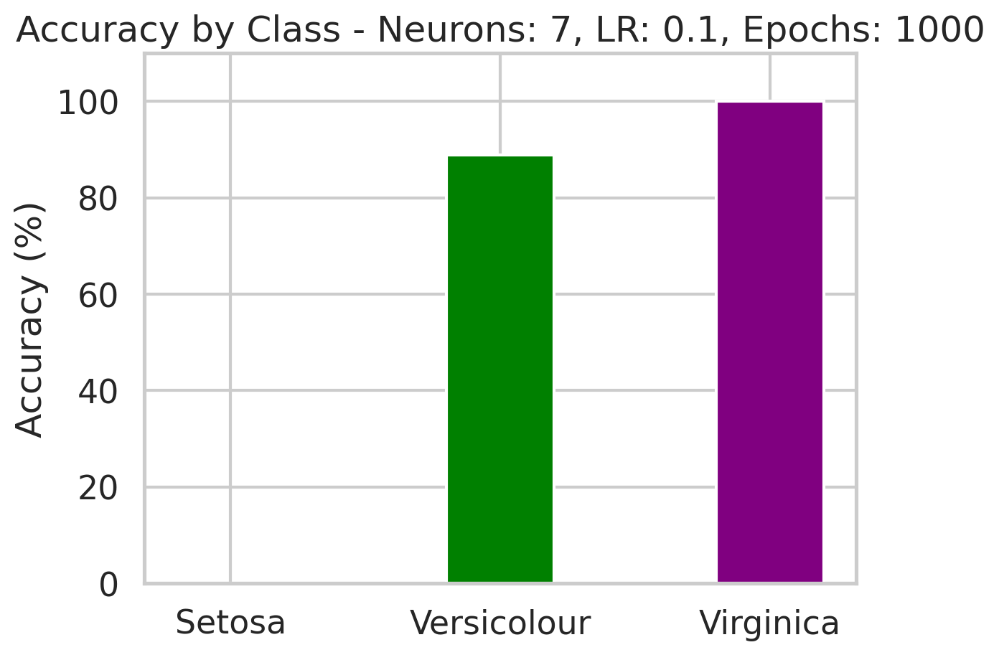

Epoch  1 - Total Error:  0.16299604144184185
Epoch  50 - Total Error:  0.025484767697766014
Epoch  100 - Total Error:  0.024816996630138588
Epoch  150 - Total Error:  0.024617554701261393
Epoch  200 - Total Error:  0.02451978608817569
Epoch  250 - Total Error:  0.024461165457373972
Epoch  300 - Total Error:  0.02442189020298677
Epoch  350 - Total Error:  0.02439364749736695
Epoch  400 - Total Error:  0.02437231509430702
Epoch  450 - Total Error:  0.024355608097170228
Epoch  500 - Total Error:  0.024342154485001172
Epoch  550 - Total Error:  0.024331079024420277
Epoch  600 - Total Error:  0.024321796289177074
Epoch  650 - Total Error:  0.024313899455731085
Epoch  700 - Total Error:  0.024307096781355217
Epoch  750 - Total Error:  0.02430117345960586
Epoch  800 - Total Error:  0.02429596774178872
Epoch  850 - Total Error:  0.024291355453548998
Epoch  900 - Total Error:  0.024287239647467717
Epoch  950 - Total Error:  0.024283543504596664
Epoch  1000 - Total Error:  0.024280205351857268
E

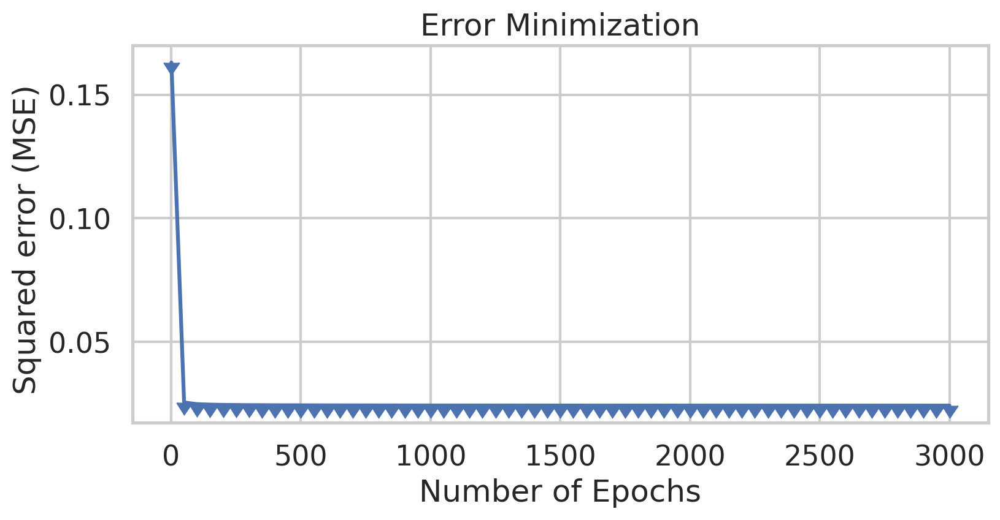

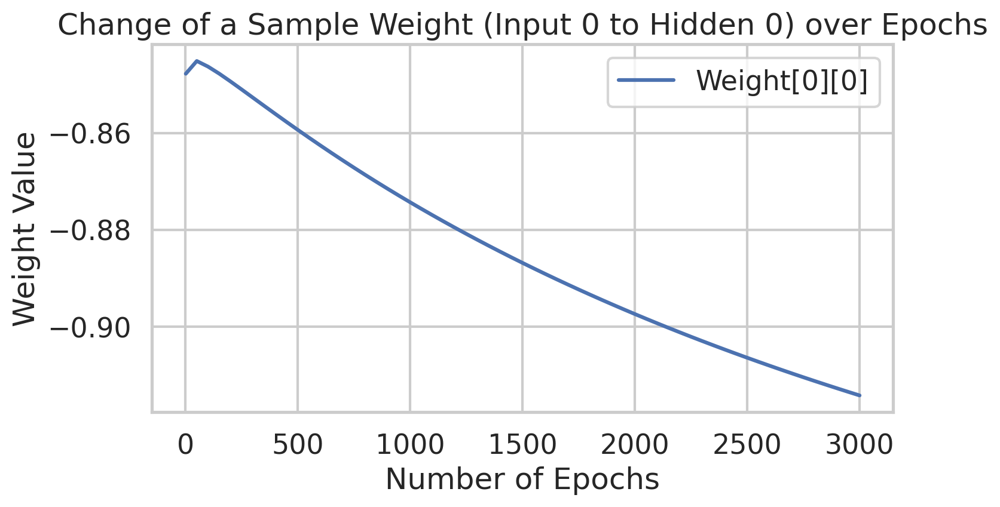

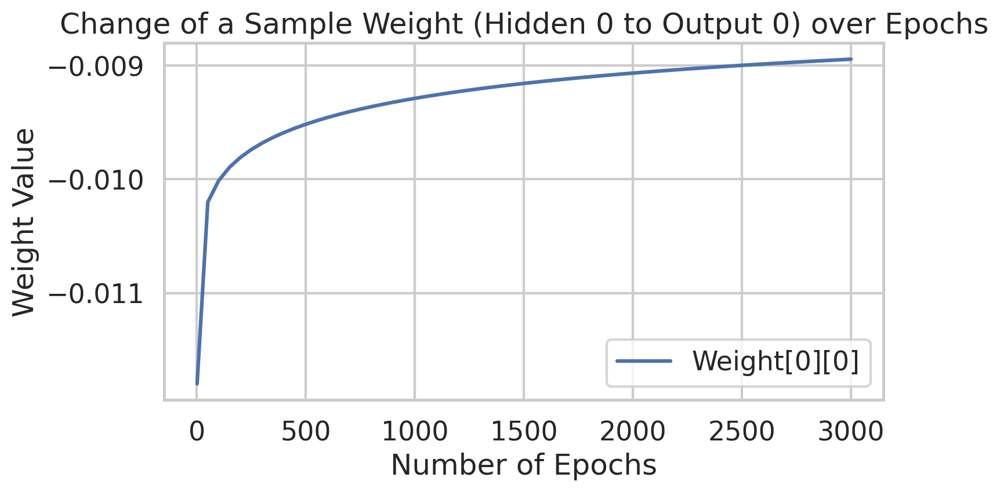

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


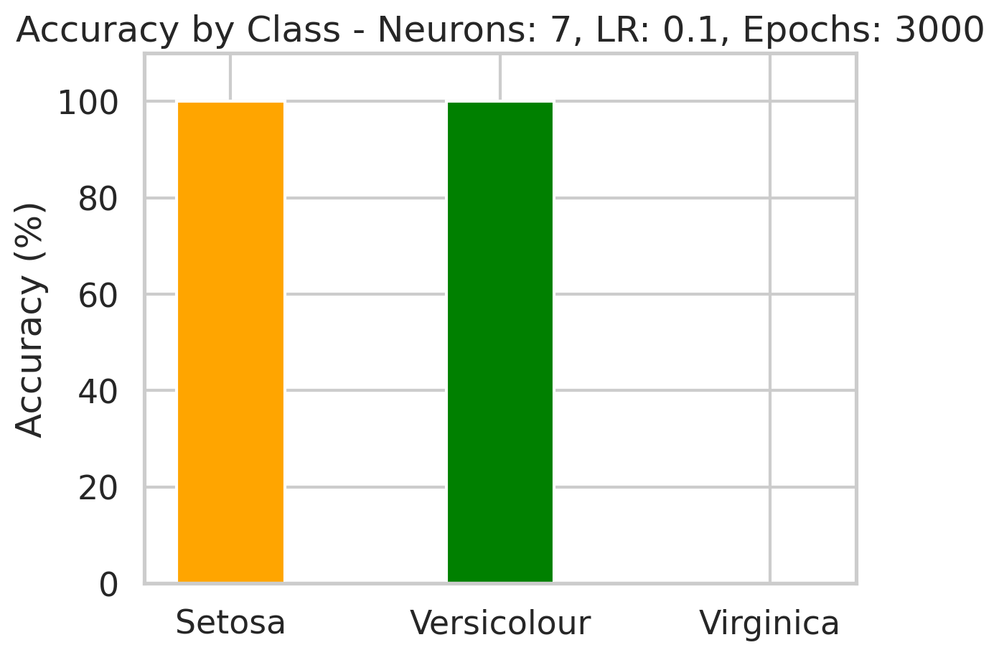

Epoch  1 - Total Error:  0.197013042366175
Epoch  50 - Total Error:  0.0258843166443687
Epoch  100 - Total Error:  0.023469191022453394
Epoch  150 - Total Error:  0.017955858520301602
Epoch  200 - Total Error:  0.009468320956206798
Epoch  250 - Total Error:  0.005146897665491631
Epoch  300 - Total Error:  0.0032206319537101593
Epoch  350 - Total Error:  0.0021374193193325927
Epoch  400 - Total Error:  0.0015357235218380224
Epoch  450 - Total Error:  0.001176967077738567
Epoch  500 - Total Error:  0.000948143402390871
Epoch  550 - Total Error:  0.0007923051014793938
Epoch  600 - Total Error:  0.0006798194409409869
Epoch  650 - Total Error:  0.0005948587466475398
Epoch  700 - Total Error:  0.0005284268486533158
Epoch  750 - Total Error:  0.0004750656762719095
Epoch  800 - Total Error:  0.0004312734710335862
Epoch  850 - Total Error:  0.00039469874445246085
Epoch  900 - Total Error:  0.0003637026202609855
Epoch  950 - Total Error:  0.0003371072993981191
Epoch  1000 - Total Error:  0.00031

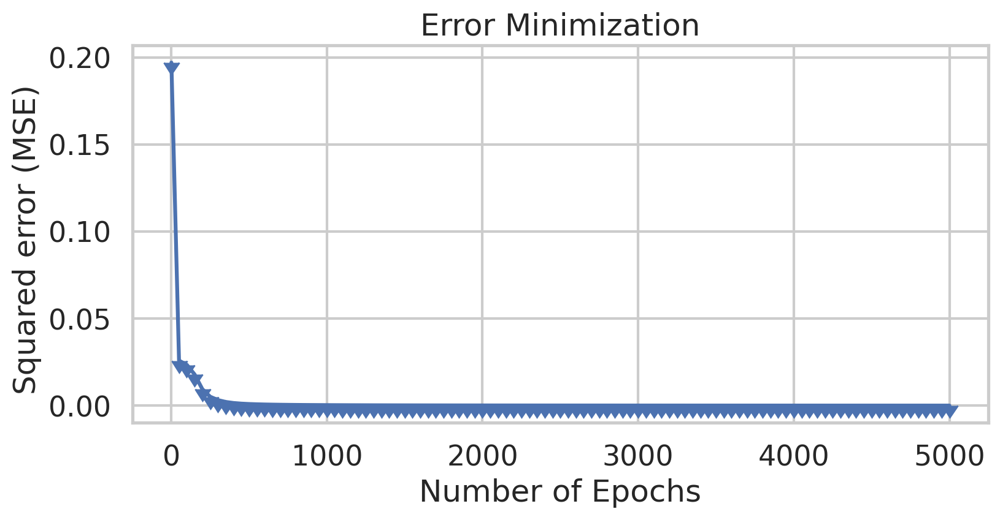

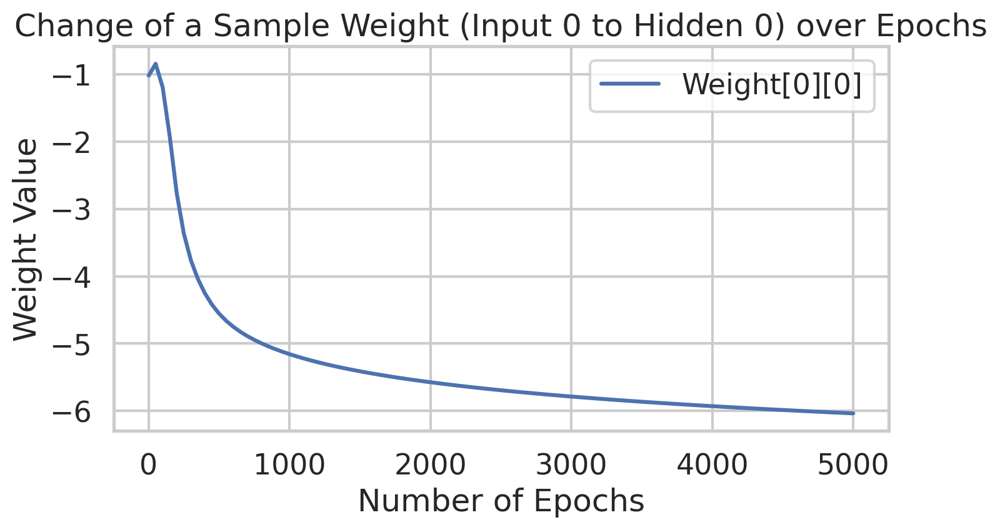

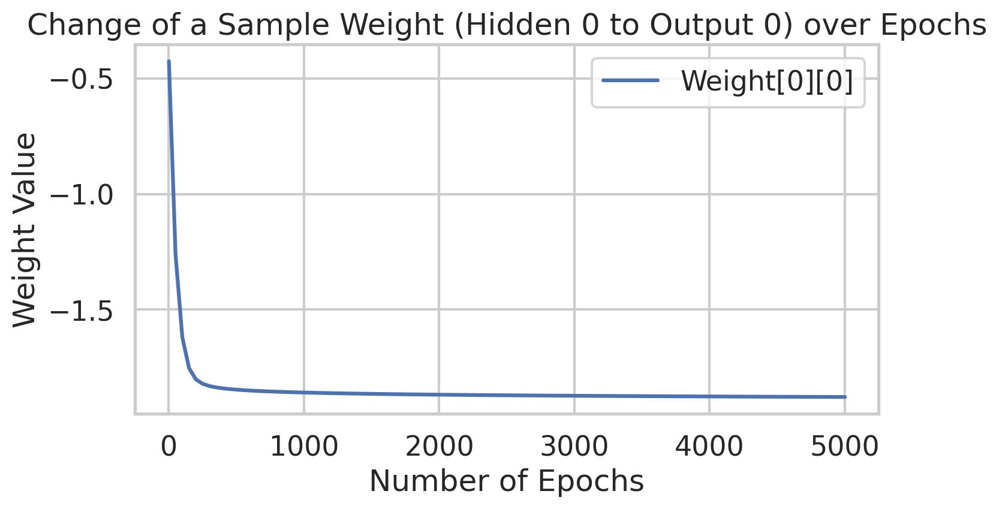

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


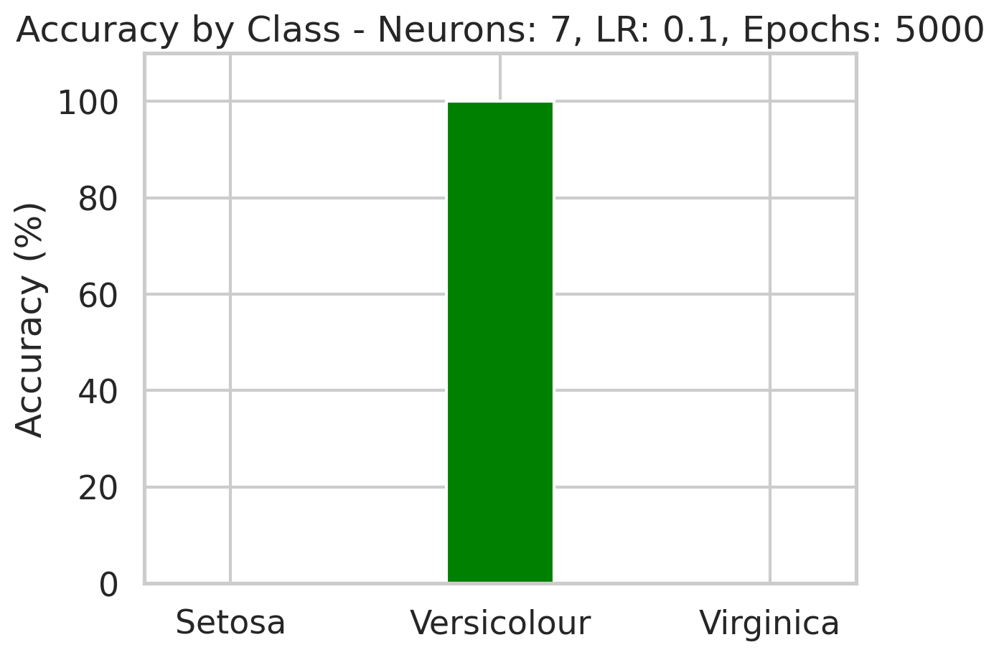

Epoch  1 - Total Error:  0.314046604565137
Epoch  50 - Total Error:  0.1405369559471876
Epoch  100 - Total Error:  0.12878626873312457
Epoch  150 - Total Error:  0.11888452529540582
Epoch  200 - Total Error:  0.10875534014573178
Epoch  250 - Total Error:  0.09782771640880313
Epoch  300 - Total Error:  0.08644545860846985
Epoch  350 - Total Error:  0.07695037991021102
Epoch  400 - Total Error:  0.06915074869937422
Epoch  450 - Total Error:  0.06258321841891866
Epoch  500 - Total Error:  0.05711052647279087
Epoch  550 - Total Error:  0.052590932336986064
Epoch  600 - Total Error:  0.048870990985401395
Epoch  650 - Total Error:  0.04580588708295852
Epoch  700 - Total Error:  0.0432699200321386


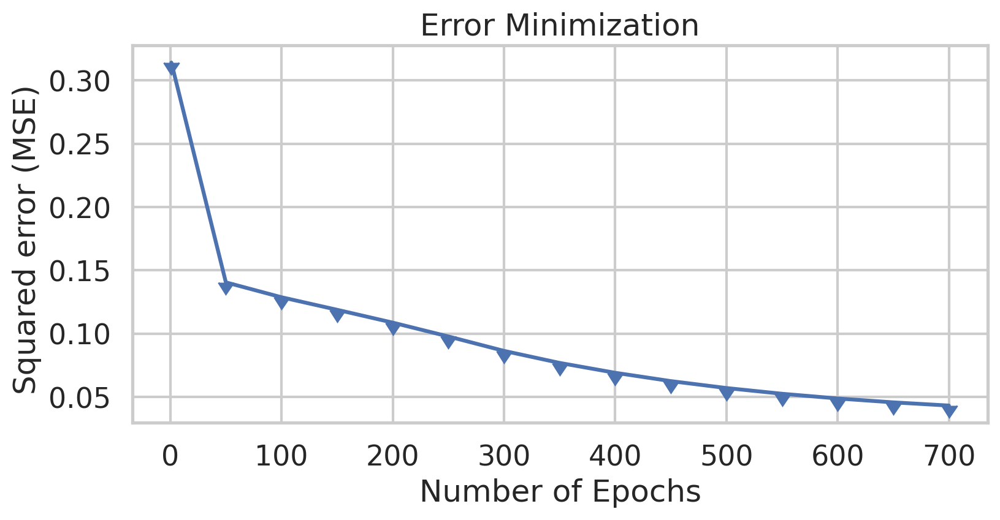

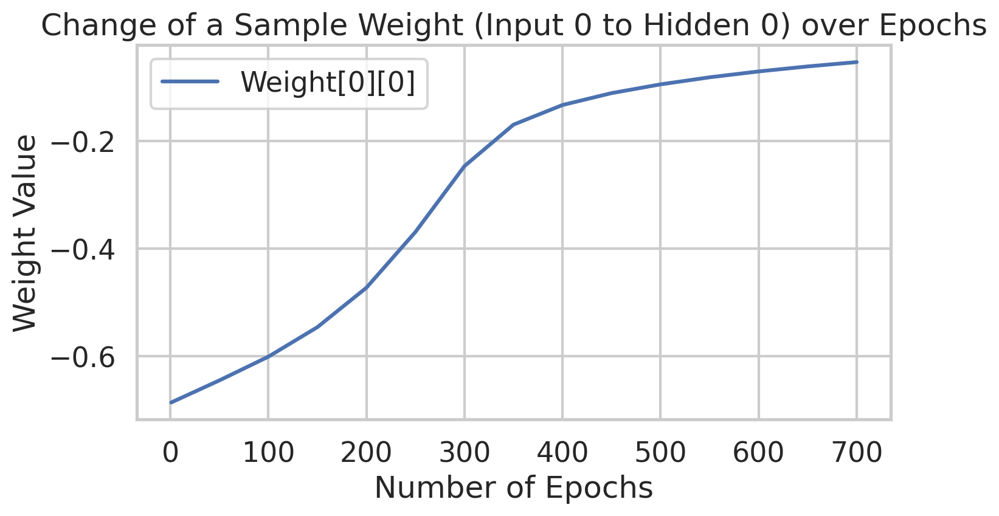

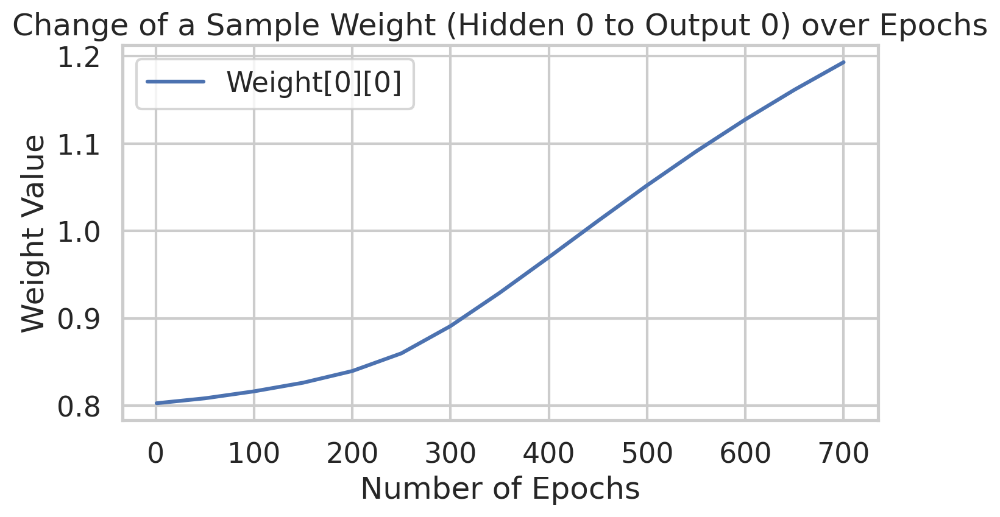

Overall accuracy: 93.33%
 - Accuracy Setosa: 95.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


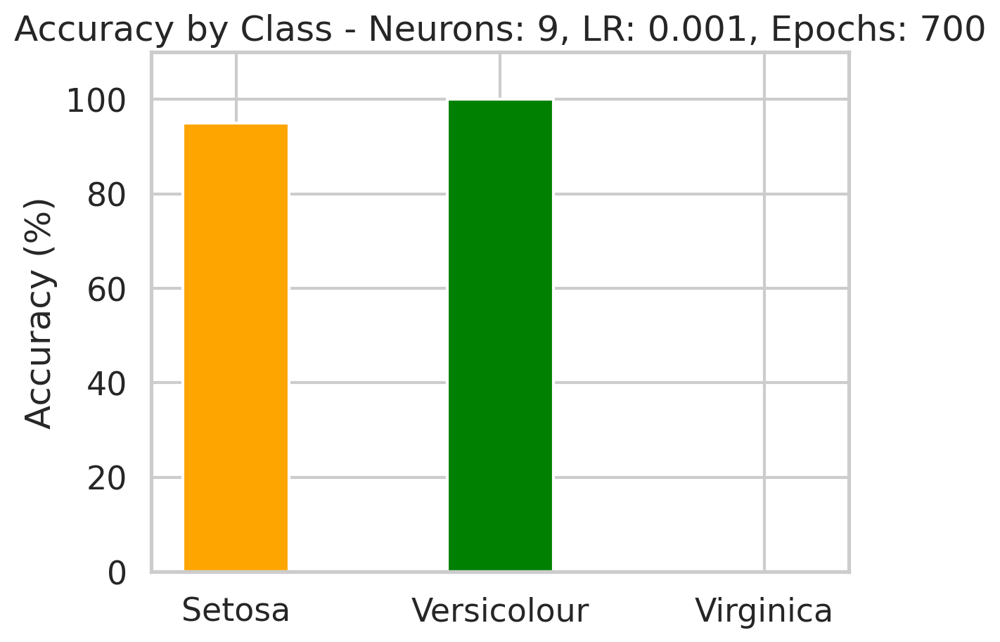

Epoch  1 - Total Error:  0.37375547776407975
Epoch  50 - Total Error:  0.1647758727624826
Epoch  100 - Total Error:  0.15234081871149557
Epoch  150 - Total Error:  0.14525717695348536
Epoch  200 - Total Error:  0.13763485683801752
Epoch  250 - Total Error:  0.12951975322992443
Epoch  300 - Total Error:  0.12014425076118394
Epoch  350 - Total Error:  0.10938204196863817
Epoch  400 - Total Error:  0.09710789546139921
Epoch  450 - Total Error:  0.08318253129489664
Epoch  500 - Total Error:  0.07006182533836647
Epoch  550 - Total Error:  0.06038509807350512
Epoch  600 - Total Error:  0.05362376603405574
Epoch  650 - Total Error:  0.048696671168188974
Epoch  700 - Total Error:  0.04497844898700847
Epoch  750 - Total Error:  0.042106746183387854
Epoch  800 - Total Error:  0.03984703652607578
Epoch  850 - Total Error:  0.03803905548428519
Epoch  900 - Total Error:  0.036570387803555746
Epoch  950 - Total Error:  0.03536072232987928
Epoch  1000 - Total Error:  0.03435174017703301


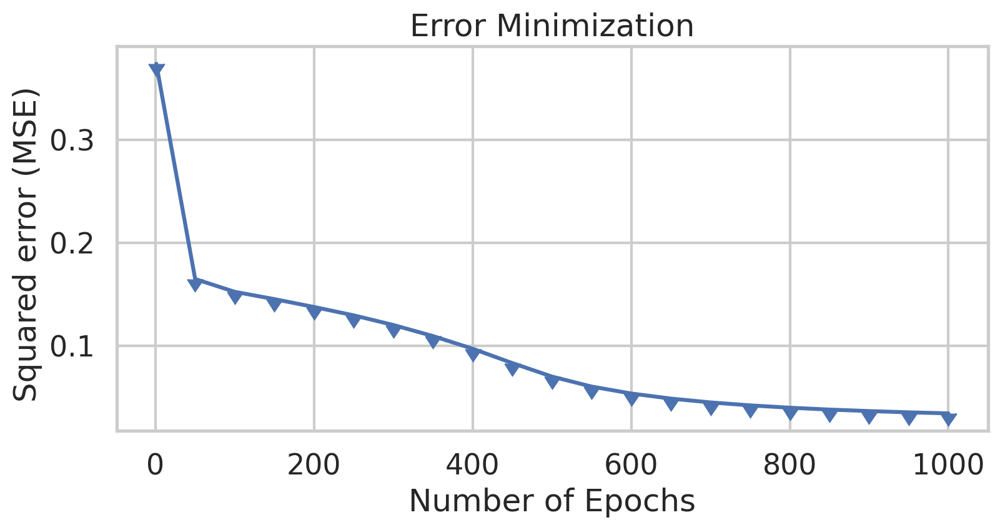

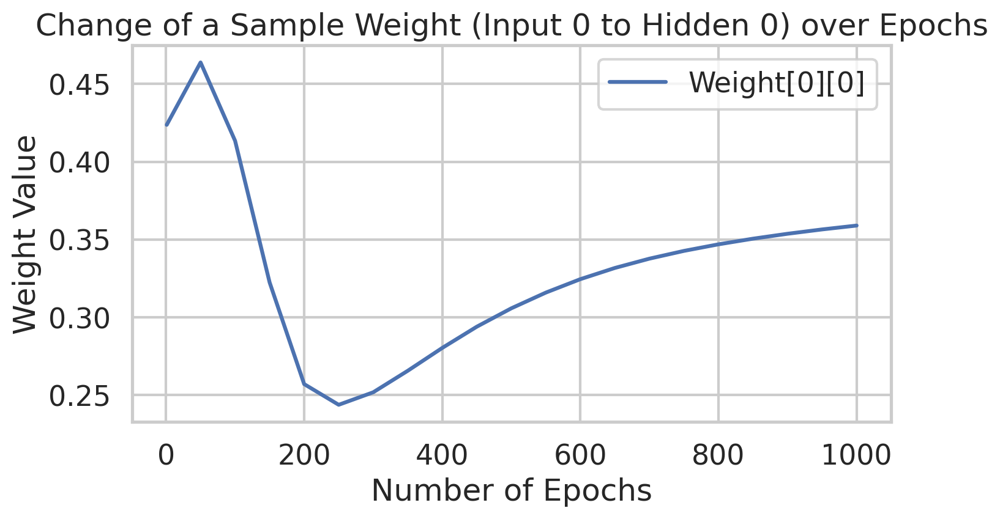

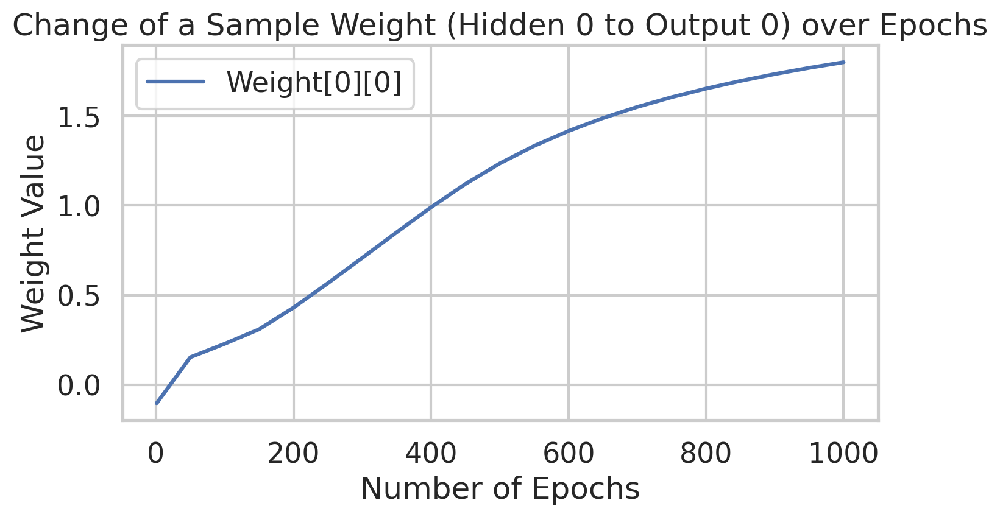

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


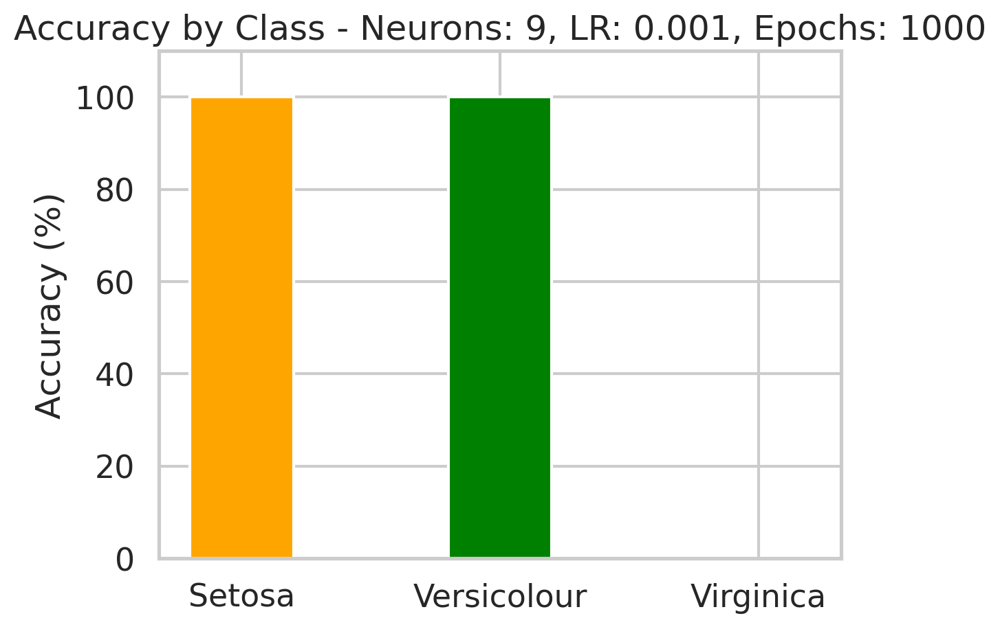

Epoch  1 - Total Error:  0.24639237740553613
Epoch  50 - Total Error:  0.14945861528218982
Epoch  100 - Total Error:  0.13494621622377784
Epoch  150 - Total Error:  0.11874562628508627
Epoch  200 - Total Error:  0.1004122030208255
Epoch  250 - Total Error:  0.08646805881338195
Epoch  300 - Total Error:  0.07475378385332951
Epoch  350 - Total Error:  0.06511059302659417
Epoch  400 - Total Error:  0.05745114273839787
Epoch  450 - Total Error:  0.05149712075948684
Epoch  500 - Total Error:  0.04690178201279386
Epoch  550 - Total Error:  0.043344848495108855
Epoch  600 - Total Error:  0.04056740421417031
Epoch  650 - Total Error:  0.038372998901382106
Epoch  700 - Total Error:  0.03661673513272868
Epoch  750 - Total Error:  0.035192741766600893
Epoch  800 - Total Error:  0.03402359005111001
Epoch  850 - Total Error:  0.03305227810897621
Epoch  900 - Total Error:  0.03223643890514629
Epoch  950 - Total Error:  0.03154423526164227
Epoch  1000 - Total Error:  0.030951466263106575
Epoch  1050 

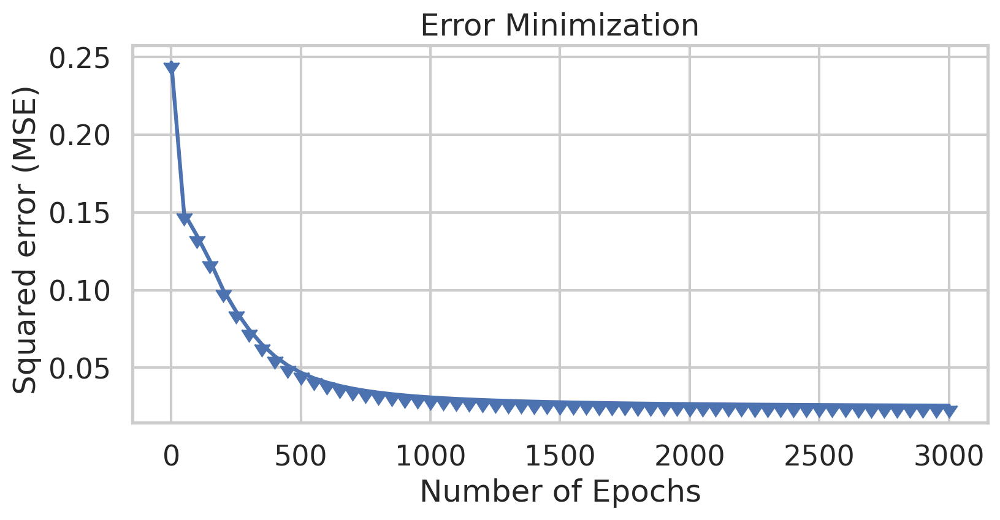

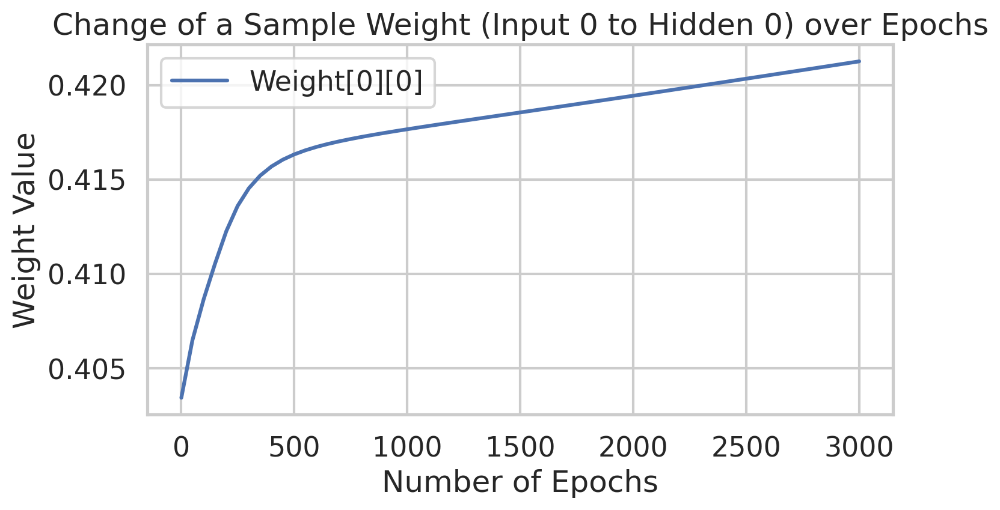

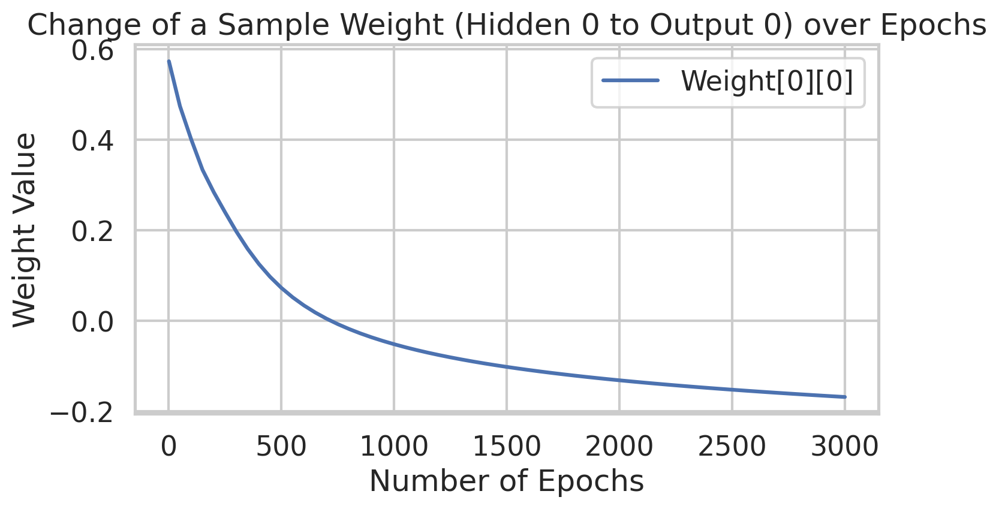

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


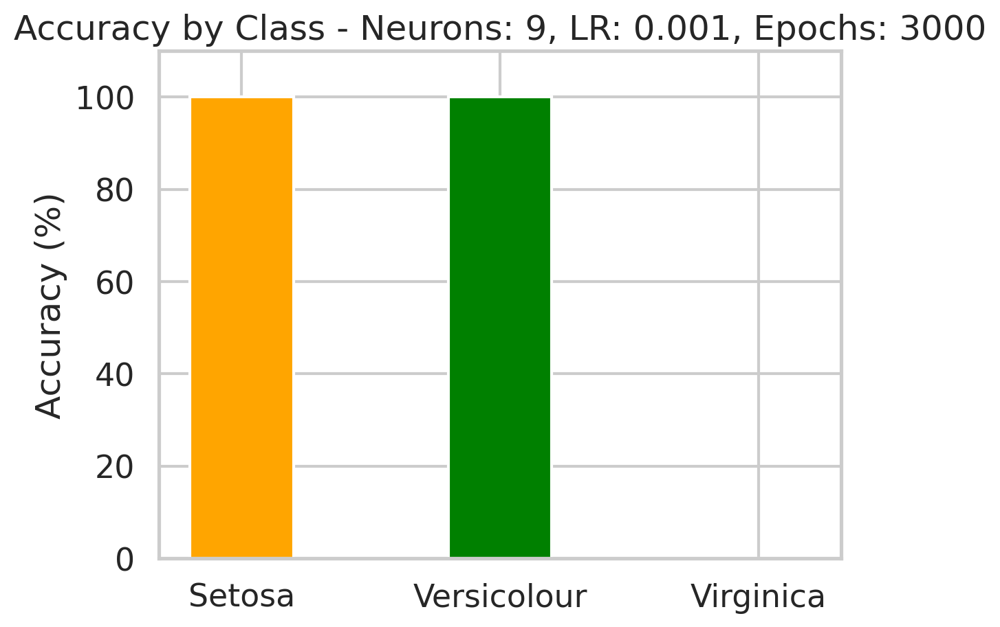

Epoch  1 - Total Error:  0.19486686380055618
Epoch  50 - Total Error:  0.1329620002864559
Epoch  100 - Total Error:  0.10011131859621754
Epoch  150 - Total Error:  0.0855973901602504
Epoch  200 - Total Error:  0.07598454986154621
Epoch  250 - Total Error:  0.06820226673929566
Epoch  300 - Total Error:  0.061695272096521016
Epoch  350 - Total Error:  0.05617310986836096
Epoch  400 - Total Error:  0.05142706577831675
Epoch  450 - Total Error:  0.047386489874121376
Epoch  500 - Total Error:  0.04408947021681953
Epoch  550 - Total Error:  0.04149941737406738
Epoch  600 - Total Error:  0.03946966487370125
Epoch  650 - Total Error:  0.03784560942219085
Epoch  700 - Total Error:  0.03651448057530815
Epoch  750 - Total Error:  0.03540180036219558
Epoch  800 - Total Error:  0.03445778561784601
Epoch  850 - Total Error:  0.03364760531392149
Epoch  900 - Total Error:  0.032945768451907796
Epoch  950 - Total Error:  0.03233295655066489
Epoch  1000 - Total Error:  0.03179415195629733
Epoch  1050 - 

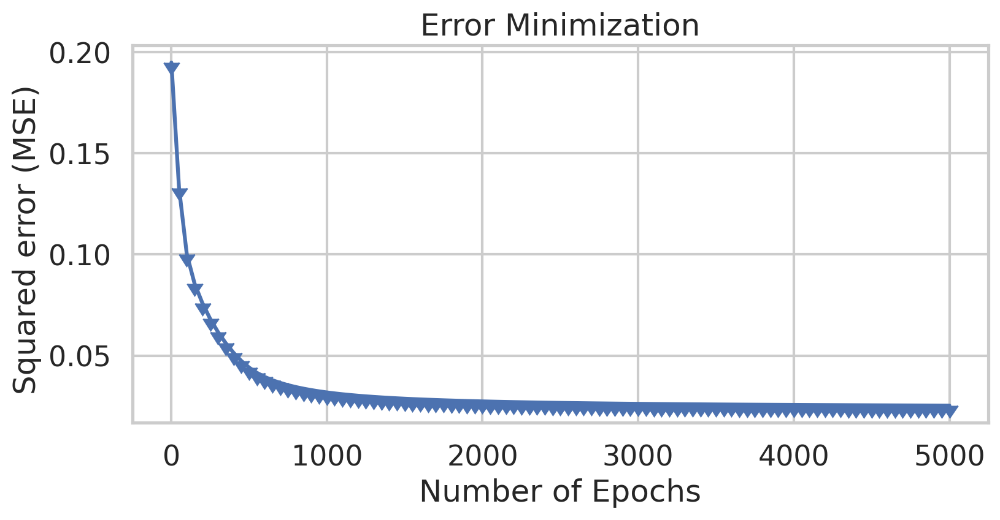

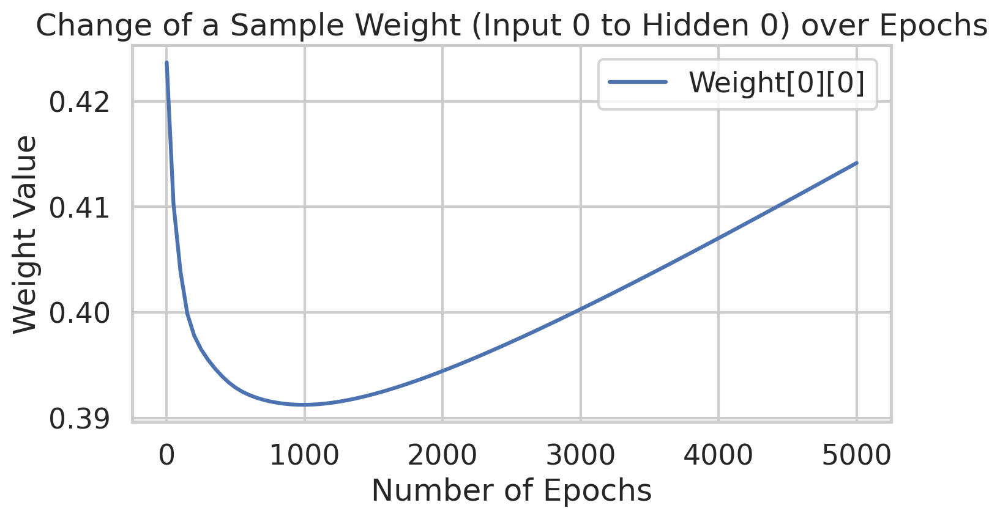

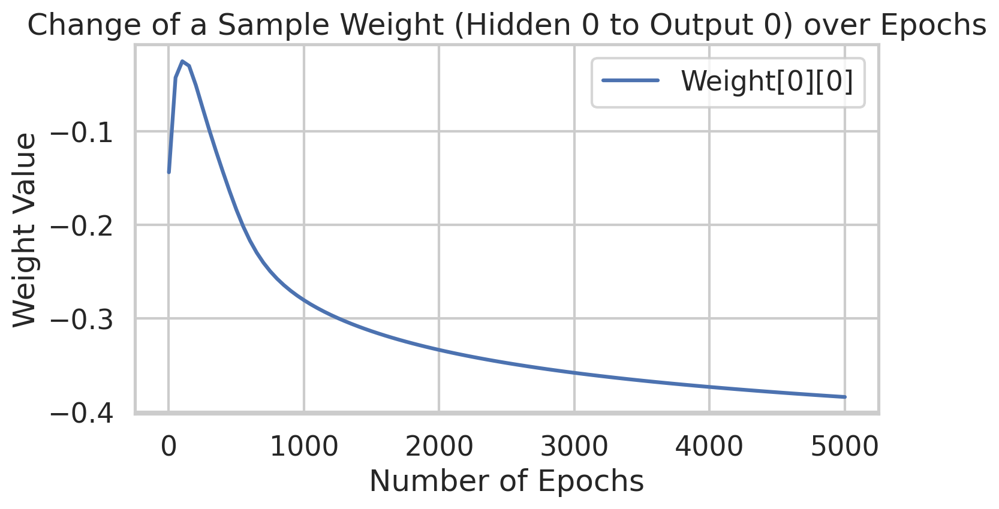

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


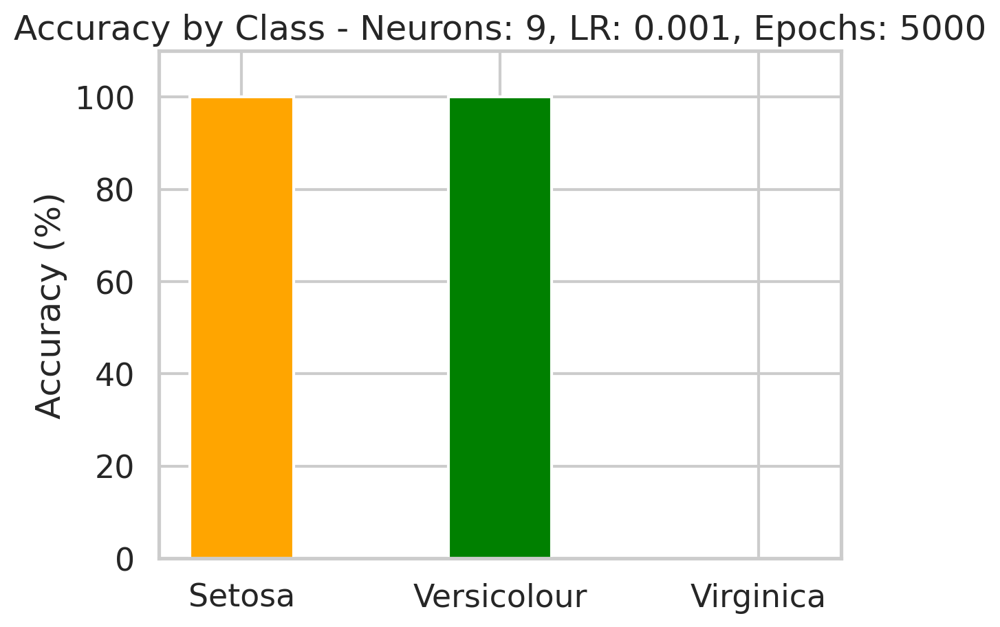

Epoch  1 - Total Error:  0.41228624268589836
Epoch  50 - Total Error:  0.10471511075298219
Epoch  100 - Total Error:  0.05880025428083085
Epoch  150 - Total Error:  0.04082085977522365
Epoch  200 - Total Error:  0.034285975133361374
Epoch  250 - Total Error:  0.03133087811307533
Epoch  300 - Total Error:  0.02973487773020315
Epoch  350 - Total Error:  0.0287557801253688
Epoch  400 - Total Error:  0.028094474432965713
Epoch  450 - Total Error:  0.02761264032241622
Epoch  500 - Total Error:  0.027239572198350496
Epoch  550 - Total Error:  0.02693640258331519
Epoch  600 - Total Error:  0.026680699363844786
Epoch  650 - Total Error:  0.0264591798952284
Epoch  700 - Total Error:  0.026263937806095608


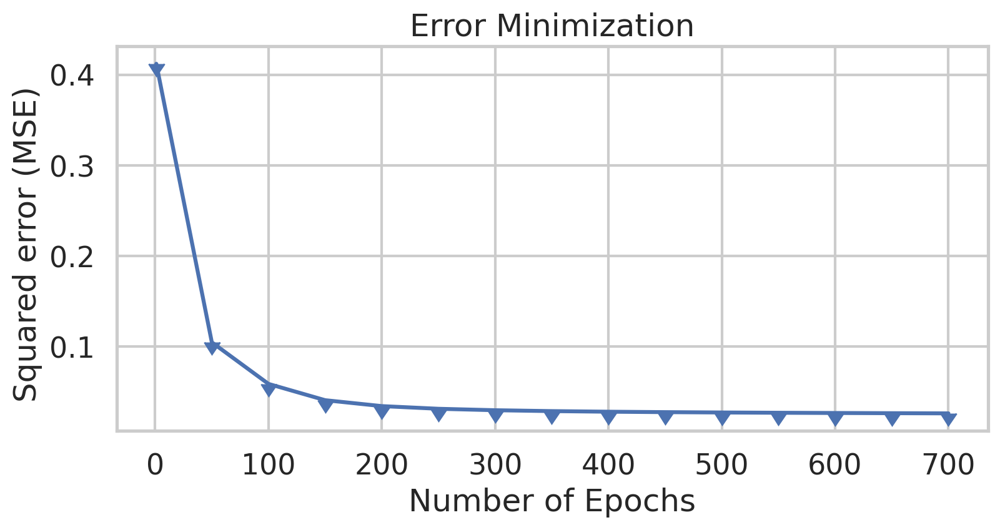

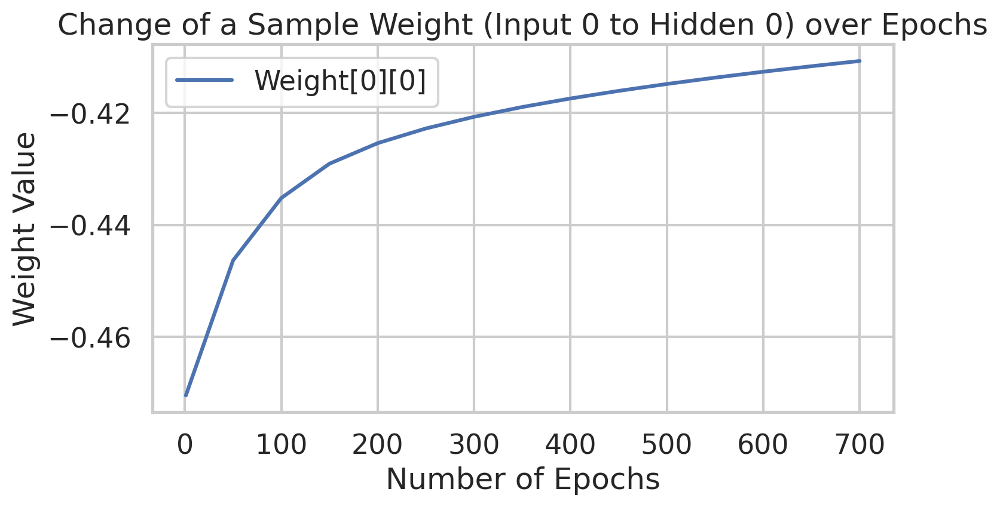

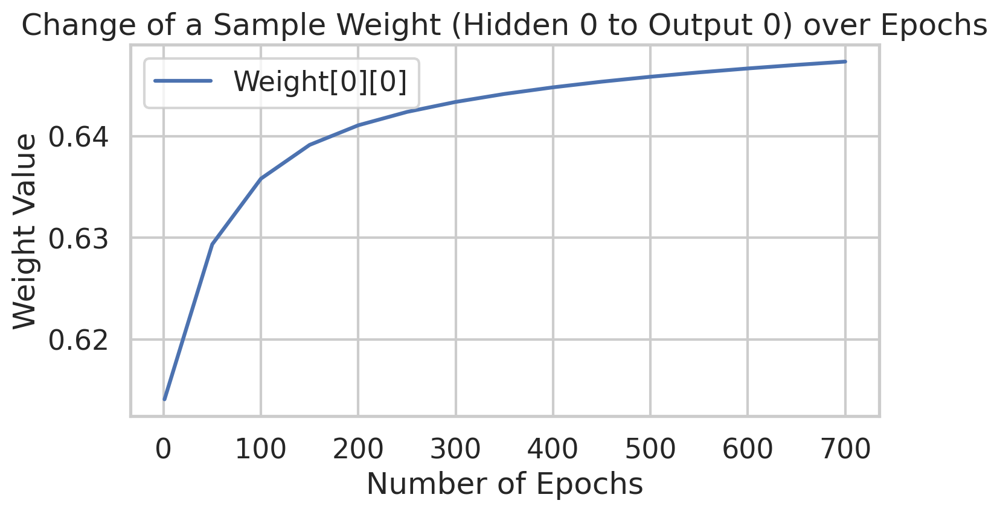

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


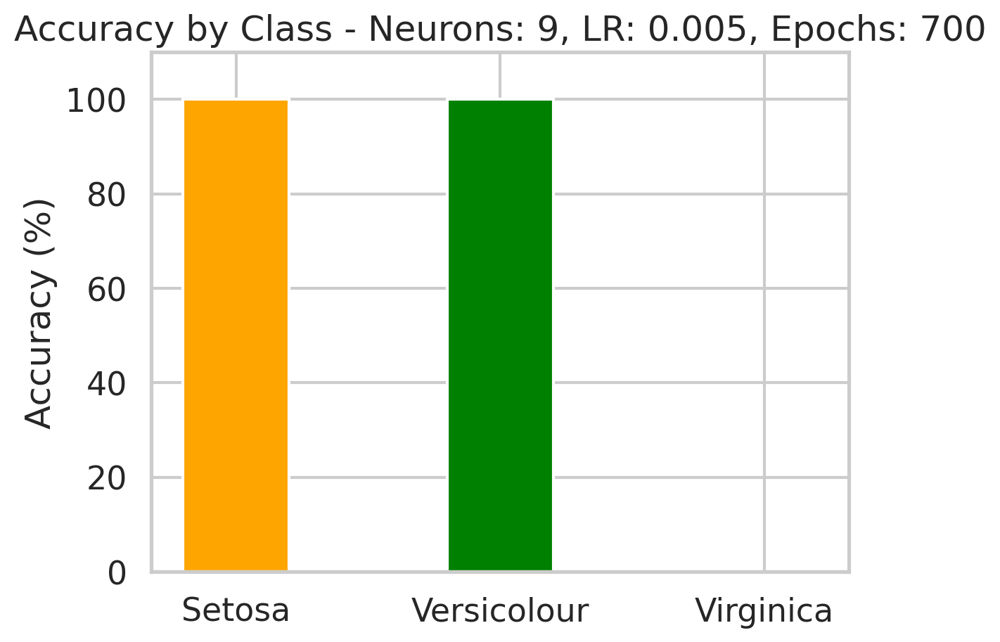

Epoch  1 - Total Error:  0.3148735938152354
Epoch  50 - Total Error:  0.07569586942896261
Epoch  100 - Total Error:  0.04781481406985859
Epoch  150 - Total Error:  0.038129513675119735
Epoch  200 - Total Error:  0.03394695149323176
Epoch  250 - Total Error:  0.03175594613499502
Epoch  300 - Total Error:  0.03044278627810517
Epoch  350 - Total Error:  0.029576473374686465
Epoch  400 - Total Error:  0.028961976186533737
Epoch  450 - Total Error:  0.028499682634672056
Epoch  500 - Total Error:  0.028133117027527178
Epoch  550 - Total Error:  0.02782631994151154
Epoch  600 - Total Error:  0.027552006019982873
Epoch  650 - Total Error:  0.027283740022451663
Epoch  700 - Total Error:  0.026995411761201002
Epoch  750 - Total Error:  0.026685703238253155
Epoch  800 - Total Error:  0.02638640071855949
Epoch  850 - Total Error:  0.026105808175754065
Epoch  900 - Total Error:  0.025833816330849798
Epoch  950 - Total Error:  0.025568199112545913
Epoch  1000 - Total Error:  0.025313618507932227


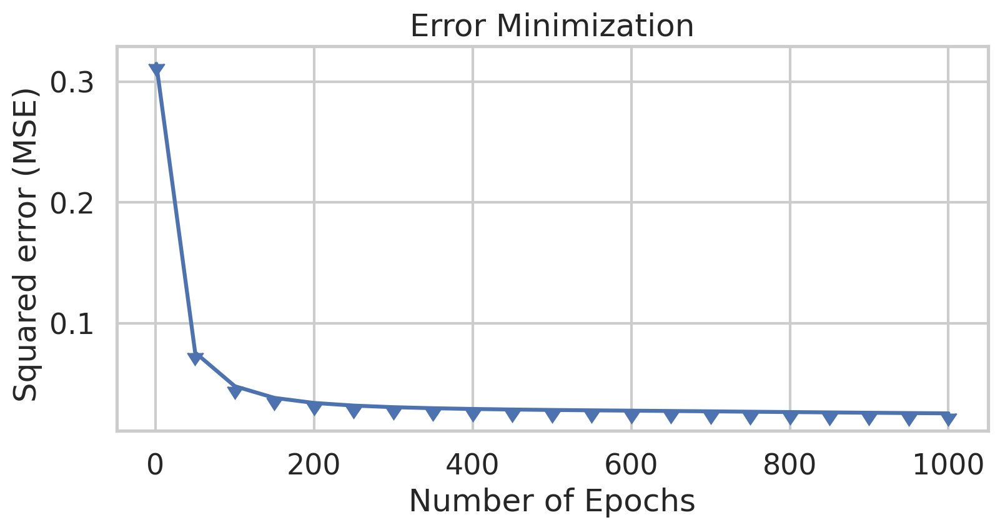

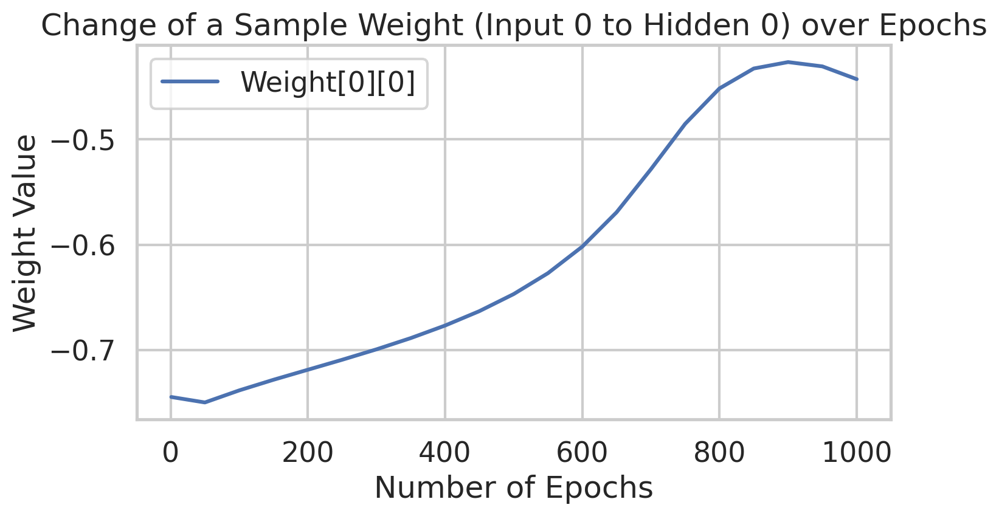

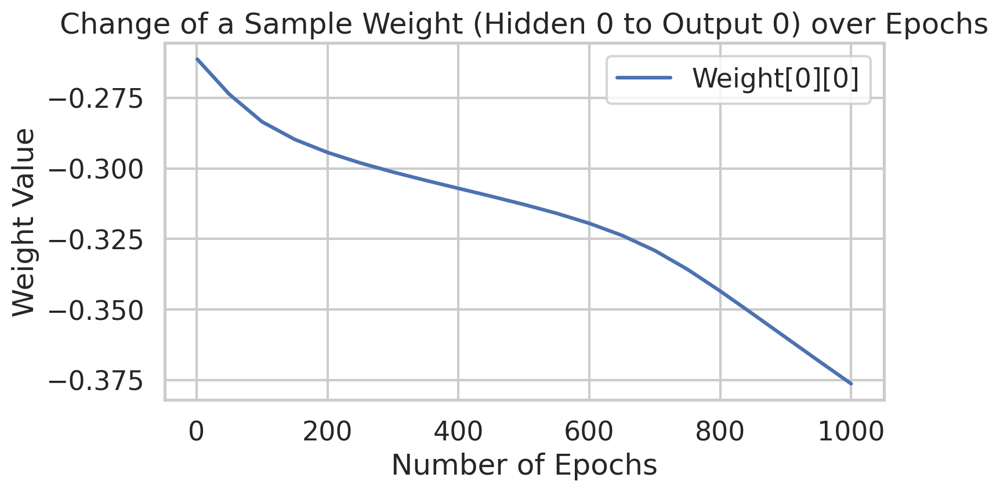

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


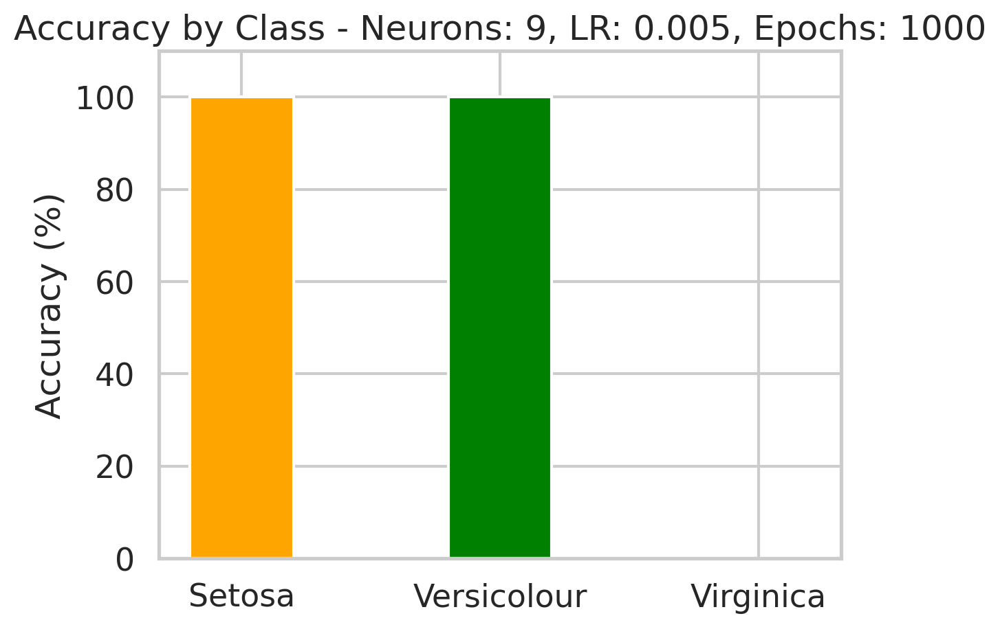

Epoch  1 - Total Error:  0.35280928632303366
Epoch  50 - Total Error:  0.08812205599862356
Epoch  100 - Total Error:  0.0523318783921725
Epoch  150 - Total Error:  0.039335496950117975
Epoch  200 - Total Error:  0.034093485935510454
Epoch  250 - Total Error:  0.031483913472270426
Epoch  300 - Total Error:  0.02994675240471976
Epoch  350 - Total Error:  0.028926246349033912
Epoch  400 - Total Error:  0.028188648080947395
Epoch  450 - Total Error:  0.027623551207119228
Epoch  500 - Total Error:  0.027174422964231528
Epoch  550 - Total Error:  0.026809756121545913
Epoch  600 - Total Error:  0.026509722125197088
Epoch  650 - Total Error:  0.026260148821205014
Epoch  700 - Total Error:  0.026050157876469356
Epoch  750 - Total Error:  0.02587128236312851
Epoch  800 - Total Error:  0.025716978262212333
Epoch  850 - Total Error:  0.025582209722684213
Epoch  900 - Total Error:  0.025463087971622042
Epoch  950 - Total Error:  0.02535658270927256
Epoch  1000 - Total Error:  0.02526030445355974
Ep

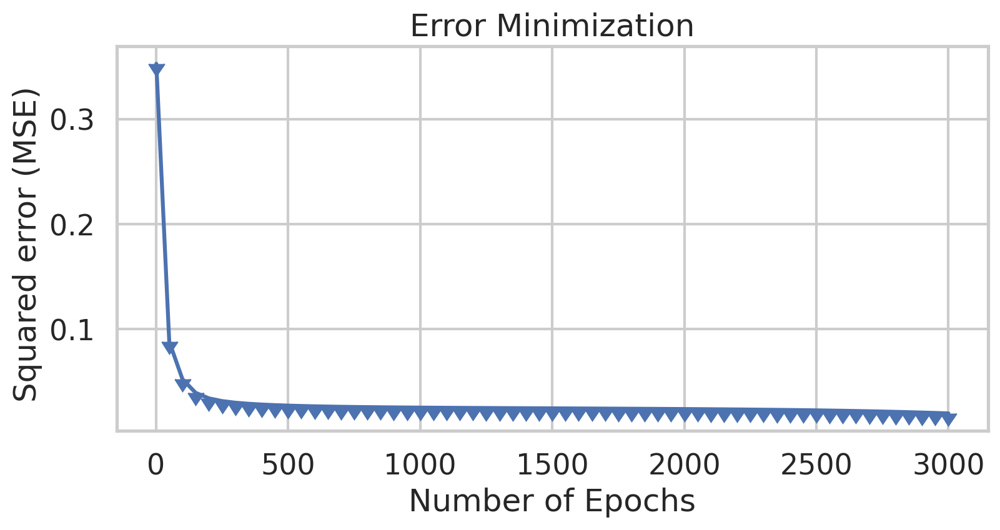

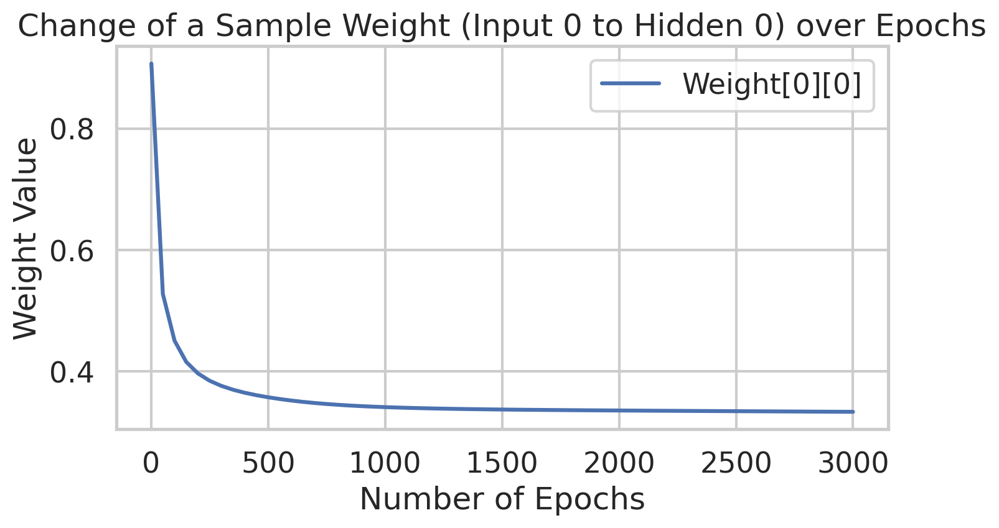

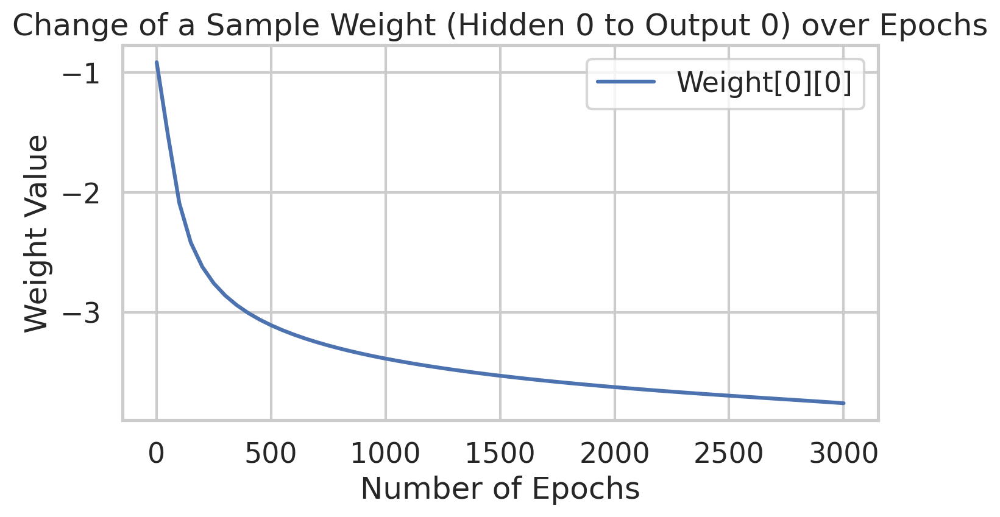

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


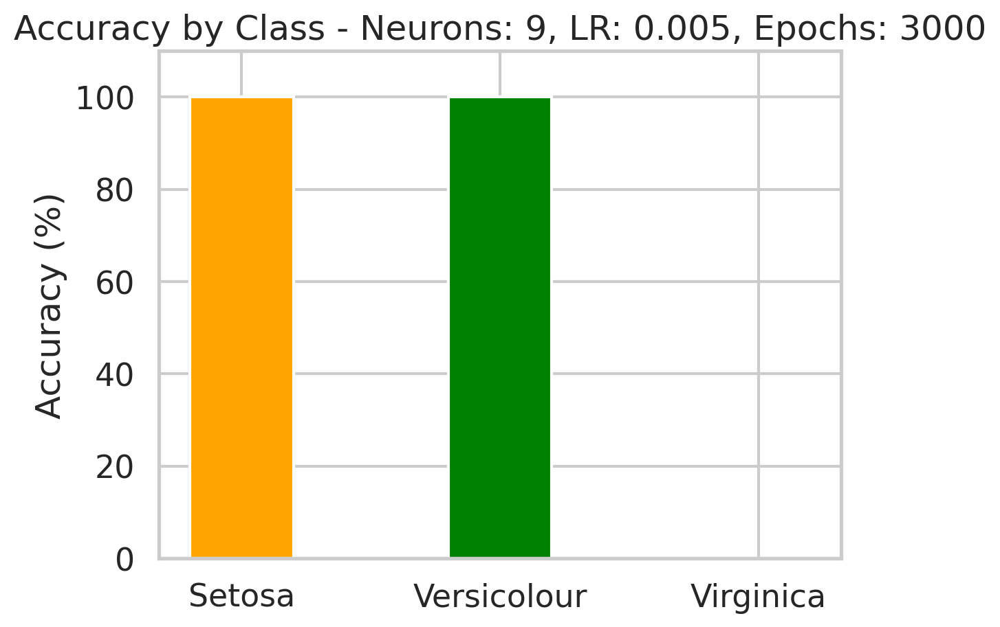

Epoch  1 - Total Error:  0.231636713113521
Epoch  50 - Total Error:  0.07650737993851955
Epoch  100 - Total Error:  0.04594450359723137
Epoch  150 - Total Error:  0.03587154963232001
Epoch  200 - Total Error:  0.03174389502156042
Epoch  250 - Total Error:  0.029665593679089195
Epoch  300 - Total Error:  0.028452723048404533
Epoch  350 - Total Error:  0.027668065225234652
Epoch  400 - Total Error:  0.027121787703440807
Epoch  450 - Total Error:  0.02672063131956793
Epoch  500 - Total Error:  0.026414147199699256
Epoch  550 - Total Error:  0.02617283438152339
Epoch  600 - Total Error:  0.025978295344514197
Epoch  650 - Total Error:  0.025818432148382035
Epoch  700 - Total Error:  0.02568494060985253
Epoch  750 - Total Error:  0.025571923299452338
Epoch  800 - Total Error:  0.02547507819935998
Epoch  850 - Total Error:  0.02539119920435009
Epoch  900 - Total Error:  0.025317854438312876
Epoch  950 - Total Error:  0.02525317121042208
Epoch  1000 - Total Error:  0.025195687963246987
Epoch  

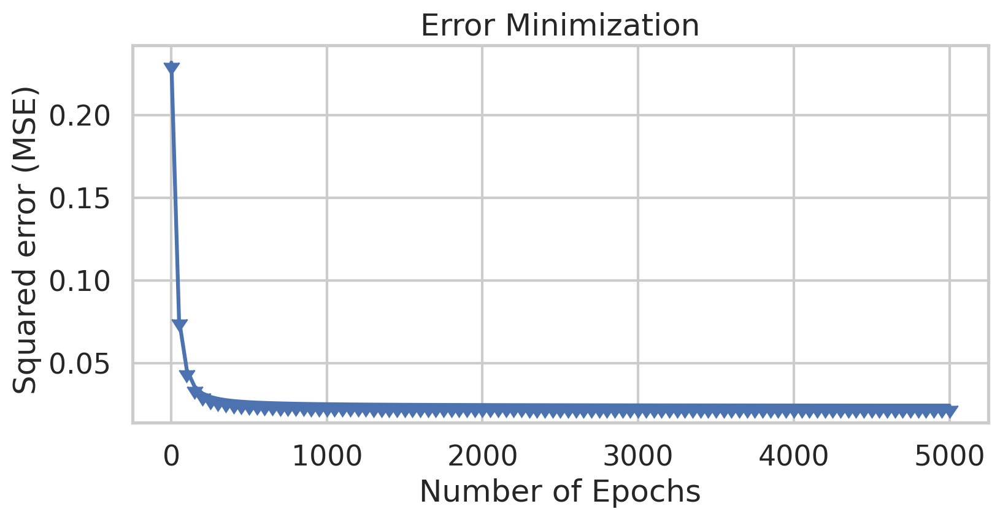

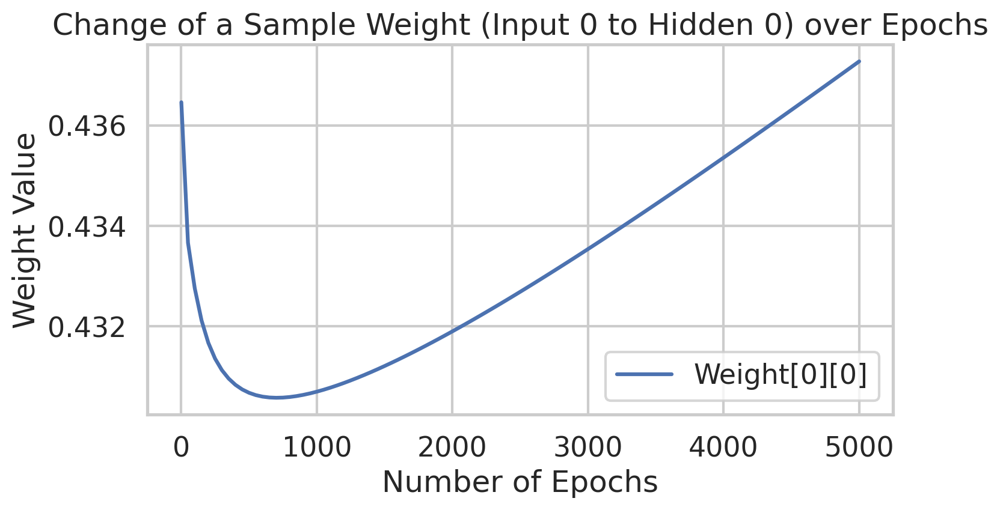

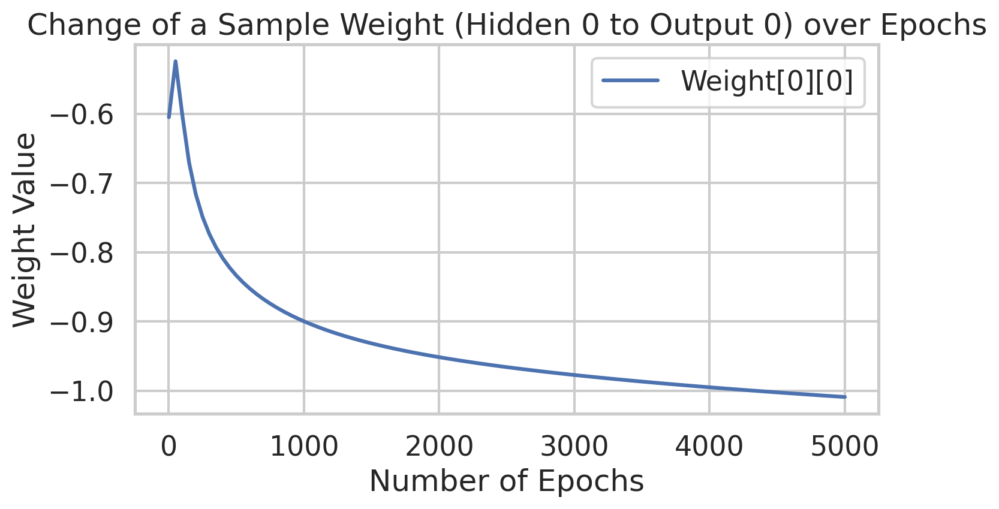

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


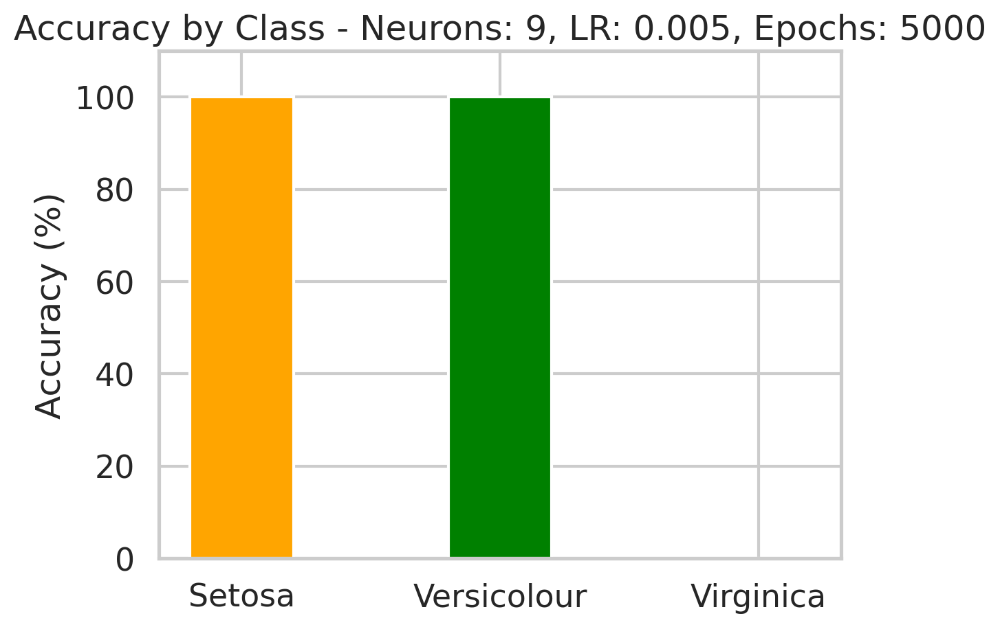

Epoch  1 - Total Error:  0.2224592439515899
Epoch  50 - Total Error:  0.057333035048521365
Epoch  100 - Total Error:  0.03572044107302087
Epoch  150 - Total Error:  0.030160443798455745
Epoch  200 - Total Error:  0.028103868993817626
Epoch  250 - Total Error:  0.027074966909922896
Epoch  300 - Total Error:  0.026459641637381306
Epoch  350 - Total Error:  0.026051489236574722
Epoch  400 - Total Error:  0.025762996195358965
Epoch  450 - Total Error:  0.025549848772678418
Epoch  500 - Total Error:  0.02538676228080015
Epoch  550 - Total Error:  0.02525826831290181
Epoch  600 - Total Error:  0.025154487958688136
Epoch  650 - Total Error:  0.025068896482281517
Epoch  700 - Total Error:  0.024997049783178123


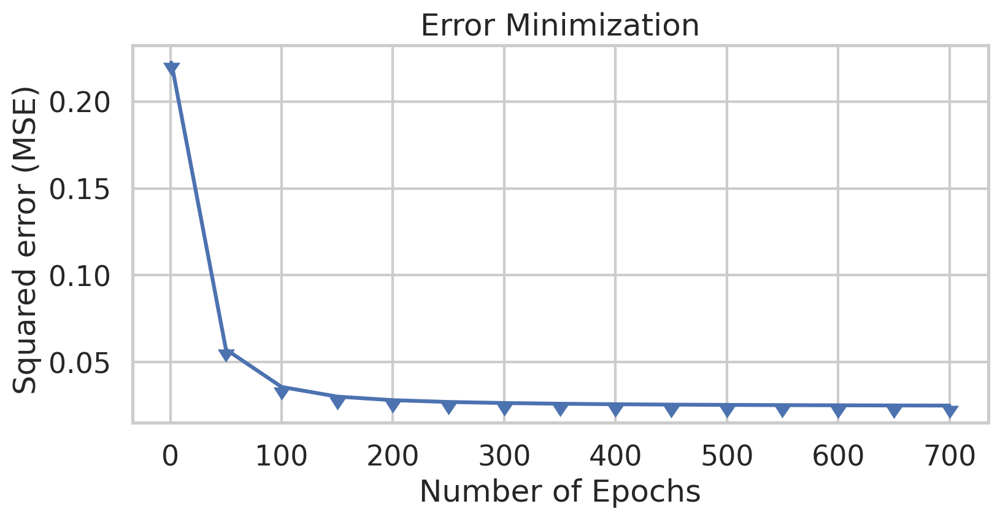

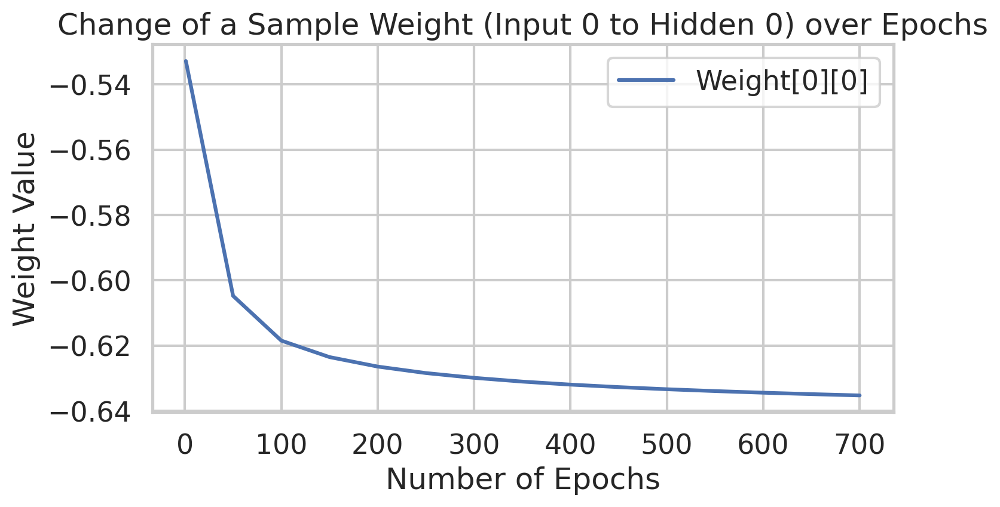

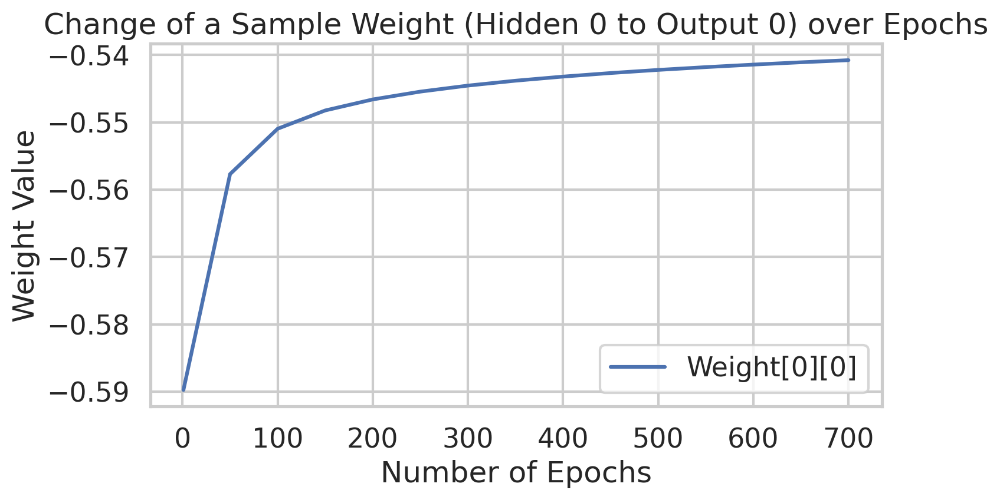

Overall accuracy: 90.00%
 - Accuracy Setosa: 90.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


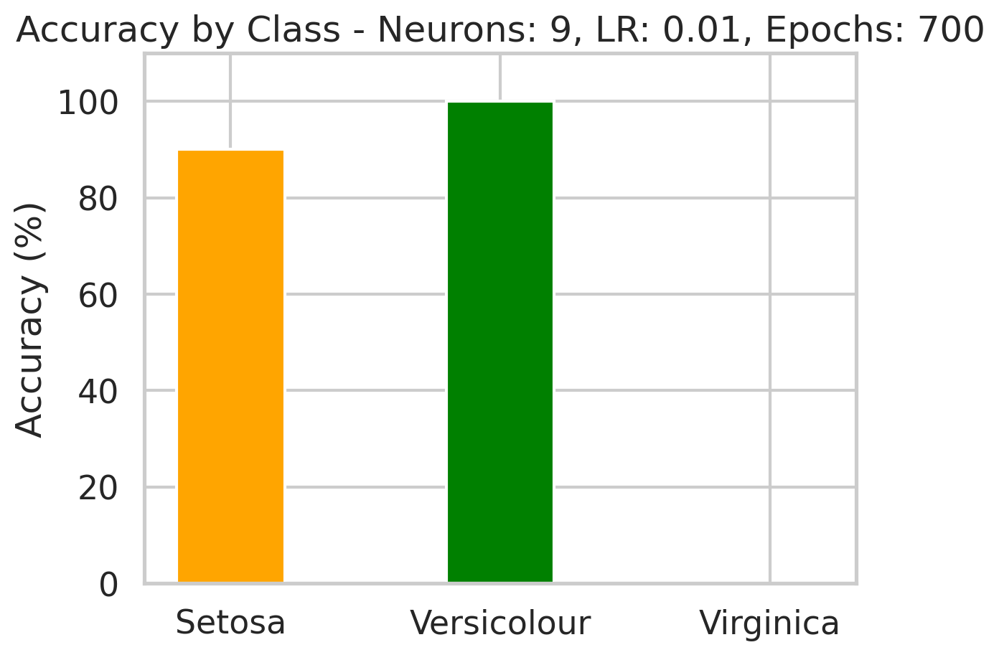

Epoch  1 - Total Error:  0.2578072697476454
Epoch  50 - Total Error:  0.05259342451805671
Epoch  100 - Total Error:  0.033640779023125886
Epoch  150 - Total Error:  0.02917278458844548
Epoch  200 - Total Error:  0.027403503880063948
Epoch  250 - Total Error:  0.02648798753366759
Epoch  300 - Total Error:  0.025931977540933453
Epoch  350 - Total Error:  0.025555042261234895
Epoch  400 - Total Error:  0.02527707636569034
Epoch  450 - Total Error:  0.025057135973255297
Epoch  500 - Total Error:  0.0248716594116495
Epoch  550 - Total Error:  0.024705411468845792
Epoch  600 - Total Error:  0.024547310528755754
Epoch  650 - Total Error:  0.02438855390905266
Epoch  700 - Total Error:  0.024222104059719893
Epoch  750 - Total Error:  0.024042767852590977
Epoch  800 - Total Error:  0.023846935418248547
Epoch  850 - Total Error:  0.023631733453487937
Epoch  900 - Total Error:  0.023394154506583973
Epoch  950 - Total Error:  0.023130548336984816
Epoch  1000 - Total Error:  0.0228364400555197


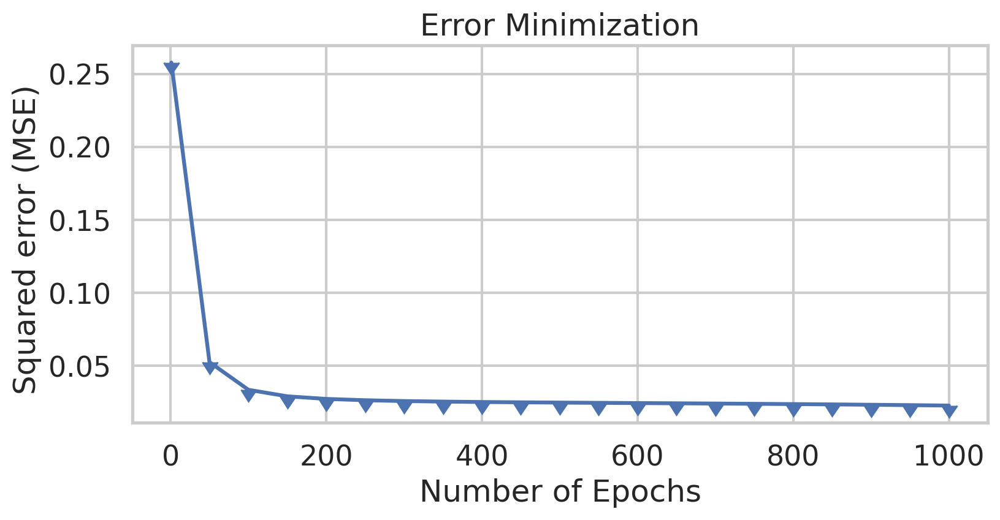

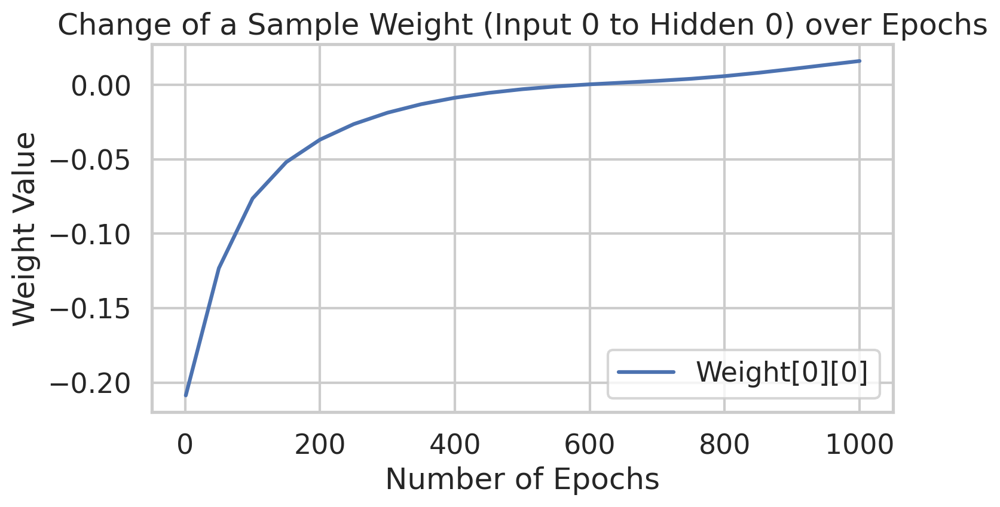

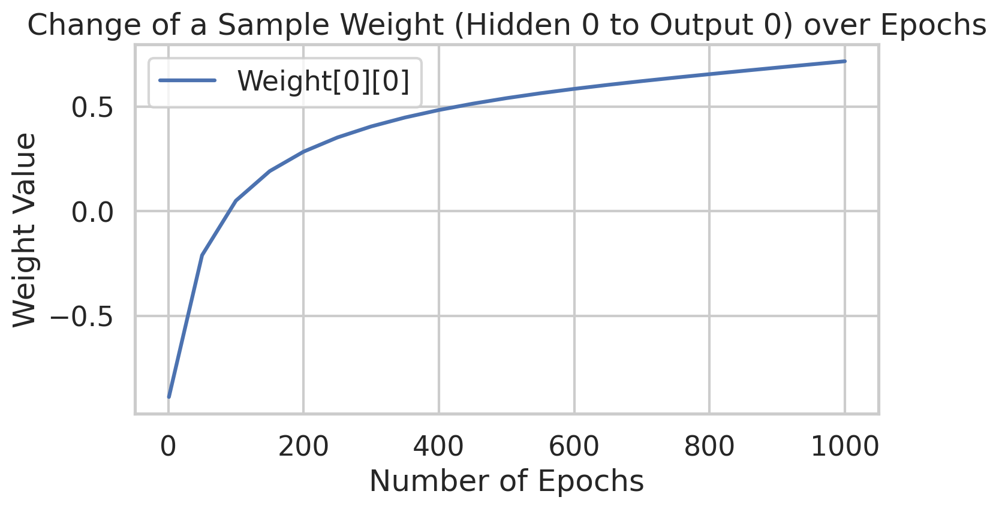

Overall accuracy: 73.33%
 - Accuracy Setosa: 65.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


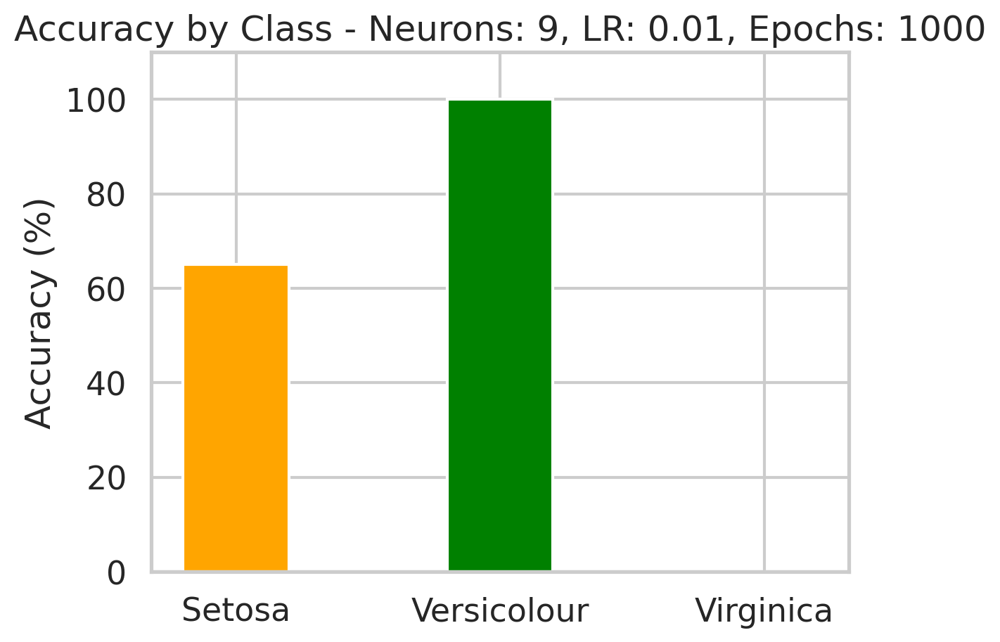

Epoch  1 - Total Error:  0.2854209338808335
Epoch  50 - Total Error:  0.04824010019177915
Epoch  100 - Total Error:  0.03236170647106756
Epoch  150 - Total Error:  0.028768372444305464
Epoch  200 - Total Error:  0.027302136090214868
Epoch  250 - Total Error:  0.026518696641892603
Epoch  300 - Total Error:  0.026035037677282366
Epoch  350 - Total Error:  0.025707277839926566
Epoch  400 - Total Error:  0.025469203389465296
Epoch  450 - Total Error:  0.02528580300249804
Epoch  500 - Total Error:  0.025135890553467488
Epoch  550 - Total Error:  0.025003800271540925
Epoch  600 - Total Error:  0.02487338452130185
Epoch  650 - Total Error:  0.02472101803373621
Epoch  700 - Total Error:  0.024509561000119643
Epoch  750 - Total Error:  0.024200157005996672
Epoch  800 - Total Error:  0.02379212731747764
Epoch  850 - Total Error:  0.02333420623463012
Epoch  900 - Total Error:  0.022872663785588058
Epoch  950 - Total Error:  0.022421217532240963
Epoch  1000 - Total Error:  0.021977404015577913
Epo

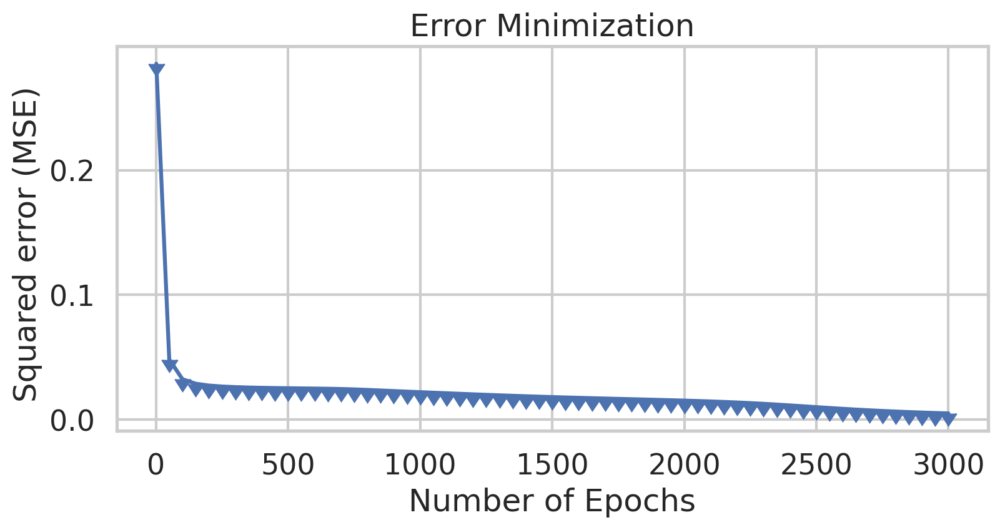

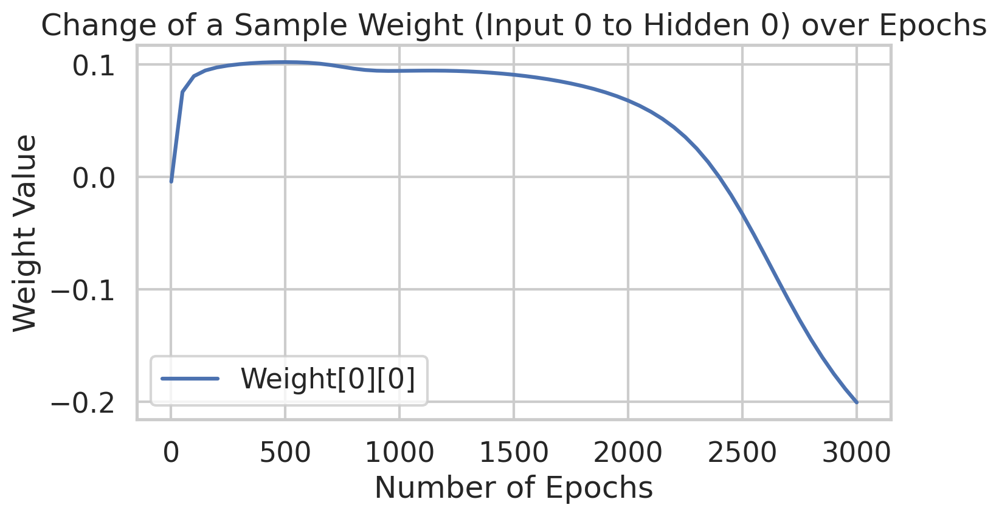

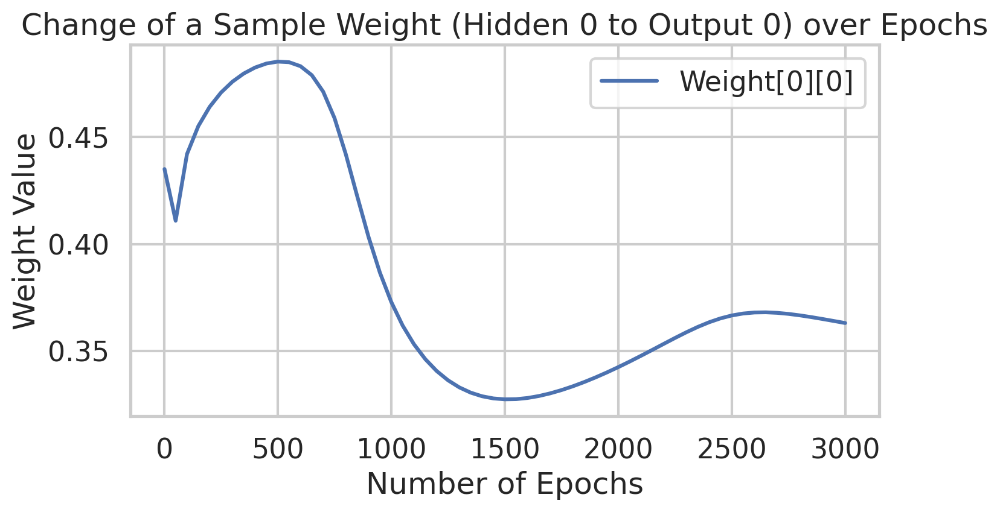

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 88.89%
 - Accuracy Virginica: 100.00%


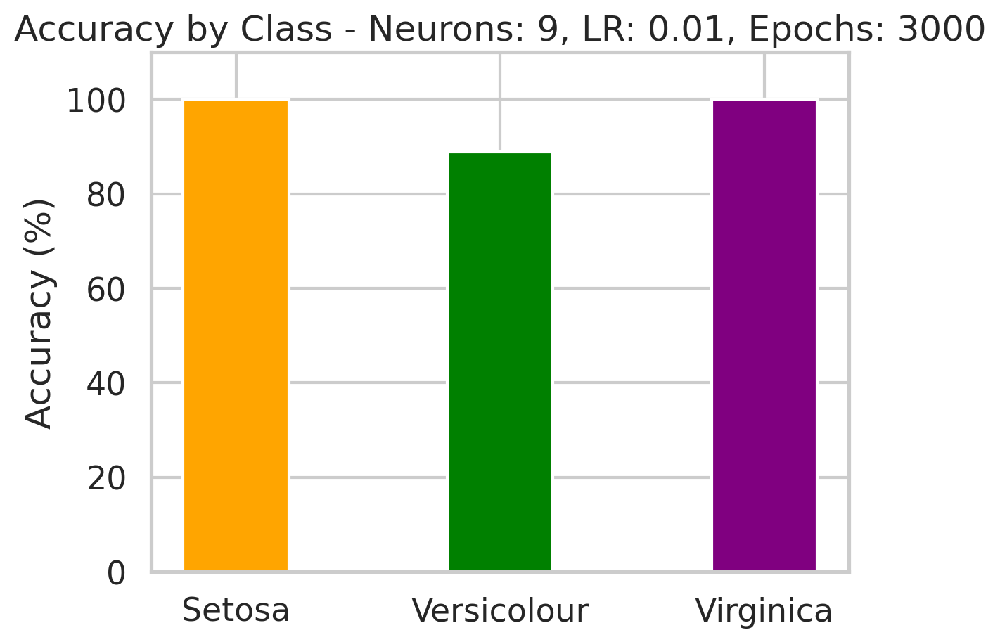

Epoch  1 - Total Error:  0.15372925939547127
Epoch  50 - Total Error:  0.054160342499378226
Epoch  100 - Total Error:  0.033232148018337036
Epoch  150 - Total Error:  0.028089218873973646
Epoch  200 - Total Error:  0.026702175211967733
Epoch  250 - Total Error:  0.02604941696308898
Epoch  300 - Total Error:  0.025603452285875357
Epoch  350 - Total Error:  0.02522693800428478
Epoch  400 - Total Error:  0.024867054034192555
Epoch  450 - Total Error:  0.02451358188038669
Epoch  500 - Total Error:  0.0241662467028803
Epoch  550 - Total Error:  0.023819212633249296
Epoch  600 - Total Error:  0.023463878856794886
Epoch  650 - Total Error:  0.02309238574165511
Epoch  700 - Total Error:  0.02269851062706457
Epoch  750 - Total Error:  0.022277758749820676
Epoch  800 - Total Error:  0.021827375368761497
Epoch  850 - Total Error:  0.02134633229074688
Epoch  900 - Total Error:  0.020835205940884526
Epoch  950 - Total Error:  0.02029584794244973
Epoch  1000 - Total Error:  0.019730719679295308
Epoc

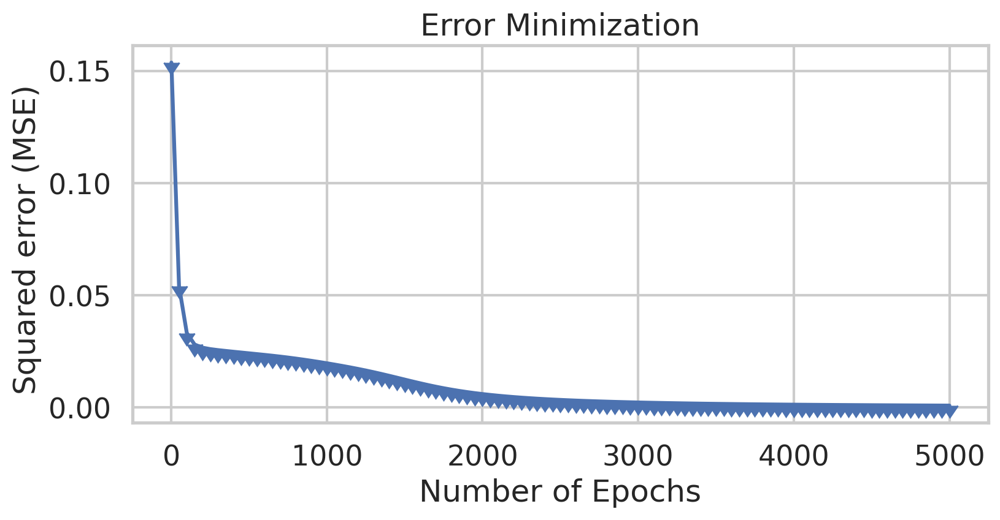

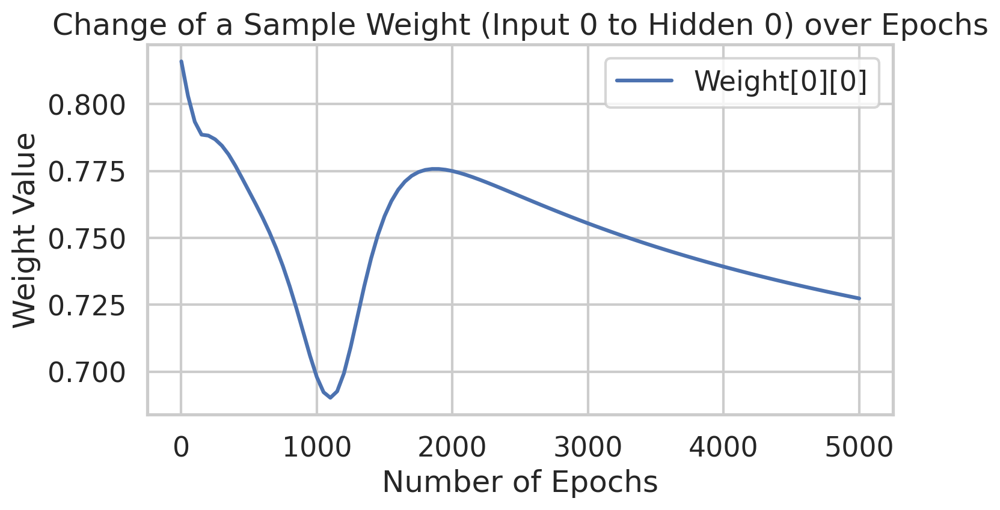

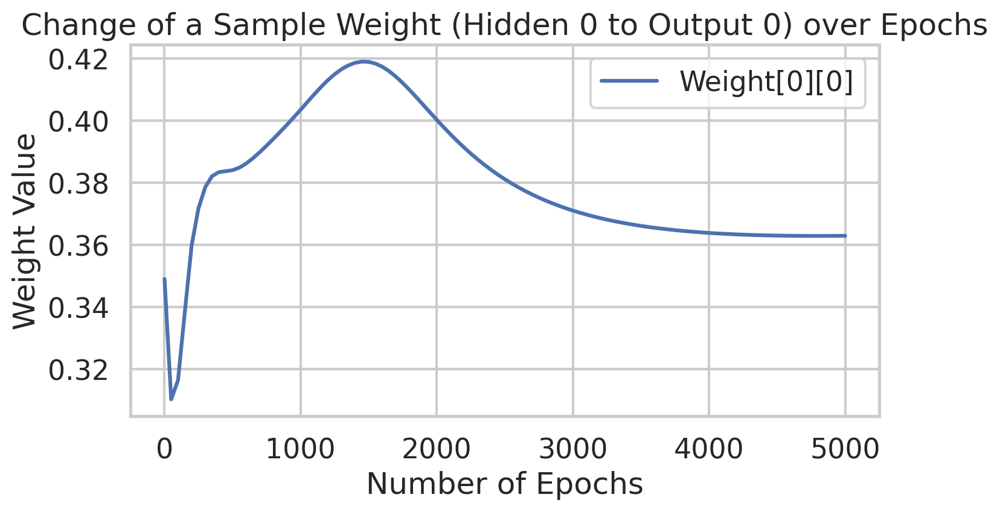

Overall accuracy: 80.00%
 - Accuracy Setosa: 75.00%
 - Accuracy Versicolour: 88.89%
 - Accuracy Virginica: 100.00%


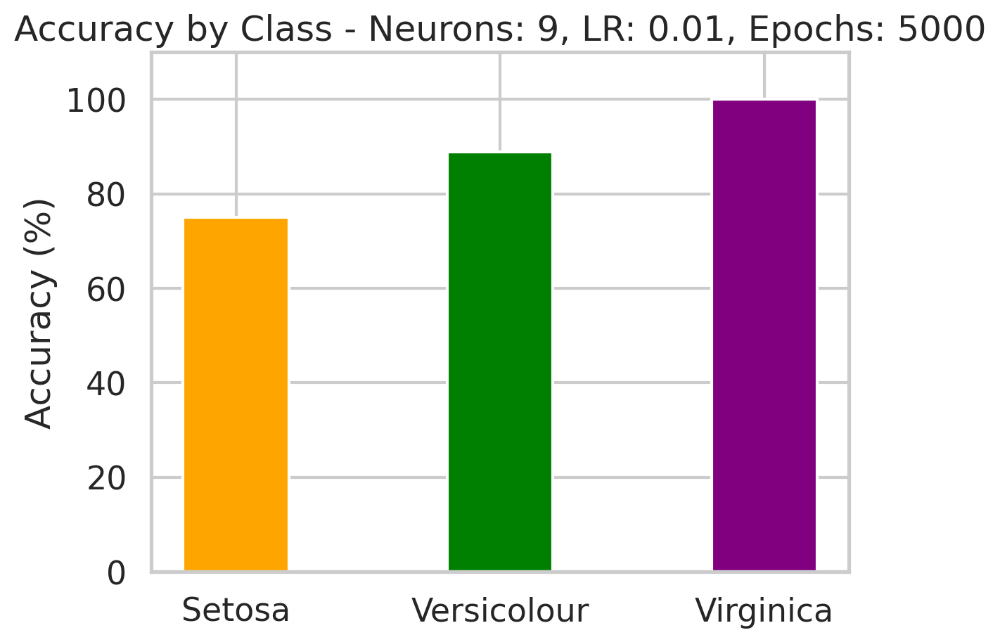

Epoch  1 - Total Error:  0.17817948853810003
Epoch  50 - Total Error:  0.025511040943664697
Epoch  100 - Total Error:  0.024310593525721475
Epoch  150 - Total Error:  0.022144942044444064
Epoch  200 - Total Error:  0.0142024800059855
Epoch  250 - Total Error:  0.006805812926944175
Epoch  300 - Total Error:  0.004157412906874498
Epoch  350 - Total Error:  0.0027430190130445548
Epoch  400 - Total Error:  0.0018843320535348823
Epoch  450 - Total Error:  0.0013811663105413883
Epoch  500 - Total Error:  0.001071670088362436
Epoch  550 - Total Error:  0.0008712239939834414
Epoch  600 - Total Error:  0.000733279017932066
Epoch  650 - Total Error:  0.0006328537818336582
Epoch  700 - Total Error:  0.0005564376043070576


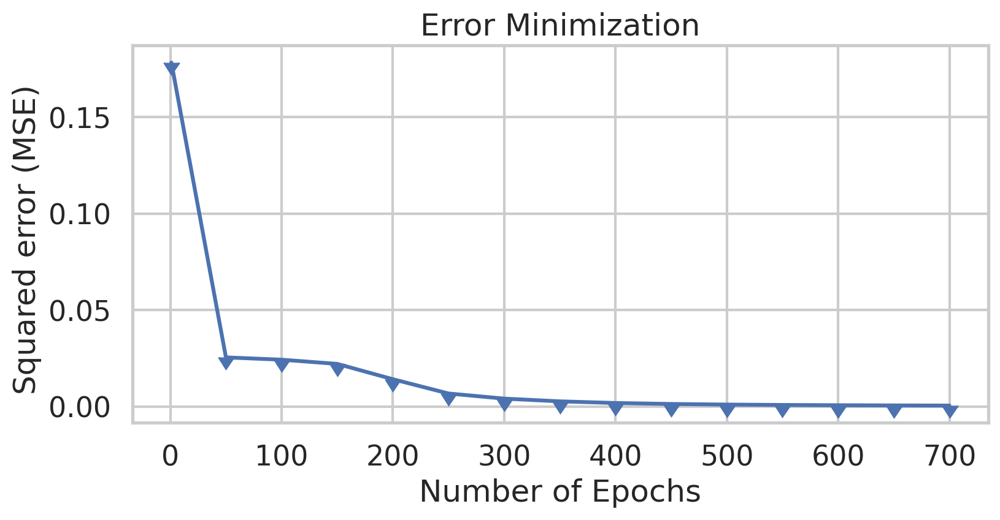

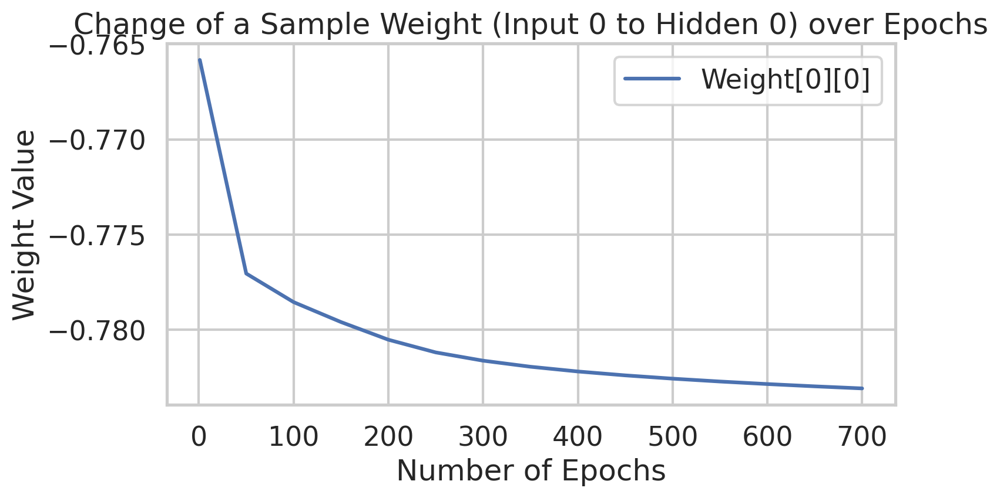

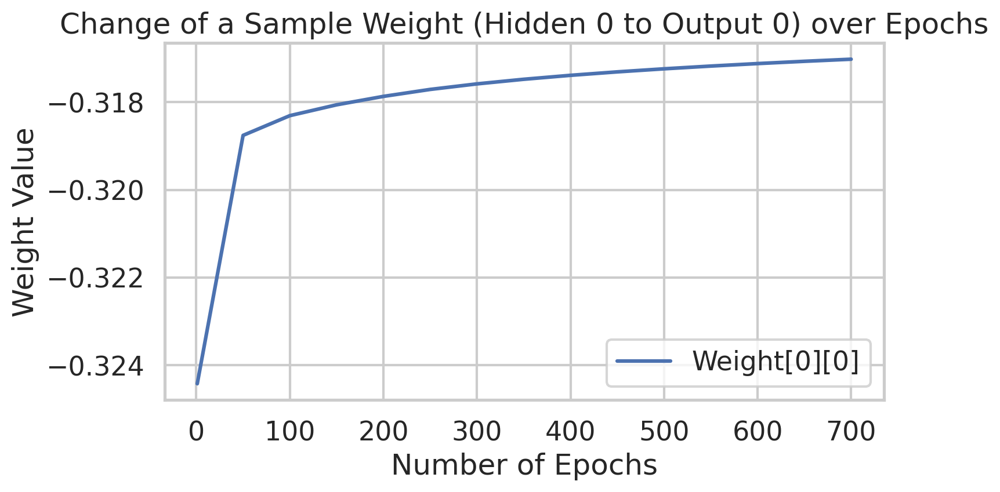

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


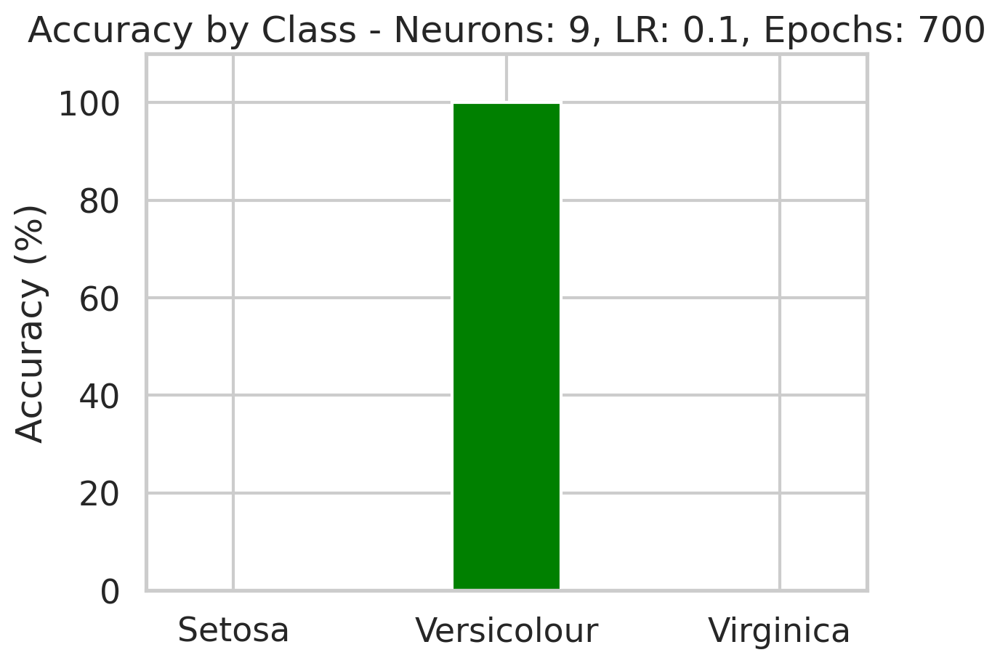

Epoch  1 - Total Error:  0.18685447648183343
Epoch  50 - Total Error:  0.025084227388056293
Epoch  100 - Total Error:  0.02171118332259142
Epoch  150 - Total Error:  0.015347192886007744
Epoch  200 - Total Error:  0.00776476933005785
Epoch  250 - Total Error:  0.004382283612094121
Epoch  300 - Total Error:  0.0028931875229688694
Epoch  350 - Total Error:  0.0020199648191484803
Epoch  400 - Total Error:  0.0014787011596695328
Epoch  450 - Total Error:  0.0011347930991672639
Epoch  500 - Total Error:  0.0009075613740240977
Epoch  550 - Total Error:  0.0007505772391041681
Epoch  600 - Total Error:  0.000637233598845473
Epoch  650 - Total Error:  0.0005521514736730682
Epoch  700 - Total Error:  0.0004861817986272148
Epoch  750 - Total Error:  0.00043365696047466387
Epoch  800 - Total Error:  0.0003909161199643522
Epoch  850 - Total Error:  0.00035550216713151056
Epoch  900 - Total Error:  0.0003257094883078638
Epoch  950 - Total Error:  0.0003003192068613729
Epoch  1000 - Total Error:  0.0

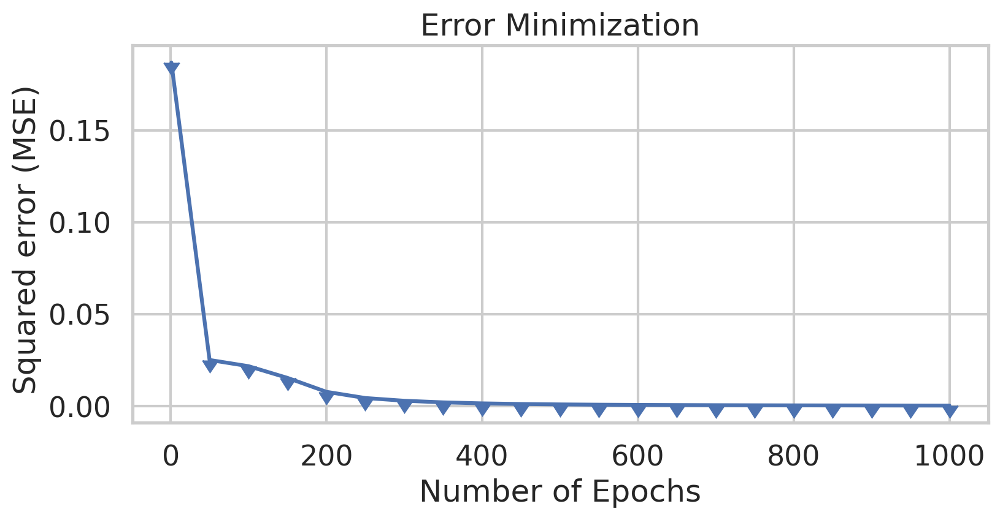

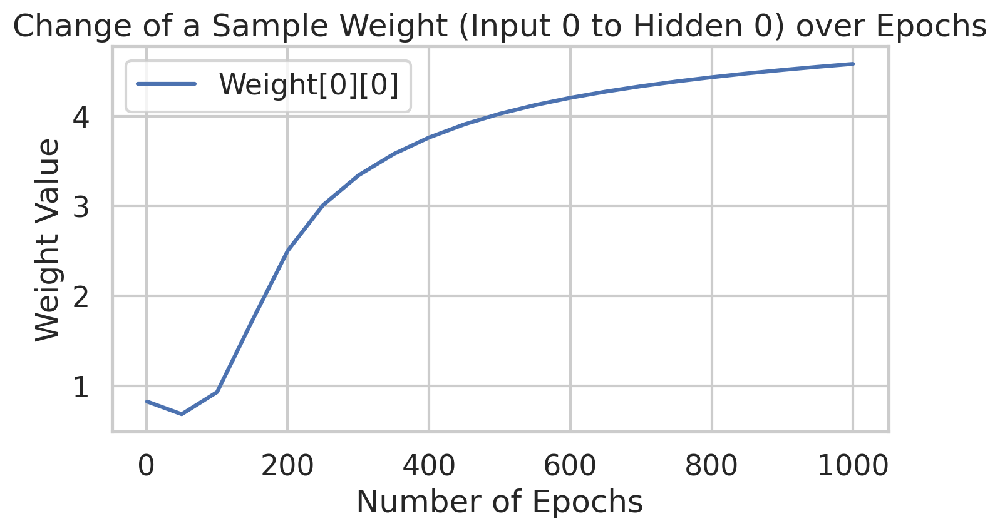

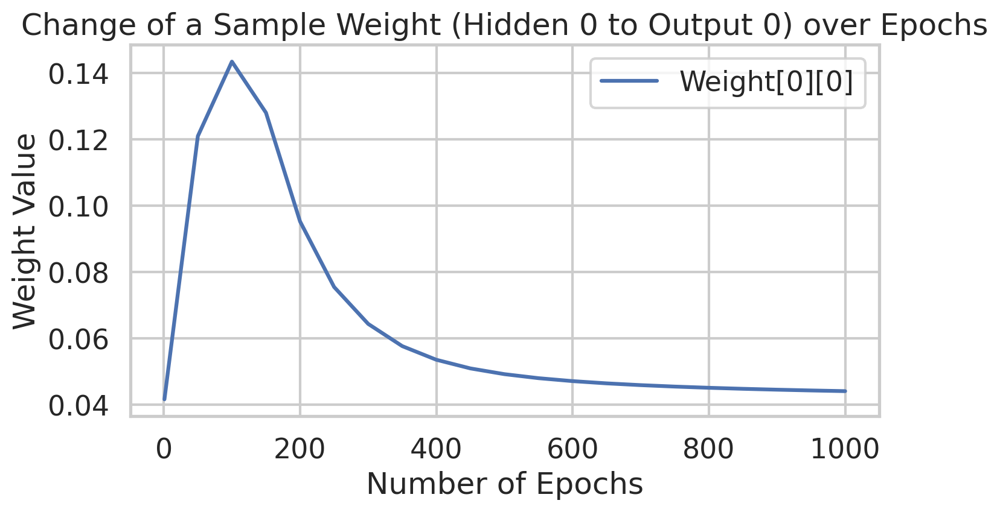

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%


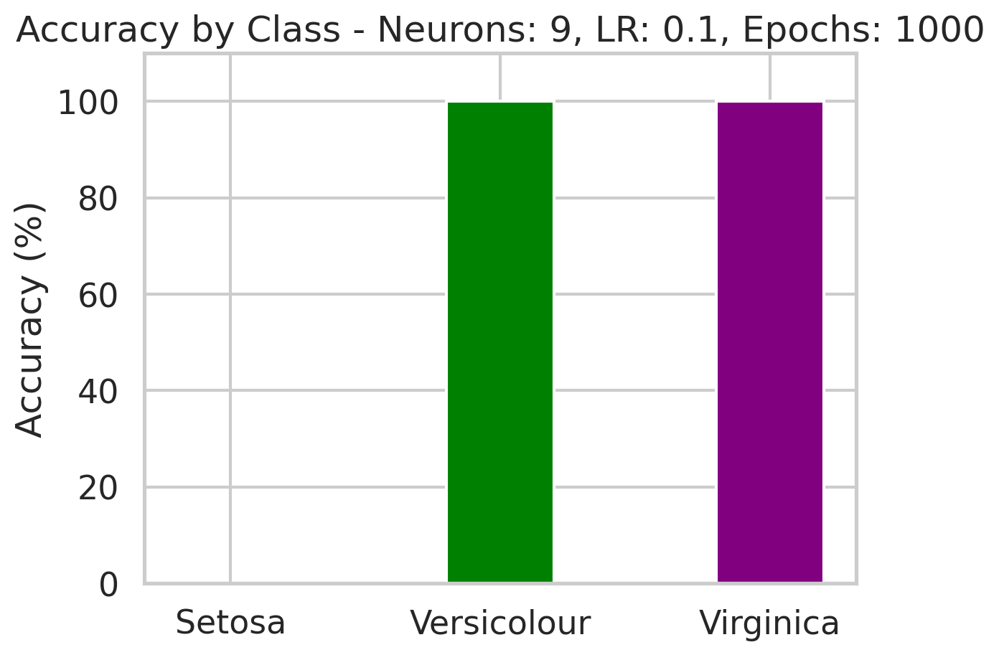

Epoch  1 - Total Error:  0.16389673839495572
Epoch  50 - Total Error:  0.024718666575197303
Epoch  100 - Total Error:  0.021670121484823692
Epoch  150 - Total Error:  0.016320505908247653
Epoch  200 - Total Error:  0.008863188078580019
Epoch  250 - Total Error:  0.0046719787536791315
Epoch  300 - Total Error:  0.0029569465477353846
Epoch  350 - Total Error:  0.0020246212191989328
Epoch  400 - Total Error:  0.001468084468679564
Epoch  450 - Total Error:  0.0011210468605069772
Epoch  500 - Total Error:  0.0008945017842349
Epoch  550 - Total Error:  0.0007391618770625311
Epoch  600 - Total Error:  0.000627424792251807
Epoch  650 - Total Error:  0.0005436827067453911
Epoch  700 - Total Error:  0.00047879157304687596
Epoch  750 - Total Error:  0.000427136030336193
Epoch  800 - Total Error:  0.00038510492833075774
Epoch  850 - Total Error:  0.0003502793817193877
Epoch  900 - Total Error:  0.00032098165668263684
Epoch  950 - Total Error:  0.0002960130856433989
Epoch  1000 - Total Error:  0.00

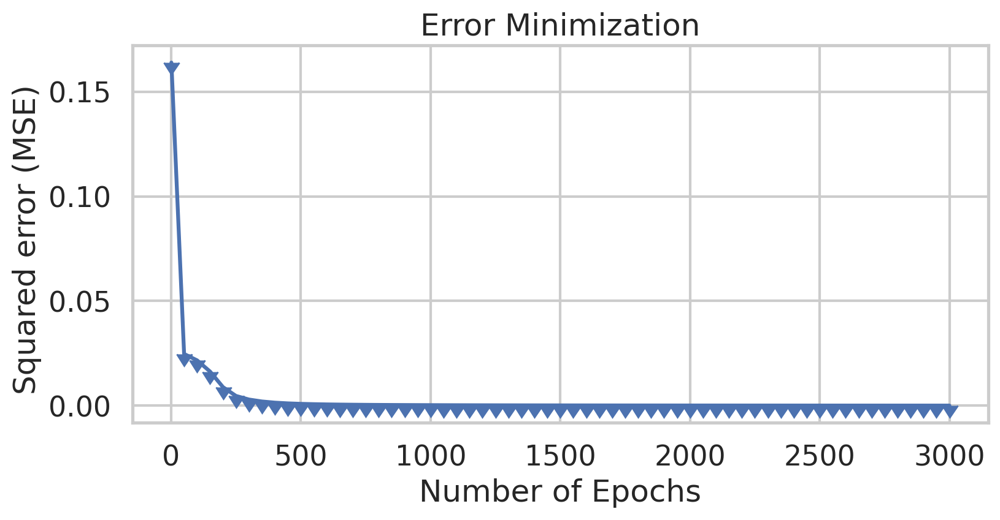

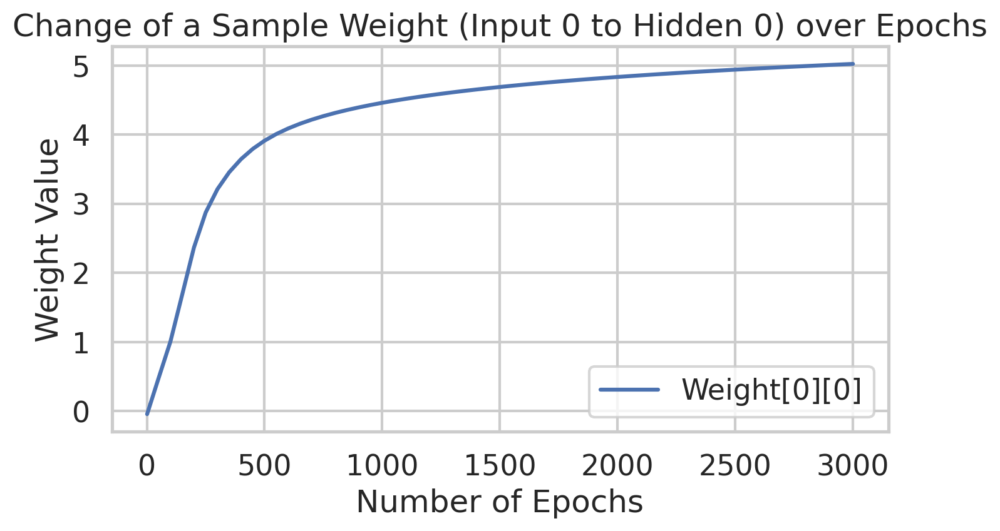

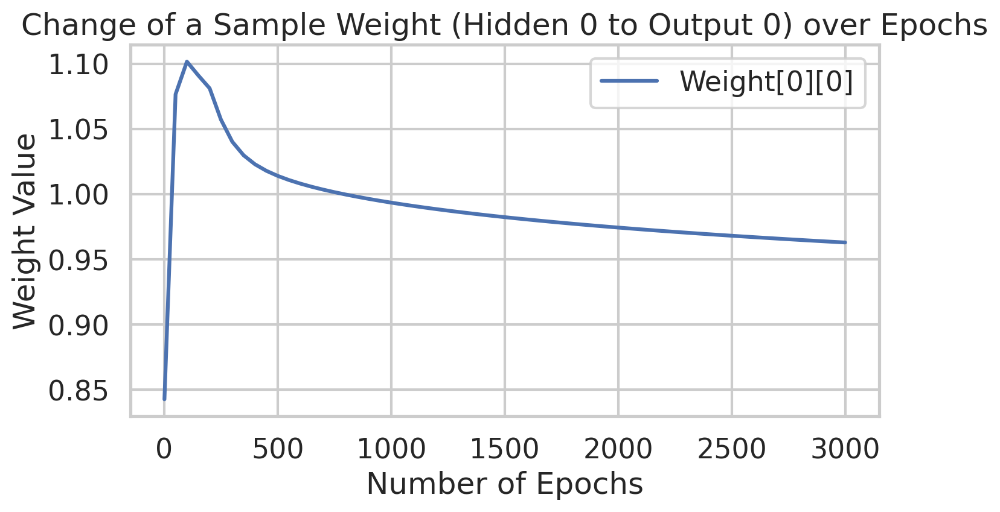

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 88.89%
 - Accuracy Virginica: 100.00%


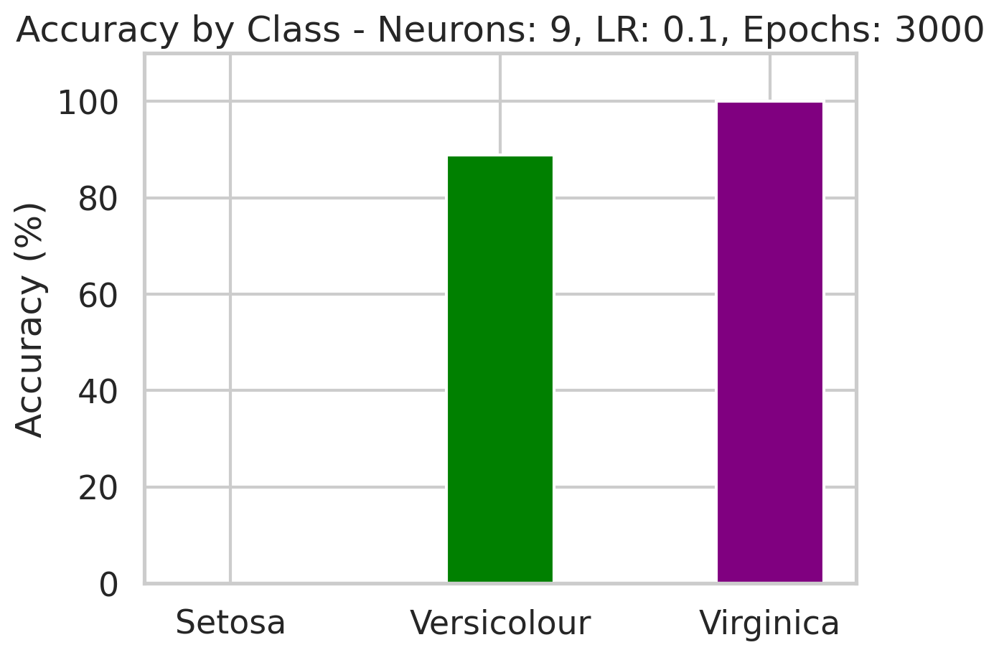

Epoch  1 - Total Error:  0.15873629158096922
Epoch  50 - Total Error:  0.025943118269481518
Epoch  100 - Total Error:  0.024273854244778032
Epoch  150 - Total Error:  0.020276933142231637
Epoch  200 - Total Error:  0.009944142466773252
Epoch  250 - Total Error:  0.004976959657140532
Epoch  300 - Total Error:  0.0031099237024500067
Epoch  350 - Total Error:  0.002062289517420669
Epoch  400 - Total Error:  0.0014579331918184134
Epoch  450 - Total Error:  0.0010970361583744538
Epoch  500 - Total Error:  0.0008682211452744205
Epoch  550 - Total Error:  0.000714559933486758
Epoch  600 - Total Error:  0.000605621575480629
Epoch  650 - Total Error:  0.000524746833021663
Epoch  700 - Total Error:  0.00046244634258552433
Epoch  750 - Total Error:  0.00041302638483507227
Epoch  800 - Total Error:  0.0003728912655738349
Epoch  850 - Total Error:  0.0003396654829559019
Epoch  900 - Total Error:  0.0003117184042167836
Epoch  950 - Total Error:  0.0002878940061115418
Epoch  1000 - Total Error:  0.00

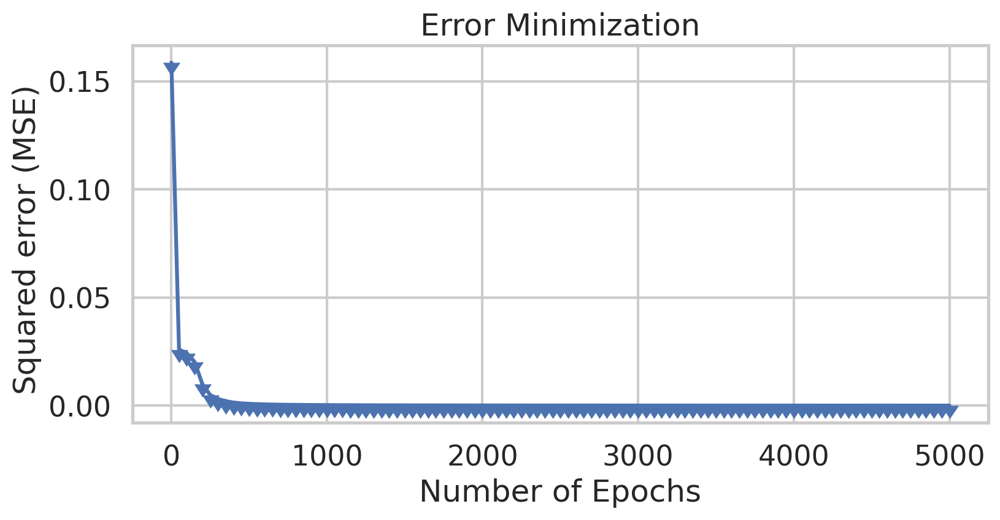

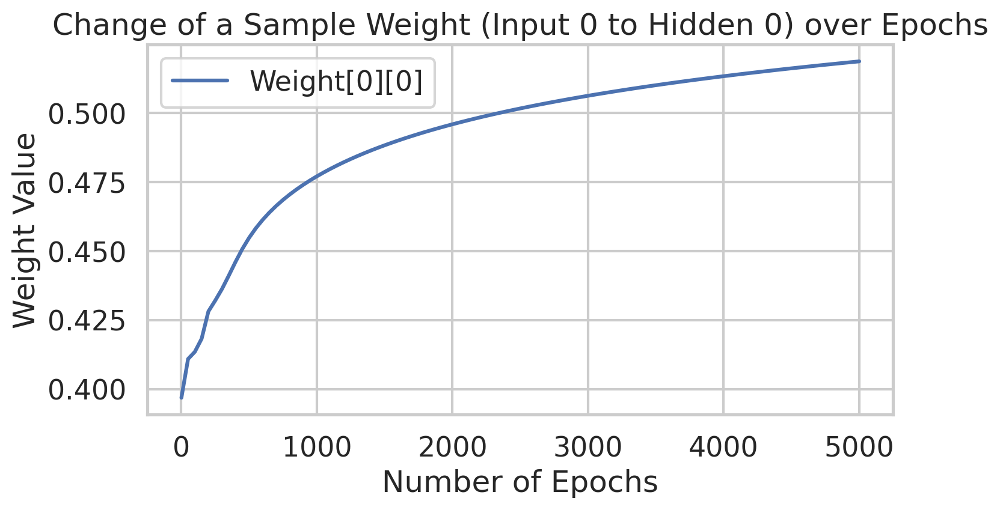

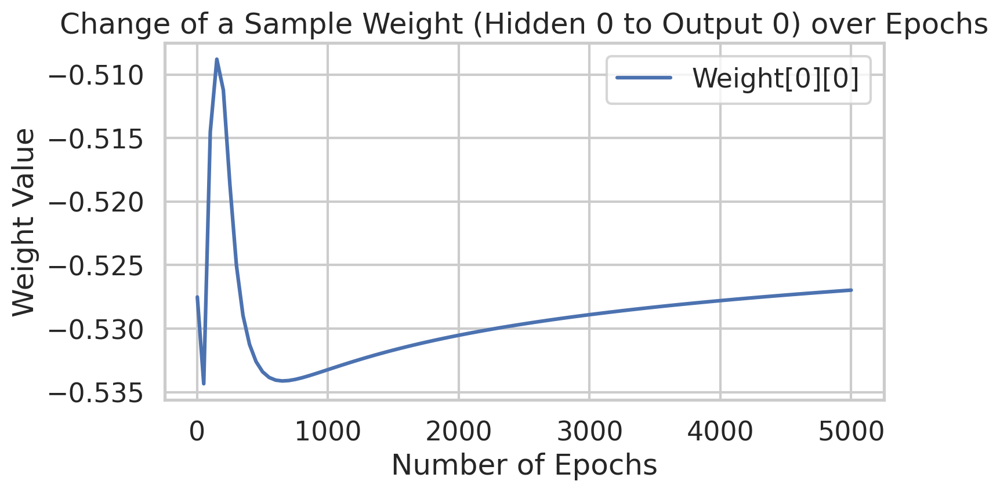

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%


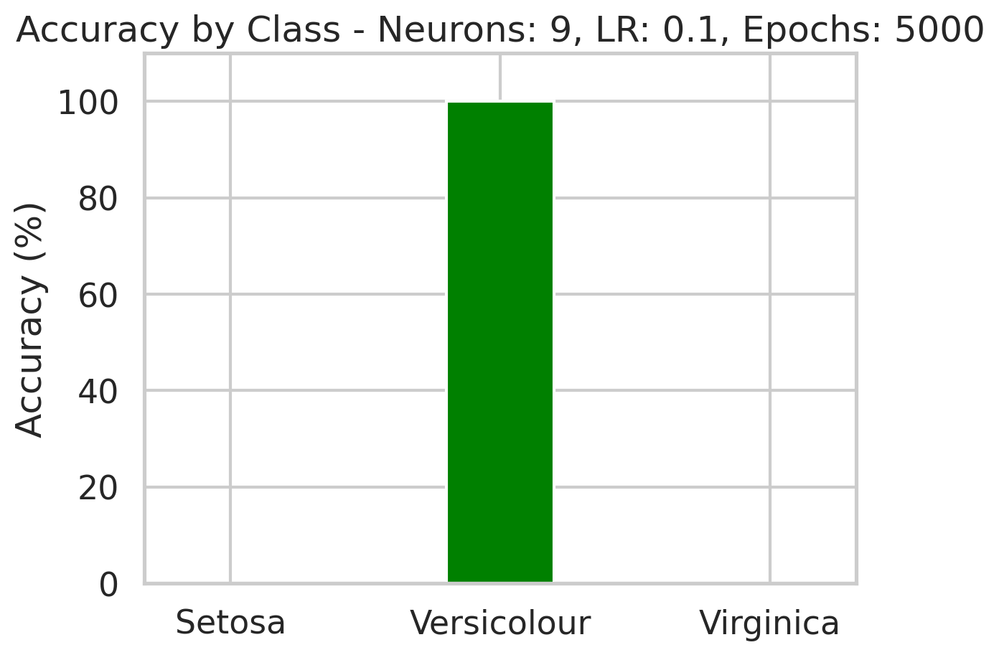

In [70]:
for neurons in [3, 5, 7, 9]:
    for lr in [0.001, 0.005, 0.01, 0.1]:
        for ep in [700, 1000, 3000, 5000]:
            run_experiment(train_X, train_y, test_X, test_y,
                           n_hidden=neurons, learning_rate=lr, epochs=ep)


Epoch  1 - Total Error:  0.20349929734743058
Epoch  50 - Total Error:  0.11934466458839704
Epoch  100 - Total Error:  0.07300126047661477
Epoch  150 - Total Error:  0.04669360208785201
Epoch  200 - Total Error:  0.03661690176491227
Epoch  250 - Total Error:  0.0327288212482328
Epoch  300 - Total Error:  0.030663280854589768
Epoch  350 - Total Error:  0.029383668246053637
Epoch  400 - Total Error:  0.028509221945555163
Epoch  450 - Total Error:  0.027870587561251683
Epoch  500 - Total Error:  0.02738242982239895
Epoch  550 - Total Error:  0.026997563218038576
Epoch  600 - Total Error:  0.026687687728258597
Epoch  650 - Total Error:  0.026434437165662777
Epoch  700 - Total Error:  0.026224995477571608
Epoch  750 - Total Error:  0.026049913308498207
Epoch  800 - Total Error:  0.025901999210158854
Epoch  850 - Total Error:  0.02577571138614871
Epoch  900 - Total Error:  0.025666769708328922
Epoch  950 - Total Error:  0.02557186911131821
Epoch  1000 - Total Error:  0.02548845284514433
Epoch

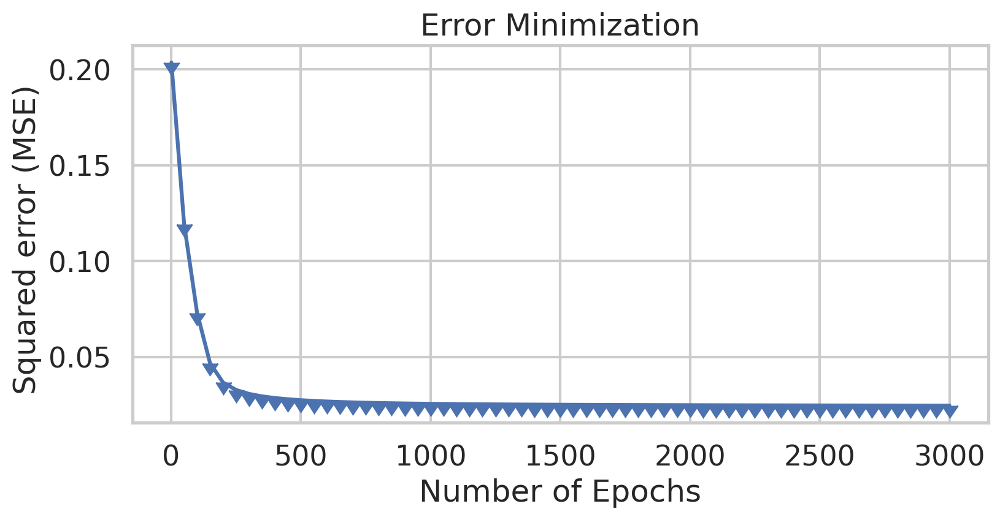

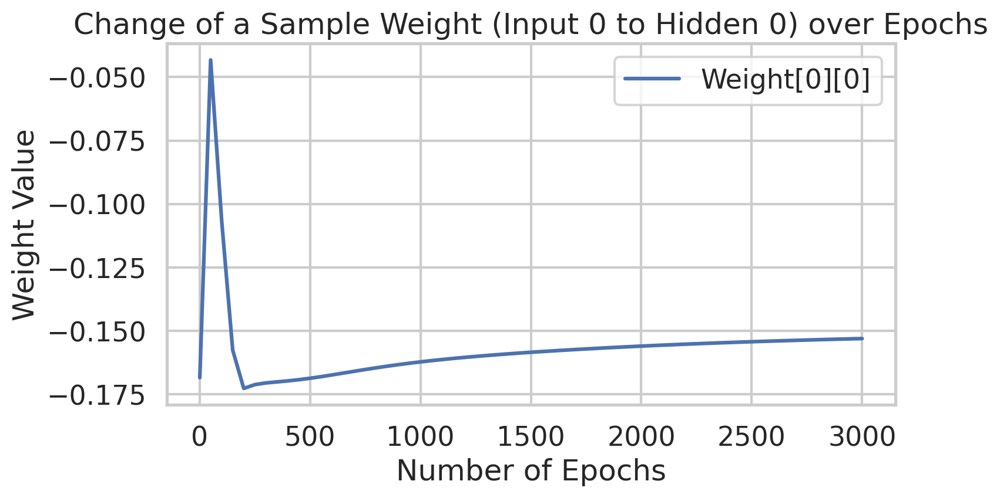

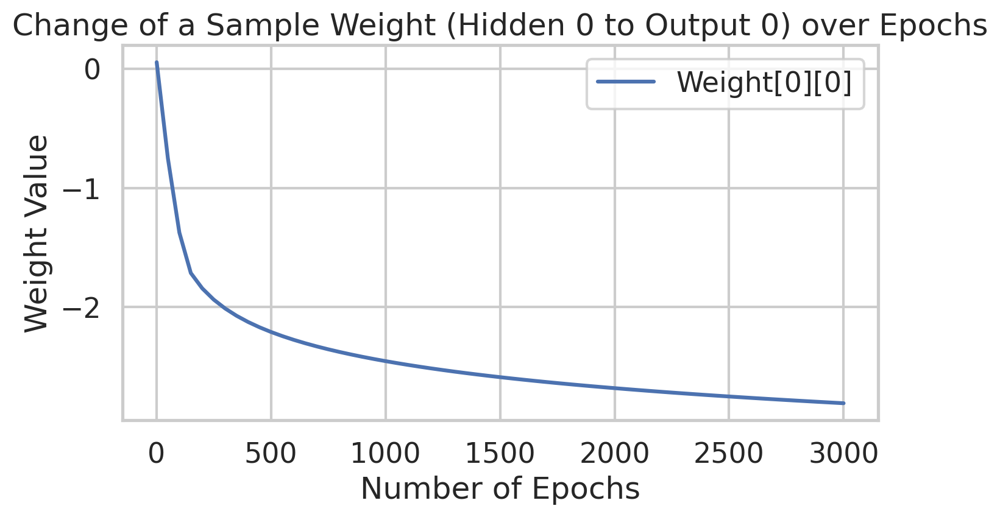

,params,"{'ActivationFunction': 'sigmoid', 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'Epocas': 3000, ...}"


In [56]:
dictionary = {
    'InputLayer': 4,           # Number of features in the dataset (e.g., Iris)
    'HiddenLayer': 5,          # Number of neurons in the hidden layer
    'OutputLayer': 3,          # Number of classes (Iris-setosa, versicolor, virginica)
    'Epocas': 3000,            # Number of training epochs (more = better convergence)
    'LearningRate': 0.005,     # Step size for weight updates
    'BiasHiddenValue': -1,     # Bias value added to each hidden neuron
    'BiasOutputValue': -1,     # Bias value added to each output neuron
    'ActivationFunction': 'sigmoid'  # Activation function for both layers
}

Perceptron = MultiLayerPerceptron(dictionary)
Perceptron.fit(train_X, train_y)


### Evaluating the trained Multilayer Perceptron using the test dataset.

In [57]:
prev, dataframe = Perceptron.predict(test_X, test_y)
hits = n_set = n_vers = n_virg = 0
score_set = score_vers = score_virg = 0
for j in range(len(test_y)):
    if(test_y[j] == 0): n_set += 1
    elif(test_y[j] == 1): n_vers += 1
    elif(test_y[j] == 2): n_virg += 1

for i in range(len(test_y)):
    if test_y[i] == prev[i]:
        hits += 1
    if test_y[i] == prev[i] and test_y[i] == 0:
        score_set += 1
    elif test_y[i] == prev[i] and test_y[i] == 1:
        score_vers += 1
    elif test_y[i] == prev[i] and test_y[i] == 2:
        score_virg += 1

hits = (hits / len(test_y)) * 100
faults = 100 - hits

print("Porcents :","%.2f"%(hits),"% hits","and","%.2f"%(faults),"% faults")
print("Total samples of test",len(test_y))
print("*Iris-Setosa:",n_set,"samples", score_set, "hits")
print("*Iris-Versicolour:",n_vers,"samples", score_vers, "hits")
print("*Iris-Virginica:",n_virg,"samples", score_virg, "hits")

Porcents : 96.67 % hits and 3.33 % faults
Total samples of test 30
*Iris-Setosa: 20 samples 20 hits
*Iris-Versicolour: 9 samples 9 hits
*Iris-Virginica: 1 samples 0 hits


In [59]:
dataframe

,_id,class,output,hoped_output
0,0,Iris-setosa,0,0.0
1,1,Iris-setosa,0,0.0
2,2,Iris-setosa,0,0.0
3,3,Iris-versicolour,1,1.0
4,4,Iris-versicolour,1,1.0
5,5,Iris-setosa,0,0.0
6,6,Iris-versicolour,1,1.0
7,7,Iris-setosa,0,0.0
8,8,Iris-versicolour,1,1.0
9,9,Iris-setosa,0,0.0


### calculating and visualizing per-class accuracy with a bar chart

- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 100.00 %
- Acurracy Iris-Virginica: 0.00 %


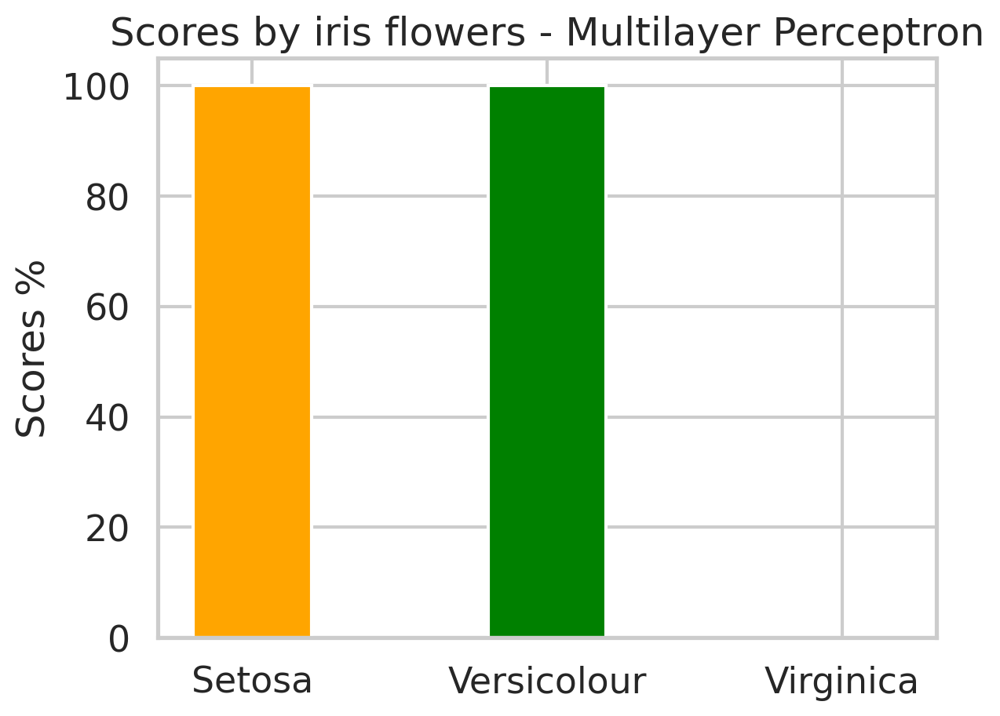

In [60]:
acc_set = (score_set/n_set)*100
acc_vers = (score_vers/n_vers)*100
acc_virg = (score_virg/n_virg)*100
print("- Acurracy Iris-Setosa:","%.2f"%acc_set, "%")
print("- Acurracy Iris-Versicolour:","%.2f"%acc_vers, "%")
print("- Acurracy Iris-Virginica:","%.2f"%acc_virg, "%")
names = ["Setosa","Versicolour","Virginica"]
x1 = [2.0,4.0,6.0]
fig, ax = plt.subplots()
r1 = plt.bar(x1[0], acc_set,color='orange',label='Iris-Setosa')
r2 = plt.bar(x1[1], acc_vers,color='green',label='Iris-Versicolour')
r3 = plt.bar(x1[2], acc_virg,color='purple',label='Iris-Virginica')
plt.ylabel('Scores %')
plt.xticks(x1, names);plt.title('Scores by iris flowers - Multilayer Perceptron')
plt.show()



